In [13]:
import numpy as np
import sympy as sym

In [19]:
sym.init_printing()
x, y = sym.symbols('x, y')
#A = sym.Matrix([[3, 0], [5, 1]])
#B = sym.Matrix([[3, 5], [0, 1]])
A = sym.Matrix([[1, -1], [-1, 1]])
B = - A
sigma_r = sym.Matrix([[x, 1-x]])
sigma_c = sym.Matrix([y, 1-y])
A * sigma_c, sigma_r * B


⎛⎡2⋅y - 1⎤                    ⎞
⎜⎢       ⎥, [1 - 2⋅x  2⋅x - 1]⎟
⎝⎣1 - 2⋅y⎦                    ⎠

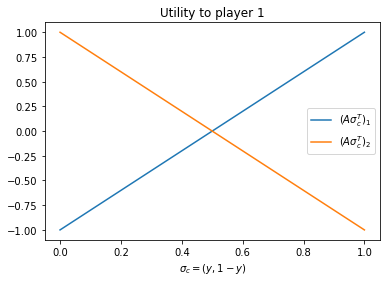

In [20]:
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
matplotlib.rc("savefig", dpi=100)  # Increase the quality of the images (not needed)

ys = [0, 1]
row_us = [[(A * sigma_c)[i].subs({y: val}) for val in ys] for i in range(2)]
plt.plot(ys, row_us[0], label="$(A\sigma_c^T)_1$")
plt.plot(ys, row_us[1], label="$(A\sigma_c^T)_2$")
plt.xlabel("$\sigma_c=(y, 1-y)$")
plt.title("Utility to player 1")
plt.legend();

In [33]:
xs = [0, 1]
row_us = [[(sigma_r * B)[j].subs({x: val}) for val in xs] for j in range(2)]
plt.plot(ys, row_us[0], label="$(\sigma_rB)_1$")
plt.plot(ys, row_us[1], label="$(\sigma_rB)_2$")
plt.xlabel("$\sigma_r=(x, 1-x)$")
plt.title("Utility to column player")
plt.legend();

NameError: name 'sigma_r' is not defined

In [34]:
from pulp import *


In [2]:
#area = []
area = {'Grid':{'Community1': {'Area 1':{'PV': '1kWh','Load': '1kWh'},'Area 2':{'PV':'2kWh', 'Load':'1kWh'},'Area 3':{'Load':'1kWh'}}}}
#print(len(area))

In [3]:
from uuid import uuid4
def asset(area):
    if area['Grid']['Community1']['Area 1']:
        area1 = area['Grid']['Community1']['Area 1']
        if area1['PV']:
            print(area1['PV'])
            uuid = str(uuid4())
            print(uuid)
        #if area1['Battery']:
        #    print(area1['Battery'])
        #else:
        #    pass
    if area['Grid']['Community1']['Area 2']:
        area2 = area['Grid']['Community1']['Area 2']
        if area2['PV']:         
            print(area2.values())  
    
asset(area)
    

1kWh
a822fc23-ff05-4de9-a18f-0d17e871f5ca
dict_values(['2kWh', '1kWh'])


In [13]:
class Area:
    
    def __init__(self,name: str = None, uuid: str = None):
        self.__name = name
        self.uuid = uuid if uuid is not None else str(uuid4())
        print(self.__name)
        print(self.uuid)
    def printdetail(self):
        print("Name:",self.__name)
        print("UUID:",self.uuid)
        
area = Area('Grid',
            [
                Area('Community',
                         [
                             Area('Area1',
                                  [
                                      Area('PV1'),
                                      Area('Load1'),
                         ]),
                          [
                              Area('Area2',
                                   [
                                       Area('PV2'),
                                       Area('Load2'),
                         ]),
                          ]
                         ])
            ])
#area.printdetail()

PV1
c2a7c71c-272e-436a-a297-83ddcf2a5da3
Load1
21b70a55-e033-446a-94cf-f67047959685
Area1
[<__main__.Area object at 0x7f4d682b1af0>, <__main__.Area object at 0x7f4d6cbddeb0>]
PV2
af4c5eb5-24b4-46b7-81d0-8795504e8bb5
Load2
828d2a45-9aaf-477d-a8bc-7ea1c0fae29a
Area2
[<__main__.Area object at 0x7f4d68326760>, <__main__.Area object at 0x7f4d683269d0>]
Community
[<__main__.Area object at 0x7f4d6cbddac0>, [<__main__.Area object at 0x7f4d68326400>]]
Grid


In [1]:
import os
import pandas as pd
import numpy as np
current_dir = os.getcwd()
#print(current_dir)


In [2]:
load_profile = os.path.join(current_dir, "resources/Berlin_pv.csv")
print(load_profile)

/home/sri/Grid Singularity/python/resources/Berlin_pv.csv


In [3]:
filename = '/home/sri/Grid Singularity/LoadProfilesGenerator/LoadProfilesGenerator/d3a_format2/PV/Berlin_pv.csv'
df = pd.read_csv(filename)

#df.head()
df['Time'] = pd.to_datetime(df['Time'], format='%Y-%m-%dT%H:%M')
df['Availability Factor'] = np.where(df['power']!=0,1.0,0.0)
df.info()  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35040 entries, 0 to 35039
Data columns (total 3 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   Time                 35040 non-null  datetime64[ns]
 1   power                35040 non-null  float64       
 2   Availability Factor  35040 non-null  float64       
dtypes: datetime64[ns](1), float64(2)
memory usage: 821.4 KB


In [4]:
filename1 = '/home/sri/Grid Singularity/LoadProfilesGenerator/LoadProfilesGenerator/CHR15 Multigenerational Home working couple, 2 children, 2 seniors HH1.csv'
df1 = pd.read_csv(filename1)
df1['Time'] = pd.to_datetime(df1['Time'], format='%d/%m/%Y %H:%M')

df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35040 entries, 0 to 35039
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Electricity.Timestep  35040 non-null  int64         
 1   Time                  35040 non-null  datetime64[ns]
 2   Sum [kWh]             35040 non-null  float64       
dtypes: datetime64[ns](1), float64(1), int64(1)
memory usage: 821.4 KB


In [5]:
def strategy(energy_requirement, production, willingness_to_pay_for_green_energy, willingness_to_pay_for_grey_energy, Fit, grid_fee):
    #print("Forecast:" , forecast)
    print(energy_requirement)
    load_strategy_green = []
    load_strategy_grey = []
    green = pd.DataFrame()
    grey = pd.DataFrame()
    green_energy = True
    green_energy_cost = energy_requirement *  willingness_to_pay_for_green_energy
    grey_energy_cost = energy_requirement *  willingness_to_pay_for_grey_energy
    ticks = 10
    #print("The cost for consuming green energy = ", green_energy_cost, "Euro/kWh")
    #print("The cost for consuming grey energy = ", grey_energy_cost, "Euro/kWh")
    
    #Define load strategy
    if production >= energy_requirement:
        avail_fact = 1.0
        rem_energy = production - energy_requirement
    else:
        avail_fact = 0.0
        rem_energy = 0.0
    #print("Remaining energy: ",rem_energy,"kW")  
    for i in range(0, ticks):
        #if green_energy is True:
            if i < ticks - 2:
                load_strategy_green.append(round(green_energy_cost+(Fit - grid_fee) +(green_energy_cost + grid_fee - Fit)  *(i/ticks),3)*avail_fact)
                #load_strategy_green.append(round(willingness_to_pay_for_green_energy-(Fit - grid_fee) -(green_energy_cost + grid_fee - Fit)  *(i/ticks),3))
                green = load_strategy_green
                green_avg = sum(load_strategy_green)/len(load_strategy_green)
                load_strategy_grey.append(round(grey_energy_cost + (Fit - grid_fee) + (grey_energy_cost +grid_fee - Fit) *(i/ticks),3))
                grey = load_strategy_grey

            else:
                load_strategy_green.append(round(green_energy_cost+grid_fee,3)*avail_fact)
                green = load_strategy_green
                load_strategy_grey.append(round(grey_energy_cost+grid_fee,3))
                grey = load_strategy_grey
                

            green_avg = sum(load_strategy_green)/len(load_strategy_green)
            grey_avg = sum(load_strategy_grey)/len(load_strategy_grey)
    
    print(green) 
    print(grey)
    print("Average green: ", round(green_avg,3))
    print("Average grey: ", round(grey_avg,3))
    return load_strategy_green, load_strategy_grey, round(rem_energy,3)
    
#load_strategy_green, load_strategy_green = strategy(energy_requirement, willingness_to_pay_for_green_energy, willingness_to_pay_for_grey_energy, Fit = 21, grid_fee = 4)
#print(a,',', b)

In [6]:
utility = []
energy = []
if df['Time'].equals(df1['Time']):
    df1['Availability Factor'] = df['Availability Factor']
    df1['Production'] = df['power']
    for index, row in df1.iterrows():
        print(row['Time'])
        load_strategy_green, load_strategy_green, rem_energy = strategy(round(row['Sum [kWh]'],3),round(row['Production'],3),willingness_to_pay_for_green_energy = 30, willingness_to_pay_for_grey_energy = 20, Fit = 21, grid_fee = 4)
        row['Remaining Energy'] = rem_energy
        print("Remaining Energy: ", row['Remaining Energy'],"W")
        energy.append(rem_energy)
df1['Remaining Energy'] = energy

2021-01-01 00:00:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-01-01 00:15:00
0.034
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  0.0
Average grey:  10.51
Remaining Energy:  0.0 W
2021-01-01 00:30:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-01-01 00:45:00
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-01-01 01:00:00
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 

Average grey:  23.848
Remaining Energy:  274.445 W
2021-01-02 13:30:00
0.807
[41.21, 41.931, 42.652, 43.373, 44.094, 44.815, 45.536, 46.257, 28.21, 28.21]
[33.14, 33.054, 32.968, 32.882, 32.796, 32.71, 32.624, 32.538, 20.14, 20.14]
Average green:  40.629
Average grey:  30.299
Remaining Energy:  209.193 W
2021-01-02 13:45:00
1.184
[52.52, 54.372, 56.224, 58.076, 59.928, 61.78, 63.632, 65.484, 39.52, 39.52]
[40.68, 41.348, 42.016, 42.684, 43.352, 44.02, 44.688, 45.356, 27.68, 27.68]
Average green:  55.106
Average grey:  39.95
Remaining Energy:  143.816 W
2021-01-02 14:00:00
0.835
[42.05, 42.855, 43.66, 44.465, 45.27, 46.075, 46.88, 47.685, 29.05, 29.05]
[33.7, 33.67, 33.64, 33.61, 33.58, 33.55, 33.52, 33.49, 20.7, 20.7]
Average green:  41.704
Average grey:  31.016
Remaining Energy:  79.165 W
2021-01-02 14:15:00
1.619
[65.57, 68.727, 71.884, 75.041, 78.198, 81.355, 84.512, 87.669, 52.57, 52.57]
[49.38, 50.918, 52.456, 53.994, 55.532, 57.07, 58.608, 60.146, 36.38, 36.38]
Average green:  71

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.5, 18.05, 16.6, 15.15, 13.7, 12.25, 10.8, 9.35, 6.5, 6.5]
Average green:  0.0
Average grey:  12.84
Remaining Energy:  0.0 W
2021-01-04 05:30:00
0.399
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.98, 24.078, 23.176, 22.274, 21.372, 20.47, 19.568, 18.666, 11.98, 11.98]
Average green:  0.0
Average grey:  19.854
Remaining Energy:  0.0 W
2021-01-04 05:45:00
0.447
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.94, 25.134, 24.328, 23.522, 22.716, 21.91, 21.104, 20.298, 12.94, 12.94]
Average green:  0.0
Average grey:  21.083
Remaining Energy:  0.0 W
2021-01-04 06:00:00
0.784
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.68, 32.548, 32.416, 32.284, 32.152, 32.02, 31.888, 31.756, 19.68, 19.68]
Average green:  0.0
Average grey:  29.71
Remaining Energy:  0.0 W
2021-01-04 06:15:00
0.198
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.96, 19.656, 18.352, 17.048, 15.744, 14.44, 13.136, 11.832, 7.96, 7.96]
Average

Average grey:  15.067
Remaining Energy:  0.0 W
2021-01-05 21:00:00
0.217
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.34, 20.074, 18.808, 17.542, 16.276, 15.01, 13.744, 12.478, 8.34, 8.34]
Average green:  0.0
Average grey:  15.195
Remaining Energy:  0.0 W
2021-01-05 21:15:00
0.199
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.98, 19.678, 18.376, 17.074, 15.772, 14.47, 13.168, 11.866, 7.98, 7.98]
Average green:  0.0
Average grey:  14.734
Remaining Energy:  0.0 W
2021-01-05 21:30:00
0.141
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.82, 18.402, 16.984, 15.566, 14.148, 12.73, 11.312, 9.894, 6.82, 6.82]
Average green:  0.0
Average grey:  13.25
Remaining Energy:  0.0 W
2021-01-05 21:45:00
0.143
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.86, 18.446, 17.032, 15.618, 14.204, 12.79, 11.376, 9.962, 6.86, 6.86]
Average green:  0.0
Average grey:  13.301
Remaining Energy:  0.0 W
2021-01-05 22:00:00
0.228
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21

Average grey:  13.07
Remaining Energy:  7.366 W
2021-01-07 14:30:00
0.174
[22.22, 21.042, 19.864, 18.686, 17.508, 16.33, 15.152, 13.974, 9.22, 9.22]
[20.48, 19.128, 17.776, 16.424, 15.072, 13.72, 12.368, 11.016, 7.48, 7.48]
Average green:  16.322
Average grey:  14.094
Remaining Energy:  4.826 W
2021-01-07 14:45:00
0.445
[30.35, 29.985, 29.62, 29.255, 28.89, 28.525, 28.16, 27.795, 17.35, 17.35]
[25.9, 25.09, 24.28, 23.47, 22.66, 21.85, 21.04, 20.23, 12.9, 12.9]
Average green:  26.728
Average grey:  21.032
Remaining Energy:  2.055 W
2021-01-07 15:00:00
0.07
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.4, 16.84, 15.28, 13.72, 12.16, 10.6, 9.04, 7.48, 5.4, 5.4]
Average green:  0.0
Average grey:  11.432
Remaining Energy:  0.0 W
2021-01-07 15:15:00
0.06
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
Average green:  0.0
Average grey:  11.176
Remaining Energy:  0.0 W
2021-01-07 15:30:00
0.053
[0.0, 0.0, 0.0, 0.0, 0.0,

Remaining Energy:  0.0 W
2021-01-09 06:30:00
0.443
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.86, 25.046, 24.232, 23.418, 22.604, 21.79, 20.976, 20.162, 12.86, 12.86]
Average green:  0.0
Average grey:  20.981
Remaining Energy:  0.0 W
2021-01-09 06:45:00
0.527
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.54, 26.894, 26.248, 25.602, 24.956, 24.31, 23.664, 23.018, 14.54, 14.54]
Average green:  0.0
Average grey:  23.131
Remaining Energy:  0.0 W
2021-01-09 07:00:00
0.265
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.3, 21.13, 19.96, 18.79, 17.62, 16.45, 15.28, 14.11, 9.3, 9.3]
Average green:  0.0
Average grey:  16.424
Remaining Energy:  0.0 W
2021-01-09 07:15:00
0.264
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.28, 21.108, 19.936, 18.764, 17.592, 16.42, 15.248, 14.076, 9.28, 9.28]
Average green:  0.0
Average grey:  16.398
Remaining Energy:  0.0 W
2021-01-09 07:30:00
0.757
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.14, 31.954, 31.768, 31.

Average green:  0.0
Average grey:  16.117
Remaining Energy:  0.0 W
2021-01-10 22:00:00
0.19
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.8, 19.48, 18.16, 16.84, 15.52, 14.2, 12.88, 11.56, 7.8, 7.8]
Average green:  0.0
Average grey:  14.504
Remaining Energy:  0.0 W
2021-01-10 22:15:00
0.062
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  0.0
Average grey:  11.227
Remaining Energy:  0.0 W
2021-01-10 22:30:00
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-01-10 22:45:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-01-10 23:00:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


Remaining Energy:  79.836 W
2021-01-12 12:45:00
0.166
[21.98, 20.778, 19.576, 18.374, 17.172, 15.97, 14.768, 13.566, 8.98, 8.98]
[20.32, 18.952, 17.584, 16.216, 14.848, 13.48, 12.112, 10.744, 7.32, 7.32]
Average green:  16.014
Average grey:  13.89
Remaining Energy:  89.834 W
2021-01-12 13:00:00
0.186
[22.58, 21.438, 20.296, 19.154, 18.012, 16.87, 15.728, 14.586, 9.58, 9.58]
[20.72, 19.392, 18.064, 16.736, 15.408, 14.08, 12.752, 11.424, 7.72, 7.72]
Average green:  16.782
Average grey:  14.402
Remaining Energy:  99.814 W
2021-01-12 13:15:00
0.175
[22.25, 21.075, 19.9, 18.725, 17.55, 16.375, 15.2, 14.025, 9.25, 9.25]
[20.5, 19.15, 17.8, 16.45, 15.1, 13.75, 12.4, 11.05, 7.5, 7.5]
Average green:  16.36
Average grey:  14.12
Remaining Energy:  97.325 W
2021-01-12 13:30:00
0.092
[19.76, 18.336, 16.912, 15.488, 14.064, 12.64, 11.216, 9.792, 6.76, 6.76]
[18.84, 17.324, 15.808, 14.292, 12.776, 11.26, 9.744, 8.228, 5.84, 5.84]
Average green:  13.173
Average grey:  11.995
Remaining Energy:  94.908 

Average green:  0.0
Average grey:  12.507
Remaining Energy:  0.0 W
2021-01-14 04:45:00
0.459
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.18, 25.398, 24.616, 23.834, 23.052, 22.27, 21.488, 20.706, 13.18, 13.18]
Average green:  0.0
Average grey:  21.39
Remaining Energy:  0.0 W
2021-01-14 05:00:00
0.388
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.76, 23.836, 22.912, 21.988, 21.064, 20.14, 19.216, 18.292, 11.76, 11.76]
Average green:  0.0
Average grey:  19.573
Remaining Energy:  0.0 W
2021-01-14 05:15:00
0.225
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.5, 20.25, 19.0, 17.75, 16.5, 15.25, 14.0, 12.75, 8.5, 8.5]
Average green:  0.0
Average grey:  15.4
Remaining Energy:  0.0 W
2021-01-14 05:30:00
0.21
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.2, 19.92, 18.64, 17.36, 16.08, 14.8, 13.52, 12.24, 8.2, 8.2]
Average green:  0.0
Average grey:  15.016
Remaining Energy:  0.0 W
2021-01-14 05:45:00
0.125
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[1

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.84, 31.624, 31.408, 31.192, 30.976, 30.76, 30.544, 30.328, 18.84, 18.84]
Average green:  0.0
Average grey:  28.635
Remaining Energy:  0.0 W
2021-01-15 17:15:00
0.74
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.8, 31.58, 31.36, 31.14, 30.92, 30.7, 30.48, 30.26, 18.8, 18.8]
Average green:  0.0
Average grey:  28.584
Remaining Energy:  0.0 W
2021-01-15 17:30:00
0.422
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.44, 24.584, 23.728, 22.872, 22.016, 21.16, 20.304, 19.448, 12.44, 12.44]
Average green:  0.0
Average grey:  20.443
Remaining Energy:  0.0 W
2021-01-15 17:45:00
0.32
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.4, 22.34, 21.28, 20.22, 19.16, 18.1, 17.04, 15.98, 10.4, 10.4]
Average green:  0.0
Average grey:  17.832
Remaining Energy:  0.0 W
2021-01-15 18:00:00
1.797
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[52.94, 54.834, 56.728, 58.622, 60.516, 62.41, 64.304, 66.198, 39.94, 39.94]
Average gr

Average grey:  28.994
Remaining Energy:  0.0 W
2021-01-17 05:45:00
1.154
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[40.08, 40.688, 41.296, 41.904, 42.512, 43.12, 43.728, 44.336, 27.08, 27.08]
Average green:  0.0
Average grey:  39.182
Remaining Energy:  0.0 W
2021-01-17 06:00:00
0.826
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[33.52, 33.472, 33.424, 33.376, 33.328, 33.28, 33.232, 33.184, 20.52, 20.52]
Average green:  0.0
Average grey:  30.786
Remaining Energy:  0.0 W
2021-01-17 06:15:00
0.937
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[35.74, 35.914, 36.088, 36.262, 36.436, 36.61, 36.784, 36.958, 22.74, 22.74]
Average green:  0.0
Average grey:  33.627
Remaining Energy:  0.0 W
2021-01-17 06:30:00
0.498
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.96, 26.256, 25.552, 24.848, 24.144, 23.44, 22.736, 22.032, 13.96, 13.96]
Average green:  0.0
Average grey:  22.389
Remaining Energy:  0.0 W
2021-01-17 06:45:00
0.466
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

Average grey:  10.971
Remaining Energy:  0.0 W
2021-01-18 23:00:00
0.055
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.1, 16.51, 14.92, 13.33, 11.74, 10.15, 8.56, 6.97, 5.1, 5.1]
Average green:  0.0
Average grey:  11.048
Remaining Energy:  0.0 W
2021-01-18 23:15:00
0.054
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  0.0
Average grey:  11.022
Remaining Energy:  0.0 W
2021-01-18 23:30:00
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-01-18 23:45:00
0.051
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.02, 16.422, 14.824, 13.226, 11.628, 10.03, 8.432, 6.834, 5.02, 5.02]
Average green:  0.0
Average grey:  10.946
Remaining Energy:  0.0 W
2021-01-19 00:00:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14

Remaining Energy:  449.175 W
2021-01-20 12:30:00
0.687
[37.61, 37.971, 38.332, 38.693, 39.054, 39.415, 39.776, 40.137, 24.61, 24.61]
[30.74, 30.414, 30.088, 29.762, 29.436, 29.11, 28.784, 28.458, 17.74, 17.74]
Average green:  36.021
Average grey:  27.227
Remaining Energy:  449.313 W
2021-01-20 12:45:00
0.701
[38.03, 38.433, 38.836, 39.239, 39.642, 40.045, 40.448, 40.851, 25.03, 25.03]
[31.02, 30.722, 30.424, 30.126, 29.828, 29.53, 29.232, 28.934, 18.02, 18.02]
Average green:  36.558
Average grey:  27.586
Remaining Energy:  449.299 W
2021-01-20 13:00:00
0.646
[36.38, 36.618, 36.856, 37.094, 37.332, 37.57, 37.808, 38.046, 23.38, 23.38]
[29.92, 29.512, 29.104, 28.696, 28.288, 27.88, 27.472, 27.064, 16.92, 16.92]
Average green:  34.446
Average grey:  26.178
Remaining Energy:  449.354 W
2021-01-20 13:15:00
0.687
[37.61, 37.971, 38.332, 38.693, 39.054, 39.415, 39.776, 40.137, 24.61, 24.61]
[30.74, 30.414, 30.088, 29.762, 29.436, 29.11, 28.784, 28.458, 17.74, 17.74]
Average green:  36.021
Ave

2021-01-22 01:30:00
0.054
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  0.0
Average grey:  11.022
Remaining Energy:  0.0 W
2021-01-22 01:45:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-01-22 02:00:00
0.066
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.32, 16.752, 15.184, 13.616, 12.048, 10.48, 8.912, 7.344, 5.32, 5.32]
Average green:  0.0
Average grey:  11.33
Remaining Energy:  0.0 W
2021-01-22 02:15:00
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-01-22 02:30:00
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4

[47.24, 48.564, 49.888, 51.212, 52.536, 53.86, 55.184, 56.508, 34.24, 34.24]
[37.16, 37.476, 37.792, 38.108, 38.424, 38.74, 39.056, 39.372, 24.16, 24.16]
Average green:  48.347
Average grey:  35.445
Remaining Energy:  403.992 W
2021-01-23 13:30:00
0.776
[40.28, 40.908, 41.536, 42.164, 42.792, 43.42, 44.048, 44.676, 27.28, 27.28]
[32.52, 32.372, 32.224, 32.076, 31.928, 31.78, 31.632, 31.484, 19.52, 19.52]
Average green:  39.438
Average grey:  29.506
Remaining Energy:  349.224 W
2021-01-23 13:45:00
0.919
[44.57, 45.627, 46.684, 47.741, 48.798, 49.855, 50.912, 51.969, 31.57, 31.57]
[35.38, 35.518, 35.656, 35.794, 35.932, 36.07, 36.208, 36.346, 22.38, 22.38]
Average green:  44.93
Average grey:  33.166
Remaining Energy:  294.081 W
2021-01-23 14:00:00
0.099
[19.97, 18.567, 17.164, 15.761, 14.358, 12.955, 11.552, 10.149, 6.97, 6.97]
[18.98, 17.478, 15.976, 14.474, 12.972, 11.47, 9.968, 8.466, 5.98, 5.98]
Average green:  13.442
Average grey:  12.174
Remaining Energy:  239.901 W
2021-01-23 14:1

Average grey:  10.434
Remaining Energy:  0.0 W
2021-01-25 03:00:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-01-25 03:15:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-01-25 03:30:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-01-25 03:45:00
0.057
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7.038, 5.14, 5.14]
Average green:  0.0
Average grey:  11.099
Remaining Energy:  0.0 W
2021-01-25 04:00:00
0.28
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.6, 21.46,

Average grey:  12.558
Remaining Energy:  0.0 W
2021-01-26 16:45:00
0.224
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.48, 20.228, 18.976, 17.724, 16.472, 15.22, 13.968, 12.716, 8.48, 8.48]
Average green:  0.0
Average grey:  15.374
Remaining Energy:  0.0 W
2021-01-26 17:00:00
0.263
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.26, 21.086, 19.912, 18.738, 17.564, 16.39, 15.216, 14.042, 9.26, 9.26]
Average green:  0.0
Average grey:  16.373
Remaining Energy:  0.0 W
2021-01-26 17:15:00
0.226
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.52, 20.272, 19.024, 17.776, 16.528, 15.28, 14.032, 12.784, 8.52, 8.52]
Average green:  0.0
Average grey:  15.426
Remaining Energy:  0.0 W
2021-01-26 17:30:00
0.19
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.8, 19.48, 18.16, 16.84, 15.52, 14.2, 12.88, 11.56, 7.8, 7.8]
Average green:  0.0
Average grey:  14.504
Remaining Energy:  0.0 W
2021-01-26 17:45:00
0.213
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.26, 19.

Remaining Energy:  174.968 W
2021-01-28 10:00:00
0.036
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
Average green:  11.022
Average grey:  10.562
Remaining Energy:  199.964 W
2021-01-28 10:15:00
0.476
[31.28, 31.008, 30.736, 30.464, 30.192, 29.92, 29.648, 29.376, 18.28, 18.28]
[26.52, 25.772, 25.024, 24.276, 23.528, 22.78, 22.032, 21.284, 13.52, 13.52]
Average green:  27.918
Average grey:  21.826
Remaining Energy:  234.524 W
2021-01-28 10:30:00
0.19
[22.7, 21.57, 20.44, 19.31, 18.18, 17.05, 15.92, 14.79, 9.7, 9.7]
[20.8, 19.48, 18.16, 16.84, 15.52, 14.2, 12.88, 11.56, 7.8, 7.8]
Average green:  16.936
Average grey:  14.504
Remaining Energy:  269.81 W
2021-01-28 10:45:00
0.399
[28.97, 28.467, 27.964, 27.461, 26.958, 26.455, 25.952, 25.449, 15.97, 15.97]
[24.98, 24.078, 23.176, 22.274, 21.372, 20.47, 19.568, 18.666, 11.98, 11.98]
Average green:  24.962
Average grey:  19.854
Remaining Energy:

Average grey:  10.562
Remaining Energy:  0.0 W
2021-01-30 03:15:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-01-30 03:30:00
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4]
Average green:  0.0
Average grey:  10.152
Remaining Energy:  0.0 W
2021-01-30 03:45:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-01-30 04:00:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-01-30 04:15:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.

Remaining Energy:  0.0 W
2021-01-31 17:15:00
0.129
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.58, 18.138, 16.696, 15.254, 13.812, 12.37, 10.928, 9.486, 6.58, 6.58]
Average green:  0.0
Average grey:  12.942
Remaining Energy:  0.0 W
2021-01-31 17:30:00
0.133
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.66, 18.226, 16.792, 15.358, 13.924, 12.49, 11.056, 9.622, 6.66, 6.66]
Average green:  0.0
Average grey:  13.045
Remaining Energy:  0.0 W
2021-01-31 17:45:00
0.168
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.36, 18.996, 17.632, 16.268, 14.904, 13.54, 12.176, 10.812, 7.36, 7.36]
Average green:  0.0
Average grey:  13.941
Remaining Energy:  0.0 W
2021-01-31 18:00:00
0.256
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.12, 20.932, 19.744, 18.556, 17.368, 16.18, 14.992, 13.804, 9.12, 9.12]
Average green:  0.0
Average grey:  16.194
Remaining Energy:  0.0 W
2021-01-31 18:15:00
0.497
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.94, 26.234, 25.528, 

[53.96, 55.956, 57.952, 59.948, 61.944, 63.94, 65.936, 67.932, 40.96, 40.96]
[41.64, 42.404, 43.168, 43.932, 44.696, 45.46, 46.224, 46.988, 28.64, 28.64]
Average green:  56.949
Average grey:  41.179
Remaining Energy:  63.768 W
2021-02-02 10:00:00
1.285
[55.55, 57.705, 59.86, 62.015, 64.17, 66.325, 68.48, 70.635, 42.55, 42.55]
[42.7, 43.57, 44.44, 45.31, 46.18, 47.05, 47.92, 48.79, 29.7, 29.7]
Average green:  58.984
Average grey:  42.536
Remaining Energy:  68.715 W
2021-02-02 10:15:00
0.918
[44.54, 45.594, 46.648, 47.702, 48.756, 49.81, 50.864, 51.918, 31.54, 31.54]
[35.36, 35.496, 35.632, 35.768, 35.904, 36.04, 36.176, 36.312, 22.36, 22.36]
Average green:  44.891
Average grey:  33.141
Remaining Energy:  66.582 W
2021-02-02 10:30:00
0.661
[36.83, 37.113, 37.396, 37.679, 37.962, 38.245, 38.528, 38.811, 23.83, 23.83]
[30.22, 29.842, 29.464, 29.086, 28.708, 28.33, 27.952, 27.574, 17.22, 17.22]
Average green:  35.022
Average grey:  26.562
Remaining Energy:  64.339 W
2021-02-02 10:45:00
0.64

Remaining Energy:  0.0 W
2021-02-04 03:15:00
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-02-04 03:30:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-02-04 03:45:00
0.195
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.9, 19.59, 18.28, 16.97, 15.66, 14.35, 13.04, 11.73, 7.9, 7.9]
Average green:  0.0
Average grey:  14.632
Remaining Energy:  0.0 W
2021-02-04 04:00:00
0.317
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.34, 22.274, 21.208, 20.142, 19.076, 18.01, 16.944, 15.878, 10.34, 10.34]
Average green:  0.0
Average grey:  17.755
Remaining Energy:  0.0 W
2021-02-04 04:15:00
0.148
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.96, 18.556, 17.152, 15.748, 14.344, 12.9

Remaining Energy:  0.0 W
2021-02-05 17:45:00
0.157
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.14, 18.754, 17.368, 15.982, 14.596, 13.21, 11.824, 10.438, 7.14, 7.14]
Average green:  0.0
Average grey:  13.659
Remaining Energy:  0.0 W
2021-02-05 18:00:00
0.213
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.26, 19.986, 18.712, 17.438, 16.164, 14.89, 13.616, 12.342, 8.26, 8.26]
Average green:  0.0
Average grey:  15.093
Remaining Energy:  0.0 W
2021-02-05 18:15:00
0.861
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[34.22, 34.242, 34.264, 34.286, 34.308, 34.33, 34.352, 34.374, 21.22, 21.22]
Average green:  0.0
Average grey:  31.682
Remaining Energy:  0.0 W
2021-02-05 18:30:00
2.578
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[68.56, 72.016, 75.472, 78.928, 82.384, 85.84, 89.296, 92.752, 55.56, 55.56]
Average green:  0.0
Average grey:  75.637
Remaining Energy:  0.0 W
2021-02-05 18:45:00
1.152
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[40.04, 40.644, 41

Remaining Energy:  199.081 W
2021-02-07 11:15:00
0.221
[23.63, 22.593, 21.556, 20.519, 19.482, 18.445, 17.408, 16.371, 10.63, 10.63]
[21.42, 20.162, 18.904, 17.646, 16.388, 15.13, 13.872, 12.614, 8.42, 8.42]
Average green:  18.126
Average grey:  15.298
Remaining Energy:  209.779 W
2021-02-07 11:30:00
1.098
[49.94, 51.534, 53.128, 54.722, 56.316, 57.91, 59.504, 61.098, 36.94, 36.94]
[38.96, 39.456, 39.952, 40.448, 40.944, 41.44, 41.936, 42.432, 25.96, 25.96]
Average green:  51.803
Average grey:  37.749
Remaining Energy:  218.902 W
2021-02-07 11:45:00
1.845
[72.35, 76.185, 80.02, 83.855, 87.69, 91.525, 95.36, 99.195, 59.35, 59.35]
[53.9, 55.89, 57.88, 59.87, 61.86, 63.85, 65.84, 67.83, 40.9, 40.9]
Average green:  80.488
Average grey:  56.872
Remaining Energy:  228.155 W
2021-02-07 12:00:00
1.388
[58.64, 61.104, 63.568, 66.032, 68.496, 70.96, 73.424, 75.888, 45.64, 45.64]
[44.76, 45.836, 46.912, 47.988, 49.064, 50.14, 51.216, 52.292, 31.76, 31.76]
Average green:  62.939
Average grey:  45.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.64, 16.004, 14.368, 12.732, 11.096, 9.46, 7.824, 6.188, 4.64, 4.64]
Average green:  0.0
Average grey:  10.459
Remaining Energy:  0.0 W
2021-02-09 04:30:00
0.205
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.1, 19.81, 18.52, 17.23, 15.94, 14.65, 13.36, 12.07, 8.1, 8.1]
Average green:  0.0
Average grey:  14.888
Remaining Energy:  0.0 W
2021-02-09 04:45:00
0.19
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.8, 19.48, 18.16, 16.84, 15.52, 14.2, 12.88, 11.56, 7.8, 7.8]
Average green:  0.0
Average grey:  14.504
Remaining Energy:  0.0 W
2021-02-09 05:00:00
0.121
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.42, 17.962, 16.504, 15.046, 13.588, 12.13, 10.672, 9.214, 6.42, 6.42]
Average green:  0.0
Average grey:  12.738
Remaining Energy:  0.0 W
2021-02-09 05:15:00
0.169
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.38, 19.018, 17.656, 16.294, 14.932, 13.57, 12.208, 10.846, 7.38, 7.38]
Average green:  0.0
Av

Average grey:  21.442
Remaining Energy:  0.0 W
2021-02-10 21:00:00
0.295
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.9, 21.79, 20.68, 19.57, 18.46, 17.35, 16.24, 15.13, 9.9, 9.9]
Average green:  0.0
Average grey:  17.192
Remaining Energy:  0.0 W
2021-02-10 21:15:00
0.082
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.64, 17.104, 15.568, 14.032, 12.496, 10.96, 9.424, 7.888, 5.64, 5.64]
Average green:  0.0
Average grey:  11.739
Remaining Energy:  0.0 W
2021-02-10 21:30:00
0.09
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
Average green:  0.0
Average grey:  11.944
Remaining Energy:  0.0 W
2021-02-10 21:45:00
0.081
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
Average green:  0.0
Average grey:  11.714
Remaining Energy:  0.0 W
2021-02-10 22:00:00
0.119
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.38, 17.918, 16.456, 14

Remaining Energy:  356.832 W
2021-02-12 13:30:00
0.396
[28.88, 28.368, 27.856, 27.344, 26.832, 26.32, 25.808, 25.296, 15.88, 15.88]
[24.92, 24.012, 23.104, 22.196, 21.288, 20.38, 19.472, 18.564, 11.92, 11.92]
Average green:  24.846
Average grey:  19.778
Remaining Energy:  374.604 W
2021-02-12 13:45:00
0.074
[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
[18.48, 16.928, 15.376, 13.824, 12.272, 10.72, 9.168, 7.616, 5.48, 5.48]
Average green:  12.482
Average grey:  11.534
Remaining Energy:  392.426 W
2021-02-12 14:00:00
0.05
[18.5, 16.95, 15.4, 13.85, 12.3, 10.75, 9.2, 7.65, 5.5, 5.5]
[18.0, 16.4, 14.8, 13.2, 11.6, 10.0, 8.4, 6.8, 5.0, 5.0]
Average green:  11.56
Average grey:  10.92
Remaining Energy:  409.95 W
2021-02-12 14:15:00
0.062
[18.86, 17.346, 15.832, 14.318, 12.804, 11.29, 9.776, 8.262, 5.86, 5.86]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  12.021
Average grey:  11.227
Remaining Energy:  342.438 W
2021-02-12

Average grey:  17.013
Remaining Energy:  0.0 W
2021-02-14 05:00:00
0.09
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
Average green:  0.0
Average grey:  11.944
Remaining Energy:  0.0 W
2021-02-14 05:15:00
0.069
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.38, 16.818, 15.256, 13.694, 12.132, 10.57, 9.008, 7.446, 5.38, 5.38]
Average green:  0.0
Average grey:  11.406
Remaining Energy:  0.0 W
2021-02-14 05:30:00
0.139
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.78, 18.358, 16.936, 15.514, 14.092, 12.67, 11.248, 9.826, 6.78, 6.78]
Average green:  0.0
Average grey:  13.198
Remaining Energy:  0.0 W
2021-02-14 05:45:00
0.116
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.32, 17.852, 16.384, 14.916, 13.448, 11.98, 10.512, 9.044, 6.32, 6.32]
Average green:  0.0
Average grey:  12.61
Remaining Energy:  0.0 W
2021-02-14 06:00:00
0.1
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.0, 17.5, 16.0, 1

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.7, 23.77, 22.84, 21.91, 20.98, 20.05, 19.12, 18.19, 11.7, 11.7]
Average green:  0.0
Average grey:  19.496
Remaining Energy:  0.0 W
2021-02-15 22:15:00
0.144
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.88, 18.468, 17.056, 15.644, 14.232, 12.82, 11.408, 9.996, 6.88, 6.88]
Average green:  0.0
Average grey:  13.326
Remaining Energy:  0.0 W
2021-02-15 22:30:00
0.116
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.32, 17.852, 16.384, 14.916, 13.448, 11.98, 10.512, 9.044, 6.32, 6.32]
Average green:  0.0
Average grey:  12.61
Remaining Energy:  0.0 W
2021-02-15 22:45:00
0.085
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.7, 17.17, 15.64, 14.11, 12.58, 11.05, 9.52, 7.99, 5.7, 5.7]
Average green:  0.0
Average grey:  11.816
Remaining Energy:  0.0 W
2021-02-15 23:00:00
0.049
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.378, 14.776, 13.174, 11.572, 9.97, 8.368, 6.766, 4.98, 4.98]
Average green:  0.0
Av

Remaining Energy:  299.956 W
2021-02-17 14:45:00
0.047
[18.41, 16.851, 15.292, 13.733, 12.174, 10.615, 9.056, 7.497, 5.41, 5.41]
[17.94, 16.334, 14.728, 13.122, 11.516, 9.91, 8.304, 6.698, 4.94, 4.94]
Average green:  11.445
Average grey:  10.843
Remaining Energy:  234.953 W
2021-02-17 15:00:00
0.031
[17.93, 16.323, 14.716, 13.109, 11.502, 9.895, 8.288, 6.681, 4.93, 4.93]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  10.83
Average grey:  10.434
Remaining Energy:  169.969 W
2021-02-17 15:15:00
0.046
[18.38, 16.818, 15.256, 13.694, 12.132, 10.57, 9.008, 7.446, 5.38, 5.38]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  11.406
Average grey:  10.818
Remaining Energy:  127.454 W
2021-02-17 15:30:00
0.05
[18.5, 16.95, 15.4, 13.85, 12.3, 10.75, 9.2, 7.65, 5.5, 5.5]
[18.0, 16.4, 14.8, 13.2, 11.6, 10.0, 8.4, 6.8, 5.0, 5.0]
Average green:  11.56
Average grey:  10.92
Remaining Energy:  84.95 W
2021-02-17 15:45:00
0.0

Remaining Energy:  6.807 W
2021-02-19 07:00:00
0.125
[20.75, 19.425, 18.1, 16.775, 15.45, 14.125, 12.8, 11.475, 7.75, 7.75]
[19.5, 18.05, 16.6, 15.15, 13.7, 12.25, 10.8, 9.35, 6.5, 6.5]
Average green:  14.44
Average grey:  12.84
Remaining Energy:  9.875 W
2021-02-19 07:15:00
0.362
[27.86, 27.246, 26.632, 26.018, 25.404, 24.79, 24.176, 23.562, 14.86, 14.86]
[24.24, 23.264, 22.288, 21.312, 20.336, 19.36, 18.384, 17.408, 11.24, 11.24]
Average green:  23.541
Average grey:  18.907
Remaining Energy:  27.138 W
2021-02-19 07:30:00
0.071
[19.13, 17.643, 16.156, 14.669, 13.182, 11.695, 10.208, 8.721, 6.13, 6.13]
[18.42, 16.862, 15.304, 13.746, 12.188, 10.63, 9.072, 7.514, 5.42, 5.42]
Average green:  12.366
Average grey:  11.458
Remaining Energy:  44.929 W
2021-02-19 07:45:00
0.282
[25.46, 24.606, 23.752, 22.898, 22.044, 21.19, 20.336, 19.482, 12.46, 12.46]
[22.64, 21.504, 20.368, 19.232, 18.096, 16.96, 15.824, 14.688, 9.64, 9.64]
Average green:  20.469
Average grey:  16.859
Remaining Energy:  62

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  0.0
Average grey:  11.022
Remaining Energy:  0.0 W
2021-02-20 23:15:00
0.052
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.04, 16.444, 14.848, 13.252, 11.656, 10.06, 8.464, 6.868, 5.04, 5.04]
Average green:  0.0
Average grey:  10.971
Remaining Energy:  0.0 W
2021-02-20 23:30:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-02-20 23:45:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-02-21 00:00:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average gree

Average grey:  15.81
Remaining Energy:  0.0 W
2021-02-22 16:15:00
0.049
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.378, 14.776, 13.174, 11.572, 9.97, 8.368, 6.766, 4.98, 4.98]
Average green:  0.0
Average grey:  10.894
Remaining Energy:  0.0 W
2021-02-22 16:30:00
0.086
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.72, 17.192, 15.664, 14.136, 12.608, 11.08, 9.552, 8.024, 5.72, 5.72]
Average green:  0.0
Average grey:  11.842
Remaining Energy:  0.0 W
2021-02-22 16:45:00
0.109
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.18, 17.698, 16.216, 14.734, 13.252, 11.77, 10.288, 8.806, 6.18, 6.18]
Average green:  0.0
Average grey:  12.43
Remaining Energy:  0.0 W
2021-02-22 17:00:00
0.401
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.02, 24.122, 23.224, 22.326, 21.428, 20.53, 19.632, 18.734, 12.02, 12.02]
Average green:  0.0
Average grey:  19.906
Remaining Energy:  0.0 W
2021-02-22 17:15:00
0.285
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.7,

Average grey:  32.578
Remaining Energy:  146.604 W
2021-02-24 08:30:00
0.189
[22.67, 21.537, 20.404, 19.271, 18.138, 17.005, 15.872, 14.739, 9.67, 9.67]
[20.78, 19.458, 18.136, 16.814, 15.492, 14.17, 12.848, 11.526, 7.78, 7.78]
Average green:  16.898
Average grey:  14.478
Remaining Energy:  184.811 W
2021-02-24 08:45:00
0.298
[25.94, 25.134, 24.328, 23.522, 22.716, 21.91, 21.104, 20.298, 12.94, 12.94]
[22.96, 21.856, 20.752, 19.648, 18.544, 17.44, 16.336, 15.232, 9.96, 9.96]
Average green:  21.083
Average grey:  17.269
Remaining Energy:  222.202 W
2021-02-24 09:00:00
0.092
[19.76, 18.336, 16.912, 15.488, 14.064, 12.64, 11.216, 9.792, 6.76, 6.76]
[18.84, 17.324, 15.808, 14.292, 12.776, 11.26, 9.744, 8.228, 5.84, 5.84]
Average green:  13.173
Average grey:  11.995
Remaining Energy:  259.908 W
2021-02-24 09:15:00
0.111
[20.33, 18.963, 17.596, 16.229, 14.862, 13.495, 12.128, 10.761, 7.33, 7.33]
[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
Average green:  13.902


Remaining Energy:  0.0 W
2021-02-25 20:30:00
0.402
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.04, 24.144, 23.248, 22.352, 21.456, 20.56, 19.664, 18.768, 12.04, 12.04]
Average green:  0.0
Average grey:  19.931
Remaining Energy:  0.0 W
2021-02-25 20:45:00
0.105
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.1, 17.61, 16.12, 14.63, 13.14, 11.65, 10.16, 8.67, 6.1, 6.1]
Average green:  0.0
Average grey:  12.328
Remaining Energy:  0.0 W
2021-02-25 21:00:00
0.102
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.04, 17.544, 16.048, 14.552, 13.056, 11.56, 10.064, 8.568, 6.04, 6.04]
Average green:  0.0
Average grey:  12.251
Remaining Energy:  0.0 W
2021-02-25 21:15:00
0.137
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.74, 18.314, 16.888, 15.462, 14.036, 12.61, 11.184, 9.758, 6.74, 6.74]
Average green:  0.0
Average grey:  13.147
Remaining Energy:  0.0 W
2021-02-25 21:30:00
0.253
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.06, 20.866, 19.672, 18.478, 

Remaining Energy:  648.491 W
2021-02-27 12:30:00
1.104
[50.12, 51.732, 53.344, 54.956, 56.568, 58.18, 59.792, 61.404, 37.12, 37.12]
[39.08, 39.588, 40.096, 40.604, 41.112, 41.62, 42.128, 42.636, 26.08, 26.08]
Average green:  52.034
Average grey:  37.902
Remaining Energy:  638.896 W
2021-02-27 12:45:00
0.314
[26.42, 25.662, 24.904, 24.146, 23.388, 22.63, 21.872, 21.114, 13.42, 13.42]
[23.28, 22.208, 21.136, 20.064, 18.992, 17.92, 16.848, 15.776, 10.28, 10.28]
Average green:  21.698
Average grey:  17.678
Remaining Energy:  629.686 W
2021-02-27 13:00:00
0.089
[19.67, 18.237, 16.804, 15.371, 13.938, 12.505, 11.072, 9.639, 6.67, 6.67]
[18.78, 17.258, 15.736, 14.214, 12.692, 11.17, 9.648, 8.126, 5.78, 5.78]
Average green:  13.058
Average grey:  11.918
Remaining Energy:  619.911 W
2021-02-27 13:15:00
0.208
[23.24, 22.164, 21.088, 20.012, 18.936, 17.86, 16.784, 15.708, 10.24, 10.24]
[21.16, 19.876, 18.592, 17.308, 16.024, 14.74, 13.456, 12.172, 8.16, 8.16]
Average green:  17.627
Average grey: 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.1, 17.61, 16.12, 14.63, 13.14, 11.65, 10.16, 8.67, 6.1, 6.1]
Average green:  0.0
Average grey:  12.328
Remaining Energy:  0.0 W
2021-03-01 05:15:00
0.121
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.42, 17.962, 16.504, 15.046, 13.588, 12.13, 10.672, 9.214, 6.42, 6.42]
Average green:  0.0
Average grey:  12.738
Remaining Energy:  0.0 W
2021-03-01 05:30:00
0.109
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.18, 17.698, 16.216, 14.734, 13.252, 11.77, 10.288, 8.806, 6.18, 6.18]
Average green:  0.0
Average grey:  12.43
Remaining Energy:  0.0 W
2021-03-01 05:45:00
0.197
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.94, 19.634, 18.328, 17.022, 15.716, 14.41, 13.104, 11.798, 7.94, 7.94]
Average green:  0.0
Average grey:  14.683
Remaining Energy:  0.0 W
2021-03-01 06:00:00
0.535
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.7, 27.07, 26.44, 25.81, 25.18, 24.55, 23.92, 23.29, 14.7, 14.7]
Average green:  0.

Remaining Energy:  0.0 W
2021-03-02 21:00:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-03-02 21:15:00
0.046
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  0.0
Average grey:  10.818
Remaining Energy:  0.0 W
2021-03-02 21:30:00
0.064
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.28, 16.708, 15.136, 13.564, 11.992, 10.42, 8.848, 7.276, 5.28, 5.28]
Average green:  0.0
Average grey:  11.278
Remaining Energy:  0.0 W
2021-03-02 21:45:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-03-02 22:00:00
0.057
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7

Average grey:  10.946
Remaining Energy:  402.449 W
2021-03-04 14:30:00
0.04
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  11.176
Average grey:  10.664
Remaining Energy:  344.96 W
2021-03-04 14:45:00
0.066
[18.98, 17.478, 15.976, 14.474, 12.972, 11.47, 9.968, 8.466, 5.98, 5.98]
[18.32, 16.752, 15.184, 13.616, 12.048, 10.48, 8.912, 7.344, 5.32, 5.32]
Average green:  12.174
Average grey:  11.33
Remaining Energy:  287.434 W
2021-03-04 15:00:00
0.041
[18.23, 16.653, 15.076, 13.499, 11.922, 10.345, 8.768, 7.191, 5.23, 5.23]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  11.214
Average grey:  10.69
Remaining Energy:  229.959 W
2021-03-04 15:15:00
0.059
[18.77, 17.247, 15.724, 14.201, 12.678, 11.155, 9.632, 8.109, 5.77, 5.77]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  11.906
Average grey:  11.15
Remaining Energy:  

Average grey:  11.33
Remaining Energy:  24.934 W
2021-03-06 06:45:00
0.044
[18.32, 16.752, 15.184, 13.616, 12.048, 10.48, 8.912, 7.344, 5.32, 5.32]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  11.33
Average grey:  10.766
Remaining Energy:  37.456 W
2021-03-06 07:00:00
0.022
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  10.485
Average grey:  10.203
Remaining Energy:  49.978 W
2021-03-06 07:15:00
0.045
[18.35, 16.785, 15.22, 13.655, 12.09, 10.525, 8.96, 7.395, 5.35, 5.35]
[17.9, 16.29, 14.68, 13.07, 11.46, 9.85, 8.24, 6.63, 4.9, 4.9]
Average green:  11.368
Average grey:  10.792
Remaining Energy:  79.955 W
2021-03-06 07:30:00
0.019
[17.57, 15.927, 14.284, 12.641, 10.998, 9.355, 7.712, 6.069, 4.57, 4.57]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  10.37
Average grey:  10.126
Remaining Energy:

Remaining Energy:  0.0 W
2021-03-07 23:00:00
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-03-07 23:15:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-03-07 23:30:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-03-07 23:45:00
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Average grey:  10.587
Remaining Energy:  0.0 W
2021-03-08 00:00:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10

Remaining Energy:  134.962 W
2021-03-09 15:45:00
0.065
[18.95, 17.445, 15.94, 14.435, 12.93, 11.425, 9.92, 8.415, 5.95, 5.95]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green:  12.136
Average grey:  11.304
Remaining Energy:  77.435 W
2021-03-09 16:00:00
0.04
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  11.176
Average grey:  10.664
Remaining Energy:  19.96 W
2021-03-09 16:15:00
0.059
[18.77, 17.247, 15.724, 14.201, 12.678, 11.155, 9.632, 8.109, 5.77, 5.77]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  11.906
Average grey:  11.15
Remaining Energy:  14.941 W
2021-03-09 16:30:00
0.035
[18.05, 16.455, 14.86, 13.265, 11.67, 10.075, 8.48, 6.885, 5.05, 5.05]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  10.984
Average grey:  10.536
Remaining Energy:  9.965 W
2021-03-09 16:45:00
0.033
[17.99, 16.3

Average grey:  11.304
Remaining Energy:  159.935 W
2021-03-11 09:00:00
0.041
[18.23, 16.653, 15.076, 13.499, 11.922, 10.345, 8.768, 7.191, 5.23, 5.23]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  11.214
Average grey:  10.69
Remaining Energy:  179.959 W
2021-03-11 09:15:00
0.059
[18.77, 17.247, 15.724, 14.201, 12.678, 11.155, 9.632, 8.109, 5.77, 5.77]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  11.906
Average grey:  11.15
Remaining Energy:  227.441 W
2021-03-11 09:30:00
0.022
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  10.485
Average grey:  10.203
Remaining Energy:  274.978 W
2021-03-11 09:45:00
0.039
[18.17, 16.587, 15.004, 13.421, 11.838, 10.255, 8.672, 7.089, 5.17, 5.17]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  11.138
Average grey:  10.6

Average grey:  10.254
Remaining Energy:  0.0 W
2021-03-13 02:30:00
0.025
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  0.0
Average grey:  10.28
Remaining Energy:  0.0 W
2021-03-13 02:45:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-03-13 03:00:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-03-13 03:15:00
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Average grey:  10.587
Remaining Energy:  0.0 W
2021-03-13 03:30:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12

Average grey:  10.331
Remaining Energy:  0.0 W
2021-03-14 19:00:00
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-03-14 19:15:00
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-03-14 19:30:00
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-03-14 19:45:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-03-14 20:00:00
0.036
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.72, 16.0

[42.65, 43.515, 44.38, 45.245, 46.11, 46.975, 47.84, 48.705, 29.65, 29.65]
[34.1, 34.11, 34.12, 34.13, 34.14, 34.15, 34.16, 34.17, 21.1, 21.1]
Average green:  42.472
Average grey:  31.528
Remaining Energy:  124.145 W
2021-03-16 13:30:00
0.891
[43.73, 44.703, 45.676, 46.649, 47.622, 48.595, 49.568, 50.541, 30.73, 30.73]
[34.82, 34.902, 34.984, 35.066, 35.148, 35.23, 35.312, 35.394, 21.82, 21.82]
Average green:  43.854
Average grey:  32.45
Remaining Energy:  109.109 W
2021-03-16 13:45:00
0.937
[45.11, 46.221, 47.332, 48.443, 49.554, 50.665, 51.776, 52.887, 32.11, 32.11]
[35.74, 35.914, 36.088, 36.262, 36.436, 36.61, 36.784, 36.958, 22.74, 22.74]
Average green:  45.621
Average grey:  33.627
Remaining Energy:  94.063 W
2021-03-16 14:00:00
0.534
[33.02, 32.922, 32.824, 32.726, 32.628, 32.53, 32.432, 32.334, 20.02, 20.02]
[27.68, 27.048, 26.416, 25.784, 25.152, 24.52, 23.888, 23.256, 14.68, 14.68]
Average green:  30.146
Average grey:  23.31
Remaining Energy:  79.466 W
2021-03-16 14:15:00
0.0

Remaining Energy:  0.0 W
2021-03-18 05:15:00
0.09
[19.7, 18.27, 16.84, 15.41, 13.98, 12.55, 11.12, 9.69, 6.7, 6.7]
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
Average green:  13.096
Average grey:  11.944
Remaining Energy:  2.41 W
2021-03-18 05:30:00
0.069
[19.07, 17.577, 16.084, 14.591, 13.098, 11.605, 10.112, 8.619, 6.07, 6.07]
[18.38, 16.818, 15.256, 13.694, 12.132, 10.57, 9.008, 7.446, 5.38, 5.38]
Average green:  12.29
Average grey:  11.406
Remaining Energy:  4.931 W
2021-03-18 05:45:00
0.128
[20.84, 19.524, 18.208, 16.892, 15.576, 14.26, 12.944, 11.628, 7.84, 7.84]
[19.56, 18.116, 16.672, 15.228, 13.784, 12.34, 10.896, 9.452, 6.56, 6.56]
Average green:  14.555
Average grey:  12.917
Remaining Energy:  7.372 W
2021-03-18 06:00:00
0.108
[20.24, 18.864, 17.488, 16.112, 14.736, 13.36, 11.984, 10.608, 7.24, 7.24]
[19.16, 17.676, 16.192, 14.708, 13.224, 11.74, 10.256, 8.772, 6.16, 6.16]
Average green:  13.787
Average grey:  12.405
Remaining Energy:  9.892 W
2021-03-18 0

Average grey:  22.568
Remaining Energy:  0.0 W
2021-03-19 19:15:00
0.559
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.18, 27.598, 27.016, 26.434, 25.852, 25.27, 24.688, 24.106, 15.18, 15.18]
Average green:  0.0
Average grey:  23.95
Remaining Energy:  0.0 W
2021-03-19 19:30:00
0.545
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.9, 27.29, 26.68, 26.07, 25.46, 24.85, 24.24, 23.63, 14.9, 14.9]
Average green:  0.0
Average grey:  23.592
Remaining Energy:  0.0 W
2021-03-19 19:45:00
0.427
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.54, 24.694, 23.848, 23.002, 22.156, 21.31, 20.464, 19.618, 12.54, 12.54]
Average green:  0.0
Average grey:  20.571
Remaining Energy:  0.0 W
2021-03-19 20:00:00
0.121
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.42, 17.962, 16.504, 15.046, 13.588, 12.13, 10.672, 9.214, 6.42, 6.42]
Average green:  0.0
Average grey:  12.738
Remaining Energy:  0.0 W
2021-03-19 20:15:00
0.09
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.8,

Average grey:  26.51
Remaining Energy:  199.341 W
2021-03-21 11:30:00
0.92
[44.6, 45.66, 46.72, 47.78, 48.84, 49.9, 50.96, 52.02, 31.6, 31.6]
[35.4, 35.54, 35.68, 35.82, 35.96, 36.1, 36.24, 36.38, 22.4, 22.4]
Average green:  44.968
Average grey:  33.192
Remaining Energy:  219.08 W
2021-03-21 11:45:00
0.459
[30.77, 30.447, 30.124, 29.801, 29.478, 29.155, 28.832, 28.509, 17.77, 17.77]
[26.18, 25.398, 24.616, 23.834, 23.052, 22.27, 21.488, 20.706, 13.18, 13.18]
Average green:  27.266
Average grey:  21.39
Remaining Energy:  239.541 W
2021-03-21 12:00:00
1.084
[49.52, 51.072, 52.624, 54.176, 55.728, 57.28, 58.832, 60.384, 36.52, 36.52]
[38.68, 39.148, 39.616, 40.084, 40.552, 41.02, 41.488, 41.956, 25.68, 25.68]
Average green:  51.266
Average grey:  37.39
Remaining Energy:  258.916 W
2021-03-21 12:15:00
1.448
[60.44, 63.084, 65.728, 68.372, 71.016, 73.66, 76.304, 78.948, 47.44, 47.44]
[45.96, 47.156, 48.352, 49.548, 50.744, 51.94, 53.136, 54.332, 32.96, 32.96]
Average green:  65.243
Average 

Average grey:  10.408
Remaining Energy:  0.0 W
2021-03-23 03:45:00
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-03-23 04:00:00
0.083
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.66, 17.126, 15.592, 14.058, 12.524, 10.99, 9.456, 7.922, 5.66, 5.66]
Average green:  0.0
Average grey:  11.765
Remaining Energy:  0.0 W
2021-03-23 04:15:00
0.056
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.12, 16.532, 14.944, 13.356, 11.768, 10.18, 8.592, 7.004, 5.12, 5.12]
Average green:  0.0
Average grey:  11.074
Remaining Energy:  0.0 W
2021-03-23 04:30:00
0.076
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.52, 16.972, 15.424, 13.876, 12.328, 10.78, 9.232, 7.684, 5.52, 5.52]
Average green:  0.0
Average grey:  11.586
Remaining Energy:  0.0 W
2021-03-23 04:45:00
0.062
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.24, 16.664, 15

Average green:  0.0
Average grey:  29.864
Remaining Energy:  0.0 W
2021-03-24 20:30:00
1.024
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[37.48, 37.828, 38.176, 38.524, 38.872, 39.22, 39.568, 39.916, 24.48, 24.48]
Average green:  0.0
Average grey:  35.854
Remaining Energy:  0.0 W
2021-03-24 20:45:00
0.653
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.06, 29.666, 29.272, 28.878, 28.484, 28.09, 27.696, 27.302, 17.06, 17.06]
Average green:  0.0
Average grey:  26.357
Remaining Energy:  0.0 W
2021-03-24 21:00:00
0.218
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.36, 20.096, 18.832, 17.568, 16.304, 15.04, 13.776, 12.512, 8.36, 8.36]
Average green:  0.0
Average grey:  15.221
Remaining Energy:  0.0 W
2021-03-24 21:15:00
0.557
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.14, 27.554, 26.968, 26.382, 25.796, 25.21, 24.624, 24.038, 15.14, 15.14]
Average green:  0.0
Average grey:  23.899
Remaining Energy:  0.0 W
2021-03-24 21:30:00
0.25
[0.0, 0.0, 0.0, 0.0, 0.0, 

[37.37, 37.707, 38.044, 38.381, 38.718, 39.055, 39.392, 39.729, 24.37, 24.37]
[30.58, 30.238, 29.896, 29.554, 29.212, 28.87, 28.528, 28.186, 17.58, 17.58]
Average green:  35.714
Average grey:  27.022
Remaining Energy:  329.321 W
2021-03-26 13:00:00
0.706
[38.18, 38.598, 39.016, 39.434, 39.852, 40.27, 40.688, 41.106, 25.18, 25.18]
[31.12, 30.832, 30.544, 30.256, 29.968, 29.68, 29.392, 29.104, 18.12, 18.12]
Average green:  36.75
Average grey:  27.714
Remaining Energy:  339.294 W
2021-03-26 13:15:00
0.658
[36.74, 37.014, 37.288, 37.562, 37.836, 38.11, 38.384, 38.658, 23.74, 23.74]
[30.16, 29.776, 29.392, 29.008, 28.624, 28.24, 27.856, 27.472, 17.16, 17.16]
Average green:  34.907
Average grey:  26.485
Remaining Energy:  339.342 W
2021-03-26 13:30:00
0.185
[22.55, 21.405, 20.26, 19.115, 17.97, 16.825, 15.68, 14.535, 9.55, 9.55]
[20.7, 19.37, 18.04, 16.71, 15.38, 14.05, 12.72, 11.39, 7.7, 7.7]
Average green:  16.744
Average grey:  14.376
Remaining Energy:  339.815 W
2021-03-26 13:45:00
0.183

Average grey:  11.662
Remaining Energy:  0.0 W
2021-03-28 06:00:00
0.565
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.3, 27.73, 27.16, 26.59, 26.02, 25.45, 24.88, 24.31, 15.3, 15.3]
Average green:  0.0
Average grey:  24.104
Remaining Energy:  0.0 W
2021-03-28 06:15:00
0.984
[46.52, 47.772, 49.024, 50.276, 51.528, 52.78, 54.032, 55.284, 33.52, 33.52]
[36.68, 36.948, 37.216, 37.484, 37.752, 38.02, 38.288, 38.556, 23.68, 23.68]
Average green:  47.426
Average grey:  34.83
Remaining Energy:  4.016 W
2021-03-28 06:30:00
0.258
[24.74, 23.814, 22.888, 21.962, 21.036, 20.11, 19.184, 18.258, 11.74, 11.74]
[22.16, 20.976, 19.792, 18.608, 17.424, 16.24, 15.056, 13.872, 9.16, 9.16]
Average green:  19.547
Average grey:  16.245
Remaining Energy:  9.742 W
2021-03-28 06:45:00
0.13
[20.9, 19.59, 18.28, 16.97, 15.66, 14.35, 13.04, 11.73, 7.9, 7.9]
[19.6, 18.16, 16.72, 15.28, 13.84, 12.4, 10.96, 9.52, 6.6, 6.6]
Average green:  14.632
Average grey:  12.968
Remaining Energy:  14.87 W
2021-03-28 07

Average grey:  11.227
Remaining Energy:  0.0 W
2021-03-30 00:15:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-03-30 00:30:00
0.061
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.22, 16.642, 15.064, 13.486, 11.908, 10.33, 8.752, 7.174, 5.22, 5.22]
Average green:  0.0
Average grey:  11.202
Remaining Energy:  0.0 W
2021-03-30 00:45:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-03-30 01:00:00
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-03-30 01:15:00
0.032
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.64, 16.004, 14.368, 12.732,

Average grey:  16.91
Remaining Energy:  0.0 W
2021-03-31 17:15:00
0.329
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.58, 22.538, 21.496, 20.454, 19.412, 18.37, 17.328, 16.286, 10.58, 10.58]
Average green:  0.0
Average grey:  18.062
Remaining Energy:  0.0 W
2021-03-31 17:30:00
0.134
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.68, 18.248, 16.816, 15.384, 13.952, 12.52, 11.088, 9.656, 6.68, 6.68]
Average green:  0.0
Average grey:  13.07
Remaining Energy:  0.0 W
2021-03-31 17:45:00
0.101
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.02, 17.522, 16.024, 14.526, 13.028, 11.53, 10.032, 8.534, 6.02, 6.02]
Average green:  0.0
Average grey:  12.226
Remaining Energy:  0.0 W
2021-03-31 18:00:00
0.538
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.76, 27.136, 26.512, 25.888, 25.264, 24.64, 24.016, 23.392, 14.76, 14.76]
Average green:  0.0
Average grey:  23.413
Remaining Energy:  0.0 W
2021-03-31 18:15:00
0.062
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


Remaining Energy:  594.95 W
2021-04-02 10:00:00
0.864
[42.92, 43.812, 44.704, 45.596, 46.488, 47.38, 48.272, 49.164, 29.92, 29.92]
[34.28, 34.308, 34.336, 34.364, 34.392, 34.42, 34.448, 34.476, 21.28, 21.28]
Average green:  42.818
Average grey:  31.758
Remaining Energy:  629.136 W
2021-04-02 10:15:00
0.443
[30.29, 29.919, 29.548, 29.177, 28.806, 28.435, 28.064, 27.693, 17.29, 17.29]
[25.86, 25.046, 24.232, 23.418, 22.604, 21.79, 20.976, 20.162, 12.86, 12.86]
Average green:  26.651
Average grey:  20.981
Remaining Energy:  652.057 W
2021-04-02 10:30:00
0.154
[21.62, 20.382, 19.144, 17.906, 16.668, 15.43, 14.192, 12.954, 8.62, 8.62]
[20.08, 18.688, 17.296, 15.904, 14.512, 13.12, 11.728, 10.336, 7.08, 7.08]
Average green:  15.554
Average grey:  13.582
Remaining Energy:  674.846 W
2021-04-02 10:45:00
0.25
[24.5, 23.55, 22.6, 21.65, 20.7, 19.75, 18.8, 17.85, 11.5, 11.5]
[22.0, 20.8, 19.6, 18.4, 17.2, 16.0, 14.8, 13.6, 9.0, 9.0]
Average green:  19.24
Average grey:  16.04
Remaining Energy:  69

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-04-04 02:45:00
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  0.0
Average grey:  10.613
Remaining Energy:  0.0 W
2021-04-04 03:00:00
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-04-04 03:15:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-04-04 03:30:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Aver

Average grey:  11.714
Remaining Energy:  0.0 W
2021-04-05 17:15:00
0.068
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  0.0
Average grey:  11.381
Remaining Energy:  0.0 W
2021-04-05 17:30:00
0.071
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.42, 16.862, 15.304, 13.746, 12.188, 10.63, 9.072, 7.514, 5.42, 5.42]
Average green:  0.0
Average grey:  11.458
Remaining Energy:  0.0 W
2021-04-05 17:45:00
0.081
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
Average green:  0.0
Average grey:  11.714
Remaining Energy:  0.0 W
2021-04-05 18:00:00
0.072
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
Average green:  0.0
Average grey:  11.483
Remaining Energy:  0.0 W
2021-04-05 18:15:00
0.086
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.72, 

[29.57, 29.127, 28.684, 28.241, 27.798, 27.355, 26.912, 26.469, 16.57, 16.57]
[25.38, 24.518, 23.656, 22.794, 21.932, 21.07, 20.208, 19.346, 12.38, 12.38]
Average green:  25.73
Average grey:  20.366
Remaining Energy:  564.581 W
2021-04-07 09:45:00
0.173
[22.19, 21.009, 19.828, 18.647, 17.466, 16.285, 15.104, 13.923, 9.19, 9.19]
[20.46, 19.106, 17.752, 16.398, 15.044, 13.69, 12.336, 10.982, 7.46, 7.46]
Average green:  16.283
Average grey:  14.069
Remaining Energy:  597.327 W
2021-04-07 10:00:00
0.289
[25.67, 24.837, 24.004, 23.171, 22.338, 21.505, 20.672, 19.839, 12.67, 12.67]
[22.78, 21.658, 20.536, 19.414, 18.292, 17.17, 16.048, 14.926, 9.78, 9.78]
Average green:  20.738
Average grey:  17.038
Remaining Energy:  629.711 W
2021-04-07 10:15:00
0.317
[26.51, 25.761, 25.012, 24.263, 23.514, 22.765, 22.016, 21.267, 13.51, 13.51]
[23.34, 22.274, 21.208, 20.142, 19.076, 18.01, 16.944, 15.878, 10.34, 10.34]
Average green:  21.813
Average grey:  17.755
Remaining Energy:  644.683 W
2021-04-07 10

Average grey:  10.485
Remaining Energy:  0.0 W
2021-04-09 03:15:00
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-04-09 03:30:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-04-09 03:45:00
0.045
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.9, 16.29, 14.68, 13.07, 11.46, 9.85, 8.24, 6.63, 4.9, 4.9]
Average green:  0.0
Average grey:  10.792
Remaining Energy:  0.0 W
2021-04-09 04:00:00
0.064
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.28, 16.708, 15.136, 13.564, 11.992, 10.42, 8.848, 7.276, 5.28, 5.28]
Average green:  0.0
Average grey:  11.278
Remaining Energy:  0.0 W
2021-04-09 04:15:00
0.141
[21.23, 19.953, 18.676, 17.399, 16.122, 14.845, 13.568, 12.291, 8.23, 8

Remaining Energy:  9.926 W
2021-04-10 17:15:00
0.101
[20.03, 18.633, 17.236, 15.839, 14.442, 13.045, 11.648, 10.251, 7.03, 7.03]
[19.02, 17.522, 16.024, 14.526, 13.028, 11.53, 10.032, 8.534, 6.02, 6.02]
Average green:  13.518
Average grey:  12.226
Remaining Energy:  7.399 W
2021-04-10 17:30:00
0.075
[19.25, 17.775, 16.3, 14.825, 13.35, 11.875, 10.4, 8.925, 6.25, 6.25]
[18.5, 16.95, 15.4, 13.85, 12.3, 10.75, 9.2, 7.65, 5.5, 5.5]
Average green:  12.52
Average grey:  11.56
Remaining Energy:  4.925 W
2021-04-10 17:45:00
0.614
[35.42, 35.562, 35.704, 35.846, 35.988, 36.13, 36.272, 36.414, 22.42, 22.42]
[29.28, 28.808, 28.336, 27.864, 27.392, 26.92, 26.448, 25.976, 16.28, 16.28]
Average green:  33.218
Average grey:  25.358
Remaining Energy:  1.886 W
2021-04-10 18:00:00
0.718
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.36, 31.096, 30.832, 30.568, 30.304, 30.04, 29.776, 29.512, 18.36, 18.36]
Average green:  0.0
Average grey:  28.021
Remaining Energy:  0.0 W
2021-04-10 18:15:00
0.539

Average grey:  29.122
Remaining Energy:  359.239 W
2021-04-12 09:15:00
0.977
[46.31, 47.541, 48.772, 50.003, 51.234, 52.465, 53.696, 54.927, 33.31, 33.31]
[36.54, 36.794, 37.048, 37.302, 37.556, 37.81, 38.064, 38.318, 23.54, 23.54]
Average green:  47.157
Average grey:  34.651
Remaining Energy:  329.023 W
2021-04-12 09:30:00
0.749
[39.47, 40.017, 40.564, 41.111, 41.658, 42.205, 42.752, 43.299, 26.47, 26.47]
[31.98, 31.778, 31.576, 31.374, 31.172, 30.97, 30.768, 30.566, 18.98, 18.98]
Average green:  38.402
Average grey:  28.814
Remaining Energy:  299.251 W
2021-04-12 09:45:00
0.769
[40.07, 40.677, 41.284, 41.891, 42.498, 43.105, 43.712, 44.319, 27.07, 27.07]
[32.38, 32.218, 32.056, 31.894, 31.732, 31.57, 31.408, 31.246, 19.38, 19.38]
Average green:  39.17
Average grey:  29.326
Remaining Energy:  269.231 W
2021-04-12 10:00:00
0.881
[43.43, 44.373, 45.316, 46.259, 47.202, 48.145, 49.088, 50.031, 30.43, 30.43]
[34.62, 34.682, 34.744, 34.806, 34.868, 34.93, 34.992, 35.054, 21.62, 21.62]
Aver

Remaining Energy:  0.0 W
2021-04-14 01:30:00
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-04-14 01:45:00
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-04-14 02:00:00
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-04-14 02:15:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-04-14 02:30:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11

Average grey:  11.022
Remaining Energy:  0.0 W
2021-04-15 18:15:00
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-04-15 18:30:00
0.065
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green:  0.0
Average grey:  11.304
Remaining Energy:  0.0 W
2021-04-15 18:45:00
0.049
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.378, 14.776, 13.174, 11.572, 9.97, 8.368, 6.766, 4.98, 4.98]
Average green:  0.0
Average grey:  10.894
Remaining Energy:  0.0 W
2021-04-15 19:00:00
0.06
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
Average green:  0.0
Average grey:  11.176
Remaining Energy:  0.0 W
2021-04-15 19:15:00
0.263
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.26, 21.086, 19.912, 18.738

Average grey:  31.886
Remaining Energy:  711.631 W
2021-04-17 11:00:00
0.369
[28.07, 27.477, 26.884, 26.291, 25.698, 25.105, 24.512, 23.919, 15.07, 15.07]
[24.38, 23.418, 22.456, 21.494, 20.532, 19.57, 18.608, 17.646, 11.38, 11.38]
Average green:  23.81
Average grey:  19.086
Remaining Energy:  729.631 W
2021-04-17 11:15:00
0.12
[20.6, 19.26, 17.92, 16.58, 15.24, 13.9, 12.56, 11.22, 7.6, 7.6]
[19.4, 17.94, 16.48, 15.02, 13.56, 12.1, 10.64, 9.18, 6.4, 6.4]
Average green:  14.248
Average grey:  12.712
Remaining Energy:  734.88 W
2021-04-17 11:30:00
1.061
[48.83, 50.313, 51.796, 53.279, 54.762, 56.245, 57.728, 59.211, 35.83, 35.83]
[38.22, 38.642, 39.064, 39.486, 39.908, 40.33, 40.752, 41.174, 25.22, 25.22]
Average green:  50.382
Average grey:  36.802
Remaining Energy:  738.939 W
2021-04-17 11:45:00
1.644
[66.32, 69.552, 72.784, 76.016, 79.248, 82.48, 85.712, 88.944, 53.32, 53.32]
[49.88, 51.468, 53.056, 54.644, 56.232, 57.82, 59.408, 60.996, 36.88, 36.88]
Average green:  72.77
Average gre

[19.34, 17.874, 16.408, 14.942, 13.476, 12.01, 10.544, 9.078, 6.34, 6.34]
[18.56, 17.016, 15.472, 13.928, 12.384, 10.84, 9.296, 7.752, 5.56, 5.56]
Average green:  12.635
Average grey:  11.637
Remaining Energy:  22.422 W
2021-04-19 05:00:00
0.135
[21.05, 19.755, 18.46, 17.165, 15.87, 14.575, 13.28, 11.985, 8.05, 8.05]
[19.7, 18.27, 16.84, 15.41, 13.98, 12.55, 11.12, 9.69, 6.7, 6.7]
Average green:  14.824
Average grey:  13.096
Remaining Energy:  29.865 W
2021-04-19 05:15:00
0.39
[28.7, 28.17, 27.64, 27.11, 26.58, 26.05, 25.52, 24.99, 15.7, 15.7]
[24.8, 23.88, 22.96, 22.04, 21.12, 20.2, 19.28, 18.36, 11.8, 11.8]
Average green:  24.616
Average grey:  19.624
Remaining Energy:  52.11 W
2021-04-19 05:30:00
0.614
[35.42, 35.562, 35.704, 35.846, 35.988, 36.13, 36.272, 36.414, 22.42, 22.42]
[29.28, 28.808, 28.336, 27.864, 27.392, 26.92, 26.448, 25.976, 16.28, 16.28]
Average green:  33.218
Average grey:  25.358
Remaining Energy:  74.386 W
2021-04-19 05:45:00
1.103
[50.09, 51.699, 53.308, 54.917, 

Average grey:  12.994
Remaining Energy:  0.0 W
2021-04-20 21:45:00
0.2
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.0, 19.7, 18.4, 17.1, 15.8, 14.5, 13.2, 11.9, 8.0, 8.0]
Average green:  0.0
Average grey:  14.76
Remaining Energy:  0.0 W
2021-04-20 22:00:00
0.129
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.58, 18.138, 16.696, 15.254, 13.812, 12.37, 10.928, 9.486, 6.58, 6.58]
Average green:  0.0
Average grey:  12.942
Remaining Energy:  0.0 W
2021-04-20 22:15:00
0.112
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.24, 17.764, 16.288, 14.812, 13.336, 11.86, 10.384, 8.908, 6.24, 6.24]
Average green:  0.0
Average grey:  12.507
Remaining Energy:  0.0 W
2021-04-20 22:30:00
0.134
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.68, 18.248, 16.816, 15.384, 13.952, 12.52, 11.088, 9.656, 6.68, 6.68]
Average green:  0.0
Average grey:  13.07
Remaining Energy:  0.0 W
2021-04-20 22:45:00
0.072
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.44, 16.884, 15.328,

[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
[18.48, 16.928, 15.376, 13.824, 12.272, 10.72, 9.168, 7.616, 5.48, 5.48]
Average green:  12.482
Average grey:  11.534
Remaining Energy:  252.426 W
2021-04-22 16:00:00
0.077
[19.31, 17.841, 16.372, 14.903, 13.434, 11.965, 10.496, 9.027, 6.31, 6.31]
[18.54, 16.994, 15.448, 13.902, 12.356, 10.81, 9.264, 7.718, 5.54, 5.54]
Average green:  12.597
Average grey:  11.611
Remaining Energy:  199.923 W
2021-04-22 16:15:00
0.985
[46.55, 47.805, 49.06, 50.315, 51.57, 52.825, 54.08, 55.335, 33.55, 33.55]
[36.7, 36.97, 37.24, 37.51, 37.78, 38.05, 38.32, 38.59, 23.7, 23.7]
Average green:  47.464
Average grey:  34.856
Remaining Energy:  156.515 W
2021-04-22 16:30:00
1.241
[54.23, 56.253, 58.276, 60.299, 62.322, 64.345, 66.368, 68.391, 41.23, 41.23]
[41.82, 42.602, 43.384, 44.166, 44.948, 45.73, 46.512, 47.294, 28.82, 28.82]
Average green:  57.294
Average grey:  41.41
Remaining Energy:  113.759 W
2021-04-22 16:45:00
0.35
[27.5, 26

Average grey:  22.005
Remaining Energy:  314.517 W
2021-04-24 07:45:00
0.514
[32.42, 32.262, 32.104, 31.946, 31.788, 31.63, 31.472, 31.314, 19.42, 19.42]
[27.28, 26.608, 25.936, 25.264, 24.592, 23.92, 23.248, 22.576, 14.28, 14.28]
Average green:  29.378
Average grey:  22.798
Remaining Energy:  346.986 W
2021-04-24 08:00:00
0.396
[28.88, 28.368, 27.856, 27.344, 26.832, 26.32, 25.808, 25.296, 15.88, 15.88]
[24.92, 24.012, 23.104, 22.196, 21.288, 20.38, 19.472, 18.564, 11.92, 11.92]
Average green:  24.846
Average grey:  19.778
Remaining Energy:  379.604 W
2021-04-24 08:15:00
0.146
[21.38, 20.118, 18.856, 17.594, 16.332, 15.07, 13.808, 12.546, 8.38, 8.38]
[19.92, 18.512, 17.104, 15.696, 14.288, 12.88, 11.472, 10.064, 6.92, 6.92]
Average green:  15.246
Average grey:  13.378
Remaining Energy:  417.354 W
2021-04-24 08:30:00
0.063
[18.89, 17.379, 15.868, 14.357, 12.846, 11.335, 9.824, 8.313, 5.89, 5.89]
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
Average green:  12

Average grey:  10.357
Remaining Energy:  0.0 W
2021-04-26 00:00:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-04-26 00:15:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-04-26 00:30:00
0.059
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  0.0
Average grey:  11.15
Remaining Energy:  0.0 W
2021-04-26 00:45:00
0.045
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.9, 16.29, 14.68, 13.07, 11.46, 9.85, 8.24, 6.63, 4.9, 4.9]
Average green:  0.0
Average grey:  10.792
Remaining Energy:  0.0 W
2021-04-26 01:00:00
0.049
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.378, 14.77

Average grey:  10.434
Remaining Energy:  209.969 W
2021-04-27 16:15:00
0.048
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
[17.96, 16.356, 14.752, 13.148, 11.544, 9.94, 8.336, 6.732, 4.96, 4.96]
Average green:  11.483
Average grey:  10.869
Remaining Energy:  167.452 W
2021-04-27 16:30:00
0.275
[25.25, 24.375, 23.5, 22.625, 21.75, 20.875, 20.0, 19.125, 12.25, 12.25]
[22.5, 21.35, 20.2, 19.05, 17.9, 16.75, 15.6, 14.45, 9.5, 9.5]
Average green:  20.2
Average grey:  16.68
Remaining Energy:  124.725 W
2021-04-27 16:45:00
0.183
[22.49, 21.339, 20.188, 19.037, 17.886, 16.735, 15.584, 14.433, 9.49, 9.49]
[20.66, 19.326, 17.992, 16.658, 15.324, 13.99, 12.656, 11.322, 7.66, 7.66]
Average green:  16.667
Average grey:  14.325
Remaining Energy:  82.317 W
2021-04-27 17:00:00
0.038
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7.038, 5.14, 5.14]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  11.099
Average grey:  10.613
Remai

[17.99, 16.389, 14.788, 13.187, 11.586, 9.985, 8.384, 6.783, 4.99, 4.99]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  10.907
Average grey:  10.485
Remaining Energy:  99.967 W
2021-04-29 09:30:00
0.051
[18.53, 16.983, 15.436, 13.889, 12.342, 10.795, 9.248, 7.701, 5.53, 5.53]
[18.02, 16.422, 14.824, 13.226, 11.628, 10.03, 8.432, 6.834, 5.02, 5.02]
Average green:  11.598
Average grey:  10.946
Remaining Energy:  119.949 W
2021-04-29 09:45:00
0.478
[31.34, 31.074, 30.808, 30.542, 30.276, 30.01, 29.744, 29.478, 18.34, 18.34]
[26.56, 25.816, 25.072, 24.328, 23.584, 22.84, 22.096, 21.352, 13.56, 13.56]
Average green:  27.995
Average grey:  21.877
Remaining Energy:  139.522 W
2021-04-29 10:00:00
0.617
[35.51, 35.661, 35.812, 35.963, 36.114, 36.265, 36.416, 36.567, 22.51, 22.51]
[29.34, 28.874, 28.408, 27.942, 27.476, 27.01, 26.544, 26.078, 16.34, 16.34]
Average green:  33.333
Average grey:  25.435
Remaining Energy:  159.383 W
2021-04-29 10:15:00
0.147


0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-05-01 01:00:00
0.047
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.94, 16.334, 14.728, 13.122, 11.516, 9.91, 8.304, 6.698, 4.94, 4.94]
Average green:  0.0
Average grey:  10.843
Remaining Energy:  0.0 W
2021-05-01 01:15:00
0.051
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.02, 16.422, 14.824, 13.226, 11.628, 10.03, 8.432, 6.834, 5.02, 5.02]
Average green:  0.0
Average grey:  10.946
Remaining Energy:  0.0 W
2021-05-01 01:30:00
0.05
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.0, 16.4, 14.8, 13.2, 11.6, 10.0, 8.4, 6.8, 5.0, 5.0]
Average green:  0.0
Average grey:  10.92
Remaining Energy:  0.0 W
2021-05-01 01:45:00
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Ave

Remaining Energy:  12.299 W
2021-05-02 18:00:00
0.127
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.54, 18.094, 16.648, 15.202, 13.756, 12.31, 10.864, 9.418, 6.54, 6.54]
Average green:  0.0
Average grey:  12.891
Remaining Energy:  0.0 W
2021-05-02 18:15:00
1.153
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[40.06, 40.666, 41.272, 41.878, 42.484, 43.09, 43.696, 44.302, 27.06, 27.06]
Average green:  0.0
Average grey:  39.157
Remaining Energy:  0.0 W
2021-05-02 18:30:00
1.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[37.7, 38.07, 38.44, 38.81, 39.18, 39.55, 39.92, 40.29, 24.7, 24.7]
Average green:  0.0
Average grey:  36.136
Remaining Energy:  0.0 W
2021-05-02 18:45:00
0.618
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[29.36, 28.896, 28.432, 27.968, 27.504, 27.04, 26.576, 26.112, 16.36, 16.36]
Average green:  0.0
Average grey:  25.461
Remaining Energy:  0.0 W
2021-05-02 19:00:00
1.829
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[53.58, 55.538, 57.496,

Average grey:  17.704
Remaining Energy:  309.685 W
2021-05-04 11:00:00
0.383
[28.49, 27.939, 27.388, 26.837, 26.286, 25.735, 25.184, 24.633, 15.49, 15.49]
[24.66, 23.726, 22.792, 21.858, 20.924, 19.99, 19.056, 18.122, 11.66, 11.66]
Average green:  24.347
Average grey:  19.445
Remaining Energy:  319.617 W
2021-05-04 11:15:00
0.829
[41.87, 42.657, 43.444, 44.231, 45.018, 45.805, 46.592, 47.379, 28.87, 28.87]
[33.58, 33.538, 33.496, 33.454, 33.412, 33.37, 33.328, 33.286, 20.58, 20.58]
Average green:  41.474
Average grey:  30.862
Remaining Energy:  324.171 W
2021-05-04 11:30:00
1.146
[51.38, 53.118, 54.856, 56.594, 58.332, 60.07, 61.808, 63.546, 38.38, 38.38]
[39.92, 40.512, 41.104, 41.696, 42.288, 42.88, 43.472, 44.064, 26.92, 26.92]
Average green:  53.646
Average grey:  38.978
Remaining Energy:  328.854 W
2021-05-04 11:45:00
0.984
[46.52, 47.772, 49.024, 50.276, 51.528, 52.78, 54.032, 55.284, 33.52, 33.52]
[36.68, 36.948, 37.216, 37.484, 37.752, 38.02, 38.288, 38.556, 23.68, 23.68]
Avera

Average grey:  10.792
Remaining Energy:  0.0 W
2021-05-06 04:00:00
0.261
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.22, 21.042, 19.864, 18.686, 17.508, 16.33, 15.152, 13.974, 9.22, 9.22]
Average green:  0.0
Average grey:  16.322
Remaining Energy:  0.0 W
2021-05-06 04:15:00
0.103
[20.09, 18.699, 17.308, 15.917, 14.526, 13.135, 11.744, 10.353, 7.09, 7.09]
[19.06, 17.566, 16.072, 14.578, 13.084, 11.59, 10.096, 8.602, 6.06, 6.06]
Average green:  13.595
Average grey:  12.277
Remaining Energy:  17.397 W
2021-05-06 04:30:00
0.192
[22.76, 21.636, 20.512, 19.388, 18.264, 17.14, 16.016, 14.892, 9.76, 9.76]
[20.84, 19.524, 18.208, 16.892, 15.576, 14.26, 12.944, 11.628, 7.84, 7.84]
Average green:  17.013
Average grey:  14.555
Remaining Energy:  34.808 W
2021-05-06 04:45:00
0.206
[23.18, 22.098, 21.016, 19.934, 18.852, 17.77, 16.688, 15.606, 10.18, 10.18]
[21.12, 19.832, 18.544, 17.256, 15.968, 14.68, 13.392, 12.104, 8.12, 8.12]
Average green:  17.55
Average grey:  14.914
Remaining Ener

Remaining Energy:  0.0 W
2021-05-07 19:30:00
0.528
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.56, 26.916, 26.272, 25.628, 24.984, 24.34, 23.696, 23.052, 14.56, 14.56]
Average green:  0.0
Average grey:  23.157
Remaining Energy:  0.0 W
2021-05-07 19:45:00
0.879
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[34.58, 34.638, 34.696, 34.754, 34.812, 34.87, 34.928, 34.986, 21.58, 21.58]
Average green:  0.0
Average grey:  32.142
Remaining Energy:  0.0 W
2021-05-07 20:00:00
0.857
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[34.14, 34.154, 34.168, 34.182, 34.196, 34.21, 34.224, 34.238, 21.14, 21.14]
Average green:  0.0
Average grey:  31.579
Remaining Energy:  0.0 W
2021-05-07 20:15:00
0.793
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.86, 32.746, 32.632, 32.518, 32.404, 32.29, 32.176, 32.062, 19.86, 19.86]
Average green:  0.0
Average grey:  29.941
Remaining Energy:  0.0 W
2021-05-07 20:30:00
0.062
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.24, 16.664

[31.58, 31.338, 31.096, 30.854, 30.612, 30.37, 30.128, 29.886, 18.58, 18.58]
[26.72, 25.992, 25.264, 24.536, 23.808, 23.08, 22.352, 21.624, 13.72, 13.72]
Average green:  28.302
Average grey:  22.082
Remaining Energy:  379.514 W
2021-05-09 11:15:00
0.806
[41.18, 41.898, 42.616, 43.334, 44.052, 44.77, 45.488, 46.206, 28.18, 28.18]
[33.12, 33.032, 32.944, 32.856, 32.768, 32.68, 32.592, 32.504, 20.12, 20.12]
Average green:  40.59
Average grey:  30.274
Remaining Energy:  399.194 W
2021-05-09 11:30:00
1.456
[60.68, 63.348, 66.016, 68.684, 71.352, 74.02, 76.688, 79.356, 47.68, 47.68]
[46.12, 47.332, 48.544, 49.756, 50.968, 52.18, 53.392, 54.604, 33.12, 33.12]
Average green:  65.55
Average grey:  46.914
Remaining Energy:  418.544 W
2021-05-09 11:45:00
1.492
[61.76, 64.536, 67.312, 70.088, 72.864, 75.64, 78.416, 81.192, 48.76, 48.76]
[46.84, 48.124, 49.408, 50.692, 51.976, 53.26, 54.544, 55.828, 33.84, 33.84]
Average green:  66.933
Average grey:  47.835
Remaining Energy:  438.508 W
2021-05-09 1

Remaining Energy:  7.459 W
2021-05-11 04:00:00
0.06
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
Average green:  11.944
Average grey:  11.176
Remaining Energy:  9.94 W
2021-05-11 04:15:00
0.065
[18.95, 17.445, 15.94, 14.435, 12.93, 11.425, 9.92, 8.415, 5.95, 5.95]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green:  12.136
Average grey:  11.304
Remaining Energy:  19.935 W
2021-05-11 04:30:00
0.051
[18.53, 16.983, 15.436, 13.889, 12.342, 10.795, 9.248, 7.701, 5.53, 5.53]
[18.02, 16.422, 14.824, 13.226, 11.628, 10.03, 8.432, 6.834, 5.02, 5.02]
Average green:  11.598
Average grey:  10.946
Remaining Energy:  29.949 W
2021-05-11 04:45:00
0.264
[24.92, 24.012, 23.104, 22.196, 21.288, 20.38, 19.472, 18.564, 11.92, 11.92]
[22.28, 21.108, 19.936, 18.764, 17.592, 16.42, 15.248, 14.076, 9.28, 9.28]
Average green:  19.778
Average grey:  16.398
Remaining Energy:  39.736 W
2021-05-11 05:00:00


Average grey:  18.549
Remaining Energy:  0.0 W
2021-05-12 20:30:00
0.288
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.76, 21.636, 20.512, 19.388, 18.264, 17.14, 16.016, 14.892, 9.76, 9.76]
Average green:  0.0
Average grey:  17.013
Remaining Energy:  0.0 W
2021-05-12 20:45:00
0.848
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[33.96, 33.956, 33.952, 33.948, 33.944, 33.94, 33.936, 33.932, 20.96, 20.96]
Average green:  0.0
Average grey:  31.349
Remaining Energy:  0.0 W
2021-05-12 21:00:00
0.432
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.64, 24.804, 23.968, 23.132, 22.296, 21.46, 20.624, 19.788, 12.64, 12.64]
Average green:  0.0
Average grey:  20.699
Remaining Energy:  0.0 W
2021-05-12 21:15:00
0.109
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.18, 17.698, 16.216, 14.734, 13.252, 11.77, 10.288, 8.806, 6.18, 6.18]
Average green:  0.0
Average grey:  12.43
Remaining Energy:  0.0 W
2021-05-12 21:30:00
0.085
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

Average grey:  10.536
Remaining Energy:  667.465 W
2021-05-14 13:00:00
0.025
[17.75, 16.125, 14.5, 12.875, 11.25, 9.625, 8.0, 6.375, 4.75, 4.75]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  10.6
Average grey:  10.28
Remaining Energy:  659.975 W
2021-05-14 13:15:00
0.047
[18.41, 16.851, 15.292, 13.733, 12.174, 10.615, 9.056, 7.497, 5.41, 5.41]
[17.94, 16.334, 14.728, 13.122, 11.516, 9.91, 8.304, 6.698, 4.94, 4.94]
Average green:  11.445
Average grey:  10.843
Remaining Energy:  637.453 W
2021-05-14 13:30:00
0.036
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
Average green:  11.022
Average grey:  10.562
Remaining Energy:  614.964 W
2021-05-14 13:45:00
0.09
[19.7, 18.27, 16.84, 15.41, 13.98, 12.55, 11.12, 9.69, 6.7, 6.7]
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
Average green:  13.096
Average grey:  11.944
Remaining Energy:  592.41 W
2021-05

Average grey:  12.558
Remaining Energy:  12.386 W
2021-05-16 05:30:00
0.397
[28.91, 28.401, 27.892, 27.383, 26.874, 26.365, 25.856, 25.347, 15.91, 15.91]
[24.94, 24.034, 23.128, 22.222, 21.316, 20.41, 19.504, 18.598, 11.94, 11.94]
Average green:  24.885
Average grey:  19.803
Remaining Energy:  14.603 W
2021-05-16 05:45:00
1.117
[50.51, 52.161, 53.812, 55.463, 57.114, 58.765, 60.416, 62.067, 37.51, 37.51]
[39.34, 39.874, 40.408, 40.942, 41.476, 42.01, 42.544, 43.078, 26.34, 26.34]
Average green:  52.533
Average grey:  38.235
Remaining Energy:  16.383 W
2021-05-16 06:00:00
1.101
[50.03, 51.633, 53.236, 54.839, 56.442, 58.045, 59.648, 61.251, 37.03, 37.03]
[39.02, 39.522, 40.024, 40.526, 41.028, 41.53, 42.032, 42.534, 26.02, 26.02]
Average green:  51.918
Average grey:  37.826
Remaining Energy:  18.899 W
2021-05-16 06:15:00
0.832
[41.96, 42.756, 43.552, 44.348, 45.144, 45.94, 46.736, 47.532, 28.96, 28.96]
[33.64, 33.604, 33.568, 33.532, 33.496, 33.46, 33.424, 33.388, 20.64, 20.64]
Average 

Remaining Energy:  0.0 W
2021-05-17 22:00:00
0.202
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.04, 19.744, 18.448, 17.152, 15.856, 14.56, 13.264, 11.968, 8.04, 8.04]
Average green:  0.0
Average grey:  14.811
Remaining Energy:  0.0 W
2021-05-17 22:15:00
0.156
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.12, 18.732, 17.344, 15.956, 14.568, 13.18, 11.792, 10.404, 7.12, 7.12]
Average green:  0.0
Average grey:  13.634
Remaining Energy:  0.0 W
2021-05-17 22:30:00
0.149
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.98, 18.578, 17.176, 15.774, 14.372, 12.97, 11.568, 10.166, 6.98, 6.98]
Average green:  0.0
Average grey:  13.454
Remaining Energy:  0.0 W
2021-05-17 22:45:00
0.074
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.48, 16.928, 15.376, 13.824, 12.272, 10.72, 9.168, 7.616, 5.48, 5.48]
Average green:  0.0
Average grey:  11.534
Remaining Energy:  0.0 W
2021-05-17 23:00:00
0.088
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.76, 17.236, 15.712, 

Average grey:  13.25
Remaining Energy:  449.859 W
2021-05-19 14:15:00
0.147
[21.41, 20.151, 18.892, 17.633, 16.374, 15.115, 13.856, 12.597, 8.41, 8.41]
[19.94, 18.534, 17.128, 15.722, 14.316, 12.91, 11.504, 10.098, 6.94, 6.94]
Average green:  15.285
Average grey:  13.403
Remaining Energy:  434.853 W
2021-05-19 14:30:00
0.188
[22.64, 21.504, 20.368, 19.232, 18.096, 16.96, 15.824, 14.688, 9.64, 9.64]
[20.76, 19.436, 18.112, 16.788, 15.464, 14.14, 12.816, 11.492, 7.76, 7.76]
Average green:  16.859
Average grey:  14.453
Remaining Energy:  419.812 W
2021-05-19 14:45:00
0.341
[27.23, 26.553, 25.876, 25.199, 24.522, 23.845, 23.168, 22.491, 14.23, 14.23]
[23.82, 22.802, 21.784, 20.766, 19.748, 18.73, 17.712, 16.694, 10.82, 10.82]
Average green:  22.734
Average grey:  18.37
Remaining Energy:  404.659 W
2021-05-19 15:00:00
0.711
[38.33, 38.763, 39.196, 39.629, 40.062, 40.495, 40.928, 41.361, 25.33, 25.33]
[31.22, 30.942, 30.664, 30.386, 30.108, 29.83, 29.552, 29.274, 18.22, 18.22]
Average green:

Average grey:  19.445
Remaining Energy:  289.617 W
2021-05-21 07:00:00
0.131
[20.93, 19.623, 18.316, 17.009, 15.702, 14.395, 13.088, 11.781, 7.93, 7.93]
[19.62, 18.182, 16.744, 15.306, 13.868, 12.43, 10.992, 9.554, 6.62, 6.62]
Average green:  14.67
Average grey:  12.994
Remaining Energy:  319.869 W
2021-05-21 07:15:00
0.167
[22.01, 20.811, 19.612, 18.413, 17.214, 16.015, 14.816, 13.617, 9.01, 9.01]
[20.34, 18.974, 17.608, 16.242, 14.876, 13.51, 12.144, 10.778, 7.34, 7.34]
Average green:  16.053
Average grey:  13.915
Remaining Energy:  349.833 W
2021-05-21 07:30:00
0.124
[20.72, 19.392, 18.064, 16.736, 15.408, 14.08, 12.752, 11.424, 7.72, 7.72]
[19.48, 18.028, 16.576, 15.124, 13.672, 12.22, 10.768, 9.316, 6.48, 6.48]
Average green:  14.402
Average grey:  12.814
Remaining Energy:  379.876 W
2021-05-21 07:45:00
0.406
[29.18, 28.698, 28.216, 27.734, 27.252, 26.77, 26.288, 25.806, 16.18, 16.18]
[25.12, 24.232, 23.344, 22.456, 21.568, 20.68, 19.792, 18.904, 12.12, 12.12]
Average green:  25.2

Average grey:  11.432
Remaining Energy:  0.0 W
2021-05-22 23:45:00
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-05-23 00:00:00
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4]
Average green:  0.0
Average grey:  10.152
Remaining Energy:  0.0 W
2021-05-23 00:15:00
0.029
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.58, 15.938, 14.296, 12.654, 11.012, 9.37, 7.728, 6.086, 4.58, 4.58]
Average green:  0.0
Average grey:  10.382
Remaining Energy:  0.0 W
2021-05-23 00:30:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-05-23 00:45:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10

Remaining Energy:  179.94 W
2021-05-24 16:30:00
0.042
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  11.253
Average grey:  10.715
Remaining Energy:  149.958 W
2021-05-24 16:45:00
0.572
[34.16, 34.176, 34.192, 34.208, 34.224, 34.24, 34.256, 34.272, 21.16, 21.16]
[28.44, 27.884, 27.328, 26.772, 26.216, 25.66, 25.104, 24.548, 15.44, 15.44]
Average green:  31.605
Average grey:  24.283
Remaining Energy:  119.428 W
2021-05-24 17:00:00
0.664
[36.92, 37.212, 37.504, 37.796, 38.088, 38.38, 38.672, 38.964, 23.92, 23.92]
[30.28, 29.908, 29.536, 29.164, 28.792, 28.42, 28.048, 27.676, 17.28, 17.28]
Average green:  35.138
Average grey:  26.638
Remaining Energy:  89.336 W
2021-05-24 17:15:00
0.562
[33.86, 33.846, 33.832, 33.818, 33.804, 33.79, 33.776, 33.762, 20.86, 20.86]
[28.24, 27.664, 27.088, 26.512, 25.936, 25.36, 24.784, 24.208, 15.24, 15.24]
Average green:  31.221
Average grey:  24

Remaining Energy:  99.716 W
2021-05-26 05:30:00
0.487
[31.61, 31.371, 31.132, 30.893, 30.654, 30.415, 30.176, 29.937, 18.61, 18.61]
[26.74, 26.014, 25.288, 24.562, 23.836, 23.11, 22.384, 21.658, 13.74, 13.74]
Average green:  28.341
Average grey:  22.107
Remaining Energy:  119.513 W
2021-05-26 05:45:00
0.125
[20.75, 19.425, 18.1, 16.775, 15.45, 14.125, 12.8, 11.475, 7.75, 7.75]
[19.5, 18.05, 16.6, 15.15, 13.7, 12.25, 10.8, 9.35, 6.5, 6.5]
Average green:  14.44
Average grey:  12.84
Remaining Energy:  139.875 W
2021-05-26 06:00:00
0.126
[20.78, 19.458, 18.136, 16.814, 15.492, 14.17, 12.848, 11.526, 7.78, 7.78]
[19.52, 18.072, 16.624, 15.176, 13.728, 12.28, 10.832, 9.384, 6.52, 6.52]
Average green:  14.478
Average grey:  12.866
Remaining Energy:  159.874 W
2021-05-26 06:15:00
0.668
[37.04, 37.344, 37.648, 37.952, 38.256, 38.56, 38.864, 39.168, 24.04, 24.04]
[30.36, 29.996, 29.632, 29.268, 28.904, 28.54, 28.176, 27.812, 17.36, 17.36]
Average green:  35.291
Average grey:  26.741
Remaining En

Remaining Energy:  0.0 W
2021-05-27 22:30:00
0.072
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
Average green:  0.0
Average grey:  11.483
Remaining Energy:  0.0 W
2021-05-27 22:45:00
0.059
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  0.0
Average grey:  11.15
Remaining Energy:  0.0 W
2021-05-27 23:00:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-05-27 23:15:00
0.047
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.94, 16.334, 14.728, 13.122, 11.516, 9.91, 8.304, 6.698, 4.94, 4.94]
Average green:  0.0
Average grey:  10.843
Remaining Energy:  0.0 W
2021-05-27 23:30:00
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 12.42, 10.76,

Average grey:  13.787
Remaining Energy:  399.838 W
2021-05-29 15:00:00
0.165
[21.95, 20.745, 19.54, 18.335, 17.13, 15.925, 14.72, 13.515, 8.95, 8.95]
[20.3, 18.93, 17.56, 16.19, 14.82, 13.45, 12.08, 10.71, 7.3, 7.3]
Average green:  15.976
Average grey:  13.864
Remaining Energy:  379.835 W
2021-05-29 15:15:00
0.159
[21.77, 20.547, 19.324, 18.101, 16.878, 15.655, 14.432, 13.209, 8.77, 8.77]
[20.18, 18.798, 17.416, 16.034, 14.652, 13.27, 11.888, 10.506, 7.18, 7.18]
Average green:  15.746
Average grey:  13.71
Remaining Energy:  352.341 W
2021-05-29 15:30:00
0.407
[29.21, 28.731, 28.252, 27.773, 27.294, 26.815, 26.336, 25.857, 16.21, 16.21]
[25.14, 24.254, 23.368, 22.482, 21.596, 20.71, 19.824, 18.938, 12.14, 12.14]
Average green:  25.269
Average grey:  20.059
Remaining Energy:  324.593 W
2021-05-29 15:45:00
0.245
[24.35, 23.385, 22.42, 21.455, 20.49, 19.525, 18.56, 17.595, 11.35, 11.35]
[21.9, 20.69, 19.48, 18.27, 17.06, 15.85, 14.64, 13.43, 8.9, 8.9]
Average green:  19.048
Average grey:  

Average grey:  11.458
Remaining Energy:  237.429 W
2021-05-31 07:30:00
0.376
[28.28, 27.708, 27.136, 26.564, 25.992, 25.42, 24.848, 24.276, 15.28, 15.28]
[24.52, 23.572, 22.624, 21.676, 20.728, 19.78, 18.832, 17.884, 11.52, 11.52]
Average green:  24.078
Average grey:  19.266
Remaining Energy:  254.624 W
2021-05-31 07:45:00
0.329
[26.87, 26.157, 25.444, 24.731, 24.018, 23.305, 22.592, 21.879, 13.87, 13.87]
[23.58, 22.538, 21.496, 20.454, 19.412, 18.37, 17.328, 16.286, 10.58, 10.58]
Average green:  22.274
Average grey:  18.062
Remaining Energy:  272.171 W
2021-05-31 08:00:00
0.329
[26.87, 26.157, 25.444, 24.731, 24.018, 23.305, 22.592, 21.879, 13.87, 13.87]
[23.58, 22.538, 21.496, 20.454, 19.412, 18.37, 17.328, 16.286, 10.58, 10.58]
Average green:  22.274
Average grey:  18.062
Remaining Energy:  289.671 W
2021-05-31 08:15:00
0.06
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
Average green:  11.944
Average gre

Average grey:  10.152
Remaining Energy:  0.0 W
2021-06-02 00:00:00
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-06-02 00:15:00
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-06-02 00:30:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-06-02 00:45:00
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Average grey:  10.587
Remaining Energy:  0.0 W
2021-06-02 01:00:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.7

Remaining Energy:  32.348 W
2021-06-03 18:00:00
0.142
[21.26, 19.986, 18.712, 17.438, 16.164, 14.89, 13.616, 12.342, 8.26, 8.26]
[19.84, 18.424, 17.008, 15.592, 14.176, 12.76, 11.344, 9.928, 6.84, 6.84]
Average green:  15.093
Average grey:  13.275
Remaining Energy:  9.858 W
2021-06-03 18:15:00
0.208
[23.24, 22.164, 21.088, 20.012, 18.936, 17.86, 16.784, 15.708, 10.24, 10.24]
[21.16, 19.876, 18.592, 17.308, 16.024, 14.74, 13.456, 12.172, 8.16, 8.16]
Average green:  17.627
Average grey:  14.965
Remaining Energy:  7.292 W
2021-06-03 18:30:00
0.997
[46.91, 48.201, 49.492, 50.783, 52.074, 53.365, 54.656, 55.947, 33.91, 33.91]
[36.94, 37.234, 37.528, 37.822, 38.116, 38.41, 38.704, 38.998, 23.94, 23.94]
Average green:  47.925
Average grey:  35.163
Remaining Energy:  4.003 W
2021-06-03 18:45:00
1.015
[47.45, 48.795, 50.14, 51.485, 52.83, 54.175, 55.52, 56.865, 34.45, 34.45]
[37.3, 37.63, 37.96, 38.29, 38.62, 38.95, 39.28, 39.61, 24.3, 24.3]
Average green:  48.616
Average grey:  35.624
Remainin

Remaining Energy:  639.618 W
2021-06-05 10:15:00
0.187
[22.61, 21.471, 20.332, 19.193, 18.054, 16.915, 15.776, 14.637, 9.61, 9.61]
[20.74, 19.414, 18.088, 16.762, 15.436, 14.11, 12.784, 11.458, 7.74, 7.74]
Average green:  16.821
Average grey:  14.427
Remaining Energy:  649.813 W
2021-06-05 10:30:00
0.074
[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
[18.48, 16.928, 15.376, 13.824, 12.272, 10.72, 9.168, 7.616, 5.48, 5.48]
Average green:  12.482
Average grey:  11.534
Remaining Energy:  659.926 W
2021-06-05 10:45:00
0.32
[26.6, 25.86, 25.12, 24.38, 23.64, 22.9, 22.16, 21.42, 13.6, 13.6]
[23.4, 22.34, 21.28, 20.22, 19.16, 18.1, 17.04, 15.98, 10.4, 10.4]
Average green:  21.928
Average grey:  17.832
Remaining Energy:  669.68 W
2021-06-05 11:00:00
0.969
[46.07, 47.277, 48.484, 49.691, 50.898, 52.105, 53.312, 54.519, 33.07, 33.07]
[36.38, 36.618, 36.856, 37.094, 37.332, 37.57, 37.808, 38.046, 23.38, 23.38]
Average green:  46.85
Average grey:  34.446
Remaining Energy

Remaining Energy:  29.932 W
2021-06-07 04:15:00
0.161
[21.83, 20.613, 19.396, 18.179, 16.962, 15.745, 14.528, 13.311, 8.83, 8.83]
[20.22, 18.842, 17.464, 16.086, 14.708, 13.33, 11.952, 10.574, 7.22, 7.22]
Average green:  15.822
Average grey:  13.762
Remaining Energy:  47.339 W
2021-06-07 04:30:00
0.079
[19.37, 17.907, 16.444, 14.981, 13.518, 12.055, 10.592, 9.129, 6.37, 6.37]
[18.58, 17.038, 15.496, 13.954, 12.412, 10.87, 9.328, 7.786, 5.58, 5.58]
Average green:  12.674
Average grey:  11.662
Remaining Energy:  64.921 W
2021-06-07 04:45:00
0.077
[19.31, 17.841, 16.372, 14.903, 13.434, 11.965, 10.496, 9.027, 6.31, 6.31]
[18.54, 16.994, 15.448, 13.902, 12.356, 10.81, 9.264, 7.718, 5.54, 5.54]
Average green:  12.597
Average grey:  11.611
Remaining Energy:  82.423 W
2021-06-07 05:00:00
0.067
[19.01, 17.511, 16.012, 14.513, 13.014, 11.515, 10.016, 8.517, 6.01, 6.01]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  12.213
Average grey:  11.355
Remaining

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.02, 20.822, 19.624, 18.426, 17.228, 16.03, 14.832, 13.634, 9.02, 9.02]
Average green:  0.0
Average grey:  16.066
Remaining Energy:  0.0 W
2021-06-08 20:30:00
0.536
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.72, 27.092, 26.464, 25.836, 25.208, 24.58, 23.952, 23.324, 14.72, 14.72]
Average green:  0.0
Average grey:  23.362
Remaining Energy:  0.0 W
2021-06-08 20:45:00
0.569
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.38, 27.818, 27.256, 26.694, 26.132, 25.57, 25.008, 24.446, 15.38, 15.38]
Average green:  0.0
Average grey:  24.206
Remaining Energy:  0.0 W
2021-06-08 21:00:00
0.402
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.04, 24.144, 23.248, 22.352, 21.456, 20.56, 19.664, 18.768, 12.04, 12.04]
Average green:  0.0
Average grey:  19.931
Remaining Energy:  0.0 W
2021-06-08 21:15:00
0.398
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.96, 24.056, 23.152, 22.248, 21.344, 20.44, 19.536, 18.632, 11.9

Remaining Energy:  414.923 W
2021-06-10 10:00:00
0.093
[19.79, 18.369, 16.948, 15.527, 14.106, 12.685, 11.264, 9.843, 6.79, 6.79]
[18.86, 17.346, 15.832, 14.318, 12.804, 11.29, 9.776, 8.262, 5.86, 5.86]
Average green:  13.211
Average grey:  12.021
Remaining Energy:  429.907 W
2021-06-10 10:15:00
0.101
[20.03, 18.633, 17.236, 15.839, 14.442, 13.045, 11.648, 10.251, 7.03, 7.03]
[19.02, 17.522, 16.024, 14.526, 13.028, 11.53, 10.032, 8.534, 6.02, 6.02]
Average green:  13.518
Average grey:  12.226
Remaining Energy:  452.399 W
2021-06-10 10:30:00
0.084
[19.52, 18.072, 16.624, 15.176, 13.728, 12.28, 10.832, 9.384, 6.52, 6.52]
[18.68, 17.148, 15.616, 14.084, 12.552, 11.02, 9.488, 7.956, 5.68, 5.68]
Average green:  12.866
Average grey:  11.79
Remaining Energy:  474.916 W
2021-06-10 10:45:00
0.212
[23.36, 22.296, 21.232, 20.168, 19.104, 18.04, 16.976, 15.912, 10.36, 10.36]
[21.24, 19.964, 18.688, 17.412, 16.136, 14.86, 13.584, 12.308, 8.24, 8.24]
Average green:  17.781
Average grey:  15.067
Rema

Average grey:  10.766
Remaining Energy:  0.0 W
2021-06-12 03:00:00
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-06-12 03:15:00
0.022
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  10.485
Average grey:  10.203
Remaining Energy:  7.478 W
2021-06-12 03:30:00
0.04
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  11.176
Average grey:  10.664
Remaining Energy:  14.96 W
2021-06-12 03:45:00
0.019
[17.57, 15.927, 14.284, 12.641, 10.998, 9.355, 7.712, 6.069, 4.57, 4.57]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  10.37
Average grey:  10.126
Remaining Energy:  22.481 W
2021-06-12 04:00:00
0.087
[19.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.94, 21.834, 20.728, 19.622, 18.516, 17.41, 16.304, 15.198, 9.94, 9.94]
Average green:  0.0
Average grey:  17.243
Remaining Energy:  0.0 W
2021-06-13 19:15:00
0.086
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.72, 17.192, 15.664, 14.136, 12.608, 11.08, 9.552, 8.024, 5.72, 5.72]
Average green:  0.0
Average grey:  11.842
Remaining Energy:  0.0 W
2021-06-13 19:30:00
0.483
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.66, 25.926, 25.192, 24.458, 23.724, 22.99, 22.256, 21.522, 13.66, 13.66]
Average green:  0.0
Average grey:  22.005
Remaining Energy:  0.0 W
2021-06-13 19:45:00
0.073
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.46, 16.906, 15.352, 13.798, 12.244, 10.69, 9.136, 7.582, 5.46, 5.46]
Average green:  0.0
Average grey:  11.509
Remaining Energy:  0.0 W
2021-06-13 20:00:00
0.065
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average gre

Average grey:  36.981
Remaining Energy:  661.432 W
2021-06-15 11:00:00
0.874
[43.22, 44.142, 45.064, 45.986, 46.908, 47.83, 48.752, 49.674, 30.22, 30.22]
[34.48, 34.528, 34.576, 34.624, 34.672, 34.72, 34.768, 34.816, 21.48, 21.48]
Average green:  43.202
Average grey:  32.014
Remaining Energy:  699.126 W
2021-06-15 11:15:00
0.781
[40.43, 41.073, 41.716, 42.359, 43.002, 43.645, 44.288, 44.931, 27.43, 27.43]
[32.62, 32.482, 32.344, 32.206, 32.068, 31.93, 31.792, 31.654, 19.62, 19.62]
Average green:  39.63
Average grey:  29.634
Remaining Energy:  674.219 W
2021-06-15 11:30:00
0.018
[17.54, 15.894, 14.248, 12.602, 10.956, 9.31, 7.664, 6.018, 4.54, 4.54]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  10.331
Average grey:  10.101
Remaining Energy:  649.982 W
2021-06-15 11:45:00
0.034
[18.02, 16.422, 14.824, 13.226, 11.628, 10.03, 8.432, 6.834, 5.02, 5.02]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  10.946
Ave

Remaining Energy:  0.0 W
2021-06-17 01:30:00
0.063
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
Average green:  0.0
Average grey:  11.253
Remaining Energy:  0.0 W
2021-06-17 01:45:00
0.053
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.06, 16.466, 14.872, 13.278, 11.684, 10.09, 8.496, 6.902, 5.06, 5.06]
Average green:  0.0
Average grey:  10.997
Remaining Energy:  0.0 W
2021-06-17 02:00:00
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-06-17 02:15:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-06-17 02:30:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 

Average grey:  43.611
Remaining Energy:  0.0 W
2021-06-18 20:00:00
0.295
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.9, 21.79, 20.68, 19.57, 18.46, 17.35, 16.24, 15.13, 9.9, 9.9]
Average green:  0.0
Average grey:  17.192
Remaining Energy:  0.0 W
2021-06-18 20:15:00
0.397
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.94, 24.034, 23.128, 22.222, 21.316, 20.41, 19.504, 18.598, 11.94, 11.94]
Average green:  0.0
Average grey:  19.803
Remaining Energy:  0.0 W
2021-06-18 20:30:00
0.291
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.82, 21.702, 20.584, 19.466, 18.348, 17.23, 16.112, 14.994, 9.82, 9.82]
Average green:  0.0
Average grey:  17.09
Remaining Energy:  0.0 W
2021-06-18 20:45:00
0.293
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.86, 21.746, 20.632, 19.518, 18.404, 17.29, 16.176, 15.062, 9.86, 9.86]
Average green:  0.0
Average grey:  17.141
Remaining Energy:  0.0 W
2021-06-18 21:00:00
0.329
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.58, 

Remaining Energy:  456.462 W
2021-06-20 13:00:00
1.418
[59.54, 62.094, 64.648, 67.202, 69.756, 72.31, 74.864, 77.418, 46.54, 46.54]
[45.36, 46.496, 47.632, 48.768, 49.904, 51.04, 52.176, 53.312, 32.36, 32.36]
Average green:  64.091
Average grey:  45.941
Remaining Energy:  388.582 W
2021-06-20 13:15:00
0.17
[22.1, 20.91, 19.72, 18.53, 17.34, 16.15, 14.96, 13.77, 9.1, 9.1]
[20.4, 19.04, 17.68, 16.32, 14.96, 13.6, 12.24, 10.88, 7.4, 7.4]
Average green:  16.168
Average grey:  13.992
Remaining Energy:  379.83 W
2021-06-20 13:30:00
0.35
[27.5, 26.85, 26.2, 25.55, 24.9, 24.25, 23.6, 22.95, 14.5, 14.5]
[24.0, 23.0, 22.0, 21.0, 20.0, 19.0, 18.0, 17.0, 11.0, 11.0]
Average green:  23.08
Average grey:  18.6
Remaining Energy:  369.65 W
2021-06-20 13:45:00
0.06
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
Average green:  11.944
Average grey:  11.176
Remaining Energy:  359.94 W
2021-06-20 14:00:00
0.063
[18.89, 17.379, 1

Average grey:  32.808
Remaining Energy:  104.095 W
2021-06-22 05:30:00
0.876
[43.28, 44.208, 45.136, 46.064, 46.992, 47.92, 48.848, 49.776, 30.28, 30.28]
[34.52, 34.572, 34.624, 34.676, 34.728, 34.78, 34.832, 34.884, 21.52, 21.52]
Average green:  43.278
Average grey:  32.066
Remaining Energy:  129.124 W
2021-06-22 05:45:00
0.636
[36.08, 36.288, 36.496, 36.704, 36.912, 37.12, 37.328, 37.536, 23.08, 23.08]
[29.72, 29.292, 28.864, 28.436, 28.008, 27.58, 27.152, 26.724, 16.72, 16.72]
Average green:  34.062
Average grey:  25.922
Remaining Energy:  154.364 W
2021-06-22 06:00:00
0.408
[29.24, 28.764, 28.288, 27.812, 27.336, 26.86, 26.384, 25.908, 16.24, 16.24]
[25.16, 24.276, 23.392, 22.508, 21.624, 20.74, 19.856, 18.972, 12.16, 12.16]
Average green:  25.307
Average grey:  20.085
Remaining Energy:  179.592 W
2021-06-22 06:15:00
0.776
[40.28, 40.908, 41.536, 42.164, 42.792, 43.42, 44.048, 44.676, 27.28, 27.28]
[32.52, 32.372, 32.224, 32.076, 31.928, 31.78, 31.632, 31.484, 19.52, 19.52]
Average

Average grey:  11.125
Remaining Energy:  0.0 W
2021-06-23 23:00:00
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-06-23 23:15:00
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  0.0
Average grey:  10.741
Remaining Energy:  0.0 W
2021-06-23 23:30:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-06-23 23:45:00
0.034
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  0.0
Average grey:  10.51
Remaining Energy:  0.0 W
2021-06-24 00:00:00
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 

Remaining Energy:  347.384 W
2021-06-25 16:00:00
0.023
[17.69, 16.059, 14.428, 12.797, 11.166, 9.535, 7.904, 6.273, 4.69, 4.69]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  10.523
Average grey:  10.229
Remaining Energy:  299.977 W
2021-06-25 16:15:00
0.033
[17.99, 16.389, 14.788, 13.187, 11.586, 9.985, 8.384, 6.783, 4.99, 4.99]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  10.907
Average grey:  10.485
Remaining Energy:  254.967 W
2021-06-25 16:30:00
0.033
[17.99, 16.389, 14.788, 13.187, 11.586, 9.985, 8.384, 6.783, 4.99, 4.99]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  10.907
Average grey:  10.485
Remaining Energy:  209.967 W
2021-06-25 16:45:00
0.017
[17.51, 15.861, 14.212, 12.563, 10.914, 9.265, 7.616, 5.967, 4.51, 4.51]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  10.293
Average grey:  10.075
Remaining Energy:  1

Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-06-27 01:00:00
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-06-27 01:15:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-06-27 01:30:00
0.025
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  0.0
Average grey:  10.28
Remaining Energy:  0.0 W
2021-06-27 01:45:00
0.036
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
Average green:  0.0
Average grey:  10.562
Remaining Energy:  0.0 W
2021-06-27 02:00:00
0.045
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.9, 16.29, 

Remaining Energy:  379.976 W
2021-06-28 15:30:00
0.036
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
Average green:  11.022
Average grey:  10.562
Remaining Energy:  349.964 W
2021-06-28 15:45:00
0.211
[23.33, 22.263, 21.196, 20.129, 19.062, 17.995, 16.928, 15.861, 10.33, 10.33]
[21.22, 19.942, 18.664, 17.386, 16.108, 14.83, 13.552, 12.274, 8.22, 8.22]
Average green:  17.742
Average grey:  15.042
Remaining Energy:  319.789 W
2021-06-28 16:00:00
0.868
[43.04, 43.944, 44.848, 45.752, 46.656, 47.56, 48.464, 49.368, 30.04, 30.04]
[34.36, 34.396, 34.432, 34.468, 34.504, 34.54, 34.576, 34.612, 21.36, 21.36]
Average green:  42.971
Average grey:  31.861
Remaining Energy:  289.132 W
2021-06-28 16:15:00
1.005
[47.15, 48.465, 49.78, 51.095, 52.41, 53.725, 55.04, 56.355, 34.15, 34.15]
[37.1, 37.41, 37.72, 38.03, 38.34, 38.65, 38.96, 39.27, 24.1, 24.1]
Average green:  48.232
Average grey:  35.368
Remai

Average grey:  10.434
Remaining Energy:  362.469 W
2021-06-30 07:30:00
0.077
[19.31, 17.841, 16.372, 14.903, 13.434, 11.965, 10.496, 9.027, 6.31, 6.31]
[18.54, 16.994, 15.448, 13.902, 12.356, 10.81, 9.264, 7.718, 5.54, 5.54]
Average green:  12.597
Average grey:  11.611
Remaining Energy:  394.923 W
2021-06-30 07:45:00
0.447
[30.41, 30.051, 29.692, 29.333, 28.974, 28.615, 28.256, 27.897, 17.41, 17.41]
[25.94, 25.134, 24.328, 23.522, 22.716, 21.91, 21.104, 20.298, 12.94, 12.94]
Average green:  26.805
Average grey:  21.083
Remaining Energy:  427.053 W
2021-06-30 08:00:00
0.293
[25.79, 24.969, 24.148, 23.327, 22.506, 21.685, 20.864, 20.043, 12.79, 12.79]
[22.86, 21.746, 20.632, 19.518, 18.404, 17.29, 16.176, 15.062, 9.86, 9.86]
Average green:  20.891
Average grey:  17.141
Remaining Energy:  459.707 W
2021-06-30 08:15:00
0.352
[27.56, 26.916, 26.272, 25.628, 24.984, 24.34, 23.696, 23.052, 14.56, 14.56]
[24.04, 23.044, 22.048, 21.052, 20.056, 19.06, 18.064, 17.068, 11.04, 11.04]
Average green

Average grey:  24.206
Remaining Energy:  0.0 W
2021-07-01 19:15:00
0.547
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.94, 27.334, 26.728, 26.122, 25.516, 24.91, 24.304, 23.698, 14.94, 14.94]
Average green:  0.0
Average grey:  23.643
Remaining Energy:  0.0 W
2021-07-01 19:30:00
0.329
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.58, 22.538, 21.496, 20.454, 19.412, 18.37, 17.328, 16.286, 10.58, 10.58]
Average green:  0.0
Average grey:  18.062
Remaining Energy:  0.0 W
2021-07-01 19:45:00
0.246
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.92, 20.712, 19.504, 18.296, 17.088, 15.88, 14.672, 13.464, 8.92, 8.92]
Average green:  0.0
Average grey:  15.938
Remaining Energy:  0.0 W
2021-07-01 20:00:00
0.699
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.98, 30.678, 30.376, 30.074, 29.772, 29.47, 29.168, 28.866, 17.98, 17.98]
Average green:  0.0
Average grey:  27.534
Remaining Energy:  0.0 W
2021-07-01 20:15:00
0.201
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

Average grey:  23.208
Remaining Energy:  309.47 W
2021-07-03 10:45:00
0.453
[30.59, 30.249, 29.908, 29.567, 29.226, 28.885, 28.544, 28.203, 17.59, 17.59]
[26.06, 25.266, 24.472, 23.678, 22.884, 22.09, 21.296, 20.502, 13.06, 13.06]
Average green:  27.035
Average grey:  21.237
Remaining Energy:  284.547 W
2021-07-03 11:00:00
0.409
[29.27, 28.797, 28.324, 27.851, 27.378, 26.905, 26.432, 25.959, 16.27, 16.27]
[25.18, 24.298, 23.416, 22.534, 21.652, 20.77, 19.888, 19.006, 12.18, 12.18]
Average green:  25.346
Average grey:  20.11
Remaining Energy:  259.591 W
2021-07-03 11:15:00
0.673
[37.19, 37.509, 37.828, 38.147, 38.466, 38.785, 39.104, 39.423, 24.19, 24.19]
[30.46, 30.106, 29.752, 29.398, 29.044, 28.69, 28.336, 27.982, 17.46, 17.46]
Average green:  35.483
Average grey:  26.869
Remaining Energy:  264.327 W
2021-07-03 11:30:00
1.071
[49.13, 50.643, 52.156, 53.669, 55.182, 56.695, 58.208, 59.721, 36.13, 36.13]
[38.42, 38.862, 39.304, 39.746, 40.188, 40.63, 41.072, 41.514, 25.42, 25.42]
Avera

0.062
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  0.0
Average grey:  11.227
Remaining Energy:  0.0 W
2021-07-04 23:00:00
0.072
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
Average green:  0.0
Average grey:  11.483
Remaining Energy:  0.0 W
2021-07-04 23:15:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-07-04 23:30:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-07-04 23:45:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Avera

[37.22, 37.542, 37.864, 38.186, 38.508, 38.83, 39.152, 39.474, 24.22, 24.22]
[30.48, 30.128, 29.776, 29.424, 29.072, 28.72, 28.368, 28.016, 17.48, 17.48]
Average green:  35.522
Average grey:  26.894
Remaining Energy:  331.826 W
2021-07-06 13:30:00
0.603
[35.09, 35.199, 35.308, 35.417, 35.526, 35.635, 35.744, 35.853, 22.09, 22.09]
[29.06, 28.566, 28.072, 27.578, 27.084, 26.59, 26.096, 25.602, 16.06, 16.06]
Average green:  32.795
Average grey:  25.077
Remaining Energy:  264.397 W
2021-07-06 13:45:00
0.05
[18.5, 16.95, 15.4, 13.85, 12.3, 10.75, 9.2, 7.65, 5.5, 5.5]
[18.0, 16.4, 14.8, 13.2, 11.6, 10.0, 8.4, 6.8, 5.0, 5.0]
Average green:  11.56
Average grey:  10.92
Remaining Energy:  197.45 W
2021-07-06 14:00:00
0.163
[21.89, 20.679, 19.468, 18.257, 17.046, 15.835, 14.624, 13.413, 8.89, 8.89]
[20.26, 18.886, 17.512, 16.138, 14.764, 13.39, 12.016, 10.642, 7.26, 7.26]
Average green:  15.899
Average grey:  13.813
Remaining Energy:  129.837 W
2021-07-06 14:15:00
0.303
[26.09, 25.299, 24.508, 23

Average grey:  31.758
Remaining Energy:  179.136 W
2021-07-08 06:30:00
0.076
[19.28, 17.808, 16.336, 14.864, 13.392, 11.92, 10.448, 8.976, 6.28, 6.28]
[18.52, 16.972, 15.424, 13.876, 12.328, 10.78, 9.232, 7.684, 5.52, 5.52]
Average green:  12.558
Average grey:  11.586
Remaining Energy:  179.924 W
2021-07-08 06:45:00
0.434
[30.02, 29.622, 29.224, 28.826, 28.428, 28.03, 27.632, 27.234, 17.02, 17.02]
[25.68, 24.848, 24.016, 23.184, 22.352, 21.52, 20.688, 19.856, 12.68, 12.68]
Average green:  26.306
Average grey:  20.75
Remaining Energy:  179.566 W
2021-07-08 07:00:00
0.063
[18.89, 17.379, 15.868, 14.357, 12.846, 11.335, 9.824, 8.313, 5.89, 5.89]
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
Average green:  12.059
Average grey:  11.253
Remaining Energy:  179.937 W
2021-07-08 07:15:00
0.406
[29.18, 28.698, 28.216, 27.734, 27.252, 26.77, 26.288, 25.806, 16.18, 16.18]
[25.12, 24.232, 23.344, 22.456, 21.568, 20.68, 19.792, 18.904, 12.12, 12.12]
Average green:  25.23


[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.94, 17.434, 15.928, 14.422, 12.916, 11.41, 9.904, 8.398, 5.94, 5.94]
Average green:  0.0
Average grey:  12.123
Remaining Energy:  0.0 W
2021-07-09 23:00:00
0.101
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.02, 17.522, 16.024, 14.526, 13.028, 11.53, 10.032, 8.534, 6.02, 6.02]
Average green:  0.0
Average grey:  12.226
Remaining Energy:  0.0 W
2021-07-09 23:15:00
0.08
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.6, 17.06, 15.52, 13.98, 12.44, 10.9, 9.36, 7.82, 5.6, 5.6]
Average green:  0.0
Average grey:  11.688
Remaining Energy:  0.0 W
2021-07-09 23:30:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-07-09 23:45:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0


Remaining Energy:  319.63 W
2021-07-11 14:15:00
0.352
[27.56, 26.916, 26.272, 25.628, 24.984, 24.34, 23.696, 23.052, 14.56, 14.56]
[24.04, 23.044, 22.048, 21.052, 20.056, 19.06, 18.064, 17.068, 11.04, 11.04]
Average green:  23.157
Average grey:  18.651
Remaining Energy:  289.648 W
2021-07-11 14:30:00
0.259
[24.77, 23.847, 22.924, 22.001, 21.078, 20.155, 19.232, 18.309, 11.77, 11.77]
[22.18, 20.998, 19.816, 18.634, 17.452, 16.27, 15.088, 13.906, 9.18, 9.18]
Average green:  19.586
Average grey:  16.27
Remaining Energy:  259.741 W
2021-07-11 14:45:00
0.069
[19.07, 17.577, 16.084, 14.591, 13.098, 11.605, 10.112, 8.619, 6.07, 6.07]
[18.38, 16.818, 15.256, 13.694, 12.132, 10.57, 9.008, 7.446, 5.38, 5.38]
Average green:  12.29
Average grey:  11.406
Remaining Energy:  229.931 W
2021-07-11 15:00:00
0.188
[22.64, 21.504, 20.368, 19.232, 18.096, 16.96, 15.824, 14.688, 9.64, 9.64]
[20.76, 19.436, 18.112, 16.788, 15.464, 14.14, 12.816, 11.492, 7.76, 7.76]
Average green:  16.859
Average grey:  14.45

Remaining Energy:  322.42 W
2021-07-13 07:30:00
0.043
[18.29, 16.719, 15.148, 13.577, 12.006, 10.435, 8.864, 7.293, 5.29, 5.29]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  11.291
Average grey:  10.741
Remaining Energy:  354.957 W
2021-07-13 07:45:00
0.579
[34.37, 34.407, 34.444, 34.481, 34.518, 34.555, 34.592, 34.629, 21.37, 21.37]
[28.58, 28.038, 27.496, 26.954, 26.412, 25.87, 25.328, 24.786, 15.58, 15.58]
Average green:  31.874
Average grey:  24.462
Remaining Energy:  386.921 W
2021-07-13 08:00:00
0.444
[30.32, 29.952, 29.584, 29.216, 28.848, 28.48, 28.112, 27.744, 17.32, 17.32]
[25.88, 25.068, 24.256, 23.444, 22.632, 21.82, 21.008, 20.196, 12.88, 12.88]
Average green:  26.69
Average grey:  21.006
Remaining Energy:  419.556 W
2021-07-13 08:15:00
0.197
[22.91, 21.801, 20.692, 19.583, 18.474, 17.365, 16.256, 15.147, 9.91, 9.91]
[20.94, 19.634, 18.328, 17.022, 15.716, 14.41, 13.104, 11.798, 7.94, 7.94]
Average green:  17.205
Average grey:  14.

Average grey:  10.408
Remaining Energy:  0.0 W
2021-07-15 00:00:00
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-07-15 00:15:00
0.053
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.06, 16.466, 14.872, 13.278, 11.684, 10.09, 8.496, 6.902, 5.06, 5.06]
Average green:  0.0
Average grey:  10.997
Remaining Energy:  0.0 W
2021-07-15 00:30:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-07-15 00:45:00
0.054
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  0.0
Average grey:  11.022
Remaining Energy:  0.0 W
2021-07-15 01:00:00
0.052
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.04, 16.

[24.53, 23.583, 22.636, 21.689, 20.742, 19.795, 18.848, 17.901, 11.53, 11.53]
[22.02, 20.822, 19.624, 18.426, 17.228, 16.03, 14.832, 13.634, 9.02, 9.02]
Average green:  19.278
Average grey:  16.066
Remaining Energy:  239.749 W
2021-07-16 10:30:00
0.591
[34.73, 34.803, 34.876, 34.949, 35.022, 35.095, 35.168, 35.241, 21.73, 21.73]
[28.82, 28.302, 27.784, 27.266, 26.748, 26.23, 25.712, 25.194, 15.82, 15.82]
Average green:  32.334
Average grey:  24.77
Remaining Energy:  239.409 W
2021-07-16 10:45:00
0.469
[31.07, 30.777, 30.484, 30.191, 29.898, 29.605, 29.312, 29.019, 18.07, 18.07]
[26.38, 25.618, 24.856, 24.094, 23.332, 22.57, 21.808, 21.046, 13.38, 13.38]
Average green:  27.65
Average grey:  21.646
Remaining Energy:  239.531 W
2021-07-16 11:00:00
0.922
[44.66, 45.726, 46.792, 47.858, 48.924, 49.99, 51.056, 52.122, 31.66, 31.66]
[35.44, 35.584, 35.728, 35.872, 36.016, 36.16, 36.304, 36.448, 22.44, 22.44]
Average green:  45.045
Average grey:  33.243
Remaining Energy:  239.078 W
2021-07-16 

Average green:  0.0
Average grey:  10.741
Remaining Energy:  0.0 W
2021-07-18 01:15:00
0.062
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  0.0
Average grey:  11.227
Remaining Energy:  0.0 W
2021-07-18 01:30:00
0.021
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.42, 15.762, 14.104, 12.446, 10.788, 9.13, 7.472, 5.814, 4.42, 4.42]
Average green:  0.0
Average grey:  10.178
Remaining Energy:  0.0 W
2021-07-18 01:45:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-07-18 02:00:00
0.025
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  0.0
Average grey:  10.28
Remaining Energy:  0.0 W
2021-07-18 02:15:00
0.027
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.

[21.44, 20.184, 18.928, 17.672, 16.416, 15.16, 13.904, 12.648, 8.44, 8.44]
[19.96, 18.556, 17.152, 15.748, 14.344, 12.94, 11.536, 10.132, 6.96, 6.96]
Average green:  15.323
Average grey:  13.429
Remaining Energy:  504.852 W
2021-07-19 11:45:00
0.085
[19.55, 18.105, 16.66, 15.215, 13.77, 12.325, 10.88, 9.435, 6.55, 6.55]
[18.7, 17.17, 15.64, 14.11, 12.58, 11.05, 9.52, 7.99, 5.7, 5.7]
Average green:  12.904
Average grey:  11.816
Remaining Energy:  507.415 W
2021-07-19 12:00:00
0.097
[19.91, 18.501, 17.092, 15.683, 14.274, 12.865, 11.456, 10.047, 6.91, 6.91]
[18.94, 17.434, 15.928, 14.422, 12.916, 11.41, 9.904, 8.398, 5.94, 5.94]
Average green:  13.365
Average grey:  12.123
Remaining Energy:  509.903 W
2021-07-19 12:15:00
0.077
[19.31, 17.841, 16.372, 14.903, 13.434, 11.965, 10.496, 9.027, 6.31, 6.31]
[18.54, 16.994, 15.448, 13.902, 12.356, 10.81, 9.264, 7.718, 5.54, 5.54]
Average green:  12.597
Average grey:  11.611
Remaining Energy:  472.423 W
2021-07-19 12:30:00
0.751
[39.53, 40.083, 4

Average grey:  10.229
Remaining Energy:  0.0 W
2021-07-21 01:45:00
0.029
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.58, 15.938, 14.296, 12.654, 11.012, 9.37, 7.728, 6.086, 4.58, 4.58]
Average green:  0.0
Average grey:  10.382
Remaining Energy:  0.0 W
2021-07-21 02:00:00
0.046
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  0.0
Average grey:  10.818
Remaining Energy:  0.0 W
2021-07-21 02:15:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-07-21 02:30:00
0.064
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.28, 16.708, 15.136, 13.564, 11.992, 10.42, 8.848, 7.276, 5.28, 5.28]
Average green:  0.0
Average grey:  11.278
Remaining Energy:  0.0 W
2021-07-21 02:45:00
0.048
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.96, 16.3

Remaining Energy:  89.95 W
2021-07-22 15:15:00
0.087
[19.61, 18.171, 16.732, 15.293, 13.854, 12.415, 10.976, 9.537, 6.61, 6.61]
[18.74, 17.214, 15.688, 14.162, 12.636, 11.11, 9.584, 8.058, 5.74, 5.74]
Average green:  12.981
Average grey:  11.867
Remaining Energy:  79.913 W
2021-07-22 15:30:00
0.429
[29.87, 29.457, 29.044, 28.631, 28.218, 27.805, 27.392, 26.979, 16.87, 16.87]
[25.58, 24.738, 23.896, 23.054, 22.212, 21.37, 20.528, 19.686, 12.58, 12.58]
Average green:  26.114
Average grey:  20.622
Remaining Energy:  69.571 W
2021-07-22 15:45:00
0.215
[23.45, 22.395, 21.34, 20.285, 19.23, 18.175, 17.12, 16.065, 10.45, 10.45]
[21.3, 20.03, 18.76, 17.49, 16.22, 14.95, 13.68, 12.41, 8.3, 8.3]
Average green:  17.896
Average grey:  15.144
Remaining Energy:  59.785 W
2021-07-22 16:00:00
0.164
[21.92, 20.712, 19.504, 18.296, 17.088, 15.88, 14.672, 13.464, 8.92, 8.92]
[20.28, 18.908, 17.536, 16.164, 14.792, 13.42, 12.048, 10.676, 7.28, 7.28]
Average green:  15.938
Average grey:  13.838
Remaining E

[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
Average green:  11.944
Average grey:  11.176
Remaining Energy:  7.44 W
2021-07-24 04:00:00
0.095
[19.85, 18.435, 17.02, 15.605, 14.19, 12.775, 11.36, 9.945, 6.85, 6.85]
[18.9, 17.39, 15.88, 14.37, 12.86, 11.35, 9.84, 8.33, 5.9, 5.9]
Average green:  13.288
Average grey:  12.072
Remaining Energy:  9.905 W
2021-07-24 04:15:00
0.125
[20.75, 19.425, 18.1, 16.775, 15.45, 14.125, 12.8, 11.475, 7.75, 7.75]
[19.5, 18.05, 16.6, 15.15, 13.7, 12.25, 10.8, 9.35, 6.5, 6.5]
Average green:  14.44
Average grey:  12.84
Remaining Energy:  27.375 W
2021-07-24 04:30:00
0.122
[20.66, 19.326, 17.992, 16.658, 15.324, 13.99, 12.656, 11.322, 7.66, 7.66]
[19.44, 17.984, 16.528, 15.072, 13.616, 12.16, 10.704, 9.248, 6.44, 6.44]
Average green:  14.325
Average grey:  12.763
Remaining Energy:  44.878 W
2021-07-24 04:45:00
0.094
[19.82, 18.402, 16.984, 15.566, 14.148, 12.73, 11.312, 9.894, 6.8

Average grey:  19.675
Remaining Energy:  0.0 W
2021-07-25 20:45:00
0.066
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.32, 16.752, 15.184, 13.616, 12.048, 10.48, 8.912, 7.344, 5.32, 5.32]
Average green:  0.0
Average grey:  11.33
Remaining Energy:  0.0 W
2021-07-25 21:00:00
0.07
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.4, 16.84, 15.28, 13.72, 12.16, 10.6, 9.04, 7.48, 5.4, 5.4]
Average green:  0.0
Average grey:  11.432
Remaining Energy:  0.0 W
2021-07-25 21:15:00
0.124
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.48, 18.028, 16.576, 15.124, 13.672, 12.22, 10.768, 9.316, 6.48, 6.48]
Average green:  0.0
Average grey:  12.814
Remaining Energy:  0.0 W
2021-07-25 21:30:00
0.182
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.64, 19.304, 17.968, 16.632, 15.296, 13.96, 12.624, 11.288, 7.64, 7.64]
Average green:  0.0
Average grey:  14.299
Remaining Energy:  0.0 W
2021-07-25 21:45:00
0.171
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.42, 19.062, 1

Remaining Energy:  514.963 W
2021-07-27 13:30:00
0.017
[17.51, 15.861, 14.212, 12.563, 10.914, 9.265, 7.616, 5.967, 4.51, 4.51]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  10.293
Average grey:  10.075
Remaining Energy:  489.983 W
2021-07-27 13:45:00
0.04
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  11.176
Average grey:  10.664
Remaining Energy:  464.96 W
2021-07-27 14:00:00
0.446
[30.38, 30.018, 29.656, 29.294, 28.932, 28.57, 28.208, 27.846, 17.38, 17.38]
[25.92, 25.112, 24.304, 23.496, 22.688, 21.88, 21.072, 20.264, 12.92, 12.92]
Average green:  26.766
Average grey:  21.058
Remaining Energy:  439.554 W
2021-07-27 14:15:00
0.068
[19.04, 17.544, 16.048, 14.552, 13.056, 11.56, 10.064, 8.568, 6.04, 6.04]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  12.251
Average grey:  11.381
Remaining Energy:  419.932 W
20

Average grey:  10.562
Remaining Energy:  9.964 W
2021-07-29 04:15:00
0.022
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  10.485
Average grey:  10.203
Remaining Energy:  19.978 W
2021-07-29 04:30:00
0.097
[19.91, 18.501, 17.092, 15.683, 14.274, 12.865, 11.456, 10.047, 6.91, 6.91]
[18.94, 17.434, 15.928, 14.422, 12.916, 11.41, 9.904, 8.398, 5.94, 5.94]
Average green:  13.365
Average grey:  12.123
Remaining Energy:  29.903 W
2021-07-29 04:45:00
0.283
[25.49, 24.639, 23.788, 22.937, 22.086, 21.235, 20.384, 19.533, 12.49, 12.49]
[22.66, 21.526, 20.392, 19.258, 18.124, 16.99, 15.856, 14.722, 9.66, 9.66]
Average green:  20.507
Average grey:  16.885
Remaining Energy:  39.717 W
2021-07-29 05:00:00
0.285
[25.55, 24.705, 23.86, 23.015, 22.17, 21.325, 20.48, 19.635, 12.55, 12.55]
[22.7, 21.57, 20.44, 19.31, 18.18, 17.05, 15.92, 14.79, 9.7, 9.7]
Average green:  20.584
Average grey:  16.

Remaining Energy:  0.0 W
2021-07-30 19:30:00
0.297
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.94, 21.834, 20.728, 19.622, 18.516, 17.41, 16.304, 15.198, 9.94, 9.94]
Average green:  0.0
Average grey:  17.243
Remaining Energy:  0.0 W
2021-07-30 19:45:00
0.153
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.06, 18.666, 17.272, 15.878, 14.484, 13.09, 11.696, 10.302, 7.06, 7.06]
Average green:  0.0
Average grey:  13.557
Remaining Energy:  0.0 W
2021-07-30 20:00:00
0.115
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.3, 17.83, 16.36, 14.89, 13.42, 11.95, 10.48, 9.01, 6.3, 6.3]
Average green:  0.0
Average grey:  12.584
Remaining Energy:  0.0 W
2021-07-30 20:15:00
0.965
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[36.3, 36.53, 36.76, 36.99, 37.22, 37.45, 37.68, 37.91, 23.3, 23.3]
Average green:  0.0
Average grey:  34.344
Remaining Energy:  0.0 W
2021-07-30 20:30:00
1.032
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[37.64, 38.004, 38.368, 38.732, 39.096,

[90.68, 96.348, 102.016, 107.684, 113.352, 119.02, 124.688, 130.356, 77.68, 77.68]
[66.12, 69.332, 72.544, 75.756, 78.968, 82.18, 85.392, 88.604, 53.12, 53.12]
Average green:  103.95
Average grey:  72.514
Remaining Energy:  442.544 W
2021-08-01 10:00:00
1.752
[69.56, 73.116, 76.672, 80.228, 83.784, 87.34, 90.896, 94.452, 56.56, 56.56]
[52.04, 53.844, 55.648, 57.452, 59.256, 61.06, 62.864, 64.668, 39.04, 39.04]
Average green:  76.917
Average grey:  54.491
Remaining Energy:  488.248 W
2021-08-01 10:15:00
2.034
[78.02, 82.422, 86.824, 91.226, 95.628, 100.03, 104.432, 108.834, 65.02, 65.02]
[57.68, 60.048, 62.416, 64.784, 67.152, 69.52, 71.888, 74.256, 44.68, 44.68]
Average green:  87.746
Average grey:  61.71
Remaining Energy:  540.466 W
2021-08-01 10:30:00
1.906
[74.18, 78.198, 82.216, 86.234, 90.252, 94.27, 98.288, 102.306, 61.18, 61.18]
[55.12, 57.232, 59.344, 61.456, 63.568, 65.68, 67.792, 69.904, 42.12, 42.12]
Average green:  82.83
Average grey:  58.434
Remaining Energy:  593.094 W
20

Average grey:  10.306
Remaining Energy:  0.0 W
2021-08-03 00:45:00
0.024
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  0.0
Average grey:  10.254
Remaining Energy:  0.0 W
2021-08-03 01:00:00
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-08-03 01:15:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-08-03 01:30:00
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  0.0
Average grey:  10.741
Remaining Energy:  0.0 W
2021-08-03 01:45:00
0.027
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.54, 15.894, 14.24

Average grey:  30.811
Remaining Energy:  79.173 W
2021-08-04 17:15:00
0.784
[40.52, 41.172, 41.824, 42.476, 43.128, 43.78, 44.432, 45.084, 27.52, 27.52]
[32.68, 32.548, 32.416, 32.284, 32.152, 32.02, 31.888, 31.756, 19.68, 19.68]
Average green:  39.746
Average grey:  29.71
Remaining Energy:  59.216 W
2021-08-04 17:30:00
0.691
[37.73, 38.103, 38.476, 38.849, 39.222, 39.595, 39.968, 40.341, 24.73, 24.73]
[30.82, 30.502, 30.184, 29.866, 29.548, 29.23, 28.912, 28.594, 17.82, 17.82]
Average green:  36.174
Average grey:  27.33
Remaining Energy:  39.309 W
2021-08-04 17:45:00
0.667
[37.01, 37.311, 37.612, 37.913, 38.214, 38.515, 38.816, 39.117, 24.01, 24.01]
[30.34, 29.974, 29.608, 29.242, 28.876, 28.51, 28.144, 27.778, 17.34, 17.34]
Average green:  35.253
Average grey:  26.715
Remaining Energy:  19.333 W
2021-08-04 18:00:00
0.661
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.22, 29.842, 29.464, 29.086, 28.708, 28.33, 27.952, 27.574, 17.22, 17.22]
Average green:  0.0
Average grey:  26

[43.94, 44.934, 45.928, 46.922, 47.916, 48.91, 49.904, 50.898, 30.94, 30.94]
[34.96, 35.056, 35.152, 35.248, 35.344, 35.44, 35.536, 35.632, 21.96, 21.96]
Average green:  44.123
Average grey:  32.629
Remaining Energy:  539.102 W
2021-08-06 10:15:00
0.864
[42.92, 43.812, 44.704, 45.596, 46.488, 47.38, 48.272, 49.164, 29.92, 29.92]
[34.28, 34.308, 34.336, 34.364, 34.392, 34.42, 34.448, 34.476, 21.28, 21.28]
Average green:  42.818
Average grey:  31.758
Remaining Energy:  554.136 W
2021-08-06 10:30:00
0.995
[46.85, 48.135, 49.42, 50.705, 51.99, 53.275, 54.56, 55.845, 33.85, 33.85]
[36.9, 37.19, 37.48, 37.77, 38.06, 38.35, 38.64, 38.93, 23.9, 23.9]
Average green:  47.848
Average grey:  35.112
Remaining Energy:  569.005 W
2021-08-06 10:45:00
0.881
[43.43, 44.373, 45.316, 46.259, 47.202, 48.145, 49.088, 50.031, 30.43, 30.43]
[34.62, 34.682, 34.744, 34.806, 34.868, 34.93, 34.992, 35.054, 21.62, 21.62]
Average green:  43.47
Average grey:  32.194
Remaining Energy:  584.119 W
2021-08-06 11:00:00
1

Remaining Energy:  0.0 W
2021-08-08 02:45:00
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-08-08 03:00:00
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-08-08 03:15:00
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-08-08 03:30:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-08-08 03:45:00
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 11

Remaining Energy:  0.0 W
2021-08-09 18:45:00
0.223
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.46, 20.206, 18.952, 17.698, 16.444, 15.19, 13.936, 12.682, 8.46, 8.46]
Average green:  0.0
Average grey:  15.349
Remaining Energy:  0.0 W
2021-08-09 19:00:00
0.306
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.12, 22.032, 20.944, 19.856, 18.768, 17.68, 16.592, 15.504, 10.12, 10.12]
Average green:  0.0
Average grey:  17.474
Remaining Energy:  0.0 W
2021-08-09 19:15:00
0.308
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.16, 22.076, 20.992, 19.908, 18.824, 17.74, 16.656, 15.572, 10.16, 10.16]
Average green:  0.0
Average grey:  17.525
Remaining Energy:  0.0 W
2021-08-09 19:30:00
0.715
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.3, 31.03, 30.76, 30.49, 30.22, 29.95, 29.68, 29.41, 18.3, 18.3]
Average green:  0.0
Average grey:  27.944
Remaining Energy:  0.0 W
2021-08-09 19:45:00
0.445
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.9, 25.09, 24.28, 23.4

Average grey:  20.571
Remaining Energy:  539.573 W
2021-08-11 11:00:00
1.186
[52.58, 54.438, 56.296, 58.154, 60.012, 61.87, 63.728, 65.586, 39.58, 39.58]
[40.72, 41.392, 42.064, 42.736, 43.408, 44.08, 44.752, 45.424, 27.72, 27.72]
Average green:  55.182
Average grey:  40.002
Remaining Energy:  538.814 W
2021-08-11 11:15:00
1.149
[51.47, 53.217, 54.964, 56.711, 58.458, 60.205, 61.952, 63.699, 38.47, 38.47]
[39.98, 40.578, 41.176, 41.774, 42.372, 42.97, 43.568, 44.166, 26.98, 26.98]
Average green:  53.762
Average grey:  39.054
Remaining Energy:  566.351 W
2021-08-11 11:30:00
0.86
[42.8, 43.68, 44.56, 45.44, 46.32, 47.2, 48.08, 48.96, 29.8, 29.8]
[34.2, 34.22, 34.24, 34.26, 34.28, 34.3, 34.32, 34.34, 21.2, 21.2]
Average green:  42.664
Average grey:  31.656
Remaining Energy:  594.14 W
2021-08-11 11:45:00
0.725
[38.75, 39.225, 39.7, 40.175, 40.65, 41.125, 41.6, 42.075, 25.75, 25.75]
[31.5, 31.25, 31.0, 30.75, 30.5, 30.25, 30.0, 29.75, 18.5, 18.5]
Average green:  37.48
Average grey:  28.2
Re

Remaining Energy:  0.0 W
2021-08-13 00:45:00
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-08-13 01:00:00
0.036
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
Average green:  0.0
Average grey:  10.562
Remaining Energy:  0.0 W
2021-08-13 01:15:00
0.046
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  0.0
Average grey:  10.818
Remaining Energy:  0.0 W
2021-08-13 01:30:00
0.056
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.12, 16.532, 14.944, 13.356, 11.768, 10.18, 8.592, 7.004, 5.12, 5.12]
Average green:  0.0
Average grey:  11.074
Remaining Energy:  0.0 W
2021-08-13 01:45:00
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 1

Remaining Energy:  0.0 W
2021-08-14 18:15:00
0.202
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.04, 19.744, 18.448, 17.152, 15.856, 14.56, 13.264, 11.968, 8.04, 8.04]
Average green:  0.0
Average grey:  14.811
Remaining Energy:  0.0 W
2021-08-14 18:30:00
1.853
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[54.06, 56.066, 58.072, 60.078, 62.084, 64.09, 66.096, 68.102, 41.06, 41.06]
Average green:  0.0
Average grey:  57.077
Remaining Energy:  0.0 W
2021-08-14 18:45:00
0.291
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.82, 21.702, 20.584, 19.466, 18.348, 17.23, 16.112, 14.994, 9.82, 9.82]
Average green:  0.0
Average grey:  17.09
Remaining Energy:  0.0 W
2021-08-14 19:00:00
1.233
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[41.66, 42.426, 43.192, 43.958, 44.724, 45.49, 46.256, 47.022, 28.66, 28.66]
Average green:  0.0
Average grey:  41.205
Remaining Energy:  0.0 W
2021-08-14 19:15:00
1.102
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[39.04, 39.544, 40.

Average grey:  30.453
Remaining Energy:  429.187 W
2021-08-16 11:15:00
1.275
[55.25, 57.375, 59.5, 61.625, 63.75, 65.875, 68.0, 70.125, 42.25, 42.25]
[42.5, 43.35, 44.2, 45.05, 45.9, 46.75, 47.6, 48.45, 29.5, 29.5]
Average green:  58.6
Average grey:  42.28
Remaining Energy:  443.725 W
2021-08-16 11:30:00
0.872
[43.16, 44.076, 44.992, 45.908, 46.824, 47.74, 48.656, 49.572, 30.16, 30.16]
[34.44, 34.484, 34.528, 34.572, 34.616, 34.66, 34.704, 34.748, 21.44, 21.44]
Average green:  43.125
Average grey:  31.963
Remaining Energy:  459.128 W
2021-08-16 11:45:00
0.984
[46.52, 47.772, 49.024, 50.276, 51.528, 52.78, 54.032, 55.284, 33.52, 33.52]
[36.68, 36.948, 37.216, 37.484, 37.752, 38.02, 38.288, 38.556, 23.68, 23.68]
Average green:  47.426
Average grey:  34.83
Remaining Energy:  474.016 W
2021-08-16 12:00:00
0.646
[36.38, 36.618, 36.856, 37.094, 37.332, 37.57, 37.808, 38.046, 23.38, 23.38]
[29.92, 29.512, 29.104, 28.696, 28.288, 27.88, 27.472, 27.064, 16.92, 16.92]
Average green:  34.446
Aver

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-08-18 03:45:00
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
Average green:  0.0
Average grey:  10.408
Remaining Energy:  0.0 W
2021-08-18 04:00:00
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4]
Average green:  0.0
Average grey:  10.152
Remaining Energy:  0.0 W
2021-08-18 04:15:00
0.043
[18.29, 16.719, 15.148, 13.577, 12.006, 10.435, 8.864, 7.293, 5.29, 5.29]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  11.291
Average grey:  10.741
Remaining Energy:  2.457 W
2021-08-18 04:30:00
0.054
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 

Remaining Energy:  0.0 W
2021-08-19 19:30:00
0.111
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
Average green:  0.0
Average grey:  12.482
Remaining Energy:  0.0 W
2021-08-19 19:45:00
0.068
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  0.0
Average grey:  11.381
Remaining Energy:  0.0 W
2021-08-19 20:00:00
0.094
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.88, 17.368, 15.856, 14.344, 12.832, 11.32, 9.808, 8.296, 5.88, 5.88]
Average green:  0.0
Average grey:  12.046
Remaining Energy:  0.0 W
2021-08-19 20:15:00
0.099
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.98, 17.478, 15.976, 14.474, 12.972, 11.47, 9.968, 8.466, 5.98, 5.98]
Average green:  0.0
Average grey:  12.174
Remaining Energy:  0.0 W
2021-08-19 20:30:00
0.311
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.22, 22.142, 21.064, 19.98

Average grey:  48.526
Remaining Energy:  478.481 W
2021-08-21 11:45:00
1.345
[57.35, 59.685, 62.02, 64.355, 66.69, 69.025, 71.36, 73.695, 44.35, 44.35]
[43.9, 44.89, 45.88, 46.87, 47.86, 48.85, 49.84, 50.83, 30.9, 30.9]
Average green:  61.288
Average grey:  44.072
Remaining Energy:  493.655 W
2021-08-21 12:00:00
0.746
[39.38, 39.918, 40.456, 40.994, 41.532, 42.07, 42.608, 43.146, 26.38, 26.38]
[31.92, 31.712, 31.504, 31.296, 31.088, 30.88, 30.672, 30.464, 18.92, 18.92]
Average green:  38.286
Average grey:  28.738
Remaining Energy:  509.254 W
2021-08-21 12:15:00
1.755
[69.65, 73.215, 76.78, 80.345, 83.91, 87.475, 91.04, 94.605, 56.65, 56.65]
[52.1, 53.91, 55.72, 57.53, 59.34, 61.15, 62.96, 64.77, 39.1, 39.1]
Average green:  77.032
Average grey:  54.568
Remaining Energy:  525.745 W
2021-08-21 12:30:00
1.413
[59.39, 61.929, 64.468, 67.007, 69.546, 72.085, 74.624, 77.163, 46.39, 46.39]
[45.26, 46.386, 47.512, 48.638, 49.764, 50.89, 52.016, 53.142, 32.26, 32.26]
Average green:  63.899
Avera

[19.43, 17.973, 16.516, 15.059, 13.602, 12.145, 10.688, 9.231, 6.43, 6.43]
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
Average green:  12.75
Average grey:  11.714
Remaining Energy:  4.919 W
2021-08-23 04:30:00
0.056
[18.68, 17.148, 15.616, 14.084, 12.552, 11.02, 9.488, 7.956, 5.68, 5.68]
[18.12, 16.532, 14.944, 13.356, 11.768, 10.18, 8.592, 7.004, 5.12, 5.12]
Average green:  11.79
Average grey:  11.074
Remaining Energy:  9.944 W
2021-08-23 04:45:00
0.097
[19.91, 18.501, 17.092, 15.683, 14.274, 12.865, 11.456, 10.047, 6.91, 6.91]
[18.94, 17.434, 15.928, 14.422, 12.916, 11.41, 9.904, 8.398, 5.94, 5.94]
Average green:  13.365
Average grey:  12.123
Remaining Energy:  14.903 W
2021-08-23 05:00:00
0.081
[19.43, 17.973, 16.516, 15.059, 13.602, 12.145, 10.688, 9.231, 6.43, 6.43]
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
Average green:  12.75
Average grey:  11.714
Remaining Energy:  19.919 W
2021-08-23 05:15:00
0.117
[20.51, 19.161, 17

Average grey:  13.992
Remaining Energy:  0.0 W
2021-08-24 22:15:00
0.116
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.32, 17.852, 16.384, 14.916, 13.448, 11.98, 10.512, 9.044, 6.32, 6.32]
Average green:  0.0
Average grey:  12.61
Remaining Energy:  0.0 W
2021-08-24 22:30:00
0.114
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.28, 17.808, 16.336, 14.864, 13.392, 11.92, 10.448, 8.976, 6.28, 6.28]
Average green:  0.0
Average grey:  12.558
Remaining Energy:  0.0 W
2021-08-24 22:45:00
0.072
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
Average green:  0.0
Average grey:  11.483
Remaining Energy:  0.0 W
2021-08-24 23:00:00
0.068
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  0.0
Average grey:  11.381
Remaining Energy:  0.0 W
2021-08-24 23:15:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56,

Remaining Energy:  587.141 W
2021-08-26 14:00:00
0.028
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  10.715
Average grey:  10.357
Remaining Energy:  559.972 W
2021-08-26 14:15:00
0.033
[17.99, 16.389, 14.788, 13.187, 11.586, 9.985, 8.384, 6.783, 4.99, 4.99]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  10.907
Average grey:  10.485
Remaining Energy:  519.967 W
2021-08-26 14:30:00
0.048
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
[17.96, 16.356, 14.752, 13.148, 11.544, 9.94, 8.336, 6.732, 4.96, 4.96]
Average green:  11.483
Average grey:  10.869
Remaining Energy:  479.952 W
2021-08-26 14:45:00
0.03
[17.9, 16.29, 14.68, 13.07, 11.46, 9.85, 8.24, 6.63, 4.9, 4.9]
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
Average green:  10.792
Average grey:  10.408
Remaining Energy:  439.97 W
2021-08-26 15:

Average grey:  14.709
Remaining Energy:  77.302 W
2021-08-28 06:00:00
0.117
[20.51, 19.161, 17.812, 16.463, 15.114, 13.765, 12.416, 11.067, 7.51, 7.51]
[19.34, 17.874, 16.408, 14.942, 13.476, 12.01, 10.544, 9.078, 6.34, 6.34]
Average green:  14.133
Average grey:  12.635
Remaining Energy:  99.883 W
2021-08-28 06:15:00
0.068
[19.04, 17.544, 16.048, 14.552, 13.056, 11.56, 10.064, 8.568, 6.04, 6.04]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  12.251
Average grey:  11.381
Remaining Energy:  127.432 W
2021-08-28 06:30:00
0.127
[20.81, 19.491, 18.172, 16.853, 15.534, 14.215, 12.896, 11.577, 7.81, 7.81]
[19.54, 18.094, 16.648, 15.202, 13.756, 12.31, 10.864, 9.418, 6.54, 6.54]
Average green:  14.517
Average grey:  12.891
Remaining Energy:  154.873 W
2021-08-28 06:45:00
0.833
[41.99, 42.789, 43.588, 44.387, 45.186, 45.985, 46.784, 47.583, 28.99, 28.99]
[33.66, 33.626, 33.592, 33.558, 33.524, 33.49, 33.456, 33.422, 20.66, 20.66]
Average green:  41.627


Average grey:  14.325
Remaining Energy:  0.0 W
2021-08-29 22:00:00
0.215
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.3, 20.03, 18.76, 17.49, 16.22, 14.95, 13.68, 12.41, 8.3, 8.3]
Average green:  0.0
Average grey:  15.144
Remaining Energy:  0.0 W
2021-08-29 22:15:00
0.192
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.84, 19.524, 18.208, 16.892, 15.576, 14.26, 12.944, 11.628, 7.84, 7.84]
Average green:  0.0
Average grey:  14.555
Remaining Energy:  0.0 W
2021-08-29 22:30:00
0.211
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.22, 19.942, 18.664, 17.386, 16.108, 14.83, 13.552, 12.274, 8.22, 8.22]
Average green:  0.0
Average grey:  15.042
Remaining Energy:  0.0 W
2021-08-29 22:45:00
0.144
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.88, 18.468, 17.056, 15.644, 14.232, 12.82, 11.408, 9.996, 6.88, 6.88]
Average green:  0.0
Average grey:  13.326
Remaining Energy:  0.0 W
2021-08-29 23:00:00
0.071
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.42, 16

[20.12, 18.732, 17.344, 15.956, 14.568, 13.18, 11.792, 10.404, 7.12, 7.12]
[19.08, 17.588, 16.096, 14.604, 13.112, 11.62, 10.128, 8.636, 6.08, 6.08]
Average green:  13.634
Average grey:  12.302
Remaining Energy:  579.896 W
2021-08-31 14:00:00
1.061
[48.83, 50.313, 51.796, 53.279, 54.762, 56.245, 57.728, 59.211, 35.83, 35.83]
[38.22, 38.642, 39.064, 39.486, 39.908, 40.33, 40.752, 41.174, 25.22, 25.22]
Average green:  50.382
Average grey:  36.802
Remaining Energy:  568.939 W
2021-08-31 14:15:00
1.464
[60.92, 63.612, 66.304, 68.996, 71.688, 74.38, 77.072, 79.764, 47.92, 47.92]
[46.28, 47.508, 48.736, 49.964, 51.192, 52.42, 53.648, 54.876, 33.28, 33.28]
Average green:  65.858
Average grey:  47.118
Remaining Energy:  521.036 W
2021-08-31 14:30:00
0.021
[17.63, 15.993, 14.356, 12.719, 11.082, 9.445, 7.808, 6.171, 4.63, 4.63]
[17.42, 15.762, 14.104, 12.446, 10.788, 9.13, 7.472, 5.814, 4.42, 4.42]
Average green:  10.446
Average grey:  10.178
Remaining Energy:  474.979 W
2021-08-31 14:45:00
1.4

Average grey:  19.982
Remaining Energy:  144.596 W
2021-09-02 06:45:00
0.196
[22.88, 21.768, 20.656, 19.544, 18.432, 17.32, 16.208, 15.096, 9.88, 9.88]
[20.92, 19.612, 18.304, 16.996, 15.688, 14.38, 13.072, 11.764, 7.92, 7.92]
Average green:  17.166
Average grey:  14.658
Remaining Energy:  172.304 W
2021-09-02 07:00:00
0.14
[21.2, 19.92, 18.64, 17.36, 16.08, 14.8, 13.52, 12.24, 8.2, 8.2]
[19.8, 18.38, 16.96, 15.54, 14.12, 12.7, 11.28, 9.86, 6.8, 6.8]
Average green:  15.016
Average grey:  13.224
Remaining Energy:  199.86 W
2021-09-02 07:15:00
1.047
[48.41, 49.851, 51.292, 52.733, 54.174, 55.615, 57.056, 58.497, 35.41, 35.41]
[37.94, 38.334, 38.728, 39.122, 39.516, 39.91, 40.304, 40.698, 24.94, 24.94]
Average green:  49.845
Average grey:  36.443
Remaining Energy:  228.953 W
2021-09-02 07:30:00
0.979
[46.37, 47.607, 48.844, 50.081, 51.318, 52.555, 53.792, 55.029, 33.37, 33.37]
[36.58, 36.838, 37.096, 37.354, 37.612, 37.87, 38.128, 38.386, 23.58, 23.58]
Average green:  47.234
Average grey:

Remaining Energy:  0.0 W
2021-09-04 00:00:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-09-04 00:15:00
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-09-04 00:30:00
0.025
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  0.0
Average grey:  10.28
Remaining Energy:  0.0 W
2021-09-04 00:45:00
0.034
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  0.0
Average grey:  10.51
Remaining Energy:  0.0 W
2021-09-04 01:00:00
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678,

Remaining Energy:  239.915 W
2021-09-05 15:45:00
0.061
[18.83, 17.313, 15.796, 14.279, 12.762, 11.245, 9.728, 8.211, 5.83, 5.83]
[18.22, 16.642, 15.064, 13.486, 11.908, 10.33, 8.752, 7.174, 5.22, 5.22]
Average green:  11.982
Average grey:  11.202
Remaining Energy:  184.939 W
2021-09-05 16:00:00
0.44
[30.2, 29.82, 29.44, 29.06, 28.68, 28.3, 27.92, 27.54, 17.2, 17.2]
[25.8, 24.98, 24.16, 23.34, 22.52, 21.7, 20.88, 20.06, 12.8, 12.8]
Average green:  26.536
Average grey:  20.904
Remaining Energy:  129.56 W
2021-09-05 16:15:00
0.228
[23.84, 22.824, 21.808, 20.792, 19.776, 18.76, 17.744, 16.728, 10.84, 10.84]
[21.56, 20.316, 19.072, 17.828, 16.584, 15.34, 14.096, 12.852, 8.56, 8.56]
Average green:  18.395
Average grey:  15.477
Remaining Energy:  97.272 W
2021-09-05 16:30:00
0.361
[27.83, 27.213, 26.596, 25.979, 25.362, 24.745, 24.128, 23.511, 14.83, 14.83]
[24.22, 23.242, 22.264, 21.286, 20.308, 19.33, 18.352, 17.374, 11.22, 11.22]
Average green:  23.502
Average grey:  18.882
Remaining Energ

Average grey:  12.354
Remaining Energy:  222.394 W
2021-09-07 08:00:00
0.703
[38.09, 38.499, 38.908, 39.317, 39.726, 40.135, 40.544, 40.953, 25.09, 25.09]
[31.06, 30.766, 30.472, 30.178, 29.884, 29.59, 29.296, 29.002, 18.06, 18.06]
Average green:  36.635
Average grey:  27.637
Remaining Energy:  249.297 W
2021-09-07 08:15:00
0.162
[21.86, 20.646, 19.432, 18.218, 17.004, 15.79, 14.576, 13.362, 8.86, 8.86]
[20.24, 18.864, 17.488, 16.112, 14.736, 13.36, 11.984, 10.608, 7.24, 7.24]
Average green:  15.861
Average grey:  13.787
Remaining Energy:  272.338 W
2021-09-07 08:30:00
0.369
[28.07, 27.477, 26.884, 26.291, 25.698, 25.105, 24.512, 23.919, 15.07, 15.07]
[24.38, 23.418, 22.456, 21.494, 20.532, 19.57, 18.608, 17.646, 11.38, 11.38]
Average green:  23.81
Average grey:  19.086
Remaining Energy:  294.631 W
2021-09-07 08:45:00
0.501
[32.03, 31.833, 31.636, 31.439, 31.242, 31.045, 30.848, 30.651, 19.03, 19.03]
[27.02, 26.322, 25.624, 24.926, 24.228, 23.53, 22.832, 22.134, 14.02, 14.02]
Average g

Average grey:  10.126
Remaining Energy:  0.0 W
2021-09-09 00:30:00
0.027
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.54, 15.894, 14.248, 12.602, 10.956, 9.31, 7.664, 6.018, 4.54, 4.54]
Average green:  0.0
Average grey:  10.331
Remaining Energy:  0.0 W
2021-09-09 00:45:00
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-09-09 01:00:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-09-09 01:15:00
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  0.0
Average grey:  10.613
Remaining Energy:  0.0 W
2021-09-09 01:30:00
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 1

[22.4, 21.24, 20.08, 18.92, 17.76, 16.6, 15.44, 14.28, 9.4, 9.4]
[20.6, 19.26, 17.92, 16.58, 15.24, 13.9, 12.56, 11.22, 7.6, 7.6]
Average green:  16.552
Average grey:  14.248
Remaining Energy:  24.82 W
2021-09-10 17:00:00
0.151
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.02, 18.622, 17.224, 15.826, 14.428, 13.03, 11.632, 10.234, 7.02, 7.02]
Average green:  0.0
Average grey:  13.506
Remaining Energy:  0.0 W
2021-09-10 17:15:00
0.531
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.62, 26.982, 26.344, 25.706, 25.068, 24.43, 23.792, 23.154, 14.62, 14.62]
Average green:  0.0
Average grey:  23.234
Remaining Energy:  0.0 W
2021-09-10 17:30:00
0.858
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[34.16, 34.176, 34.192, 34.208, 34.224, 34.24, 34.256, 34.272, 21.16, 21.16]
Average green:  0.0
Average grey:  31.605
Remaining Energy:  0.0 W
2021-09-10 17:45:00
0.86
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[34.2, 34.22, 34.24, 34.26, 34.28, 34.3, 34.32, 34.34, 21.2, 

Remaining Energy:  164.88 W
2021-09-12 10:45:00
0.133
[20.99, 19.689, 18.388, 17.087, 15.786, 14.485, 13.184, 11.883, 7.99, 7.99]
[19.66, 18.226, 16.792, 15.358, 13.924, 12.49, 11.056, 9.622, 6.66, 6.66]
Average green:  14.747
Average grey:  13.045
Remaining Energy:  172.367 W
2021-09-12 11:00:00
0.132
[20.96, 19.656, 18.352, 17.048, 15.744, 14.44, 13.136, 11.832, 7.96, 7.96]
[19.64, 18.204, 16.768, 15.332, 13.896, 12.46, 11.024, 9.588, 6.64, 6.64]
Average green:  14.709
Average grey:  13.019
Remaining Energy:  179.868 W
2021-09-12 11:15:00
0.422
[29.66, 29.226, 28.792, 28.358, 27.924, 27.49, 27.056, 26.622, 16.66, 16.66]
[25.44, 24.584, 23.728, 22.872, 22.016, 21.16, 20.304, 19.448, 12.44, 12.44]
Average green:  25.845
Average grey:  20.443
Remaining Energy:  192.078 W
2021-09-12 11:30:00
1.841
[72.23, 76.053, 79.876, 83.699, 87.522, 91.345, 95.168, 98.991, 59.23, 59.23]
[53.82, 55.802, 57.784, 59.766, 61.748, 63.73, 65.712, 67.694, 40.82, 40.82]
Average green:  80.334
Average grey:  

Average grey:  10.792
Remaining Energy:  0.0 W
2021-09-14 04:00:00
0.102
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.04, 17.544, 16.048, 14.552, 13.056, 11.56, 10.064, 8.568, 6.04, 6.04]
Average green:  0.0
Average grey:  12.251
Remaining Energy:  0.0 W
2021-09-14 04:15:00
0.254
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.08, 20.888, 19.696, 18.504, 17.312, 16.12, 14.928, 13.736, 9.08, 9.08]
Average green:  0.0
Average grey:  16.142
Remaining Energy:  0.0 W
2021-09-14 04:30:00
0.236
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.72, 20.492, 19.264, 18.036, 16.808, 15.58, 14.352, 13.124, 8.72, 8.72]
Average green:  0.0
Average grey:  15.682
Remaining Energy:  0.0 W
2021-09-14 04:45:00
0.081
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
Average green:  0.0
Average grey:  11.714
Remaining Energy:  0.0 W
2021-09-14 05:00:00
0.159
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20

Average grey:  15.349
Remaining Energy:  0.0 W
2021-09-15 20:15:00
0.206
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.12, 19.832, 18.544, 17.256, 15.968, 14.68, 13.392, 12.104, 8.12, 8.12]
Average green:  0.0
Average grey:  14.914
Remaining Energy:  0.0 W
2021-09-15 20:30:00
0.199
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.98, 19.678, 18.376, 17.074, 15.772, 14.47, 13.168, 11.866, 7.98, 7.98]
Average green:  0.0
Average grey:  14.734
Remaining Energy:  0.0 W
2021-09-15 20:45:00
0.211
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.22, 19.942, 18.664, 17.386, 16.108, 14.83, 13.552, 12.274, 8.22, 8.22]
Average green:  0.0
Average grey:  15.042
Remaining Energy:  0.0 W
2021-09-15 21:00:00
0.19
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.8, 19.48, 18.16, 16.84, 15.52, 14.2, 12.88, 11.56, 7.8, 7.8]
Average green:  0.0
Average grey:  14.504
Remaining Energy:  0.0 W
2021-09-15 21:15:00
0.197
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.94, 19.

Remaining Energy:  189.842 W
2021-09-17 11:45:00
0.03
[17.9, 16.29, 14.68, 13.07, 11.46, 9.85, 8.24, 6.63, 4.9, 4.9]
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
Average green:  10.792
Average grey:  10.408
Remaining Energy:  194.97 W
2021-09-17 12:00:00
0.053
[18.59, 17.049, 15.508, 13.967, 12.426, 10.885, 9.344, 7.803, 5.59, 5.59]
[18.06, 16.466, 14.872, 13.278, 11.684, 10.09, 8.496, 6.902, 5.06, 5.06]
Average green:  11.675
Average grey:  10.997
Remaining Energy:  199.947 W
2021-09-17 12:15:00
0.041
[18.23, 16.653, 15.076, 13.499, 11.922, 10.345, 8.768, 7.191, 5.23, 5.23]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  11.214
Average grey:  10.69
Remaining Energy:  219.959 W
2021-09-17 12:30:00
0.053
[18.59, 17.049, 15.508, 13.967, 12.426, 10.885, 9.344, 7.803, 5.59, 5.59]
[18.06, 16.466, 14.872, 13.278, 11.684, 10.09, 8.496, 6.902, 5.06, 5.06]
Average green:  11.675
Average grey:  10.997
Remaining Energy:  239.947 W
2021-09-1

Average grey:  10.562
Remaining Energy:  0.0 W
2021-09-19 02:00:00
0.021
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.42, 15.762, 14.104, 12.446, 10.788, 9.13, 7.472, 5.814, 4.42, 4.42]
Average green:  0.0
Average grey:  10.178
Remaining Energy:  0.0 W
2021-09-19 02:15:00
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-09-19 02:30:00
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4]
Average green:  0.0
Average grey:  10.152
Remaining Energy:  0.0 W
2021-09-19 02:45:00
0.036
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
Average green:  0.0
Average grey:  10.562
Remaining Energy:  0.0 W
2021-09-19 03:00:00
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 14.32, 12.

Average grey:  14.35
Remaining Energy:  0.0 W
2021-09-20 18:00:00
0.551
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.02, 27.422, 26.824, 26.226, 25.628, 25.03, 24.432, 23.834, 15.02, 15.02]
Average green:  0.0
Average grey:  23.746
Remaining Energy:  0.0 W
2021-09-20 18:15:00
0.182
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.64, 19.304, 17.968, 16.632, 15.296, 13.96, 12.624, 11.288, 7.64, 7.64]
Average green:  0.0
Average grey:  14.299
Remaining Energy:  0.0 W
2021-09-20 18:30:00
0.138
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.76, 18.336, 16.912, 15.488, 14.064, 12.64, 11.216, 9.792, 6.76, 6.76]
Average green:  0.0
Average grey:  13.173
Remaining Energy:  0.0 W
2021-09-20 18:45:00
0.499
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.98, 26.278, 25.576, 24.874, 24.172, 23.47, 22.768, 22.066, 13.98, 13.98]
Average green:  0.0
Average grey:  22.414
Remaining Energy:  0.0 W
2021-09-20 19:00:00
0.228
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

Remaining Energy:  659.157 W
2021-09-22 11:30:00
0.318
[26.54, 25.794, 25.048, 24.302, 23.556, 22.81, 22.064, 21.318, 13.54, 13.54]
[23.36, 22.296, 21.232, 20.168, 19.104, 18.04, 16.976, 15.912, 10.36, 10.36]
Average green:  21.851
Average grey:  17.781
Remaining Energy:  669.682 W
2021-09-22 11:45:00
0.186
[22.58, 21.438, 20.296, 19.154, 18.012, 16.87, 15.728, 14.586, 9.58, 9.58]
[20.72, 19.392, 18.064, 16.736, 15.408, 14.08, 12.752, 11.424, 7.72, 7.72]
Average green:  16.782
Average grey:  14.402
Remaining Energy:  679.814 W
2021-09-22 12:00:00
0.189
[22.67, 21.537, 20.404, 19.271, 18.138, 17.005, 15.872, 14.739, 9.67, 9.67]
[20.78, 19.458, 18.136, 16.814, 15.492, 14.17, 12.848, 11.526, 7.78, 7.78]
Average green:  16.898
Average grey:  14.478
Remaining Energy:  689.811 W
2021-09-22 12:15:00
0.192
[22.76, 21.636, 20.512, 19.388, 18.264, 17.14, 16.016, 14.892, 9.76, 9.76]
[20.84, 19.524, 18.208, 16.892, 15.576, 14.26, 12.944, 11.628, 7.84, 7.84]
Average green:  17.013
Average grey:  14

Average grey:  10.229
Remaining Energy:  0.0 W
2021-09-24 02:15:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-09-24 02:30:00
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  0.0
Average grey:  10.613
Remaining Energy:  0.0 W
2021-09-24 02:45:00
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-09-24 03:00:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-09-24 03:15:00
0.021
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.42, 15.7

Remaining Energy:  0.0 W
2021-09-25 18:45:00
0.104
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.08, 17.588, 16.096, 14.604, 13.112, 11.62, 10.128, 8.636, 6.08, 6.08]
Average green:  0.0
Average grey:  12.302
Remaining Energy:  0.0 W
2021-09-25 19:00:00
0.698
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.96, 30.656, 30.352, 30.048, 29.744, 29.44, 29.136, 28.832, 17.96, 17.96]
Average green:  0.0
Average grey:  27.509
Remaining Energy:  0.0 W
2021-09-25 19:15:00
0.444
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.88, 25.068, 24.256, 23.444, 22.632, 21.82, 21.008, 20.196, 12.88, 12.88]
Average green:  0.0
Average grey:  21.006
Remaining Energy:  0.0 W
2021-09-25 19:30:00
0.214
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.28, 20.008, 18.736, 17.464, 16.192, 14.92, 13.648, 12.376, 8.28, 8.28]
Average green:  0.0
Average grey:  15.118
Remaining Energy:  0.0 W
2021-09-25 19:45:00
0.462
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.24, 25.464, 24.

Remaining Energy:  84.601 W
2021-09-27 11:00:00
0.383
[28.49, 27.939, 27.388, 26.837, 26.286, 25.735, 25.184, 24.633, 15.49, 15.49]
[24.66, 23.726, 22.792, 21.858, 20.924, 19.99, 19.056, 18.122, 11.66, 11.66]
Average green:  24.347
Average grey:  19.445
Remaining Energy:  79.617 W
2021-09-27 11:15:00
0.318
[26.54, 25.794, 25.048, 24.302, 23.556, 22.81, 22.064, 21.318, 13.54, 13.54]
[23.36, 22.296, 21.232, 20.168, 19.104, 18.04, 16.976, 15.912, 10.36, 10.36]
Average green:  21.851
Average grey:  17.781
Remaining Energy:  74.682 W
2021-09-27 11:30:00
0.462
[30.86, 30.546, 30.232, 29.918, 29.604, 29.29, 28.976, 28.662, 17.86, 17.86]
[26.24, 25.464, 24.688, 23.912, 23.136, 22.36, 21.584, 20.808, 13.24, 13.24]
Average green:  27.381
Average grey:  21.467
Remaining Energy:  69.538 W
2021-09-27 11:45:00
0.351
[27.53, 26.883, 26.236, 25.589, 24.942, 24.295, 23.648, 23.001, 14.53, 14.53]
[24.02, 23.022, 22.024, 21.026, 20.028, 19.03, 18.032, 17.034, 11.02, 11.02]
Average green:  23.118
Average 

Average grey:  11.278
Remaining Energy:  0.0 W
2021-09-29 04:00:00
0.073
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.46, 16.906, 15.352, 13.798, 12.244, 10.69, 9.136, 7.582, 5.46, 5.46]
Average green:  0.0
Average grey:  11.509
Remaining Energy:  0.0 W
2021-09-29 04:15:00
0.074
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.48, 16.928, 15.376, 13.824, 12.272, 10.72, 9.168, 7.616, 5.48, 5.48]
Average green:  0.0
Average grey:  11.534
Remaining Energy:  0.0 W
2021-09-29 04:30:00
0.06
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
Average green:  0.0
Average grey:  11.176
Remaining Energy:  0.0 W
2021-09-29 04:45:00
0.205
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.1, 19.81, 18.52, 17.23, 15.94, 14.65, 13.36, 12.07, 8.1, 8.1]
Average green:  0.0
Average grey:  14.888
Remaining Energy:  0.0 W
2021-09-29 05:00:00
0.289
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.78, 21.658, 20.536, 19

Average grey:  37.083
Remaining Energy:  0.0 W
2021-09-30 21:15:00
1.014
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[37.28, 37.608, 37.936, 38.264, 38.592, 38.92, 39.248, 39.576, 24.28, 24.28]
Average green:  0.0
Average grey:  35.598
Remaining Energy:  0.0 W
2021-09-30 21:30:00
0.64
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[29.8, 29.38, 28.96, 28.54, 28.12, 27.7, 27.28, 26.86, 16.8, 16.8]
Average green:  0.0
Average grey:  26.024
Remaining Energy:  0.0 W
2021-09-30 21:45:00
0.194
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.88, 19.568, 18.256, 16.944, 15.632, 14.32, 13.008, 11.696, 7.88, 7.88]
Average green:  0.0
Average grey:  14.606
Remaining Energy:  0.0 W
2021-09-30 22:00:00
0.076
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.52, 16.972, 15.424, 13.876, 12.328, 10.78, 9.232, 7.684, 5.52, 5.52]
Average green:  0.0
Average grey:  11.586
Remaining Energy:  0.0 W
2021-09-30 22:15:00
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.

Average grey:  39.438
Remaining Energy:  266.336 W
2021-10-02 13:00:00
1.28
[55.4, 57.54, 59.68, 61.82, 63.96, 66.1, 68.24, 70.38, 42.4, 42.4]
[42.6, 43.46, 44.32, 45.18, 46.04, 46.9, 47.76, 48.62, 29.6, 29.6]
Average green:  58.792
Average grey:  42.408
Remaining Energy:  288.72 W
2021-10-02 13:15:00
1.228
[53.84, 55.824, 57.808, 59.792, 61.776, 63.76, 65.744, 67.728, 40.84, 40.84]
[41.56, 42.316, 43.072, 43.828, 44.584, 45.34, 46.096, 46.852, 28.56, 28.56]
Average green:  56.795
Average grey:  41.077
Remaining Energy:  318.772 W
2021-10-02 13:30:00
0.564
[33.92, 33.912, 33.904, 33.896, 33.888, 33.88, 33.872, 33.864, 20.92, 20.92]
[28.28, 27.708, 27.136, 26.564, 25.992, 25.42, 24.848, 24.276, 15.28, 15.28]
Average green:  31.298
Average grey:  24.078
Remaining Energy:  349.436 W
2021-10-02 13:45:00
0.497
[31.91, 31.701, 31.492, 31.283, 31.074, 30.865, 30.656, 30.447, 18.91, 18.91]
[26.94, 26.234, 25.528, 24.822, 24.116, 23.41, 22.704, 21.998, 13.94, 13.94]
Average green:  28.725
Avera

[35.21, 35.331, 35.452, 35.573, 35.694, 35.815, 35.936, 36.057, 22.21, 22.21]
[29.14, 28.654, 28.168, 27.682, 27.196, 26.71, 26.224, 25.738, 16.14, 16.14]
Average green:  32.949
Average grey:  25.179
Remaining Energy:  19.393 W
2021-10-04 06:30:00
0.519
[32.57, 32.427, 32.284, 32.141, 31.998, 31.855, 31.712, 31.569, 19.57, 19.57]
[27.38, 26.718, 26.056, 25.394, 24.732, 24.07, 23.408, 22.746, 14.38, 14.38]
Average green:  29.57
Average grey:  22.926
Remaining Energy:  29.481 W
2021-10-04 06:45:00
0.228
[23.84, 22.824, 21.808, 20.792, 19.776, 18.76, 17.744, 16.728, 10.84, 10.84]
[21.56, 20.316, 19.072, 17.828, 16.584, 15.34, 14.096, 12.852, 8.56, 8.56]
Average green:  18.395
Average grey:  15.477
Remaining Energy:  39.772 W
2021-10-04 07:00:00
0.294
[25.82, 25.002, 24.184, 23.366, 22.548, 21.73, 20.912, 20.094, 12.82, 12.82]
[22.88, 21.768, 20.656, 19.544, 18.432, 17.32, 16.208, 15.096, 9.88, 9.88]
Average green:  20.93
Average grey:  17.166
Remaining Energy:  49.706 W
2021-10-04 07:15:0

Average grey:  56.078
Remaining Energy:  0.0 W
2021-10-05 23:30:00
0.174
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.48, 19.128, 17.776, 16.424, 15.072, 13.72, 12.368, 11.016, 7.48, 7.48]
Average green:  0.0
Average grey:  14.094
Remaining Energy:  0.0 W
2021-10-05 23:45:00
0.049
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.378, 14.776, 13.174, 11.572, 9.97, 8.368, 6.766, 4.98, 4.98]
Average green:  0.0
Average grey:  10.894
Remaining Energy:  0.0 W
2021-10-06 00:00:00
0.022
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  0.0
Average grey:  10.203
Remaining Energy:  0.0 W
2021-10-06 00:15:00
0.046
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  0.0
Average grey:  10.818
Remaining Energy:  0.0 W
2021-10-06 00:30:00
0.048
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.96, 1

Remaining Energy:  97.462 W
2021-10-07 15:30:00
0.041
[18.23, 16.653, 15.076, 13.499, 11.922, 10.345, 8.768, 7.191, 5.23, 5.23]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  11.214
Average grey:  10.69
Remaining Energy:  64.959 W
2021-10-07 15:45:00
0.026
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  10.638
Average grey:  10.306
Remaining Energy:  32.474 W
2021-10-07 16:00:00
0.117
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.34, 17.874, 16.408, 14.942, 13.476, 12.01, 10.544, 9.078, 6.34, 6.34]
Average green:  0.0
Average grey:  12.635
Remaining Energy:  0.0 W
2021-10-07 16:15:00
0.547
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.94, 27.334, 26.728, 26.122, 25.516, 24.91, 24.304, 23.698, 14.94, 14.94]
Average green:  0.0
Average grey:  23.643
Remaining Energy:  0.0 W
2021-10-07 16:30:00
0.407
[0.0, 0.0, 0.0, 0.0,

Average grey:  24.77
Remaining Energy:  46.909 W
2021-10-09 07:00:00
0.484
[31.52, 31.272, 31.024, 30.776, 30.528, 30.28, 30.032, 29.784, 18.52, 18.52]
[26.68, 25.948, 25.216, 24.484, 23.752, 23.02, 22.288, 21.556, 13.68, 13.68]
Average green:  28.226
Average grey:  22.03
Remaining Energy:  59.516 W
2021-10-09 07:15:00
0.101
[20.03, 18.633, 17.236, 15.839, 14.442, 13.045, 11.648, 10.251, 7.03, 7.03]
[19.02, 17.522, 16.024, 14.526, 13.028, 11.53, 10.032, 8.534, 6.02, 6.02]
Average green:  13.518
Average grey:  12.226
Remaining Energy:  79.899 W
2021-10-09 07:30:00
0.694
[37.82, 38.202, 38.584, 38.966, 39.348, 39.73, 40.112, 40.494, 24.82, 24.82]
[30.88, 30.568, 30.256, 29.944, 29.632, 29.32, 29.008, 28.696, 17.88, 17.88]
Average green:  36.29
Average grey:  27.406
Remaining Energy:  99.306 W
2021-10-09 07:45:00
0.152
[21.56, 20.316, 19.072, 17.828, 16.584, 15.34, 14.096, 12.852, 8.56, 8.56]
[20.04, 18.644, 17.248, 15.852, 14.456, 13.06, 11.664, 10.268, 7.04, 7.04]
Average green:  15.477

Average grey:  11.79
Remaining Energy:  0.0 W
2021-10-10 23:00:00
0.114
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.28, 17.808, 16.336, 14.864, 13.392, 11.92, 10.448, 8.976, 6.28, 6.28]
Average green:  0.0
Average grey:  12.558
Remaining Energy:  0.0 W
2021-10-10 23:15:00
0.045
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.9, 16.29, 14.68, 13.07, 11.46, 9.85, 8.24, 6.63, 4.9, 4.9]
Average green:  0.0
Average grey:  10.792
Remaining Energy:  0.0 W
2021-10-10 23:30:00
0.058
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.16, 16.576, 14.992, 13.408, 11.824, 10.24, 8.656, 7.072, 5.16, 5.16]
Average green:  0.0
Average grey:  11.125
Remaining Energy:  0.0 W
2021-10-10 23:45:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-10-11 00:00:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368

Remaining Energy:  67.451 W
2021-10-12 15:30:00
0.151
[21.53, 20.283, 19.036, 17.789, 16.542, 15.295, 14.048, 12.801, 8.53, 8.53]
[20.02, 18.622, 17.224, 15.826, 14.428, 13.03, 11.632, 10.234, 7.02, 7.02]
Average green:  15.438
Average grey:  13.506
Remaining Energy:  44.849 W
2021-10-12 15:45:00
0.279
[25.37, 24.507, 23.644, 22.781, 21.918, 21.055, 20.192, 19.329, 12.37, 12.37]
[22.58, 21.438, 20.296, 19.154, 18.012, 16.87, 15.728, 14.586, 9.58, 9.58]
Average green:  20.354
Average grey:  16.782
Remaining Energy:  22.221 W
2021-10-12 16:00:00
0.185
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.7, 19.37, 18.04, 16.71, 15.38, 14.05, 12.72, 11.39, 7.7, 7.7]
Average green:  0.0
Average grey:  14.376
Remaining Energy:  0.0 W
2021-10-12 16:15:00
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  0.0
Average grey:  10.741
Remaining Energy:  0.0 W
2021-10-12 16:30:00
0.058
[0.0, 0.0, 0.0, 0.

Average grey:  10.997
Remaining Energy:  182.447 W
2021-10-14 08:30:00
0.029
[17.87, 16.257, 14.644, 13.031, 11.418, 9.805, 8.192, 6.579, 4.87, 4.87]
[17.58, 15.938, 14.296, 12.654, 11.012, 9.37, 7.728, 6.086, 4.58, 4.58]
Average green:  10.754
Average grey:  10.382
Remaining Energy:  214.971 W
2021-10-14 08:45:00
0.124
[20.72, 19.392, 18.064, 16.736, 15.408, 14.08, 12.752, 11.424, 7.72, 7.72]
[19.48, 18.028, 16.576, 15.124, 13.672, 12.22, 10.768, 9.316, 6.48, 6.48]
Average green:  14.402
Average grey:  12.814
Remaining Energy:  247.376 W
2021-10-14 09:00:00
0.879
[43.37, 44.307, 45.244, 46.181, 47.118, 48.055, 48.992, 49.929, 30.37, 30.37]
[34.58, 34.638, 34.696, 34.754, 34.812, 34.87, 34.928, 34.986, 21.58, 21.58]
Average green:  43.394
Average grey:  32.142
Remaining Energy:  279.121 W
2021-10-14 09:15:00
0.616
[35.48, 35.628, 35.776, 35.924, 36.072, 36.22, 36.368, 36.516, 22.48, 22.48]
[29.32, 28.852, 28.384, 27.916, 27.448, 26.98, 26.512, 26.044, 16.32, 16.32]
Average green:  33.2

Average grey:  10.638
Remaining Energy:  0.0 W
2021-10-16 01:00:00
0.025
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  0.0
Average grey:  10.28
Remaining Energy:  0.0 W
2021-10-16 01:15:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-10-16 01:30:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-10-16 01:45:00
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-10-16 02:00:00
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 1

Average grey:  12.635
Remaining Energy:  0.0 W
2021-10-17 18:15:00
0.417
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.34, 24.474, 23.608, 22.742, 21.876, 21.01, 20.144, 19.278, 12.34, 12.34]
Average green:  0.0
Average grey:  20.315
Remaining Energy:  0.0 W
2021-10-17 18:30:00
0.721
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.42, 31.162, 30.904, 30.646, 30.388, 30.13, 29.872, 29.614, 18.42, 18.42]
Average green:  0.0
Average grey:  28.098
Remaining Energy:  0.0 W
2021-10-17 18:45:00
0.523
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.46, 26.806, 26.152, 25.498, 24.844, 24.19, 23.536, 22.882, 14.46, 14.46]
Average green:  0.0
Average grey:  23.029
Remaining Energy:  0.0 W
2021-10-17 19:00:00
0.505
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.1, 26.41, 25.72, 25.03, 24.34, 23.65, 22.96, 22.27, 14.1, 14.1]
Average green:  0.0
Average grey:  22.568
Remaining Energy:  0.0 W
2021-10-17 19:15:00
0.3
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23

Average grey:  10.306
Remaining Energy:  319.974 W
2021-10-19 10:45:00
0.184
[22.52, 21.372, 20.224, 19.076, 17.928, 16.78, 15.632, 14.484, 9.52, 9.52]
[20.68, 19.348, 18.016, 16.684, 15.352, 14.02, 12.688, 11.356, 7.68, 7.68]
Average green:  16.706
Average grey:  14.35
Remaining Energy:  364.816 W
2021-10-19 11:00:00
0.792
[40.76, 41.436, 42.112, 42.788, 43.464, 44.14, 44.816, 45.492, 27.76, 27.76]
[32.84, 32.724, 32.608, 32.492, 32.376, 32.26, 32.144, 32.028, 19.84, 19.84]
Average green:  40.053
Average grey:  29.915
Remaining Energy:  409.208 W
2021-10-19 11:15:00
0.791
[40.73, 41.403, 42.076, 42.749, 43.422, 44.095, 44.768, 45.441, 27.73, 27.73]
[32.82, 32.702, 32.584, 32.466, 32.348, 32.23, 32.112, 31.994, 19.82, 19.82]
Average green:  40.014
Average grey:  29.89
Remaining Energy:  386.709 W
2021-10-19 11:30:00
1.167
[52.01, 53.811, 55.612, 57.413, 59.214, 61.015, 62.816, 64.617, 39.01, 39.01]
[40.34, 40.974, 41.608, 42.242, 42.876, 43.51, 44.144, 44.778, 27.34, 27.34]
Average gre

Remaining Energy:  0.0 W
2021-10-21 04:15:00
0.067
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  0.0
Average grey:  11.355
Remaining Energy:  0.0 W
2021-10-21 04:30:00
0.204
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.08, 19.788, 18.496, 17.204, 15.912, 14.62, 13.328, 12.036, 8.08, 8.08]
Average green:  0.0
Average grey:  14.862
Remaining Energy:  0.0 W
2021-10-21 04:45:00
0.188
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.76, 19.436, 18.112, 16.788, 15.464, 14.14, 12.816, 11.492, 7.76, 7.76]
Average green:  0.0
Average grey:  14.453
Remaining Energy:  0.0 W
2021-10-21 05:00:00
0.147
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.94, 18.534, 17.128, 15.722, 14.316, 12.91, 11.504, 10.098, 6.94, 6.94]
Average green:  0.0
Average grey:  13.403
Remaining Energy:  0.0 W
2021-10-21 05:15:00
0.158
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.16, 18.776, 17.392, 

Average grey:  10.485
Remaining Energy:  0.0 W
2021-10-22 17:30:00
0.247
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.94, 20.734, 19.528, 18.322, 17.116, 15.91, 14.704, 13.498, 8.94, 8.94]
Average green:  0.0
Average grey:  15.963
Remaining Energy:  0.0 W
2021-10-22 17:45:00
0.487
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.74, 26.014, 25.288, 24.562, 23.836, 23.11, 22.384, 21.658, 13.74, 13.74]
Average green:  0.0
Average grey:  22.107
Remaining Energy:  0.0 W
2021-10-22 18:00:00
0.22
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.4, 20.14, 18.88, 17.62, 16.36, 15.1, 13.84, 12.58, 8.4, 8.4]
Average green:  0.0
Average grey:  15.272
Remaining Energy:  0.0 W
2021-10-22 18:15:00
0.241
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.82, 20.602, 19.384, 18.166, 16.948, 15.73, 14.512, 13.294, 8.82, 8.82]
Average green:  0.0
Average grey:  15.81
Remaining Energy:  0.0 W
2021-10-22 18:30:00
0.193
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.86, 19

Average grey:  19.931
Remaining Energy:  99.598 W
2021-10-24 09:45:00
0.044
[18.32, 16.752, 15.184, 13.616, 12.048, 10.48, 8.912, 7.344, 5.32, 5.32]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  11.33
Average grey:  10.766
Remaining Energy:  109.956 W
2021-10-24 10:00:00
0.242
[24.26, 23.286, 22.312, 21.338, 20.364, 19.39, 18.416, 17.442, 11.26, 11.26]
[21.84, 20.624, 19.408, 18.192, 16.976, 15.76, 14.544, 13.328, 8.84, 8.84]
Average green:  18.933
Average grey:  15.835
Remaining Energy:  119.758 W
2021-10-24 10:15:00
0.752
[39.56, 40.116, 40.672, 41.228, 41.784, 42.34, 42.896, 43.452, 26.56, 26.56]
[32.04, 31.844, 31.648, 31.452, 31.256, 31.06, 30.864, 30.668, 19.04, 19.04]
Average green:  38.517
Average grey:  28.891
Remaining Energy:  136.748 W
2021-10-24 10:30:00
0.641
[36.23, 36.453, 36.676, 36.899, 37.122, 37.345, 37.568, 37.791, 23.23, 23.23]
[29.82, 29.402, 28.984, 28.566, 28.148, 27.73, 27.312, 26.894, 16.82, 16.82]
Average green:  34.

Average grey:  10.434
Remaining Energy:  0.0 W
2021-10-26 01:30:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-10-26 01:45:00
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  0.0
Average grey:  10.741
Remaining Energy:  0.0 W
2021-10-26 02:00:00
0.021
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.42, 15.762, 14.104, 12.446, 10.788, 9.13, 7.472, 5.814, 4.42, 4.42]
Average green:  0.0
Average grey:  10.178
Remaining Energy:  0.0 W
2021-10-26 02:15:00
0.032
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.64, 16.004, 14.368, 12.732, 11.096, 9.46, 7.824, 6.188, 4.64, 4.64]
Average green:  0.0
Average grey:  10.459
Remaining Energy:  0.0 W
2021-10-26 02:30:00
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.2

[32.92, 32.812, 32.704, 32.596, 32.488, 32.38, 32.272, 32.164, 19.92, 19.92]
Average green:  40.206
Average grey:  30.018
Remaining Energy:  14.204 W
2021-10-27 09:45:00
0.068
[19.04, 17.544, 16.048, 14.552, 13.056, 11.56, 10.064, 8.568, 6.04, 6.04]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  12.251
Average grey:  11.381
Remaining Energy:  17.432 W
2021-10-27 10:00:00
0.465
[30.95, 30.645, 30.34, 30.035, 29.73, 29.425, 29.12, 28.815, 17.95, 17.95]
[26.3, 25.53, 24.76, 23.99, 23.22, 22.45, 21.68, 20.91, 13.3, 13.3]
Average green:  27.496
Average grey:  21.544
Remaining Energy:  19.535 W
2021-10-27 10:15:00
0.086
[19.58, 18.138, 16.696, 15.254, 13.812, 12.37, 10.928, 9.486, 6.58, 6.58]
[18.72, 17.192, 15.664, 14.136, 12.608, 11.08, 9.552, 8.024, 5.72, 5.72]
Average green:  12.942
Average grey:  11.842
Remaining Energy:  22.414 W
2021-10-27 10:30:00
0.063
[18.89, 17.379, 15.868, 14.357, 12.846, 11.335, 9.824, 8.313, 5.89, 5.89]
[18.26, 16.686, 

Average grey:  24.181
Remaining Energy:  0.0 W
2021-10-28 20:45:00
0.534
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.68, 27.048, 26.416, 25.784, 25.152, 24.52, 23.888, 23.256, 14.68, 14.68]
Average green:  0.0
Average grey:  23.31
Remaining Energy:  0.0 W
2021-10-28 21:00:00
0.532
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.64, 27.004, 26.368, 25.732, 25.096, 24.46, 23.824, 23.188, 14.64, 14.64]
Average green:  0.0
Average grey:  23.259
Remaining Energy:  0.0 W
2021-10-28 21:15:00
0.672
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.44, 30.084, 29.728, 29.372, 29.016, 28.66, 28.304, 27.948, 17.44, 17.44]
Average green:  0.0
Average grey:  26.843
Remaining Energy:  0.0 W
2021-10-28 21:30:00
0.269
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.38, 21.218, 20.056, 18.894, 17.732, 16.57, 15.408, 14.246, 9.38, 9.38]
Average green:  0.0
Average grey:  16.526
Remaining Energy:  0.0 W
2021-10-28 21:45:00
0.199
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

Remaining Energy:  437.432 W
2021-10-30 12:15:00
1.545
[63.35, 66.285, 69.22, 72.155, 75.09, 78.025, 80.96, 83.895, 50.35, 50.35]
[47.9, 49.29, 50.68, 52.07, 53.46, 54.85, 56.24, 57.63, 34.9, 34.9]
Average green:  68.968
Average grey:  49.192
Remaining Energy:  433.455 W
2021-10-30 12:30:00
1.229
[53.87, 55.857, 57.844, 59.831, 61.818, 63.805, 65.792, 67.779, 40.87, 40.87]
[41.58, 42.338, 43.096, 43.854, 44.612, 45.37, 46.128, 46.886, 28.58, 28.58]
Average green:  56.834
Average grey:  41.102
Remaining Energy:  428.771 W
2021-10-30 12:45:00
2.469
[91.07, 96.777, 102.484, 108.191, 113.898, 119.605, 125.312, 131.019, 78.07, 78.07]
[66.38, 69.618, 72.856, 76.094, 79.332, 82.57, 85.808, 89.046, 53.38, 53.38]
Average green:  104.45
Average grey:  72.846
Remaining Energy:  422.531 W
2021-10-30 13:00:00
1.31
[56.3, 58.53, 60.76, 62.99, 65.22, 67.45, 69.68, 71.91, 43.3, 43.3]
[43.2, 44.12, 45.04, 45.96, 46.88, 47.8, 48.72, 49.64, 30.2, 30.2]
Average green:  59.944
Average grey:  43.176
Remaini

Remaining Energy:  0.0 W
2021-11-01 03:45:00
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-11-01 04:00:00
0.104
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.08, 17.588, 16.096, 14.604, 13.112, 11.62, 10.128, 8.636, 6.08, 6.08]
Average green:  0.0
Average grey:  12.302
Remaining Energy:  0.0 W
2021-11-01 04:15:00
0.141
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.82, 18.402, 16.984, 15.566, 14.148, 12.73, 11.312, 9.894, 6.82, 6.82]
Average green:  0.0
Average grey:  13.25
Remaining Energy:  0.0 W
2021-11-01 04:30:00
0.196
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.92, 19.612, 18.304, 16.996, 15.688, 14.38, 13.072, 11.764, 7.92, 7.92]
Average green:  0.0
Average grey:  14.658
Remaining Energy:  0.0 W
2021-11-01 04:45:00
0.202
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.04, 19.744, 18.448, 17.1

Remaining Energy:  89.958 W
2021-11-02 13:15:00
0.059
[18.77, 17.247, 15.724, 14.201, 12.678, 11.155, 9.632, 8.109, 5.77, 5.77]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  11.906
Average grey:  11.15
Remaining Energy:  82.441 W
2021-11-02 13:30:00
0.054
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  11.714
Average grey:  11.022
Remaining Energy:  74.946 W
2021-11-02 13:45:00
0.04
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  11.176
Average grey:  10.664
Remaining Energy:  67.46 W
2021-11-02 14:00:00
0.065
[18.95, 17.445, 15.94, 14.435, 12.93, 11.425, 9.92, 8.415, 5.95, 5.95]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green:  12.136
Average grey:  11.304
Remaining Energy:  59.935 W
2021-11-02 14:15:00
0.936


Average grey:  10.792
Remaining Energy:  0.0 W
2021-11-04 00:15:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-11-04 00:30:00
0.027
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.54, 15.894, 14.248, 12.602, 10.956, 9.31, 7.664, 6.018, 4.54, 4.54]
Average green:  0.0
Average grey:  10.331
Remaining Energy:  0.0 W
2021-11-04 00:45:00
0.034
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  0.0
Average grey:  10.51
Remaining Energy:  0.0 W
2021-11-04 01:00:00
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-11-04 01:15:00
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.22

Average grey:  11.33
Remaining Energy:  0.0 W
2021-11-05 16:15:00
0.681
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.62, 30.282, 29.944, 29.606, 29.268, 28.93, 28.592, 28.254, 17.62, 17.62]
Average green:  0.0
Average grey:  27.074
Remaining Energy:  0.0 W
2021-11-05 16:30:00
1.189
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[40.78, 41.458, 42.136, 42.814, 43.492, 44.17, 44.848, 45.526, 27.78, 27.78]
Average green:  0.0
Average grey:  40.078
Remaining Energy:  0.0 W
2021-11-05 16:45:00
1.323
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[43.46, 44.406, 45.352, 46.298, 47.244, 48.19, 49.136, 50.082, 30.46, 30.46]
Average green:  0.0
Average grey:  43.509
Remaining Energy:  0.0 W
2021-11-05 17:00:00
1.074
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[38.48, 38.928, 39.376, 39.824, 40.272, 40.72, 41.168, 41.616, 25.48, 25.48]
Average green:  0.0
Average grey:  37.134
Remaining Energy:  0.0 W
2021-11-05 17:15:00
0.978
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

Remaining Energy:  24.427 W
2021-11-07 08:00:00
1.065
[48.95, 50.445, 51.94, 53.435, 54.93, 56.425, 57.92, 59.415, 35.95, 35.95]
[38.3, 38.73, 39.16, 39.59, 40.02, 40.45, 40.88, 41.31, 25.3, 25.3]
Average green:  50.536
Average grey:  36.904
Remaining Energy:  28.935 W
2021-11-07 08:15:00
0.804
[41.12, 41.832, 42.544, 43.256, 43.968, 44.68, 45.392, 46.104, 28.12, 28.12]
[33.08, 32.988, 32.896, 32.804, 32.712, 32.62, 32.528, 32.436, 20.08, 20.08]
Average green:  40.514
Average grey:  30.222
Remaining Energy:  36.696 W
2021-11-07 08:30:00
0.521
[32.63, 32.493, 32.356, 32.219, 32.082, 31.945, 31.808, 31.671, 19.63, 19.63]
[27.42, 26.762, 26.104, 25.446, 24.788, 24.13, 23.472, 22.814, 14.42, 14.42]
Average green:  29.646
Average grey:  22.978
Remaining Energy:  44.479 W
2021-11-07 08:45:00
0.694
[37.82, 38.202, 38.584, 38.966, 39.348, 39.73, 40.112, 40.494, 24.82, 24.82]
[30.88, 30.568, 30.256, 29.944, 29.632, 29.32, 29.008, 28.696, 17.88, 17.88]
Average green:  36.29
Average grey:  27.406

Remaining Energy:  0.0 W
2021-11-09 01:00:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-11-09 01:15:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-11-09 01:30:00
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-11-09 01:45:00
0.022
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  0.0
Average grey:  10.203
Remaining Energy:  0.0 W
2021-11-09 02:00:00
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11

[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
Average green:  0.0
Average grey:  11.176
Remaining Energy:  0.0 W
2021-11-10 15:15:00
0.055
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.1, 16.51, 14.92, 13.33, 11.74, 10.15, 8.56, 6.97, 5.1, 5.1]
Average green:  0.0
Average grey:  11.048
Remaining Energy:  0.0 W
2021-11-10 15:30:00
0.27
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.4, 21.24, 20.08, 18.92, 17.76, 16.6, 15.44, 14.28, 9.4, 9.4]
Average green:  0.0
Average grey:  16.552
Remaining Energy:  0.0 W
2021-11-10 15:45:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-11-10 16:00:00
0.055
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.1, 16.51, 14.92, 13.33, 11.74, 10.15, 8.56, 6.97, 5.1, 5.1]
Average green:  0.0
Average grey:  11.048
Remaining Energy:  0.0 W
2021-11-10 16:15:00
0.089
[0.0, 0.0, 0.0,

Average grey:  10.101
Remaining Energy:  0.0 W
2021-11-12 02:30:00
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Average grey:  10.587
Remaining Energy:  0.0 W
2021-11-12 02:45:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-11-12 03:00:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-11-12 03:15:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-11-12 03:30:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.6

Average grey:  17.96
Remaining Energy:  0.0 W
2021-11-13 15:30:00
0.138
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.76, 18.336, 16.912, 15.488, 14.064, 12.64, 11.216, 9.792, 6.76, 6.76]
Average green:  0.0
Average grey:  13.173
Remaining Energy:  0.0 W
2021-11-13 15:45:00
0.07
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.4, 16.84, 15.28, 13.72, 12.16, 10.6, 9.04, 7.48, 5.4, 5.4]
Average green:  0.0
Average grey:  11.432
Remaining Energy:  0.0 W
2021-11-13 16:00:00
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-11-13 16:15:00
0.162
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.24, 18.864, 17.488, 16.112, 14.736, 13.36, 11.984, 10.608, 7.24, 7.24]
Average green:  0.0
Average grey:  13.787
Remaining Energy:  0.0 W
2021-11-13 16:30:00
0.335
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.7, 22.67, 21.64, 20.61,

Average grey:  13.096
Remaining Energy:  0.0 W
2021-11-14 22:00:00
0.209
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.18, 19.898, 18.616, 17.334, 16.052, 14.77, 13.488, 12.206, 8.18, 8.18]
Average green:  0.0
Average grey:  14.99
Remaining Energy:  0.0 W
2021-11-14 22:15:00
0.159
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.18, 18.798, 17.416, 16.034, 14.652, 13.27, 11.888, 10.506, 7.18, 7.18]
Average green:  0.0
Average grey:  13.71
Remaining Energy:  0.0 W
2021-11-14 22:30:00
0.115
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.3, 17.83, 16.36, 14.89, 13.42, 11.95, 10.48, 9.01, 6.3, 6.3]
Average green:  0.0
Average grey:  12.584
Remaining Energy:  0.0 W
2021-11-14 22:45:00
0.134
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.68, 18.248, 16.816, 15.384, 13.952, 12.52, 11.088, 9.656, 6.68, 6.68]
Average green:  0.0
Average grey:  13.07
Remaining Energy:  0.0 W
2021-11-14 23:00:00
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 1

Average grey:  14.811
Remaining Energy:  14.798 W
2021-11-16 08:00:00
0.369
[28.07, 27.477, 26.884, 26.291, 25.698, 25.105, 24.512, 23.919, 15.07, 15.07]
[24.38, 23.418, 22.456, 21.494, 20.532, 19.57, 18.608, 17.646, 11.38, 11.38]
Average green:  23.81
Average grey:  19.086
Remaining Energy:  19.631 W
2021-11-16 08:15:00
0.067
[19.01, 17.511, 16.012, 14.513, 13.014, 11.515, 10.016, 8.517, 6.01, 6.01]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  12.213
Average grey:  11.355
Remaining Energy:  34.933 W
2021-11-16 08:30:00
0.341
[27.23, 26.553, 25.876, 25.199, 24.522, 23.845, 23.168, 22.491, 14.23, 14.23]
[23.82, 22.802, 21.784, 20.766, 19.748, 18.73, 17.712, 16.694, 10.82, 10.82]
Average green:  22.734
Average grey:  18.37
Remaining Energy:  49.659 W
2021-11-16 08:45:00
0.541
[33.23, 33.153, 33.076, 32.999, 32.922, 32.845, 32.768, 32.691, 20.23, 20.23]
[27.82, 27.202, 26.584, 25.966, 25.348, 24.73, 24.112, 23.494, 14.82, 14.82]
Average green:  

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[36.28, 36.508, 36.736, 36.964, 37.192, 37.42, 37.648, 37.876, 23.28, 23.28]
Average green:  0.0
Average grey:  34.318
Remaining Energy:  0.0 W
2021-11-17 15:30:00
1.069
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[38.38, 38.818, 39.256, 39.694, 40.132, 40.57, 41.008, 41.446, 25.38, 25.38]
Average green:  0.0
Average grey:  37.006
Remaining Energy:  0.0 W
2021-11-17 15:45:00
1.458
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[46.16, 47.376, 48.592, 49.808, 51.024, 52.24, 53.456, 54.672, 33.16, 33.16]
Average green:  0.0
Average grey:  46.965
Remaining Energy:  0.0 W
2021-11-17 16:00:00
0.779
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.58, 32.438, 32.296, 32.154, 32.012, 31.87, 31.728, 31.586, 19.58, 19.58]
Average green:  0.0
Average grey:  29.582
Remaining Energy:  0.0 W
2021-11-17 16:15:00
0.372
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.44, 23.484, 22.528, 21.572, 20.616, 19.66, 18.704, 17.748, 11

Remaining Energy:  0.0 W
2021-11-18 23:30:00
0.022
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  0.0
Average grey:  10.203
Remaining Energy:  0.0 W
2021-11-18 23:45:00
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-11-19 00:00:00
0.036
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
Average green:  0.0
Average grey:  10.562
Remaining Energy:  0.0 W
2021-11-19 00:15:00
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-11-19 00:30:00
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11

Remaining Energy:  69.61 W
2021-11-20 11:15:00
1.006
[47.18, 48.498, 49.816, 51.134, 52.452, 53.77, 55.088, 56.406, 34.18, 34.18]
[37.12, 37.432, 37.744, 38.056, 38.368, 38.68, 38.992, 39.304, 24.12, 24.12]
Average green:  48.27
Average grey:  35.394
Remaining Energy:  66.494 W
2021-11-20 11:30:00
0.128
[20.84, 19.524, 18.208, 16.892, 15.576, 14.26, 12.944, 11.628, 7.84, 7.84]
[19.56, 18.116, 16.672, 15.228, 13.784, 12.34, 10.896, 9.452, 6.56, 6.56]
Average green:  14.555
Average grey:  12.917
Remaining Energy:  64.872 W
2021-11-20 11:45:00
0.976
[46.28, 47.508, 48.736, 49.964, 51.192, 52.42, 53.648, 54.876, 33.28, 33.28]
[36.52, 36.772, 37.024, 37.276, 37.528, 37.78, 38.032, 38.284, 23.52, 23.52]
Average green:  47.118
Average grey:  34.626
Remaining Energy:  61.524 W
2021-11-20 12:00:00
0.813
[41.39, 42.129, 42.868, 43.607, 44.346, 45.085, 45.824, 46.563, 28.39, 28.39]
[33.26, 33.186, 33.112, 33.038, 32.964, 32.89, 32.816, 32.742, 20.26, 20.26]
Average green:  40.859
Average grey:  3

2021-11-22 02:45:00
0.062
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  0.0
Average grey:  11.227
Remaining Energy:  0.0 W
2021-11-22 03:00:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-11-22 03:15:00
0.058
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.16, 16.576, 14.992, 13.408, 11.824, 10.24, 8.656, 7.072, 5.16, 5.16]
Average green:  0.0
Average grey:  11.125
Remaining Energy:  0.0 W
2021-11-22 03:30:00
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-11-22 03:45:00
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.

Remaining Energy:  0.0 W
2021-11-23 19:00:00
0.428
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.56, 24.716, 23.872, 23.028, 22.184, 21.34, 20.496, 19.652, 12.56, 12.56]
Average green:  0.0
Average grey:  20.597
Remaining Energy:  0.0 W
2021-11-23 19:15:00
0.494
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.88, 26.168, 25.456, 24.744, 24.032, 23.32, 22.608, 21.896, 13.88, 13.88]
Average green:  0.0
Average grey:  22.286
Remaining Energy:  0.0 W
2021-11-23 19:30:00
0.37
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.4, 23.44, 22.48, 21.52, 20.56, 19.6, 18.64, 17.68, 11.4, 11.4]
Average green:  0.0
Average grey:  19.112
Remaining Energy:  0.0 W
2021-11-23 19:45:00
0.279
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.58, 21.438, 20.296, 19.154, 18.012, 16.87, 15.728, 14.586, 9.58, 9.58]
Average green:  0.0
Average grey:  16.782
Remaining Energy:  0.0 W
2021-11-23 20:00:00
0.178
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.56, 19.216, 17.872, 16.

[32.84, 32.724, 32.608, 32.492, 32.376, 32.26, 32.144, 32.028, 19.84, 19.84]
[27.56, 26.916, 26.272, 25.628, 24.984, 24.34, 23.696, 23.052, 14.56, 14.56]
Average green:  29.915
Average grey:  23.157
Remaining Energy:  61.972 W
2021-11-25 10:00:00
0.093
[19.79, 18.369, 16.948, 15.527, 14.106, 12.685, 11.264, 9.843, 6.79, 6.79]
[18.86, 17.346, 15.832, 14.318, 12.804, 11.29, 9.776, 8.262, 5.86, 5.86]
Average green:  13.211
Average grey:  12.021
Remaining Energy:  69.907 W
2021-11-25 10:15:00
0.071
[19.13, 17.643, 16.156, 14.669, 13.182, 11.695, 10.208, 8.721, 6.13, 6.13]
[18.42, 16.862, 15.304, 13.746, 12.188, 10.63, 9.072, 7.514, 5.42, 5.42]
Average green:  12.366
Average grey:  11.458
Remaining Energy:  69.929 W
2021-11-25 10:30:00
0.059
[18.77, 17.247, 15.724, 14.201, 12.678, 11.155, 9.632, 8.109, 5.77, 5.77]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  11.906
Average grey:  11.15
Remaining Energy:  69.941 W
2021-11-25 10:45:00
0.063
[18.89, 

Remaining Energy:  0.0 W
2021-11-26 23:45:00
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-11-27 00:00:00
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-11-27 00:15:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-11-27 00:30:00
0.024
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  0.0
Average grey:  10.254
Remaining Energy:  0.0 W
2021-11-27 00:45:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28,

Remaining Energy:  0.0 W
2021-11-28 16:15:00
0.603
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[29.06, 28.566, 28.072, 27.578, 27.084, 26.59, 26.096, 25.602, 16.06, 16.06]
Average green:  0.0
Average grey:  25.077
Remaining Energy:  0.0 W
2021-11-28 16:30:00
0.188
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.76, 19.436, 18.112, 16.788, 15.464, 14.14, 12.816, 11.492, 7.76, 7.76]
Average green:  0.0
Average grey:  14.453
Remaining Energy:  0.0 W
2021-11-28 16:45:00
0.202
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.04, 19.744, 18.448, 17.152, 15.856, 14.56, 13.264, 11.968, 8.04, 8.04]
Average green:  0.0
Average grey:  14.811
Remaining Energy:  0.0 W
2021-11-28 17:00:00
0.164
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.28, 18.908, 17.536, 16.164, 14.792, 13.42, 12.048, 10.676, 7.28, 7.28]
Average green:  0.0
Average grey:  13.838
Remaining Energy:  0.0 W
2021-11-28 17:15:00
0.139
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.78, 18.358, 16.9

Average grey:  13.48
Remaining Energy:  14.85 W
2021-11-30 07:45:00
0.605
[35.15, 35.265, 35.38, 35.495, 35.61, 35.725, 35.84, 35.955, 22.15, 22.15]
[29.1, 28.61, 28.12, 27.63, 27.14, 26.65, 26.16, 25.67, 16.1, 16.1]
Average green:  32.872
Average grey:  25.128
Remaining Energy:  21.895 W
2021-11-30 08:00:00
0.19
[22.7, 21.57, 20.44, 19.31, 18.18, 17.05, 15.92, 14.79, 9.7, 9.7]
[20.8, 19.48, 18.16, 16.84, 15.52, 14.2, 12.88, 11.56, 7.8, 7.8]
Average green:  16.936
Average grey:  14.504
Remaining Energy:  29.81 W
2021-11-30 08:15:00
0.324
[26.72, 25.992, 25.264, 24.536, 23.808, 23.08, 22.352, 21.624, 13.72, 13.72]
[23.48, 22.428, 21.376, 20.324, 19.272, 18.22, 17.168, 16.116, 10.48, 10.48]
Average green:  22.082
Average grey:  17.934
Remaining Energy:  52.176 W
2021-11-30 08:30:00
0.03
[17.9, 16.29, 14.68, 13.07, 11.46, 9.85, 8.24, 6.63, 4.9, 4.9]
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
Average green:  10.792
Average grey:  10.408
Remaining Energy:  74.97 W
2021-11

Average grey:  10.741
Remaining Energy:  0.0 W
2021-12-01 23:15:00
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  0.0
Average grey:  10.485
Remaining Energy:  0.0 W
2021-12-01 23:30:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-12-01 23:45:00
0.032
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.64, 16.004, 14.368, 12.732, 11.096, 9.46, 7.824, 6.188, 4.64, 4.64]
Average green:  0.0
Average grey:  10.459
Remaining Energy:  0.0 W
2021-12-02 00:00:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-12-02 00:15:00
0.034
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.68, 16.0

Average grey:  11.048
Remaining Energy:  0.0 W
2021-12-03 15:15:00
0.07
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.4, 16.84, 15.28, 13.72, 12.16, 10.6, 9.04, 7.48, 5.4, 5.4]
Average green:  0.0
Average grey:  11.432
Remaining Energy:  0.0 W
2021-12-03 15:30:00
0.059
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  0.0
Average grey:  11.15
Remaining Energy:  0.0 W
2021-12-03 15:45:00
0.095
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.9, 17.39, 15.88, 14.37, 12.86, 11.35, 9.84, 8.33, 5.9, 5.9]
Average green:  0.0
Average grey:  12.072
Remaining Energy:  0.0 W
2021-12-03 16:00:00
0.183
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.66, 19.326, 17.992, 16.658, 15.324, 13.99, 12.656, 11.322, 7.66, 7.66]
Average green:  0.0
Average grey:  14.325
Remaining Energy:  0.0 W
2021-12-03 16:15:00
0.219
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.38, 20.118, 18.856, 17.

Average grey:  14.99
Remaining Energy:  19.791 W
2021-12-05 08:15:00
0.072
[19.16, 17.676, 16.192, 14.708, 13.224, 11.74, 10.256, 8.772, 6.16, 6.16]
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
Average green:  12.405
Average grey:  11.483
Remaining Energy:  39.928 W
2021-12-05 08:30:00
0.717
[38.51, 38.961, 39.412, 39.863, 40.314, 40.765, 41.216, 41.667, 25.51, 25.51]
[31.34, 31.074, 30.808, 30.542, 30.276, 30.01, 29.744, 29.478, 18.34, 18.34]
Average green:  37.173
Average grey:  27.995
Remaining Energy:  59.283 W
2021-12-05 08:45:00
0.986
[46.58, 47.838, 49.096, 50.354, 51.612, 52.87, 54.128, 55.386, 33.58, 33.58]
[36.72, 36.992, 37.264, 37.536, 37.808, 38.08, 38.352, 38.624, 23.72, 23.72]
Average green:  47.502
Average grey:  34.882
Remaining Energy:  79.014 W
2021-12-05 09:00:00
0.643
[36.29, 36.519, 36.748, 36.977, 37.206, 37.435, 37.664, 37.893, 23.29, 23.29]
[29.86, 29.446, 29.032, 28.618, 28.204, 27.79, 27.376, 26.962, 16.86, 16.86]
Average green:  3

Average grey:  10.101
Remaining Energy:  0.0 W
2021-12-07 01:45:00
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-12-07 02:00:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-12-07 02:15:00
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  0.0
Average grey:  10.741
Remaining Energy:  0.0 W
2021-12-07 02:30:00
0.021
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.42, 15.762, 14.104, 12.446, 10.788, 9.13, 7.472, 5.814, 4.42, 4.42]
Average green:  0.0
Average grey:  10.178
Remaining Energy:  0.0 W
2021-12-07 02:45:00
0.034
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.68, 16.0

Remaining Energy:  0.0 W
2021-12-08 16:00:00
0.367
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.34, 23.374, 22.408, 21.442, 20.476, 19.51, 18.544, 17.578, 11.34, 11.34]
Average green:  0.0
Average grey:  19.035
Remaining Energy:  0.0 W
2021-12-08 16:15:00
1.054
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[38.08, 38.488, 38.896, 39.304, 39.712, 40.12, 40.528, 40.936, 25.08, 25.08]
Average green:  0.0
Average grey:  36.622
Remaining Energy:  0.0 W
2021-12-08 16:30:00
0.983
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[36.66, 36.926, 37.192, 37.458, 37.724, 37.99, 38.256, 38.522, 23.66, 23.66]
Average green:  0.0
Average grey:  34.805
Remaining Energy:  0.0 W
2021-12-08 16:45:00
0.153
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.06, 18.666, 17.272, 15.878, 14.484, 13.09, 11.696, 10.302, 7.06, 7.06]
Average green:  0.0
Average grey:  13.557
Remaining Energy:  0.0 W
2021-12-08 17:00:00
0.175
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.5, 19.15, 17

[18.86, 17.346, 15.832, 14.318, 12.804, 11.29, 9.776, 8.262, 5.86, 5.86]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  12.021
Average grey:  11.227
Remaining Energy:  54.938 W
2021-12-10 08:45:00
0.063
[18.89, 17.379, 15.868, 14.357, 12.846, 11.335, 9.824, 8.313, 5.89, 5.89]
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
Average green:  12.059
Average grey:  11.253
Remaining Energy:  72.437 W
2021-12-10 09:00:00
0.067
[19.01, 17.511, 16.012, 14.513, 13.014, 11.515, 10.016, 8.517, 6.01, 6.01]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  12.213
Average grey:  11.355
Remaining Energy:  89.933 W
2021-12-10 09:15:00
0.482
[31.46, 31.206, 30.952, 30.698, 30.444, 30.19, 29.936, 29.682, 18.46, 18.46]
[26.64, 25.904, 25.168, 24.432, 23.696, 22.96, 22.224, 21.488, 13.64, 13.64]
Average green:  28.149
Average grey:  21.979
Remaining Energy:  124.518 W
2021-12-10 09:30:00
0.293
[25.79, 

2021-12-11 19:45:00
0.116
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.32, 17.852, 16.384, 14.916, 13.448, 11.98, 10.512, 9.044, 6.32, 6.32]
Average green:  0.0
Average grey:  12.61
Remaining Energy:  0.0 W
2021-12-11 20:00:00
0.112
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.24, 17.764, 16.288, 14.812, 13.336, 11.86, 10.384, 8.908, 6.24, 6.24]
Average green:  0.0
Average grey:  12.507
Remaining Energy:  0.0 W
2021-12-11 20:15:00
0.109
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.18, 17.698, 16.216, 14.734, 13.252, 11.77, 10.288, 8.806, 6.18, 6.18]
Average green:  0.0
Average grey:  12.43
Remaining Energy:  0.0 W
2021-12-11 20:30:00
0.092
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.84, 17.324, 15.808, 14.292, 12.776, 11.26, 9.744, 8.228, 5.84, 5.84]
Average green:  0.0
Average grey:  11.995
Remaining Energy:  0.0 W
2021-12-11 20:45:00
0.204
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.08, 19.788, 18.496, 17.204, 15.912, 14.62, 13.328,

Average grey:  25.282
Remaining Energy:  4.389 W
2021-12-13 07:45:00
0.78
[40.4, 41.04, 41.68, 42.32, 42.96, 43.6, 44.24, 44.88, 27.4, 27.4]
[32.6, 32.46, 32.32, 32.18, 32.04, 31.9, 31.76, 31.62, 19.6, 19.6]
Average green:  39.592
Average grey:  29.608
Remaining Energy:  6.72 W
2021-12-13 08:00:00
0.304
[26.12, 25.332, 24.544, 23.756, 22.968, 22.18, 21.392, 20.604, 13.12, 13.12]
[23.08, 21.988, 20.896, 19.804, 18.712, 17.62, 16.528, 15.436, 10.08, 10.08]
Average green:  21.314
Average grey:  17.422
Remaining Energy:  9.696 W
2021-12-13 08:15:00
0.035
[18.05, 16.455, 14.86, 13.265, 11.67, 10.075, 8.48, 6.885, 5.05, 5.05]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  10.984
Average grey:  10.536
Remaining Energy:  24.965 W
2021-12-13 08:30:00
0.448
[30.44, 30.084, 29.728, 29.372, 29.016, 28.66, 28.304, 27.948, 17.44, 17.44]
[25.96, 25.156, 24.352, 23.548, 22.744, 21.94, 21.136, 20.332, 12.96, 12.96]
Average green:  26.843
Average grey:  21.109
Remaining E

Average grey:  10.69
Remaining Energy:  0.0 W
2021-12-15 00:30:00
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-12-15 00:45:00
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  0.0
Average grey:  10.613
Remaining Energy:  0.0 W
2021-12-15 01:00:00
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-12-15 01:15:00
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-12-15 01:30:00
0.049
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.37

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
Average green:  0.0
Average grey:  12.482
Remaining Energy:  0.0 W
2021-12-16 18:30:00
0.168
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.36, 18.996, 17.632, 16.268, 14.904, 13.54, 12.176, 10.812, 7.36, 7.36]
Average green:  0.0
Average grey:  13.941
Remaining Energy:  0.0 W
2021-12-16 18:45:00
0.203
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.06, 19.766, 18.472, 17.178, 15.884, 14.59, 13.296, 12.002, 8.06, 8.06]
Average green:  0.0
Average grey:  14.837
Remaining Energy:  0.0 W
2021-12-16 19:00:00
0.219
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.38, 20.118, 18.856, 17.594, 16.332, 15.07, 13.808, 12.546, 8.38, 8.38]
Average green:  0.0
Average grey:  15.246
Remaining Energy:  0.0 W
2021-12-16 19:15:00
0.233
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.66, 20.426, 19.192, 17.958, 16.724, 15.49, 14.256, 13.022, 8.66, 8.66]

Average grey:  12.302
Remaining Energy:  0.0 W
2021-12-18 04:45:00
0.112
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.24, 17.764, 16.288, 14.812, 13.336, 11.86, 10.384, 8.908, 6.24, 6.24]
Average green:  0.0
Average grey:  12.507
Remaining Energy:  0.0 W
2021-12-18 05:00:00
0.105
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.1, 17.61, 16.12, 14.63, 13.14, 11.65, 10.16, 8.67, 6.1, 6.1]
Average green:  0.0
Average grey:  12.328
Remaining Energy:  0.0 W
2021-12-18 05:15:00
0.122
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.44, 17.984, 16.528, 15.072, 13.616, 12.16, 10.704, 9.248, 6.44, 6.44]
Average green:  0.0
Average grey:  12.763
Remaining Energy:  0.0 W
2021-12-18 05:30:00
0.147
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.94, 18.534, 17.128, 15.722, 14.316, 12.91, 11.504, 10.098, 6.94, 6.94]
Average green:  0.0
Average grey:  13.403
Remaining Energy:  0.0 W
2021-12-18 05:45:00
0.277
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.54, 21.3

Average grey:  13.198
Remaining Energy:  0.0 W
2021-12-19 21:00:00
0.171
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.42, 19.062, 17.704, 16.346, 14.988, 13.63, 12.272, 10.914, 7.42, 7.42]
Average green:  0.0
Average grey:  14.018
Remaining Energy:  0.0 W
2021-12-19 21:15:00
0.113
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.26, 17.786, 16.312, 14.838, 13.364, 11.89, 10.416, 8.942, 6.26, 6.26]
Average green:  0.0
Average grey:  12.533
Remaining Energy:  0.0 W
2021-12-19 21:30:00
0.077
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.54, 16.994, 15.448, 13.902, 12.356, 10.81, 9.264, 7.718, 5.54, 5.54]
Average green:  0.0
Average grey:  11.611
Remaining Energy:  0.0 W
2021-12-19 21:45:00
0.129
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.58, 18.138, 16.696, 15.254, 13.812, 12.37, 10.928, 9.486, 6.58, 6.58]
Average green:  0.0
Average grey:  12.942
Remaining Energy:  0.0 W
2021-12-19 22:00:00
0.095
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.

Average grey:  35.01
Remaining Energy:  331.509 W
2021-12-21 11:30:00
0.858
[42.74, 43.614, 44.488, 45.362, 46.236, 47.11, 47.984, 48.858, 29.74, 29.74]
[34.16, 34.176, 34.192, 34.208, 34.224, 34.24, 34.256, 34.272, 21.16, 21.16]
Average green:  42.587
Average grey:  31.605
Remaining Energy:  364.142 W
2021-12-21 11:45:00
0.858
[42.74, 43.614, 44.488, 45.362, 46.236, 47.11, 47.984, 48.858, 29.74, 29.74]
[34.16, 34.176, 34.192, 34.208, 34.224, 34.24, 34.256, 34.272, 21.16, 21.16]
Average green:  42.587
Average grey:  31.605
Remaining Energy:  396.642 W
2021-12-21 12:00:00
0.858
[42.74, 43.614, 44.488, 45.362, 46.236, 47.11, 47.984, 48.858, 29.74, 29.74]
[34.16, 34.176, 34.192, 34.208, 34.224, 34.24, 34.256, 34.272, 21.16, 21.16]
Average green:  42.587
Average grey:  31.605
Remaining Energy:  429.142 W
2021-12-21 12:15:00
0.798
[40.94, 41.634, 42.328, 43.022, 43.716, 44.41, 45.104, 45.798, 27.94, 27.94]
[32.96, 32.856, 32.752, 32.648, 32.544, 32.44, 32.336, 32.232, 19.96, 19.96]
Average 

Average grey:  11.227
Remaining Energy:  0.0 W
2021-12-23 01:30:00
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-12-23 01:45:00
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-12-23 02:00:00
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-12-23 02:15:00
0.029
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.58, 15.938, 14.296, 12.654, 11.012, 9.37, 7.728, 6.086, 4.58, 4.58]
Average green:  0.0
Average grey:  10.382
Remaining Energy:  0.0 W
2021-12-23 02:30:00
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 

Average green:  0.0
Average grey:  33.55
Remaining Energy:  0.0 W
2021-12-24 18:15:00
0.584
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.68, 28.148, 27.616, 27.084, 26.552, 26.02, 25.488, 24.956, 15.68, 15.68]
Average green:  0.0
Average grey:  24.59
Remaining Energy:  0.0 W
2021-12-24 18:30:00
0.328
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.56, 22.516, 21.472, 20.428, 19.384, 18.34, 17.296, 16.252, 10.56, 10.56]
Average green:  0.0
Average grey:  18.037
Remaining Energy:  0.0 W
2021-12-24 18:45:00
0.535
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.7, 27.07, 26.44, 25.81, 25.18, 24.55, 23.92, 23.29, 14.7, 14.7]
Average green:  0.0
Average grey:  23.336
Remaining Energy:  0.0 W
2021-12-24 19:00:00
0.28
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.6, 21.46, 20.32, 19.18, 18.04, 16.9, 15.76, 14.62, 9.6, 9.6]
Average green:  0.0
Average grey:  16.808
Remaining Energy:  0.0 W
2021-12-24 19:15:00
0.703
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

Average grey:  56.514
Remaining Energy:  78.169 W
2021-12-26 11:15:00
0.529
[32.87, 32.757, 32.644, 32.531, 32.418, 32.305, 32.192, 32.079, 19.87, 19.87]
[27.58, 26.938, 26.296, 25.654, 25.012, 24.37, 23.728, 23.086, 14.58, 14.58]
Average green:  29.954
Average grey:  23.182
Remaining Energy:  79.471 W
2021-12-26 11:30:00
1.584
[64.52, 67.572, 70.624, 73.676, 76.728, 79.78, 82.832, 85.884, 51.52, 51.52]
[48.68, 50.148, 51.616, 53.084, 54.552, 56.02, 57.488, 58.956, 35.68, 35.68]
Average green:  70.466
Average grey:  50.19
Remaining Energy:  78.416 W
2021-12-26 11:45:00
1.028
[47.84, 49.224, 50.608, 51.992, 53.376, 54.76, 56.144, 57.528, 34.84, 34.84]
[37.56, 37.916, 38.272, 38.628, 38.984, 39.34, 39.696, 40.052, 24.56, 24.56]
Average green:  49.115
Average grey:  35.957
Remaining Energy:  78.972 W
2021-12-26 12:00:00
0.663
[36.89, 37.179, 37.468, 37.757, 38.046, 38.335, 38.624, 38.913, 23.89, 23.89]
[30.26, 29.886, 29.512, 29.138, 28.764, 28.39, 28.016, 27.642, 17.26, 17.26]
Average gr

Average grey:  11.586
Remaining Energy:  0.0 W
2021-12-28 03:45:00
0.096
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.92, 17.412, 15.904, 14.396, 12.888, 11.38, 9.872, 8.364, 5.92, 5.92]
Average green:  0.0
Average grey:  12.098
Remaining Energy:  0.0 W
2021-12-28 04:00:00
0.073
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.46, 16.906, 15.352, 13.798, 12.244, 10.69, 9.136, 7.582, 5.46, 5.46]
Average green:  0.0
Average grey:  11.509
Remaining Energy:  0.0 W
2021-12-28 04:15:00
0.089
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.78, 17.258, 15.736, 14.214, 12.692, 11.17, 9.648, 8.126, 5.78, 5.78]
Average green:  0.0
Average grey:  11.918
Remaining Energy:  0.0 W
2021-12-28 04:30:00
0.087
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.74, 17.214, 15.688, 14.162, 12.636, 11.11, 9.584, 8.058, 5.74, 5.74]
Average green:  0.0
Average grey:  11.867
Remaining Energy:  0.0 W
2021-12-28 04:45:00
0.308
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.16, 

Average grey:  20.827
Remaining Energy:  0.0 W
2021-12-29 20:15:00
0.442
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.84, 25.024, 24.208, 23.392, 22.576, 21.76, 20.944, 20.128, 12.84, 12.84]
Average green:  0.0
Average grey:  20.955
Remaining Energy:  0.0 W
2021-12-29 20:30:00
0.497
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.94, 26.234, 25.528, 24.822, 24.116, 23.41, 22.704, 21.998, 13.94, 13.94]
Average green:  0.0
Average grey:  22.363
Remaining Energy:  0.0 W
2021-12-29 20:45:00
0.632
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[29.64, 29.204, 28.768, 28.332, 27.896, 27.46, 27.024, 26.588, 16.64, 16.64]
Average green:  0.0
Average grey:  25.819
Remaining Energy:  0.0 W
2021-12-29 21:00:00
0.369
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.38, 23.418, 22.456, 21.494, 20.532, 19.57, 18.608, 17.646, 11.38, 11.38]
Average green:  0.0
Average grey:  19.086
Remaining Energy:  0.0 W
2021-12-29 21:15:00
0.222
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

Average grey:  10.971
Remaining Energy:  229.948 W
2021-12-31 13:00:00
0.085
[19.55, 18.105, 16.66, 15.215, 13.77, 12.325, 10.88, 9.435, 6.55, 6.55]
[18.7, 17.17, 15.64, 14.11, 12.58, 11.05, 9.52, 7.99, 5.7, 5.7]
Average green:  12.904
Average grey:  11.816
Remaining Energy:  209.915 W
2021-12-31 13:15:00
0.107
[20.21, 18.831, 17.452, 16.073, 14.694, 13.315, 11.936, 10.557, 7.21, 7.21]
[19.14, 17.654, 16.168, 14.682, 13.196, 11.71, 10.224, 8.738, 6.14, 6.14]
Average green:  13.749
Average grey:  12.379
Remaining Energy:  172.393 W
2021-12-31 13:30:00
0.103
[20.09, 18.699, 17.308, 15.917, 14.526, 13.135, 11.744, 10.353, 7.09, 7.09]
[19.06, 17.566, 16.072, 14.578, 13.084, 11.59, 10.096, 8.602, 6.06, 6.06]
Average green:  13.595
Average grey:  12.277
Remaining Energy:  134.897 W
2021-12-31 13:45:00
0.105
[20.15, 18.765, 17.38, 15.995, 14.61, 13.225, 11.84, 10.455, 7.15, 7.15]
[19.1, 17.61, 16.12, 14.63, 13.14, 11.65, 10.16, 8.67, 6.1, 6.1]
Average green:  13.672
Average grey:  12.328
Rema

In [7]:
df1.head(50)

,Electricity.Timestep,Time,Sum [kWh],Availability Factor,Production,Remaining Energy
0,0,2021-01-01 00:00:00,0.018765,0.0,0.0,0.000
1,15,2021-01-01 00:15:00,0.034479,0.0,0.0,0.000
2,30,2021-01-01 00:30:00,0.025813,0.0,0.0,0.000
3,45,2021-01-01 00:45:00,0.030558,0.0,0.0,0.000
4,60,2021-01-01 01:00:00,0.033493,0.0,0.0,0.000
5,75,2021-01-01 01:15:00,0.018229,0.0,0.0,0.000
6,90,2021-01-01 01:30:00,0.038247,0.0,0.0,0.000
7,105,2021-01-01 01:45:00,0.029754,0.0,0.0,0.000
8,120,2021-01-01 02:00:00,0.017217,0.0,0.0,0.000
9,135,2021-01-01 02:15:00,0.042072,0.0,0.0,0.000


In [8]:
filename1 = '/home/sri/Grid Singularity/LoadProfilesGenerator/LoadProfilesGenerator/CHR15 Multigenerational Home working couple, 2 children, 2 seniors HH1.csv'
df2 = pd.read_csv(filename1)
df2['Time'] = pd.to_datetime(df1['Time'], format='%d/%m/%Y %H:%M')
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35040 entries, 0 to 35039
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Electricity.Timestep  35040 non-null  int64         
 1   Time                  35040 non-null  datetime64[ns]
 2   Sum [kWh]             35040 non-null  float64       
dtypes: datetime64[ns](1), float64(1), int64(1)
memory usage: 821.4 KB


In [9]:
df1.to_csv('result.csv')

In [10]:
energy1 = []
if df1['Time'].equals(df2['Time']):
    df2['Availability Factor'] = df['Availability Factor']
    df2['Production'] = df1['Remaining Energy']
    for index, row in df2.iterrows():
        print(row['Time'])
        print(row['Availability Factor'])
        load_strategy_green1, load_strategy_green1, rem_energy  = strategy(round(row['Sum [kWh]'],3), round(row['Production'],3) ,willingness_to_pay_for_green_energy = 30, willingness_to_pay_for_grey_energy = 20, Fit = 21, grid_fee = 4)
        #row['Remaining Energy'] = rem_energy
        print("Remaining Energy: ", rem_energy,"W")
        energy1.append(rem_energy)
df2['Remaining Energy'] = energy1

2021-01-01 00:00:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-01-01 00:15:00
0.0
0.034
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  0.0
Average grey:  10.51
Remaining Energy:  0.0 W
2021-01-01 00:30:00
0.0
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-01-01 00:45:00
0.0
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-01-01 01:00:00
0.0
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-01-03 01:45:00
0.0
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-01-03 02:00:00
0.0
0.022
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  0.0
Average grey:  10.203
Remaining Energy:  0.0 W
2021-01-03 02:15:00
0.0
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-01-03 02:30:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38

[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-01-05 03:30:00
0.0
0.025
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  0.0
Average grey:  10.28
Remaining Energy:  0.0 W
2021-01-05 03:45:00
0.0
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-01-05 04:00:00
0.0
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  0.0
Average grey:  10.485
Remaining Energy:  0.0 W
2021-01-05 04:15:00
0.0
0.056
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.12, 16.532, 14.944, 13.356, 11.768, 10.18, 8.592, 7.004, 5.12, 5.12]
Average green:  0.0
Average grey:  11.074
Remaining Energy: 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-01-07 02:45:00
0.0
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  0.0
Average grey:  10.485
Remaining Energy:  0.0 W
2021-01-07 03:00:00
0.0
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-01-07 03:15:00
0.0
0.027
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.54, 15.894, 14.248, 12.602, 10.956, 9.31, 7.664, 6.018, 4.54, 4.54]
Average green:  0.0
Average grey:  10.331
Remaining Energy:  0.0 W
2021-01-07 03:30:00
0.0
0.032
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.64, 16.004, 14.368, 12.732, 11.096, 9.46, 7.824, 6.188, 4.64, 4.6

Average green:  0.0
Average grey:  18.139
Remaining Energy:  0.0 W
2021-01-09 04:30:00
0.0
0.134
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.68, 18.248, 16.816, 15.384, 13.952, 12.52, 11.088, 9.656, 6.68, 6.68]
Average green:  0.0
Average grey:  13.07
Remaining Energy:  0.0 W
2021-01-09 04:45:00
0.0
0.152
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.04, 18.644, 17.248, 15.852, 14.456, 13.06, 11.664, 10.268, 7.04, 7.04]
Average green:  0.0
Average grey:  13.531
Remaining Energy:  0.0 W
2021-01-09 05:00:00
0.0
0.216
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.32, 20.052, 18.784, 17.516, 16.248, 14.98, 13.712, 12.444, 8.32, 8.32]
Average green:  0.0
Average grey:  15.17
Remaining Energy:  0.0 W
2021-01-09 05:15:00
0.0
0.233
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.66, 20.426, 19.192, 17.958, 16.724, 15.49, 14.256, 13.022, 8.66, 8.66]
Average green:  0.0
Average grey:  15.605
Remaining Energy:  0.0 W
2021-01-09 05:30:00
0.0
0.21
[0.0, 0.0, 0.0,

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.58, 24.738, 23.896, 23.054, 22.212, 21.37, 20.528, 19.686, 12.58, 12.58]
Average green:  0.0
Average grey:  20.622
Remaining Energy:  0.0 W
2021-01-10 20:30:00
0.0
0.361
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.22, 23.242, 22.264, 21.286, 20.308, 19.33, 18.352, 17.374, 11.22, 11.22]
Average green:  0.0
Average grey:  18.882
Remaining Energy:  0.0 W
2021-01-10 20:45:00
0.0
0.323
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.46, 22.406, 21.352, 20.298, 19.244, 18.19, 17.136, 16.082, 10.46, 10.46]
Average green:  0.0
Average grey:  17.909
Remaining Energy:  0.0 W
2021-01-10 21:00:00
0.0
0.345
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.9, 22.89, 21.88, 20.87, 19.86, 18.85, 17.84, 16.83, 10.9, 10.9]
Average green:  0.0
Average grey:  18.472
Remaining Energy:  0.0 W
2021-01-10 21:15:00
0.0
0.432
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.64, 24.804, 23.968, 23.132, 22.296, 21.46, 20.624, 19.

2021-01-12 12:45:00
1.0
0.166
[21.98, 20.778, 19.576, 18.374, 17.172, 15.97, 14.768, 13.566, 8.98, 8.98]
[20.32, 18.952, 17.584, 16.216, 14.848, 13.48, 12.112, 10.744, 7.32, 7.32]
Average green:  16.014
Average grey:  13.89
Remaining Energy:  89.668 W
2021-01-12 13:00:00
1.0
0.186
[22.58, 21.438, 20.296, 19.154, 18.012, 16.87, 15.728, 14.586, 9.58, 9.58]
[20.72, 19.392, 18.064, 16.736, 15.408, 14.08, 12.752, 11.424, 7.72, 7.72]
Average green:  16.782
Average grey:  14.402
Remaining Energy:  99.628 W
2021-01-12 13:15:00
1.0
0.175
[22.25, 21.075, 19.9, 18.725, 17.55, 16.375, 15.2, 14.025, 9.25, 9.25]
[20.5, 19.15, 17.8, 16.45, 15.1, 13.75, 12.4, 11.05, 7.5, 7.5]
Average green:  16.36
Average grey:  14.12
Remaining Energy:  97.15 W
2021-01-12 13:30:00
1.0
0.092
[19.76, 18.336, 16.912, 15.488, 14.064, 12.64, 11.216, 9.792, 6.76, 6.76]
[18.84, 17.324, 15.808, 14.292, 12.776, 11.26, 9.744, 8.228, 5.84, 5.84]
Average green:  13.173
Average grey:  11.995
Remaining Energy:  94.816 W
2021-01-12 

[41.7, 42.47, 43.24, 44.01, 44.78, 45.55, 46.32, 47.09, 28.7, 28.7]
Average green:  57.064
Average grey:  41.256
Remaining Energy:  210.03 W
2021-01-14 10:30:00
1.0
0.353
[27.59, 26.949, 26.308, 25.667, 25.026, 24.385, 23.744, 23.103, 14.59, 14.59]
[24.06, 23.066, 22.072, 21.078, 20.084, 19.09, 18.096, 17.102, 11.06, 11.06]
Average green:  23.195
Average grey:  18.677
Remaining Energy:  244.294 W
2021-01-14 10:45:00
1.0
0.218
[23.54, 22.494, 21.448, 20.402, 19.356, 18.31, 17.264, 16.218, 10.54, 10.54]
[21.36, 20.096, 18.832, 17.568, 16.304, 15.04, 13.776, 12.512, 8.36, 8.36]
Average green:  18.011
Average grey:  15.221
Remaining Energy:  277.064 W
2021-01-14 11:00:00
1.0
0.16
[21.8, 20.58, 19.36, 18.14, 16.92, 15.7, 14.48, 13.26, 8.8, 8.8]
[20.2, 18.82, 17.44, 16.06, 14.68, 13.3, 11.92, 10.54, 7.2, 7.2]
Average green:  15.784
Average grey:  13.736
Remaining Energy:  309.68 W
2021-01-14 11:15:00
1.0
0.058
[18.74, 17.214, 15.688, 14.162, 12.636, 11.11, 9.584, 8.058, 5.74, 5.74]
[18.16, 1

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  0.0
Average grey:  10.485
Remaining Energy:  0.0 W
2021-01-16 00:15:00
0.0
0.027
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.54, 15.894, 14.248, 12.602, 10.956, 9.31, 7.664, 6.018, 4.54, 4.54]
Average green:  0.0
Average grey:  10.331
Remaining Energy:  0.0 W
2021-01-16 00:30:00
0.0
0.062
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  0.0
Average grey:  11.227
Remaining Energy:  0.0 W
2021-01-16 00:45:00
0.0
0.046
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  0.0
Average grey:  10.818
Remaining Energy:  0.0 W
2021-01-16 01:00:00
0.0
0.047
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.94, 16.334, 14.728, 13.122, 11.516, 9.91, 8.304, 6.698, 4.94, 4.

[24.17, 23.187, 22.204, 21.221, 20.238, 19.255, 18.272, 17.289, 11.17, 11.17]
[21.78, 20.558, 19.336, 18.114, 16.892, 15.67, 14.448, 13.226, 8.78, 8.78]
Average green:  18.818
Average grey:  15.758
Remaining Energy:  7.022 W
2021-01-17 08:00:00
1.0
0.701
[38.03, 38.433, 38.836, 39.239, 39.642, 40.045, 40.448, 40.851, 25.03, 25.03]
[31.02, 30.722, 30.424, 30.126, 29.828, 29.53, 29.232, 28.934, 18.02, 18.02]
Average green:  36.558
Average grey:  27.586
Remaining Energy:  8.598 W
2021-01-17 08:15:00
1.0
0.381
[28.43, 27.873, 27.316, 26.759, 26.202, 25.645, 25.088, 24.531, 15.43, 15.43]
[24.62, 23.682, 22.744, 21.806, 20.868, 19.93, 18.992, 18.054, 11.62, 11.62]
Average green:  24.27
Average grey:  19.394
Remaining Energy:  11.738 W
2021-01-17 08:30:00
1.0
0.672
[37.16, 37.476, 37.792, 38.108, 38.424, 38.74, 39.056, 39.372, 24.16, 24.16]
[30.44, 30.084, 29.728, 29.372, 29.016, 28.66, 28.304, 27.948, 17.44, 17.44]
Average green:  35.445
Average grey:  26.843
Remaining Energy:  13.656 W
2021

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.86, 26.146, 25.432, 24.718, 24.004, 23.29, 22.576, 21.862, 13.86, 13.86]
Average green:  0.0
Average grey:  22.261
Remaining Energy:  0.0 W
2021-01-18 20:00:00
0.0
0.37
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.4, 23.44, 22.48, 21.52, 20.56, 19.6, 18.64, 17.68, 11.4, 11.4]
Average green:  0.0
Average grey:  19.112
Remaining Energy:  0.0 W
2021-01-18 20:15:00
0.0
0.207
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.14, 19.854, 18.568, 17.282, 15.996, 14.71, 13.424, 12.138, 8.14, 8.14]
Average green:  0.0
Average grey:  14.939
Remaining Energy:  0.0 W
2021-01-18 20:30:00
0.0
0.222
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.44, 20.184, 18.928, 17.672, 16.416, 15.16, 13.904, 12.648, 8.44, 8.44]
Average green:  0.0
Average grey:  15.323
Remaining Energy:  0.0 W
2021-01-18 20:45:00
0.0
0.205
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.1, 19.81, 18.52, 17.23, 15.94, 14.65, 13.36, 12.07, 8.1, 8.1

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.0, 20.8, 19.6, 18.4, 17.2, 16.0, 14.8, 13.6, 9.0, 9.0]
Average green:  0.0
Average grey:  16.04
Remaining Energy:  0.0 W
2021-01-20 17:00:00
0.0
0.574
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.48, 27.928, 27.376, 26.824, 26.272, 25.72, 25.168, 24.616, 15.48, 15.48]
Average green:  0.0
Average grey:  24.334
Remaining Energy:  0.0 W
2021-01-20 17:15:00
0.0
1.566
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[48.32, 49.752, 51.184, 52.616, 54.048, 55.48, 56.912, 58.344, 35.32, 35.32]
Average green:  0.0
Average grey:  49.73
Remaining Energy:  0.0 W
2021-01-20 17:30:00
0.0
1.541
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[47.82, 49.202, 50.584, 51.966, 53.348, 54.73, 56.112, 57.494, 34.82, 34.82]
Average green:  0.0
Average grey:  49.09
Remaining Energy:  0.0 W
2021-01-20 17:45:00
0.0
1.349
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[43.98, 44.978, 45.976, 46.974, 47.972, 48.97, 49.968, 50.966, 30.98, 

[21.14, 19.854, 18.568, 17.282, 15.996, 14.71, 13.424, 12.138, 8.14, 8.14]
[19.76, 18.336, 16.912, 15.488, 14.064, 12.64, 11.216, 9.792, 6.76, 6.76]
Average green:  14.939
Average grey:  13.173
Remaining Energy:  72.224 W
2021-01-22 09:30:00
1.0
0.135
[21.05, 19.755, 18.46, 17.165, 15.87, 14.575, 13.28, 11.985, 8.05, 8.05]
[19.7, 18.27, 16.84, 15.41, 13.98, 12.55, 11.12, 9.69, 6.7, 6.7]
Average green:  14.824
Average grey:  13.096
Remaining Energy:  84.73 W
2021-01-22 09:45:00
1.0
0.479
[31.37, 31.107, 30.844, 30.581, 30.318, 30.055, 29.792, 29.529, 18.37, 18.37]
[26.58, 25.838, 25.096, 24.354, 23.612, 22.87, 22.128, 21.386, 13.58, 13.58]
Average green:  28.034
Average grey:  21.902
Remaining Energy:  96.542 W
2021-01-22 10:00:00
1.0
0.092
[19.76, 18.336, 16.912, 15.488, 14.064, 12.64, 11.216, 9.792, 6.76, 6.76]
[18.84, 17.324, 15.808, 14.292, 12.776, 11.26, 9.744, 8.228, 5.84, 5.84]
Average green:  13.173
Average grey:  11.995
Remaining Energy:  109.816 W
2021-01-22 10:15:00
1.0
0.389

2021-01-24 08:45:00
1.0
1.139
[51.17, 52.887, 54.604, 56.321, 58.038, 59.755, 61.472, 63.189, 38.17, 38.17]
[39.78, 40.358, 40.936, 41.514, 42.092, 42.67, 43.248, 43.826, 26.78, 26.78]
Average green:  53.378
Average grey:  38.798
Remaining Energy:  30.222 W
2021-01-24 09:00:00
1.0
1.599
[64.97, 68.067, 71.164, 74.261, 77.358, 80.455, 83.552, 86.649, 51.97, 51.97]
[48.98, 50.478, 51.976, 53.474, 54.972, 56.47, 57.968, 59.466, 35.98, 35.98]
Average green:  71.042
Average grey:  50.574
Remaining Energy:  36.802 W
2021-01-24 09:15:00
1.0
0.605
[35.15, 35.265, 35.38, 35.495, 35.61, 35.725, 35.84, 35.955, 22.15, 22.15]
[29.1, 28.61, 28.12, 27.63, 27.14, 26.65, 26.16, 25.67, 16.1, 16.1]
Average green:  32.872
Average grey:  25.128
Remaining Energy:  46.29 W
2021-01-24 09:30:00
1.0
0.497
[31.91, 31.701, 31.492, 31.283, 31.074, 30.865, 30.656, 30.447, 18.91, 18.91]
[26.94, 26.234, 25.528, 24.822, 24.116, 23.41, 22.704, 21.998, 13.94, 13.94]
Average green:  28.725
Average grey:  22.363
Remaining

[30.17, 29.787, 29.404, 29.021, 28.638, 28.255, 27.872, 27.489, 17.17, 17.17]
[25.78, 24.958, 24.136, 23.314, 22.492, 21.67, 20.848, 20.026, 12.78, 12.78]
Average green:  26.498
Average grey:  20.878
Remaining Energy:  39.122 W
2021-01-26 11:00:00
1.0
0.159
[21.77, 20.547, 19.324, 18.101, 16.878, 15.655, 14.432, 13.209, 8.77, 8.77]
[20.18, 18.798, 17.416, 16.034, 14.652, 13.27, 11.888, 10.506, 7.18, 7.18]
Average green:  15.746
Average grey:  13.71
Remaining Energy:  39.682 W
2021-01-26 11:15:00
1.0
0.048
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
[17.96, 16.356, 14.752, 13.148, 11.544, 9.94, 8.336, 6.732, 4.96, 4.96]
Average green:  11.483
Average grey:  10.869
Remaining Energy:  42.404 W
2021-01-26 11:30:00
1.0
0.07
[19.1, 17.61, 16.12, 14.63, 13.14, 11.65, 10.16, 8.67, 6.1, 6.1]
[18.4, 16.84, 15.28, 13.72, 12.16, 10.6, 9.04, 7.48, 5.4, 5.4]
Average green:  12.328
Average grey:  11.432
Remaining Energy:  44.86 W
2021-01-26 11:45:00
1.0
0.047
[18.41, 16.8

2021-01-28 13:15:00
1.0
0.705
[38.15, 38.565, 38.98, 39.395, 39.81, 40.225, 40.64, 41.055, 25.15, 25.15]
[31.1, 30.81, 30.52, 30.23, 29.94, 29.65, 29.36, 29.07, 18.1, 18.1]
Average green:  36.712
Average grey:  27.688
Remaining Energy:  116.09 W
2021-01-28 13:30:00
1.0
0.685
[37.55, 37.905, 38.26, 38.615, 38.97, 39.325, 39.68, 40.035, 24.55, 24.55]
[30.7, 30.37, 30.04, 29.71, 29.38, 29.05, 28.72, 28.39, 17.7, 17.7]
Average green:  35.944
Average grey:  27.176
Remaining Energy:  113.63 W
2021-01-28 13:45:00
1.0
0.493
[31.79, 31.569, 31.348, 31.127, 30.906, 30.685, 30.464, 30.243, 18.79, 18.79]
[26.86, 26.146, 25.432, 24.718, 24.004, 23.29, 22.576, 21.862, 13.86, 13.86]
Average green:  28.571
Average grey:  22.261
Remaining Energy:  111.514 W
2021-01-28 14:00:00
1.0
0.117
[20.51, 19.161, 17.812, 16.463, 15.114, 13.765, 12.416, 11.067, 7.51, 7.51]
[19.34, 17.874, 16.408, 14.942, 13.476, 12.01, 10.544, 9.078, 6.34, 6.34]
Average green:  14.133
Average grey:  12.635
Remaining Energy:  109.7

2021-01-30 16:45:00
0.0
0.111
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
Average green:  0.0
Average grey:  12.482
Remaining Energy:  0.0 W
2021-01-30 17:00:00
0.0
0.287
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.74, 21.614, 20.488, 19.362, 18.236, 17.11, 15.984, 14.858, 9.74, 9.74]
Average green:  0.0
Average grey:  16.987
Remaining Energy:  0.0 W
2021-01-30 17:15:00
0.0
0.678
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.56, 30.216, 29.872, 29.528, 29.184, 28.84, 28.496, 28.152, 17.56, 17.56]
Average green:  0.0
Average grey:  26.997
Remaining Energy:  0.0 W
2021-01-30 17:30:00
0.0
0.22
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.4, 20.14, 18.88, 17.62, 16.36, 15.1, 13.84, 12.58, 8.4, 8.4]
Average green:  0.0
Average grey:  15.272
Remaining Energy:  0.0 W
2021-01-30 17:45:00
0.0
0.228
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.56, 20.316, 19.072, 17.828, 16.58

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[36.34, 36.574, 36.808, 37.042, 37.276, 37.51, 37.744, 37.978, 23.34, 23.34]
Average green:  0.0
Average grey:  34.395
Remaining Energy:  0.0 W
2021-02-01 17:30:00
0.0
0.794
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.88, 32.768, 32.656, 32.544, 32.432, 32.32, 32.208, 32.096, 19.88, 19.88]
Average green:  0.0
Average grey:  29.966
Remaining Energy:  0.0 W
2021-02-01 17:45:00
0.0
0.209
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.18, 19.898, 18.616, 17.334, 16.052, 14.77, 13.488, 12.206, 8.18, 8.18]
Average green:  0.0
Average grey:  14.99
Remaining Energy:  0.0 W
2021-02-01 18:00:00
0.0
0.188
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.76, 19.436, 18.112, 16.788, 15.464, 14.14, 12.816, 11.492, 7.76, 7.76]
Average green:  0.0
Average grey:  14.453
Remaining Energy:  0.0 W
2021-02-01 18:15:00
0.0
0.166
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.32, 18.952, 17.584, 16.216, 14.848, 13.48, 12.112,

Remaining Energy:  0.0 W
2021-02-03 17:15:00
0.0
0.261
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.22, 21.042, 19.864, 18.686, 17.508, 16.33, 15.152, 13.974, 9.22, 9.22]
Average green:  0.0
Average grey:  16.322
Remaining Energy:  0.0 W
2021-02-03 17:30:00
0.0
1.542
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[47.84, 49.224, 50.608, 51.992, 53.376, 54.76, 56.144, 57.528, 34.84, 34.84]
Average green:  0.0
Average grey:  49.115
Remaining Energy:  0.0 W
2021-02-03 17:45:00
0.0
1.168
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[40.36, 40.996, 41.632, 42.268, 42.904, 43.54, 44.176, 44.812, 27.36, 27.36]
Average green:  0.0
Average grey:  39.541
Remaining Energy:  0.0 W
2021-02-03 18:00:00
0.0
0.522
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[27.44, 26.784, 26.128, 25.472, 24.816, 24.16, 23.504, 22.848, 14.44, 14.44]
Average green:  0.0
Average grey:  23.003
Remaining Energy:  0.0 W
2021-02-03 18:15:00
0.0
2.278
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

Remaining Energy:  0.0 W
2021-02-05 19:45:00
0.0
1.22
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[41.4, 42.14, 42.88, 43.62, 44.36, 45.1, 45.84, 46.58, 28.4, 28.4]
Average green:  0.0
Average grey:  40.872
Remaining Energy:  0.0 W
2021-02-05 20:00:00
0.0
2.036
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[57.72, 60.092, 62.464, 64.836, 67.208, 69.58, 71.952, 74.324, 44.72, 44.72]
Average green:  0.0
Average grey:  61.762
Remaining Energy:  0.0 W
2021-02-05 20:15:00
0.0
0.191
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.82, 19.502, 18.184, 16.866, 15.548, 14.23, 12.912, 11.594, 7.82, 7.82]
Average green:  0.0
Average grey:  14.53
Remaining Energy:  0.0 W
2021-02-05 20:30:00
0.0
0.665
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.3, 29.93, 29.56, 29.19, 28.82, 28.45, 28.08, 27.71, 17.3, 17.3]
Average green:  0.0
Average grey:  26.664
Remaining Energy:  0.0 W
2021-02-05 20:45:00
0.0
1.012
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[37.24, 37.564, 3

Average green:  0.0
Average grey:  11.534
Remaining Energy:  0.0 W
2021-02-07 22:30:00
0.0
0.067
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  0.0
Average grey:  11.355
Remaining Energy:  0.0 W
2021-02-07 22:45:00
0.0
0.099
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.98, 17.478, 15.976, 14.474, 12.972, 11.47, 9.968, 8.466, 5.98, 5.98]
Average green:  0.0
Average grey:  12.174
Remaining Energy:  0.0 W
2021-02-07 23:00:00
0.0
0.152
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.04, 18.644, 17.248, 15.852, 14.456, 13.06, 11.664, 10.268, 7.04, 7.04]
Average green:  0.0
Average grey:  13.531
Remaining Energy:  0.0 W
2021-02-07 23:15:00
0.0
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-02-07 23:30:00
0.0
0.052
[0.0, 0.0, 0.0, 0.

2021-02-09 22:00:00
0.0
0.145
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.9, 18.49, 17.08, 15.67, 14.26, 12.85, 11.44, 10.03, 6.9, 6.9]
Average green:  0.0
Average grey:  13.352
Remaining Energy:  0.0 W
2021-02-09 22:15:00
0.0
0.065
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green:  0.0
Average grey:  11.304
Remaining Energy:  0.0 W
2021-02-09 22:30:00
0.0
0.067
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  0.0
Average grey:  11.355
Remaining Energy:  0.0 W
2021-02-09 22:45:00
0.0
0.073
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.46, 16.906, 15.352, 13.798, 12.244, 10.69, 9.136, 7.582, 5.46, 5.46]
Average green:  0.0
Average grey:  11.509
Remaining Energy:  0.0 W
2021-02-09 23:00:00
0.0
0.054
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.52

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.12, 16.532, 14.944, 13.356, 11.768, 10.18, 8.592, 7.004, 5.12, 5.12]
Average green:  0.0
Average grey:  11.074
Remaining Energy:  0.0 W
2021-02-12 00:30:00
0.0
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Average grey:  10.587
Remaining Energy:  0.0 W
2021-02-12 00:45:00
0.0
0.034
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  0.0
Average grey:  10.51
Remaining Energy:  0.0 W
2021-02-12 01:00:00
0.0
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-02-12 01:15:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-02-14 01:45:00
0.0
0.057
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7.038, 5.14, 5.14]
Average green:  0.0
Average grey:  11.099
Remaining Energy:  0.0 W
2021-02-14 02:00:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-02-14 02:15:00
0.0
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-02-14 02:30:00
0.0
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Avera

2021-02-16 03:15:00
0.0
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-02-16 03:30:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-02-16 03:45:00
0.0
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
Average green:  0.0
Average grey:  10.408
Remaining Energy:  0.0 W
2021-02-16 04:00:00
0.0
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-02-16 04:15:00
0.0
0.024
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.56

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.44, 17.984, 16.528, 15.072, 13.616, 12.16, 10.704, 9.248, 6.44, 6.44]
Average green:  0.0
Average grey:  12.763
Remaining Energy:  0.0 W
2021-02-18 05:30:00
0.0
0.132
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.64, 18.204, 16.768, 15.332, 13.896, 12.46, 11.024, 9.588, 6.64, 6.64]
Average green:  0.0
Average grey:  13.019
Remaining Energy:  0.0 W
2021-02-18 05:45:00
0.0
0.453
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.06, 25.266, 24.472, 23.678, 22.884, 22.09, 21.296, 20.502, 13.06, 13.06]
Average green:  0.0
Average grey:  21.237
Remaining Energy:  0.0 W
2021-02-18 06:00:00
0.0
0.46
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.2, 25.42, 24.64, 23.86, 23.08, 22.3, 21.52, 20.74, 13.2, 13.2]
Average green:  0.0
Average grey:  21.416
Remaining Energy:  0.0 W
2021-02-18 06:15:00
1.0
0.377
[28.31, 27.741, 27.172, 26.603, 26.034, 25.465, 24.896, 24.327, 15.31, 15.31]
[24.54, 23.594, 22.648, 21.702, 20.756,

[28.22, 27.642, 27.064, 26.486, 25.908, 25.33, 24.752, 24.174, 15.22, 15.22]
[24.48, 23.528, 22.576, 21.624, 20.672, 19.72, 18.768, 17.816, 11.48, 11.48]
Average green:  24.002
Average grey:  19.214
Remaining Energy:  61.752 W
2021-02-20 08:00:00
1.0
0.125
[20.75, 19.425, 18.1, 16.775, 15.45, 14.125, 12.8, 11.475, 7.75, 7.75]
[19.5, 18.05, 16.6, 15.15, 13.7, 12.25, 10.8, 9.35, 6.5, 6.5]
Average green:  14.44
Average grey:  12.84
Remaining Energy:  79.75 W
2021-02-20 08:15:00
1.0
0.08
[19.4, 17.94, 16.48, 15.02, 13.56, 12.1, 10.64, 9.18, 6.4, 6.4]
[18.6, 17.06, 15.52, 13.98, 12.44, 10.9, 9.36, 7.82, 5.6, 5.6]
Average green:  12.712
Average grey:  11.688
Remaining Energy:  99.84 W
2021-02-20 08:30:00
1.0
0.891
[43.73, 44.703, 45.676, 46.649, 47.622, 48.595, 49.568, 50.541, 30.73, 30.73]
[34.82, 34.902, 34.984, 35.066, 35.148, 35.23, 35.312, 35.394, 21.82, 21.82]
Average green:  43.854
Average grey:  32.45
Remaining Energy:  118.218 W
2021-02-20 08:45:00
1.0
0.433
[29.99, 29.589, 29.188, 

[21.53, 20.283, 19.036, 17.789, 16.542, 15.295, 14.048, 12.801, 8.53, 8.53]
[20.02, 18.622, 17.224, 15.826, 14.428, 13.03, 11.632, 10.234, 7.02, 7.02]
Average green:  15.438
Average grey:  13.506
Remaining Energy:  159.698 W
2021-02-22 10:00:00
1.0
0.289
[25.67, 24.837, 24.004, 23.171, 22.338, 21.505, 20.672, 19.839, 12.67, 12.67]
[22.78, 21.658, 20.536, 19.414, 18.292, 17.17, 16.048, 14.926, 9.78, 9.78]
Average green:  20.738
Average grey:  17.038
Remaining Energy:  179.422 W
2021-02-22 10:15:00
1.0
0.11
[20.3, 18.93, 17.56, 16.19, 14.82, 13.45, 12.08, 10.71, 7.3, 7.3]
[19.2, 17.72, 16.24, 14.76, 13.28, 11.8, 10.32, 8.84, 6.2, 6.2]
Average green:  13.864
Average grey:  12.456
Remaining Energy:  209.78 W
2021-02-22 10:30:00
1.0
0.087
[19.61, 18.171, 16.732, 15.293, 13.854, 12.415, 10.976, 9.537, 6.61, 6.61]
[18.74, 17.214, 15.688, 14.162, 12.636, 11.11, 9.584, 8.058, 5.74, 5.74]
Average green:  12.981
Average grey:  11.867
Remaining Energy:  239.826 W
2021-02-22 10:45:00
1.0
0.128
[20.

0.113
[20.39, 19.029, 17.668, 16.307, 14.946, 13.585, 12.224, 10.863, 7.39, 7.39]
[19.26, 17.786, 16.312, 14.838, 13.364, 11.89, 10.416, 8.942, 6.26, 6.26]
Average green:  13.979
Average grey:  12.533
Remaining Energy:  509.774 W
2021-02-24 11:00:00
1.0
0.068
[19.04, 17.544, 16.048, 14.552, 13.056, 11.56, 10.064, 8.568, 6.04, 6.04]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  12.251
Average grey:  11.381
Remaining Energy:  539.864 W
2021-02-24 11:15:00
1.0
0.058
[18.74, 17.214, 15.688, 14.162, 12.636, 11.11, 9.584, 8.058, 5.74, 5.74]
[18.16, 16.576, 14.992, 13.408, 11.824, 10.24, 8.656, 7.072, 5.16, 5.16]
Average green:  11.867
Average grey:  11.125
Remaining Energy:  559.884 W
2021-02-24 11:30:00
1.0
0.05
[18.5, 16.95, 15.4, 13.85, 12.3, 10.75, 9.2, 7.65, 5.5, 5.5]
[18.0, 16.4, 14.8, 13.2, 11.6, 10.0, 8.4, 6.8, 5.0, 5.0]
Average green:  11.56
Average grey:  10.92
Remaining Energy:  579.9 W
2021-02-24 11:45:00
1.0
0.569
[34.07, 34.077, 34.084

[17.93, 16.323, 14.716, 13.109, 11.502, 9.895, 8.288, 6.681, 4.93, 4.93]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  10.83
Average grey:  10.434
Remaining Energy:  569.938 W
2021-02-26 13:30:00
1.0
0.335
[27.05, 26.355, 25.66, 24.965, 24.27, 23.575, 22.88, 22.185, 14.05, 14.05]
[23.7, 22.67, 21.64, 20.61, 19.58, 18.55, 17.52, 16.49, 10.7, 10.7]
Average green:  22.504
Average grey:  18.216
Remaining Energy:  529.33 W
2021-02-26 13:45:00
1.0
0.632
[35.96, 36.156, 36.352, 36.548, 36.744, 36.94, 37.136, 37.332, 22.96, 22.96]
[29.64, 29.204, 28.768, 28.332, 27.896, 27.46, 27.024, 26.588, 16.64, 16.64]
Average green:  33.909
Average grey:  25.819
Remaining Energy:  488.736 W
2021-02-26 14:00:00
1.0
1.043
[48.29, 49.719, 51.148, 52.577, 54.006, 55.435, 56.864, 58.293, 35.29, 35.29]
[37.86, 38.246, 38.632, 39.018, 39.404, 39.79, 40.176, 40.562, 24.86, 24.86]
Average green:  49.691
Average grey:  36.341
Remaining Energy:  447.914 W
2021-02-26 14:15:00

[19.25, 17.775, 16.3, 14.825, 13.35, 11.875, 10.4, 8.925, 6.25, 6.25]
[18.5, 16.95, 15.4, 13.85, 12.3, 10.75, 9.2, 7.65, 5.5, 5.5]
Average green:  12.52
Average grey:  11.56
Remaining Energy:  219.85 W
2021-02-28 15:15:00
1.0
0.072
[19.16, 17.676, 16.192, 14.708, 13.224, 11.74, 10.256, 8.772, 6.16, 6.16]
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
Average green:  12.405
Average grey:  11.483
Remaining Energy:  164.856 W
2021-02-28 15:30:00
1.0
0.108
[20.24, 18.864, 17.488, 16.112, 14.736, 13.36, 11.984, 10.608, 7.24, 7.24]
[19.16, 17.676, 16.192, 14.708, 13.224, 11.74, 10.256, 8.772, 6.16, 6.16]
Average green:  13.787
Average grey:  12.405
Remaining Energy:  109.784 W
2021-02-28 15:45:00
1.0
0.114
[20.42, 19.062, 17.704, 16.346, 14.988, 13.63, 12.272, 10.914, 7.42, 7.42]
[19.28, 17.808, 16.336, 14.864, 13.392, 11.92, 10.448, 8.976, 6.28, 6.28]
Average green:  14.018
Average grey:  12.558
Remaining Energy:  54.772 W
2021-02-28 16:00:00
0.0
0.317
[0.0, 0.0, 0

[18.86, 17.346, 15.832, 14.318, 12.804, 11.29, 9.776, 8.262, 5.86, 5.86]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  12.021
Average grey:  11.227
Remaining Energy:  4.876 W
2021-03-02 16:45:00
1.0
0.041
[18.23, 16.653, 15.076, 13.499, 11.922, 10.345, 8.768, 7.191, 5.23, 5.23]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  11.214
Average grey:  10.69
Remaining Energy:  2.418 W
2021-03-02 17:00:00
0.0
0.053
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.06, 16.466, 14.872, 13.278, 11.684, 10.09, 8.496, 6.902, 5.06, 5.06]
Average green:  0.0
Average grey:  10.997
Remaining Energy:  0.0 W
2021-03-02 17:15:00
0.0
0.025
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  0.0
Average grey:  10.28
Remaining Energy:  0.0 W
2021-03-02 17:30:00
0.0
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12

2021-03-04 16:00:00
1.0
0.023
[17.69, 16.059, 14.428, 12.797, 11.166, 9.535, 7.904, 6.273, 4.69, 4.69]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  10.523
Average grey:  10.229
Remaining Energy:  9.954 W
2021-03-04 16:15:00
1.0
0.028
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  10.715
Average grey:  10.357
Remaining Energy:  7.444 W
2021-03-04 16:30:00
1.0
0.038
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7.038, 5.14, 5.14]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  11.099
Average grey:  10.613
Remaining Energy:  4.924 W
2021-03-04 16:45:00
1.0
0.017
[17.51, 15.861, 14.212, 12.563, 10.914, 9.265, 7.616, 5.967, 4.51, 4.51]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  10.293
Average grey:  10.075
Remaining Energy:  2.466 W
2021-03-04 17

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-03-06 18:45:00
0.0
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-03-06 19:00:00
0.0
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-03-06 19:15:00
0.0
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-03-06 19:30:00
0.0
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.7

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  0.0
Average grey:  10.613
Remaining Energy:  0.0 W
2021-03-08 20:00:00
0.0
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-03-08 20:15:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-03-08 20:30:00
0.0
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Average grey:  10.587
Remaining Energy:  0.0 W
2021-03-08 20:45:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.3

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-03-10 20:30:00
0.0
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-03-10 20:45:00
0.0
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-03-10 21:00:00
0.0
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-03-10 21:15:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.3

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-03-12 21:45:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-03-12 22:00:00
0.0
0.036
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
Average green:  0.0
Average grey:  10.562
Remaining Energy:  0.0 W
2021-03-12 22:15:00
0.0
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
Average green:  0.0
Average grey:  10.408
Remaining Energy:  0.0 W
2021-03-12 22:30:00
0.0
0.024
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-03-15 00:45:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-03-15 01:00:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-03-15 01:15:00
0.0
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-03-15 01:30:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  

2021-03-17 03:15:00
0.0
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-03-17 03:30:00
0.0
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  0.0
Average grey:  10.613
Remaining Energy:  0.0 W
2021-03-17 03:45:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-03-17 04:00:00
0.0
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-03-17 04:15:00
0.0
0.029
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.58, 15.938, 14.296, 12.654, 11.012, 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.5, 18.05, 16.6, 15.15, 13.7, 12.25, 10.8, 9.35, 6.5, 6.5]
Average green:  0.0
Average grey:  12.84
Remaining Energy:  0.0 W
2021-03-19 05:15:00
1.0
0.128
[20.84, 19.524, 18.208, 16.892, 15.576, 14.26, 12.944, 11.628, 7.84, 7.84]
[19.56, 18.116, 16.672, 15.228, 13.784, 12.34, 10.896, 9.452, 6.56, 6.56]
Average green:  14.555
Average grey:  12.917
Remaining Energy:  2.244 W
2021-03-19 05:30:00
1.0
0.169
[22.07, 20.877, 19.684, 18.491, 17.298, 16.105, 14.912, 13.719, 9.07, 9.07]
[20.38, 19.018, 17.656, 16.294, 14.932, 13.57, 12.208, 10.846, 7.38, 7.38]
Average green:  16.13
Average grey:  13.966
Remaining Energy:  4.662 W
2021-03-19 05:45:00
1.0
0.167
[22.01, 20.811, 19.612, 18.413, 17.214, 16.015, 14.816, 13.617, 9.01, 9.01]
[20.34, 18.974, 17.608, 16.242, 14.876, 13.51, 12.144, 10.778, 7.34, 7.34]
Average green:  16.053
Average grey:  13.915
Remaining Energy:  7.166 W
2021-03-19 06:00:00
1.0
0.209
[23.27, 22.197, 21.124, 20.051, 18.

2021-03-21 06:00:00
1.0
0.086
[19.58, 18.138, 16.696, 15.254, 13.812, 12.37, 10.928, 9.486, 6.58, 6.58]
[18.72, 17.192, 15.664, 14.136, 12.608, 11.08, 9.552, 8.024, 5.72, 5.72]
Average green:  12.942
Average grey:  11.842
Remaining Energy:  9.828 W
2021-03-21 06:15:00
1.0
0.822
[41.66, 42.426, 43.192, 43.958, 44.724, 45.49, 46.256, 47.022, 28.66, 28.66]
[33.44, 33.384, 33.328, 33.272, 33.216, 33.16, 33.104, 33.048, 20.44, 20.44]
Average green:  41.205
Average grey:  30.683
Remaining Energy:  18.356 W
2021-03-21 06:30:00
1.0
0.08
[19.4, 17.94, 16.48, 15.02, 13.56, 12.1, 10.64, 9.18, 6.4, 6.4]
[18.6, 17.06, 15.52, 13.98, 12.44, 10.9, 9.36, 7.82, 5.6, 5.6]
Average green:  12.712
Average grey:  11.688
Remaining Energy:  29.84 W
2021-03-21 06:45:00
1.0
0.783
[40.49, 41.139, 41.788, 42.437, 43.086, 43.735, 44.384, 45.033, 27.49, 27.49]
[32.66, 32.526, 32.392, 32.258, 32.124, 31.99, 31.856, 31.722, 19.66, 19.66]
Average green:  39.707
Average grey:  29.685
Remaining Energy:  38.434 W
2021-03-

2021-03-23 03:15:00
0.0
0.032
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.64, 16.004, 14.368, 12.732, 11.096, 9.46, 7.824, 6.188, 4.64, 4.64]
Average green:  0.0
Average grey:  10.459
Remaining Energy:  0.0 W
2021-03-23 03:30:00
0.0
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
Average green:  0.0
Average grey:  10.408
Remaining Energy:  0.0 W
2021-03-23 03:45:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-03-23 04:00:00
0.0
0.083
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.66, 17.126, 15.592, 14.058, 12.524, 10.99, 9.456, 7.922, 5.66, 5.66]
Average green:  0.0
Average grey:  11.765
Remaining Energy:  0.0 W
2021-03-23 04:15:00
0.0
0.056
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.12, 16.532, 14.944, 13.356, 11.768, 10.18, 8.592, 7.00

2021-03-24 20:45:00
0.0
0.653
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.06, 29.666, 29.272, 28.878, 28.484, 28.09, 27.696, 27.302, 17.06, 17.06]
Average green:  0.0
Average grey:  26.357
Remaining Energy:  0.0 W
2021-03-24 21:00:00
0.0
0.218
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.36, 20.096, 18.832, 17.568, 16.304, 15.04, 13.776, 12.512, 8.36, 8.36]
Average green:  0.0
Average grey:  15.221
Remaining Energy:  0.0 W
2021-03-24 21:15:00
0.0
0.557
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.14, 27.554, 26.968, 26.382, 25.796, 25.21, 24.624, 24.038, 15.14, 15.14]
Average green:  0.0
Average grey:  23.899
Remaining Energy:  0.0 W
2021-03-24 21:30:00
0.0
0.25
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.0, 20.8, 19.6, 18.4, 17.2, 16.0, 14.8, 13.6, 9.0, 9.0]
Average green:  0.0
Average grey:  16.04
Remaining Energy:  0.0 W
2021-03-24 21:45:00
0.0
0.32
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.4, 22.34, 21.28, 20.22, 19.16, 18.1, 1

2021-03-26 22:30:00
0.0
0.132
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.64, 18.204, 16.768, 15.332, 13.896, 12.46, 11.024, 9.588, 6.64, 6.64]
Average green:  0.0
Average grey:  13.019
Remaining Energy:  0.0 W
2021-03-26 22:45:00
0.0
0.126
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.52, 18.072, 16.624, 15.176, 13.728, 12.28, 10.832, 9.384, 6.52, 6.52]
Average green:  0.0
Average grey:  12.866
Remaining Energy:  0.0 W
2021-03-26 23:00:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-03-26 23:15:00
0.0
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-03-26 23:30:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[41.1, 41.81, 42.52, 43.23, 43.94, 44.65, 45.36, 46.07, 28.1, 28.1]
Average green:  0.0
Average grey:  40.488
Remaining Energy:  0.0 W
2021-03-28 19:30:00
0.0
0.971
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[36.42, 36.662, 36.904, 37.146, 37.388, 37.63, 37.872, 38.114, 23.42, 23.42]
Average green:  0.0
Average grey:  34.498
Remaining Energy:  0.0 W
2021-03-28 19:45:00
0.0
0.678
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.56, 30.216, 29.872, 29.528, 29.184, 28.84, 28.496, 28.152, 17.56, 17.56]
Average green:  0.0
Average grey:  26.997
Remaining Energy:  0.0 W
2021-03-28 20:00:00
0.0
0.243
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.86, 20.646, 19.432, 18.218, 17.004, 15.79, 14.576, 13.362, 8.86, 8.86]
Average green:  0.0
Average grey:  15.861
Remaining Energy:  0.0 W
2021-03-28 20:15:00
0.0
0.221
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.42, 20.162, 18.904, 17.646, 16.388, 15.13, 13.872, 12.61

2021-03-30 20:15:00
0.0
0.127
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.54, 18.094, 16.648, 15.202, 13.756, 12.31, 10.864, 9.418, 6.54, 6.54]
Average green:  0.0
Average grey:  12.891
Remaining Energy:  0.0 W
2021-03-30 20:30:00
0.0
0.748
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.96, 31.756, 31.552, 31.348, 31.144, 30.94, 30.736, 30.532, 18.96, 18.96]
Average green:  0.0
Average grey:  28.789
Remaining Energy:  0.0 W
2021-03-30 20:45:00
0.0
0.851
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[34.02, 34.022, 34.024, 34.026, 34.028, 34.03, 34.032, 34.034, 21.02, 21.02]
Average green:  0.0
Average grey:  31.426
Remaining Energy:  0.0 W
2021-03-30 21:00:00
0.0
0.106
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.12, 17.632, 16.144, 14.656, 13.168, 11.68, 10.192, 8.704, 6.12, 6.12]
Average green:  0.0
Average grey:  12.354
Remaining Energy:  0.0 W
2021-03-30 21:15:00
0.0
0.156
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.12, 18.732, 17.344, 1

2021-04-01 21:00:00
0.0
0.14
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.8, 18.38, 16.96, 15.54, 14.12, 12.7, 11.28, 9.86, 6.8, 6.8]
Average green:  0.0
Average grey:  13.224
Remaining Energy:  0.0 W
2021-04-01 21:15:00
0.0
0.188
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.76, 19.436, 18.112, 16.788, 15.464, 14.14, 12.816, 11.492, 7.76, 7.76]
Average green:  0.0
Average grey:  14.453
Remaining Energy:  0.0 W
2021-04-01 21:30:00
0.0
0.137
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.74, 18.314, 16.888, 15.462, 14.036, 12.61, 11.184, 9.758, 6.74, 6.74]
Average green:  0.0
Average grey:  13.147
Remaining Energy:  0.0 W
2021-04-01 21:45:00
0.0
0.119
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.38, 17.918, 16.456, 14.994, 13.532, 12.07, 10.608, 9.146, 6.38, 6.38]
Average green:  0.0
Average grey:  12.686
Remaining Energy:  0.0 W
2021-04-01 22:00:00
0.0
0.11
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.2, 17.72, 16.24, 14.76, 13.28, 11.8, 1

2021-04-03 22:00:00
0.0
0.142
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.84, 18.424, 17.008, 15.592, 14.176, 12.76, 11.344, 9.928, 6.84, 6.84]
Average green:  0.0
Average grey:  13.275
Remaining Energy:  0.0 W
2021-04-03 22:15:00
0.0
0.178
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.56, 19.216, 17.872, 16.528, 15.184, 13.84, 12.496, 11.152, 7.56, 7.56]
Average green:  0.0
Average grey:  14.197
Remaining Energy:  0.0 W
2021-04-03 22:30:00
0.0
0.094
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.88, 17.368, 15.856, 14.344, 12.832, 11.32, 9.808, 8.296, 5.88, 5.88]
Average green:  0.0
Average grey:  12.046
Remaining Energy:  0.0 W
2021-04-03 22:45:00
0.0
0.042
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-04-03 23:00:00
0.0
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 1

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.7, 19.37, 18.04, 16.71, 15.38, 14.05, 12.72, 11.39, 7.7, 7.7]
Average green:  0.0
Average grey:  14.376
Remaining Energy:  0.0 W
2021-04-06 00:30:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-04-06 00:45:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-04-06 01:00:00
0.0
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Average grey:  10.587
Remaining Energy:  0.0 W
2021-04-06 01:15:00
0.0
0.027
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.54, 15.894, 14.248, 12.602, 10.956, 9.31, 7.664, 6.018, 4.54, 4.54]
Average gree

0.098
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.96, 17.456, 15.952, 14.448, 12.944, 11.44, 9.936, 8.432, 5.96, 5.96]
Average green:  0.0
Average grey:  12.149
Remaining Energy:  0.0 W
2021-04-07 22:00:00
0.0
0.162
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.24, 18.864, 17.488, 16.112, 14.736, 13.36, 11.984, 10.608, 7.24, 7.24]
Average green:  0.0
Average grey:  13.787
Remaining Energy:  0.0 W
2021-04-07 22:15:00
0.0
0.116
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.32, 17.852, 16.384, 14.916, 13.448, 11.98, 10.512, 9.044, 6.32, 6.32]
Average green:  0.0
Average grey:  12.61
Remaining Energy:  0.0 W
2021-04-07 22:30:00
0.0
0.066
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.32, 16.752, 15.184, 13.616, 12.048, 10.48, 8.912, 7.344, 5.32, 5.32]
Average green:  0.0
Average grey:  11.33
Remaining Energy:  0.0 W
2021-04-07 22:45:00
0.0
0.056
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.12, 16.532, 14.944, 13.356, 11.768, 10.18, 8.592, 7.00

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.9, 16.29, 14.68, 13.07, 11.46, 9.85, 8.24, 6.63, 4.9, 4.9]
Average green:  0.0
Average grey:  10.792
Remaining Energy:  0.0 W
2021-04-09 18:15:00
0.0
0.065
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green:  0.0
Average grey:  11.304
Remaining Energy:  0.0 W
2021-04-09 18:30:00
0.0
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  0.0
Average grey:  10.357
Remaining Energy:  0.0 W
2021-04-09 18:45:00
0.0
0.11
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.2, 17.72, 16.24, 14.76, 13.28, 11.8, 10.32, 8.84, 6.2, 6.2]
Average green:  0.0
Average grey:  12.456
Remaining Energy:  0.0 W
2021-04-09 19:00:00
0.0
1.004
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[37.08, 37.388, 37.696, 38.004, 38.312, 38.62, 38.928, 39.236, 24.08, 24.08]
Average green:  0.

Average grey:  14.248
Remaining Energy:  147.14 W
2021-04-11 15:30:00
1.0
0.077
[19.31, 17.841, 16.372, 14.903, 13.434, 11.965, 10.496, 9.027, 6.31, 6.31]
[18.54, 16.994, 15.448, 13.902, 12.356, 10.81, 9.264, 7.718, 5.54, 5.54]
Average green:  12.597
Average grey:  11.611
Remaining Energy:  144.846 W
2021-04-11 15:45:00
1.0
1.426
[59.78, 62.358, 64.936, 67.514, 70.092, 72.67, 75.248, 77.826, 46.78, 46.78]
[45.52, 46.672, 47.824, 48.976, 50.128, 51.28, 52.432, 53.584, 32.52, 32.52]
Average green:  64.398
Average grey:  46.146
Remaining Energy:  139.648 W
2021-04-11 16:00:00
1.0
0.845
[42.35, 43.185, 44.02, 44.855, 45.69, 46.525, 47.36, 48.195, 29.35, 29.35]
[33.9, 33.89, 33.88, 33.87, 33.86, 33.85, 33.84, 33.83, 20.9, 20.9]
Average green:  42.088
Average grey:  31.272
Remaining Energy:  138.31 W
2021-04-11 16:15:00
1.0
0.406
[29.18, 28.698, 28.216, 27.734, 27.252, 26.77, 26.288, 25.806, 16.18, 16.18]
[25.12, 24.232, 23.344, 22.456, 21.568, 20.68, 19.792, 18.904, 12.12, 12.12]
Average gr

2021-04-13 15:45:00
1.0
0.675
[37.25, 37.575, 37.9, 38.225, 38.55, 38.875, 39.2, 39.525, 24.25, 24.25]
[30.5, 30.15, 29.8, 29.45, 29.1, 28.75, 28.4, 28.05, 17.5, 17.5]
Average green:  35.56
Average grey:  26.92
Remaining Energy:  193.65 W
2021-04-13 16:00:00
1.0
0.38
[28.4, 27.84, 27.28, 26.72, 26.16, 25.6, 25.04, 24.48, 15.4, 15.4]
[24.6, 23.66, 22.72, 21.78, 20.84, 19.9, 18.96, 18.02, 11.6, 11.6]
Average green:  24.232
Average grey:  19.368
Remaining Energy:  179.24 W
2021-04-13 16:15:00
1.0
0.061
[18.83, 17.313, 15.796, 14.279, 12.762, 11.245, 9.728, 8.211, 5.83, 5.83]
[18.22, 16.642, 15.064, 13.486, 11.908, 10.33, 8.752, 7.174, 5.22, 5.22]
Average green:  11.982
Average grey:  11.202
Remaining Energy:  137.378 W
2021-04-13 16:30:00
1.0
0.043
[18.29, 16.719, 15.148, 13.577, 12.006, 10.435, 8.864, 7.293, 5.29, 5.29]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  11.291
Average grey:  10.741
Remaining Energy:  94.914 W
2021-04-13 16:45:00
1.0
0

2021-04-15 17:15:00
1.0
0.084
[19.52, 18.072, 16.624, 15.176, 13.728, 12.28, 10.832, 9.384, 6.52, 6.52]
[18.68, 17.148, 15.616, 14.084, 12.552, 11.02, 9.488, 7.956, 5.68, 5.68]
Average green:  12.866
Average grey:  11.79
Remaining Energy:  14.832 W
2021-04-15 17:30:00
1.0
0.353
[27.59, 26.949, 26.308, 25.667, 25.026, 24.385, 23.744, 23.103, 14.59, 14.59]
[24.06, 23.066, 22.072, 21.078, 20.084, 19.09, 18.096, 17.102, 11.06, 11.06]
Average green:  23.195
Average grey:  18.677
Remaining Energy:  9.294 W
2021-04-15 17:45:00
1.0
0.53
[32.9, 32.79, 32.68, 32.57, 32.46, 32.35, 32.24, 32.13, 19.9, 19.9]
[27.6, 26.96, 26.32, 25.68, 25.04, 24.4, 23.76, 23.12, 14.6, 14.6]
Average green:  29.992
Average grey:  23.208
Remaining Energy:  3.94 W
2021-04-15 18:00:00
0.0
0.054
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  0.0
Average grey:  11.022
Remaining Energy:  0.0 W
2021-04-15 18:15:00
0.0
0.042
[0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  0.0
Average grey:  11.227
Remaining Energy:  0.0 W
2021-04-17 19:00:00
0.0
0.053
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.06, 16.466, 14.872, 13.278, 11.684, 10.09, 8.496, 6.902, 5.06, 5.06]
Average green:  0.0
Average grey:  10.997
Remaining Energy:  0.0 W
2021-04-17 19:15:00
0.0
0.808
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[33.16, 33.076, 32.992, 32.908, 32.824, 32.74, 32.656, 32.572, 20.16, 20.16]
Average green:  0.0
Average grey:  30.325
Remaining Energy:  0.0 W
2021-04-17 19:30:00
0.0
0.647
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[29.94, 29.534, 29.128, 28.722, 28.316, 27.91, 27.504, 27.098, 16.94, 16.94]
Average green:  0.0
Average grey:  26.203
Remaining Energy:  0.0 W
2021-04-17 19:45:00
0.0
0.283
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.66, 21.526, 20.392, 19.258, 18.124, 16.99, 15.856, 14

[22.73, 21.603, 20.476, 19.349, 18.222, 17.095, 15.968, 14.841, 9.73, 9.73]
[20.82, 19.502, 18.184, 16.866, 15.548, 14.23, 12.912, 11.594, 7.82, 7.82]
Average green:  16.974
Average grey:  14.53
Remaining Energy:  457.118 W
2021-04-19 15:00:00
1.0
0.081
[19.43, 17.973, 16.516, 15.059, 13.602, 12.145, 10.688, 9.231, 6.43, 6.43]
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
Average green:  12.75
Average grey:  11.714
Remaining Energy:  409.838 W
2021-04-19 15:15:00
1.0
0.39
[28.7, 28.17, 27.64, 27.11, 26.58, 26.05, 25.52, 24.99, 15.7, 15.7]
[24.8, 23.88, 22.96, 22.04, 21.12, 20.2, 19.28, 18.36, 11.8, 11.8]
Average green:  24.616
Average grey:  19.624
Remaining Energy:  354.22 W
2021-04-19 15:30:00
1.0
0.197
[22.91, 21.801, 20.692, 19.583, 18.474, 17.365, 16.256, 15.147, 9.91, 9.91]
[20.94, 19.634, 18.328, 17.022, 15.716, 14.41, 13.104, 11.798, 7.94, 7.94]
Average green:  17.205
Average grey:  14.683
Remaining Energy:  299.606 W
2021-04-19 15:45:00
1.0
0.159
[21

[22.64, 21.504, 20.368, 19.232, 18.096, 16.96, 15.824, 14.688, 9.64, 9.64]
[20.76, 19.436, 18.112, 16.788, 15.464, 14.14, 12.816, 11.492, 7.76, 7.76]
Average green:  16.859
Average grey:  14.453
Remaining Energy:  72.124 W
2021-04-21 17:00:00
1.0
0.217
[23.51, 22.461, 21.412, 20.363, 19.314, 18.265, 17.216, 16.167, 10.51, 10.51]
[21.34, 20.074, 18.808, 17.542, 16.276, 15.01, 13.744, 12.478, 8.34, 8.34]
Average green:  17.973
Average grey:  15.195
Remaining Energy:  29.566 W
2021-04-21 17:15:00
1.0
0.227
[23.81, 22.791, 21.772, 20.753, 19.734, 18.715, 17.696, 16.677, 10.81, 10.81]
[21.54, 20.294, 19.048, 17.802, 16.556, 15.31, 14.064, 12.818, 8.54, 8.54]
Average green:  18.357
Average grey:  15.451
Remaining Energy:  22.046 W
2021-04-21 17:30:00
1.0
0.207
[23.21, 22.131, 21.052, 19.973, 18.894, 17.815, 16.736, 15.657, 10.21, 10.21]
[21.14, 19.854, 18.568, 17.282, 15.996, 14.71, 13.424, 12.138, 8.14, 8.14]
Average green:  17.589
Average grey:  14.939
Remaining Energy:  14.586 W
2021-04-2

2021-04-23 15:15:00
1.0
0.047
[18.41, 16.851, 15.292, 13.733, 12.174, 10.615, 9.056, 7.497, 5.41, 5.41]
[17.94, 16.334, 14.728, 13.122, 11.516, 9.91, 8.304, 6.698, 4.94, 4.94]
Average green:  11.445
Average grey:  10.843
Remaining Energy:  157.406 W
2021-04-23 15:30:00
1.0
0.063
[18.89, 17.379, 15.868, 14.357, 12.846, 11.335, 9.824, 8.313, 5.89, 5.89]
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
Average green:  12.059
Average grey:  11.253
Remaining Energy:  154.874 W
2021-04-23 15:45:00
1.0
0.249
[24.47, 23.517, 22.564, 21.611, 20.658, 19.705, 18.752, 17.799, 11.47, 11.47]
[21.98, 20.778, 19.576, 18.374, 17.172, 15.97, 14.768, 13.566, 8.98, 8.98]
Average green:  19.202
Average grey:  16.014
Remaining Energy:  152.002 W
2021-04-23 16:00:00
1.0
0.802
[41.06, 41.766, 42.472, 43.178, 43.884, 44.59, 45.296, 46.002, 28.06, 28.06]
[33.04, 32.944, 32.848, 32.752, 32.656, 32.56, 32.464, 32.368, 20.04, 20.04]
Average green:  40.437
Average grey:  30.171
Remaining Ene

[38.21, 38.631, 39.052, 39.473, 39.894, 40.315, 40.736, 41.157, 25.21, 25.21]
[31.14, 30.854, 30.568, 30.282, 29.996, 29.71, 29.424, 29.138, 18.14, 18.14]
Average green:  36.789
Average grey:  27.739
Remaining Energy:  746.086 W
2021-04-25 13:00:00
1.0
1.068
[49.04, 50.544, 52.048, 53.552, 55.056, 56.56, 58.064, 59.568, 36.04, 36.04]
[38.36, 38.796, 39.232, 39.668, 40.104, 40.54, 40.976, 41.412, 25.36, 25.36]
Average green:  50.651
Average grey:  36.981
Remaining Energy:  737.864 W
2021-04-25 13:15:00
1.0
0.239
[24.17, 23.187, 22.204, 21.221, 20.238, 19.255, 18.272, 17.289, 11.17, 11.17]
[21.78, 20.558, 19.336, 18.114, 16.892, 15.67, 14.448, 13.226, 8.78, 8.78]
Average green:  18.818
Average grey:  15.758
Remaining Energy:  704.522 W
2021-04-25 13:30:00
1.0
0.141
[21.23, 19.953, 18.676, 17.399, 16.122, 14.845, 13.568, 12.291, 8.23, 8.23]
[19.82, 18.402, 16.984, 15.566, 14.148, 12.73, 11.312, 9.894, 6.82, 6.82]
Average green:  15.054
Average grey:  13.25
Remaining Energy:  669.718 W
202

2021-04-27 09:00:00
1.0
0.134
[21.02, 19.722, 18.424, 17.126, 15.828, 14.53, 13.232, 11.934, 8.02, 8.02]
[19.68, 18.248, 16.816, 15.384, 13.952, 12.52, 11.088, 9.656, 6.68, 6.68]
Average green:  14.786
Average grey:  13.07
Remaining Energy:  299.732 W
2021-04-27 09:15:00
1.0
0.374
[28.22, 27.642, 27.064, 26.486, 25.908, 25.33, 24.752, 24.174, 15.22, 15.22]
[24.48, 23.528, 22.576, 21.624, 20.672, 19.72, 18.768, 17.816, 11.48, 11.48]
Average green:  24.002
Average grey:  19.214
Remaining Energy:  321.752 W
2021-04-27 09:30:00
1.0
0.717
[38.51, 38.961, 39.412, 39.863, 40.314, 40.765, 41.216, 41.667, 25.51, 25.51]
[31.34, 31.074, 30.808, 30.542, 30.276, 30.01, 29.744, 29.478, 18.34, 18.34]
Average green:  37.173
Average grey:  27.995
Remaining Energy:  343.566 W
2021-04-27 09:45:00
1.0
0.433
[29.99, 29.589, 29.188, 28.787, 28.386, 27.985, 27.584, 27.183, 16.99, 16.99]
[25.66, 24.826, 23.992, 23.158, 22.324, 21.49, 20.656, 19.822, 12.66, 12.66]
Average green:  26.267
Average grey:  20.725
R

[23.66, 22.626, 21.592, 20.558, 19.524, 18.49, 17.456, 16.422, 10.66, 10.66]
[21.44, 20.184, 18.928, 17.672, 16.416, 15.16, 13.904, 12.648, 8.44, 8.44]
Average green:  18.165
Average grey:  15.323
Remaining Energy:  79.556 W
2021-04-29 09:15:00
1.0
0.033
[17.99, 16.389, 14.788, 13.187, 11.586, 9.985, 8.384, 6.783, 4.99, 4.99]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  10.907
Average grey:  10.485
Remaining Energy:  99.934 W
2021-04-29 09:30:00
1.0
0.051
[18.53, 16.983, 15.436, 13.889, 12.342, 10.795, 9.248, 7.701, 5.53, 5.53]
[18.02, 16.422, 14.824, 13.226, 11.628, 10.03, 8.432, 6.834, 5.02, 5.02]
Average green:  11.598
Average grey:  10.946
Remaining Energy:  119.898 W
2021-04-29 09:45:00
1.0
0.478
[31.34, 31.074, 30.808, 30.542, 30.276, 30.01, 29.744, 29.478, 18.34, 18.34]
[26.56, 25.816, 25.072, 24.328, 23.584, 22.84, 22.096, 21.352, 13.56, 13.56]
Average green:  27.995
Average grey:  21.877
Remaining Energy:  139.044 W
2021-04-29 10:00:0

2021-05-01 08:30:00
1.0
0.312
[26.36, 25.596, 24.832, 24.068, 23.304, 22.54, 21.776, 21.012, 13.36, 13.36]
[23.24, 22.164, 21.088, 20.012, 18.936, 17.86, 16.784, 15.708, 10.24, 10.24]
Average green:  21.621
Average grey:  17.627
Remaining Energy:  349.376 W
2021-05-01 08:45:00
1.0
0.655
[36.65, 36.915, 37.18, 37.445, 37.71, 37.975, 38.24, 38.505, 23.65, 23.65]
[30.1, 29.71, 29.32, 28.93, 28.54, 28.15, 27.76, 27.37, 17.1, 17.1]
Average green:  34.792
Average grey:  26.408
Remaining Energy:  373.69 W
2021-05-01 09:00:00
1.0
0.421
[29.63, 29.193, 28.756, 28.319, 27.882, 27.445, 27.008, 26.571, 16.63, 16.63]
[25.42, 24.562, 23.704, 22.846, 21.988, 21.13, 20.272, 19.414, 12.42, 12.42]
Average green:  25.806
Average grey:  20.418
Remaining Energy:  399.158 W
2021-05-01 09:15:00
1.0
0.218
[23.54, 22.494, 21.448, 20.402, 19.356, 18.31, 17.264, 16.218, 10.54, 10.54]
[21.36, 20.096, 18.832, 17.568, 16.304, 15.04, 13.776, 12.512, 8.36, 8.36]
Average green:  18.011
Average grey:  15.221
Remaining 

[50.3, 51.93, 53.56, 55.19, 56.82, 58.45, 60.08, 61.71, 37.3, 37.3]
[39.2, 39.72, 40.24, 40.76, 41.28, 41.8, 42.32, 42.84, 26.2, 26.2]
Average green:  52.264
Average grey:  38.056
Remaining Energy:  452.78 W
2021-05-03 10:30:00
1.0
1.037
[48.11, 49.521, 50.932, 52.343, 53.754, 55.165, 56.576, 57.987, 35.11, 35.11]
[37.74, 38.114, 38.488, 38.862, 39.236, 39.61, 39.984, 40.358, 24.74, 24.74]
Average green:  49.461
Average grey:  36.187
Remaining Energy:  447.926 W
2021-05-03 10:45:00
1.0
0.758
[39.74, 40.314, 40.888, 41.462, 42.036, 42.61, 43.184, 43.758, 26.74, 26.74]
[32.16, 31.976, 31.792, 31.608, 31.424, 31.24, 31.056, 30.872, 19.16, 19.16]
Average green:  38.747
Average grey:  29.045
Remaining Energy:  443.484 W
2021-05-03 11:00:00
1.0
0.657
[36.71, 36.981, 37.252, 37.523, 37.794, 38.065, 38.336, 38.607, 23.71, 23.71]
[30.14, 29.754, 29.368, 28.982, 28.596, 28.21, 27.824, 27.438, 17.14, 17.14]
Average green:  34.869
Average grey:  26.459
Remaining Energy:  438.686 W
2021-05-03 11:15

[23.78, 22.758, 21.736, 20.714, 19.692, 18.67, 17.648, 16.626, 10.78, 10.78]
Average green:  22.658
Average grey:  18.318
Remaining Energy:  529.322 W
2021-05-05 10:45:00
1.0
0.049
[18.47, 16.917, 15.364, 13.811, 12.258, 10.705, 9.152, 7.599, 5.47, 5.47]
[17.98, 16.378, 14.776, 13.174, 11.572, 9.97, 8.368, 6.766, 4.98, 4.98]
Average green:  11.522
Average grey:  10.894
Remaining Energy:  529.902 W
2021-05-05 11:00:00
1.0
0.025
[17.75, 16.125, 14.5, 12.875, 11.25, 9.625, 8.0, 6.375, 4.75, 4.75]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  10.6
Average grey:  10.28
Remaining Energy:  529.95 W
2021-05-05 11:15:00
1.0
0.032
[17.96, 16.356, 14.752, 13.148, 11.544, 9.94, 8.336, 6.732, 4.96, 4.96]
[17.64, 16.004, 14.368, 12.732, 11.096, 9.46, 7.824, 6.188, 4.64, 4.64]
Average green:  10.869
Average grey:  10.459
Remaining Energy:  544.936 W
2021-05-05 11:30:00
1.0
0.228
[23.84, 22.824, 21.808, 20.792, 19.776, 18.76, 17.744, 16.728, 10.84, 10.84]
[21.56, 20.316, 

2021-05-07 05:45:00
1.0
0.067
[19.01, 17.511, 16.012, 14.513, 13.014, 11.515, 10.016, 8.517, 6.01, 6.01]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  12.213
Average grey:  11.355
Remaining Energy:  134.866 W
2021-05-07 06:00:00
1.0
0.096
[19.88, 18.468, 17.056, 15.644, 14.232, 12.82, 11.408, 9.996, 6.88, 6.88]
[18.92, 17.412, 15.904, 14.396, 12.888, 11.38, 9.872, 8.364, 5.92, 5.92]
Average green:  13.326
Average grey:  12.098
Remaining Energy:  159.808 W
2021-05-07 06:15:00
1.0
0.503
[32.09, 31.899, 31.708, 31.517, 31.326, 31.135, 30.944, 30.753, 19.09, 19.09]
[27.06, 26.366, 25.672, 24.978, 24.284, 23.59, 22.896, 22.202, 14.06, 14.06]
Average green:  28.955
Average grey:  22.517
Remaining Energy:  188.994 W
2021-05-07 06:30:00
1.0
0.618
[35.54, 35.694, 35.848, 36.002, 36.156, 36.31, 36.464, 36.618, 22.54, 22.54]
[29.36, 28.896, 28.432, 27.968, 27.504, 27.04, 26.576, 26.112, 16.36, 16.36]
Average green:  33.371
Average grey:  25.461
Remaining

[18.11, 16.521, 14.932, 13.343, 11.754, 10.165, 8.576, 6.987, 5.11, 5.11]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  11.061
Average grey:  10.587
Remaining Energy:  19.926 W
2021-05-09 05:45:00
1.0
0.065
[18.95, 17.445, 15.94, 14.435, 12.93, 11.425, 9.92, 8.415, 5.95, 5.95]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green:  12.136
Average grey:  11.304
Remaining Energy:  24.87 W
2021-05-09 06:00:00
1.0
0.776
[40.28, 40.908, 41.536, 42.164, 42.792, 43.42, 44.048, 44.676, 27.28, 27.28]
[32.52, 32.372, 32.224, 32.076, 31.928, 31.78, 31.632, 31.484, 19.52, 19.52]
Average green:  39.438
Average grey:  29.506
Remaining Energy:  28.448 W
2021-05-09 06:15:00
1.0
0.181
[22.43, 21.273, 20.116, 18.959, 17.802, 16.645, 15.488, 14.331, 9.43, 9.43]
[20.62, 19.282, 17.944, 16.606, 15.268, 13.93, 12.592, 11.254, 7.62, 7.62]
Average green:  16.59
Average grey:  14.274
Remaining Energy:  52.138 W
2021-05-09 06:30:00
1.0
0.512
[32.

[21.35, 20.085, 18.82, 17.555, 16.29, 15.025, 13.76, 12.495, 8.35, 8.35]
[19.9, 18.49, 17.08, 15.67, 14.26, 12.85, 11.44, 10.03, 6.9, 6.9]
Average green:  15.208
Average grey:  13.352
Remaining Energy:  239.71 W
2021-05-11 08:00:00
1.0
0.09
[19.7, 18.27, 16.84, 15.41, 13.98, 12.55, 11.12, 9.69, 6.7, 6.7]
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
Average green:  13.096
Average grey:  11.944
Remaining Energy:  249.82 W
2021-05-11 08:15:00
1.0
0.105
[20.15, 18.765, 17.38, 15.995, 14.61, 13.225, 11.84, 10.455, 7.15, 7.15]
[19.1, 17.61, 16.12, 14.63, 13.14, 11.65, 10.16, 8.67, 6.1, 6.1]
Average green:  13.672
Average grey:  12.328
Remaining Energy:  262.29 W
2021-05-11 08:30:00
1.0
0.232
[23.96, 22.956, 21.952, 20.948, 19.944, 18.94, 17.936, 16.932, 10.96, 10.96]
[21.64, 20.404, 19.168, 17.932, 16.696, 15.46, 14.224, 12.988, 8.64, 8.64]
Average green:  18.549
Average grey:  15.579
Remaining Energy:  274.536 W
2021-05-11 08:45:00
1.0
0.056
[18.68, 17.148, 15.616, 14.084,

[21.77, 20.547, 19.324, 18.101, 16.878, 15.655, 14.432, 13.209, 8.77, 8.77]
[20.18, 18.798, 17.416, 16.034, 14.652, 13.27, 11.888, 10.506, 7.18, 7.18]
Average green:  15.746
Average grey:  13.71
Remaining Energy:  449.682 W
2021-05-13 08:45:00
1.0
1.172
[52.16, 53.976, 55.792, 57.608, 59.424, 61.24, 63.056, 64.872, 39.16, 39.16]
[40.44, 41.084, 41.728, 42.372, 43.016, 43.66, 44.304, 44.948, 27.44, 27.44]
Average green:  54.645
Average grey:  39.643
Remaining Energy:  452.656 W
2021-05-13 09:00:00
1.0
0.386
[28.58, 28.038, 27.496, 26.954, 26.412, 25.87, 25.328, 24.786, 15.58, 15.58]
[24.72, 23.792, 22.864, 21.936, 21.008, 20.08, 19.152, 18.224, 11.72, 11.72]
Average green:  24.462
Average grey:  19.522
Remaining Energy:  459.228 W
2021-05-13 09:15:00
1.0
0.898
[43.94, 44.934, 45.928, 46.922, 47.916, 48.91, 49.904, 50.898, 30.94, 30.94]
[34.96, 35.056, 35.152, 35.248, 35.344, 35.44, 35.536, 35.632, 21.96, 21.96]
Average green:  44.123
Average grey:  32.629
Remaining Energy:  483.204 W
20

Average grey:  25.666
Remaining Energy:  358.748 W
2021-05-15 08:15:00
1.0
0.236
[24.08, 23.088, 22.096, 21.104, 20.112, 19.12, 18.128, 17.136, 11.08, 11.08]
[21.72, 20.492, 19.264, 18.036, 16.808, 15.58, 14.352, 13.124, 8.72, 8.72]
Average green:  18.702
Average grey:  15.682
Remaining Energy:  369.528 W
2021-05-15 08:30:00
1.0
0.27
[25.1, 24.21, 23.32, 22.43, 21.54, 20.65, 19.76, 18.87, 12.1, 12.1]
[22.4, 21.24, 20.08, 18.92, 17.76, 16.6, 15.44, 14.28, 9.4, 9.4]
Average green:  20.008
Average grey:  16.552
Remaining Energy:  379.46 W
2021-05-15 08:45:00
1.0
0.075
[19.25, 17.775, 16.3, 14.825, 13.35, 11.875, 10.4, 8.925, 6.25, 6.25]
[18.5, 16.95, 15.4, 13.85, 12.3, 10.75, 9.2, 7.65, 5.5, 5.5]
Average green:  12.52
Average grey:  11.56
Remaining Energy:  389.85 W
2021-05-15 09:00:00
1.0
0.745
[39.35, 39.885, 40.42, 40.955, 41.49, 42.025, 42.56, 43.095, 26.35, 26.35]
[31.9, 31.69, 31.48, 31.27, 31.06, 30.85, 30.64, 30.43, 18.9, 18.9]
Average green:  38.248
Average grey:  28.712
Remainin

[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  11.714
Average grey:  11.022
Remaining Energy:  439.892 W
2021-05-17 08:45:00
1.0
0.283
[25.49, 24.639, 23.788, 22.937, 22.086, 21.235, 20.384, 19.533, 12.49, 12.49]
[22.66, 21.526, 20.392, 19.258, 18.124, 16.99, 15.856, 14.722, 9.66, 9.66]
Average green:  20.507
Average grey:  16.885
Remaining Energy:  469.434 W
2021-05-17 09:00:00
1.0
0.68
[37.4, 37.74, 38.08, 38.42, 38.76, 39.1, 39.44, 39.78, 24.4, 24.4]
[30.6, 30.26, 29.92, 29.58, 29.24, 28.9, 28.56, 28.22, 17.6, 17.6]
Average green:  35.752
Average grey:  27.048
Remaining Energy:  498.64 W
2021-05-17 09:15:00
1.0
0.175
[22.25, 21.075, 19.9, 18.725, 17.55, 16.375, 15.2, 14.025, 9.25, 9.25]
[20.5, 19.15, 17.8, 16.45, 15.1, 13.75, 12.4, 11.05, 7.5, 7.5]
Average green:  16.36
Average grey:  14.12
Remaining Energy:  509.65 W
2021-05-17 09:30:00
1.0
0.249
[24.47, 23.517, 22.564

Average grey:  17.269
Remaining Energy:  524.404 W
2021-05-19 10:30:00
1.0
0.837
[42.11, 42.921, 43.732, 44.543, 45.354, 46.165, 46.976, 47.787, 29.11, 29.11]
[33.74, 33.714, 33.688, 33.662, 33.636, 33.61, 33.584, 33.558, 20.74, 20.74]
Average green:  41.781
Average grey:  31.067
Remaining Energy:  548.326 W
2021-05-19 10:45:00
1.0
0.336
[27.08, 26.388, 25.696, 25.004, 24.312, 23.62, 22.928, 22.236, 14.08, 14.08]
[23.72, 22.692, 21.664, 20.636, 19.608, 18.58, 17.552, 16.524, 10.72, 10.72]
Average green:  22.542
Average grey:  18.242
Remaining Energy:  574.328 W
2021-05-19 11:00:00
1.0
1.238
[54.14, 56.154, 58.168, 60.182, 62.196, 64.21, 66.224, 68.238, 41.14, 41.14]
[41.76, 42.536, 43.312, 44.088, 44.864, 45.64, 46.416, 47.192, 28.76, 28.76]
Average green:  57.179
Average grey:  41.333
Remaining Energy:  597.524 W
2021-05-19 11:15:00
1.0
1.06
[48.8, 50.28, 51.76, 53.24, 54.72, 56.2, 57.68, 59.16, 35.8, 35.8]
[38.2, 38.62, 39.04, 39.46, 39.88, 40.3, 40.72, 41.14, 25.2, 25.2]
Average gre

[28.13, 27.543, 26.956, 26.369, 25.782, 25.195, 24.608, 24.021, 15.13, 15.13]
[24.42, 23.462, 22.504, 21.546, 20.588, 19.63, 18.672, 17.714, 11.42, 11.42]
Average green:  23.886
Average grey:  19.138
Remaining Energy:  504.258 W
2021-05-21 09:45:00
1.0
0.262
[24.86, 23.946, 23.032, 22.118, 21.204, 20.29, 19.376, 18.462, 11.86, 11.86]
[22.24, 21.064, 19.888, 18.712, 17.536, 16.36, 15.184, 14.008, 9.24, 9.24]
Average green:  19.701
Average grey:  16.347
Remaining Energy:  511.976 W
2021-05-21 10:00:00
1.0
0.295
[25.85, 25.035, 24.22, 23.405, 22.59, 21.775, 20.96, 20.145, 12.85, 12.85]
[22.9, 21.79, 20.68, 19.57, 18.46, 17.35, 16.24, 15.13, 9.9, 9.9]
Average green:  20.968
Average grey:  17.192
Remaining Energy:  519.41 W
2021-05-21 10:15:00
1.0
0.532
[32.96, 32.856, 32.752, 32.648, 32.544, 32.44, 32.336, 32.232, 19.96, 19.96]
[27.64, 27.004, 26.368, 25.732, 25.096, 24.46, 23.824, 23.188, 14.64, 14.64]
Average green:  30.069
Average grey:  23.259
Remaining Energy:  496.436 W
2021-05-21 10

[43.01, 43.911, 44.812, 45.713, 46.614, 47.515, 48.416, 49.317, 30.01, 30.01]
[34.34, 34.374, 34.408, 34.442, 34.476, 34.51, 34.544, 34.578, 21.34, 21.34]
Average green:  42.933
Average grey:  31.835
Remaining Energy:  708.266 W
2021-05-23 11:45:00
1.0
0.968
[46.04, 47.244, 48.448, 49.652, 50.856, 52.06, 53.264, 54.468, 33.04, 33.04]
[36.36, 36.596, 36.832, 37.068, 37.304, 37.54, 37.776, 38.012, 23.36, 23.36]
Average green:  46.811
Average grey:  34.421
Remaining Energy:  713.064 W
2021-05-23 12:00:00
1.0
0.829
[41.87, 42.657, 43.444, 44.231, 45.018, 45.805, 46.592, 47.379, 28.87, 28.87]
[33.58, 33.538, 33.496, 33.454, 33.412, 33.37, 33.328, 33.286, 20.58, 20.58]
Average green:  41.474
Average grey:  30.862
Remaining Energy:  718.342 W
2021-05-23 12:15:00
1.0
0.766
[39.98, 40.578, 41.176, 41.774, 42.372, 42.97, 43.568, 44.166, 26.98, 26.98]
[32.32, 32.152, 31.984, 31.816, 31.648, 31.48, 31.312, 31.144, 19.32, 19.32]
Average green:  39.054
Average grey:  29.25
Remaining Energy:  718.468

[29.96, 29.556, 29.152, 28.748, 28.344, 27.94, 27.536, 27.132, 16.96, 16.96]
[25.64, 24.804, 23.968, 23.132, 22.296, 21.46, 20.624, 19.788, 12.64, 12.64]
Average green:  26.229
Average grey:  20.699
Remaining Energy:  339.136 W
2021-05-25 13:15:00
1.0
0.157
[21.71, 20.481, 19.252, 18.023, 16.794, 15.565, 14.336, 13.107, 8.71, 8.71]
[20.14, 18.754, 17.368, 15.982, 14.596, 13.21, 11.824, 10.438, 7.14, 7.14]
Average green:  15.669
Average grey:  13.659
Remaining Energy:  337.186 W
2021-05-25 13:30:00
1.0
0.06
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
[18.2, 16.62, 15.04, 13.46, 11.88, 10.3, 8.72, 7.14, 5.2, 5.2]
Average green:  11.944
Average grey:  11.176
Remaining Energy:  334.88 W
2021-05-25 13:45:00
1.0
0.107
[20.21, 18.831, 17.452, 16.073, 14.694, 13.315, 11.936, 10.557, 7.21, 7.21]
[19.14, 17.654, 16.168, 14.682, 13.196, 11.71, 10.224, 8.738, 6.14, 6.14]
Average green:  13.749
Average grey:  12.379
Remaining Energy:  332.286 W
2021-05-25 14:00:00
1.0
0.027
[17.8

Remaining Energy:  159.676 W
2021-05-27 14:00:00
1.0
0.169
[22.07, 20.877, 19.684, 18.491, 17.298, 16.105, 14.912, 13.719, 9.07, 9.07]
[20.38, 19.018, 17.656, 16.294, 14.932, 13.57, 12.208, 10.846, 7.38, 7.38]
Average green:  16.13
Average grey:  13.966
Remaining Energy:  159.662 W
2021-05-27 14:15:00
1.0
0.038
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7.038, 5.14, 5.14]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  11.099
Average grey:  10.613
Remaining Energy:  142.424 W
2021-05-27 14:30:00
1.0
0.248
[24.44, 23.484, 22.528, 21.572, 20.616, 19.66, 18.704, 17.748, 11.44, 11.44]
[21.96, 20.756, 19.552, 18.348, 17.144, 15.94, 14.736, 13.532, 8.96, 8.96]
Average green:  19.163
Average grey:  15.989
Remaining Energy:  124.504 W
2021-05-27 14:45:00
1.0
0.025
[17.75, 16.125, 14.5, 12.875, 11.25, 9.625, 8.0, 6.375, 4.75, 4.75]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  10.6
Average grey:  10.28
Remaining En

2021-05-29 15:15:00
1.0
0.159
[21.77, 20.547, 19.324, 18.101, 16.878, 15.655, 14.432, 13.209, 8.77, 8.77]
[20.18, 18.798, 17.416, 16.034, 14.652, 13.27, 11.888, 10.506, 7.18, 7.18]
Average green:  15.746
Average grey:  13.71
Remaining Energy:  352.182 W
2021-05-29 15:30:00
1.0
0.407
[29.21, 28.731, 28.252, 27.773, 27.294, 26.815, 26.336, 25.857, 16.21, 16.21]
[25.14, 24.254, 23.368, 22.482, 21.596, 20.71, 19.824, 18.938, 12.14, 12.14]
Average green:  25.269
Average grey:  20.059
Remaining Energy:  324.186 W
2021-05-29 15:45:00
1.0
0.245
[24.35, 23.385, 22.42, 21.455, 20.49, 19.525, 18.56, 17.595, 11.35, 11.35]
[21.9, 20.69, 19.48, 18.27, 17.06, 15.85, 14.64, 13.43, 8.9, 8.9]
Average green:  19.048
Average grey:  15.912
Remaining Energy:  297.01 W
2021-05-29 16:00:00
1.0
0.156
[21.68, 20.448, 19.216, 17.984, 16.752, 15.52, 14.288, 13.056, 8.68, 8.68]
[20.12, 18.732, 17.344, 15.956, 14.568, 13.18, 11.792, 10.404, 7.12, 7.12]
Average green:  15.63
Average grey:  13.634
Remaining Energy:  

Remaining Energy:  99.862 W
2021-05-31 17:15:00
1.0
0.129
[20.87, 19.557, 18.244, 16.931, 15.618, 14.305, 12.992, 11.679, 7.87, 7.87]
[19.58, 18.138, 16.696, 15.254, 13.812, 12.37, 10.928, 9.486, 6.58, 6.58]
Average green:  14.594
Average grey:  12.942
Remaining Energy:  77.242 W
2021-05-31 17:30:00
1.0
0.12
[20.6, 19.26, 17.92, 16.58, 15.24, 13.9, 12.56, 11.22, 7.6, 7.6]
[19.4, 17.94, 16.48, 15.02, 13.56, 12.1, 10.64, 9.18, 6.4, 6.4]
Average green:  14.248
Average grey:  12.712
Remaining Energy:  54.76 W
2021-05-31 17:45:00
1.0
0.269
[25.07, 24.177, 23.284, 22.391, 21.498, 20.605, 19.712, 18.819, 12.07, 12.07]
[22.38, 21.218, 20.056, 18.894, 17.732, 16.57, 15.408, 14.246, 9.38, 9.38]
Average green:  19.97
Average grey:  16.526
Remaining Energy:  31.962 W
2021-05-31 18:00:00
1.0
0.285
[25.55, 24.705, 23.86, 23.015, 22.17, 21.325, 20.48, 19.635, 12.55, 12.55]
[22.7, 21.57, 20.44, 19.31, 18.18, 17.05, 15.92, 14.79, 9.7, 9.7]
Average green:  20.584
Average grey:  16.936
Remaining Energy: 

1.0
0.026
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  10.638
Average grey:  10.306
Remaining Energy:  549.948 W
2021-06-02 14:45:00
1.0
0.034
[18.02, 16.422, 14.824, 13.226, 11.628, 10.03, 8.432, 6.834, 5.02, 5.02]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  10.946
Average grey:  10.51
Remaining Energy:  509.932 W
2021-06-02 15:00:00
1.0
0.116
[20.48, 19.128, 17.776, 16.424, 15.072, 13.72, 12.368, 11.016, 7.48, 7.48]
[19.32, 17.852, 16.384, 14.916, 13.448, 11.98, 10.512, 9.044, 6.32, 6.32]
Average green:  14.094
Average grey:  12.61
Remaining Energy:  469.768 W
2021-06-02 15:15:00
1.0
0.292
[25.76, 24.936, 24.112, 23.288, 22.464, 21.64, 20.816, 19.992, 12.76, 12.76]
[22.84, 21.724, 20.608, 19.492, 18.376, 17.26, 16.144, 15.028, 9.84, 9.84]
Average green:  20.853
Average grey:  17.115
Remaining Energy:  421.916 W
2021-06-02 15:30

[64.76, 67.836, 70.912, 73.988, 77.064, 80.14, 83.216, 86.292, 51.76, 51.76]
[48.84, 50.324, 51.808, 53.292, 54.776, 56.26, 57.744, 59.228, 35.84, 35.84]
Average green:  70.773
Average grey:  50.395
Remaining Energy:  569.316 W
2021-06-04 13:30:00
1.0
0.062
[18.86, 17.346, 15.832, 14.318, 12.804, 11.29, 9.776, 8.262, 5.86, 5.86]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  12.021
Average grey:  11.227
Remaining Energy:  544.876 W
2021-06-04 13:45:00
1.0
0.055
[18.65, 17.115, 15.58, 14.045, 12.51, 10.975, 9.44, 7.905, 5.65, 5.65]
[18.1, 16.51, 14.92, 13.33, 11.74, 10.15, 8.56, 6.97, 5.1, 5.1]
Average green:  11.752
Average grey:  11.048
Remaining Energy:  517.39 W
2021-06-04 14:00:00
1.0
0.336
[27.08, 26.388, 25.696, 25.004, 24.312, 23.62, 22.928, 22.236, 14.08, 14.08]
[23.72, 22.692, 21.664, 20.636, 19.608, 18.58, 17.552, 16.524, 10.72, 10.72]
Average green:  22.542
Average grey:  18.242
Remaining Energy:  489.328 W
2021-06-04 14:15:00
1.0
0.

[70.61, 74.271, 77.932, 81.593, 85.254, 88.915, 92.576, 96.237, 57.61, 57.61]
[52.74, 54.614, 56.488, 58.362, 60.236, 62.11, 63.984, 65.858, 39.74, 39.74]
Average green:  78.261
Average grey:  55.387
Remaining Energy:  506.426 W
2021-06-06 12:15:00
1.0
0.854
[42.62, 43.482, 44.344, 45.206, 46.068, 46.93, 47.792, 48.654, 29.62, 29.62]
[34.08, 34.088, 34.096, 34.104, 34.112, 34.12, 34.128, 34.136, 21.08, 21.08]
Average green:  42.434
Average grey:  31.502
Remaining Energy:  485.792 W
2021-06-06 12:30:00
1.0
0.847
[42.41, 43.251, 44.092, 44.933, 45.774, 46.615, 47.456, 48.297, 29.41, 29.41]
[33.94, 33.934, 33.928, 33.922, 33.916, 33.91, 33.904, 33.898, 20.94, 20.94]
Average green:  42.165
Average grey:  31.323
Remaining Energy:  463.306 W
2021-06-06 12:45:00
1.0
1.06
[48.8, 50.28, 51.76, 53.24, 54.72, 56.2, 57.68, 59.16, 35.8, 35.8]
[38.2, 38.62, 39.04, 39.46, 39.88, 40.3, 40.72, 41.14, 25.2, 25.2]
Average green:  50.344
Average grey:  36.776
Remaining Energy:  440.38 W
2021-06-06 13:00:0

2021-06-08 13:00:00
1.0
0.022
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  10.485
Average grey:  10.203
Remaining Energy:  659.956 W
2021-06-08 13:15:00
1.0
0.039
[18.17, 16.587, 15.004, 13.421, 11.838, 10.255, 8.672, 7.089, 5.17, 5.17]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  11.138
Average grey:  10.638
Remaining Energy:  654.922 W
2021-06-08 13:30:00
1.0
0.038
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7.038, 5.14, 5.14]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  11.099
Average grey:  10.613
Remaining Energy:  649.924 W
2021-06-08 13:45:00
1.0
0.135
[21.05, 19.755, 18.46, 17.165, 15.87, 14.575, 13.28, 11.985, 8.05, 8.05]
[19.7, 18.27, 16.84, 15.41, 13.98, 12.55, 11.12, 9.69, 6.7, 6.7]
Average green:  14.824
Average grey:  13.096
Remaining Energy:  644.73 W
2021-06-08 1

[53.39, 55.329, 57.268, 59.207, 61.146, 63.085, 65.024, 66.963, 40.39, 40.39]
[41.26, 41.986, 42.712, 43.438, 44.164, 44.89, 45.616, 46.342, 28.26, 28.26]
Average green:  56.219
Average grey:  40.693
Remaining Energy:  520.074 W
2021-06-10 11:30:00
1.0
1.665
[66.95, 70.245, 73.54, 76.835, 80.13, 83.425, 86.72, 90.015, 53.95, 53.95]
[50.3, 51.93, 53.56, 55.19, 56.82, 58.45, 60.08, 61.71, 37.3, 37.3]
Average green:  73.576
Average grey:  52.264
Remaining Energy:  521.67 W
2021-06-10 11:45:00
1.0
1.133
[50.99, 52.689, 54.388, 56.087, 57.786, 59.485, 61.184, 62.883, 37.99, 37.99]
[39.66, 40.226, 40.792, 41.358, 41.924, 42.49, 43.056, 43.622, 26.66, 26.66]
Average green:  53.147
Average grey:  38.645
Remaining Energy:  525.234 W
2021-06-10 12:00:00
1.0
1.598
[64.94, 68.034, 71.128, 74.222, 77.316, 80.41, 83.504, 86.598, 51.94, 51.94]
[48.96, 50.456, 51.952, 53.448, 54.944, 56.44, 57.936, 59.432, 35.96, 35.96]
Average green:  71.003
Average grey:  50.549
Remaining Energy:  526.804 W
2021-06-

[26.66, 25.926, 25.192, 24.458, 23.724, 22.99, 22.256, 21.522, 13.66, 13.66]
[23.44, 22.384, 21.328, 20.272, 19.216, 18.16, 17.104, 16.048, 10.44, 10.44]
Average green:  22.005
Average grey:  17.883
Remaining Energy:  659.356 W
2021-06-12 13:45:00
1.0
0.493
[31.79, 31.569, 31.348, 31.127, 30.906, 30.685, 30.464, 30.243, 18.79, 18.79]
[26.86, 26.146, 25.432, 24.718, 24.004, 23.29, 22.576, 21.862, 13.86, 13.86]
Average green:  28.571
Average grey:  22.261
Remaining Energy:  639.014 W
2021-06-12 14:00:00
1.0
1.17
[52.1, 53.91, 55.72, 57.53, 59.34, 61.15, 62.96, 64.77, 39.1, 39.1]
[40.4, 41.04, 41.68, 42.32, 42.96, 43.6, 44.24, 44.88, 27.4, 27.4]
Average green:  54.568
Average grey:  39.592
Remaining Energy:  617.66 W
2021-06-12 14:15:00
1.0
0.805
[41.15, 41.865, 42.58, 43.295, 44.01, 44.725, 45.44, 46.155, 28.15, 28.15]
[33.1, 33.01, 32.92, 32.83, 32.74, 32.65, 32.56, 32.47, 20.1, 20.1]
Average green:  40.552
Average grey:  30.248
Remaining Energy:  578.39 W
2021-06-12 14:30:00
1.0
0.09
[

2021-06-14 15:15:00
1.0
2.771
[100.13, 106.743, 113.356, 119.969, 126.582, 133.195, 139.808, 146.421, 87.13, 87.13]
[72.42, 76.262, 80.104, 83.946, 87.788, 91.63, 95.472, 99.314, 59.42, 59.42]
Average green:  116.046
Average grey:  80.578
Remaining Energy:  286.958 W
2021-06-14 15:30:00
1.0
1.262
[54.86, 56.946, 59.032, 61.118, 63.204, 65.29, 67.376, 69.462, 41.86, 41.86]
[42.24, 43.064, 43.888, 44.712, 45.536, 46.36, 47.184, 48.008, 29.24, 29.24]
Average green:  58.101
Average grey:  41.947
Remaining Energy:  252.476 W
2021-06-14 15:45:00
1.0
1.849
[72.47, 76.317, 80.164, 84.011, 87.858, 91.705, 95.552, 99.399, 59.47, 59.47]
[53.98, 55.978, 57.976, 59.974, 61.972, 63.97, 65.968, 67.966, 40.98, 40.98]
Average green:  80.642
Average grey:  56.974
Remaining Energy:  213.802 W
2021-06-14 16:00:00
1.0
1.735
[69.05, 72.555, 76.06, 79.565, 83.07, 86.575, 90.08, 93.585, 56.05, 56.05]
[51.7, 53.47, 55.24, 57.01, 58.78, 60.55, 62.32, 64.09, 38.7, 38.7]
Average green:  76.264
Average grey:  54.0

[43.64, 44.604, 45.568, 46.532, 47.496, 48.46, 49.424, 50.388, 30.64, 30.64]
[34.76, 34.836, 34.912, 34.988, 35.064, 35.14, 35.216, 35.292, 21.76, 21.76]
Average green:  43.739
Average grey:  32.373
Remaining Energy:  63.224 W
2021-06-16 17:45:00
1.0
1.791
[70.73, 74.403, 78.076, 81.749, 85.422, 89.095, 92.768, 96.441, 57.73, 57.73]
[52.82, 54.702, 56.584, 58.466, 60.348, 62.23, 64.112, 65.994, 39.82, 39.82]
Average green:  78.414
Average grey:  55.49
Remaining Energy:  38.918 W
2021-06-16 18:00:00
1.0
0.034
[18.02, 16.422, 14.824, 13.226, 11.628, 10.03, 8.432, 6.834, 5.02, 5.02]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  10.946
Average grey:  10.51
Remaining Energy:  19.932 W
2021-06-16 18:15:00
1.0
0.213
[23.39, 22.329, 21.268, 20.207, 19.146, 18.085, 17.024, 15.963, 10.39, 10.39]
[21.26, 19.986, 18.712, 17.438, 16.164, 14.89, 13.616, 12.342, 8.26, 8.26]
Average green:  17.819
Average grey:  15.093
Remaining Energy:  14.574 W
2021-06-16 18

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[48.72, 50.192, 51.664, 53.136, 54.608, 56.08, 57.552, 59.024, 35.72, 35.72]
Average green:  0.0
Average grey:  50.242
Remaining Energy:  0.0 W
2021-06-18 19:45:00
0.0
1.327
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[43.54, 44.494, 45.448, 46.402, 47.356, 48.31, 49.264, 50.218, 30.54, 30.54]
Average green:  0.0
Average grey:  43.611
Remaining Energy:  0.0 W
2021-06-18 20:00:00
0.0
0.295
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.9, 21.79, 20.68, 19.57, 18.46, 17.35, 16.24, 15.13, 9.9, 9.9]
Average green:  0.0
Average grey:  17.192
Remaining Energy:  0.0 W
2021-06-18 20:15:00
0.0
0.397
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.94, 24.034, 23.128, 22.222, 21.316, 20.41, 19.504, 18.598, 11.94, 11.94]
Average green:  0.0
Average grey:  19.803
Remaining Energy:  0.0 W
2021-06-18 20:30:00
0.0
0.291
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.82, 21.702, 20.584, 19.466, 18.348, 17.23, 16.112, 14.99

Average green:  11.253
Average grey:  10.715
Remaining Energy:  149.916 W
2021-06-20 17:00:00
1.0
0.067
[19.01, 17.511, 16.012, 14.513, 13.014, 11.515, 10.016, 8.517, 6.01, 6.01]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  12.213
Average grey:  11.355
Remaining Energy:  119.866 W
2021-06-20 17:15:00
1.0
0.059
[18.77, 17.247, 15.724, 14.201, 12.678, 11.155, 9.632, 8.109, 5.77, 5.77]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  11.906
Average grey:  11.15
Remaining Energy:  92.382 W
2021-06-20 17:30:00
1.0
0.068
[19.04, 17.544, 16.048, 14.552, 13.056, 11.56, 10.064, 8.568, 6.04, 6.04]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  12.251
Average grey:  11.381
Remaining Energy:  64.864 W
2021-06-20 17:45:00
1.0
0.074
[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
[18.48, 16.928, 15.376, 13.824, 12.272, 10.72, 9.168, 7.616, 5.48, 5.48

[49.85, 51.435, 53.02, 54.605, 56.19, 57.775, 59.36, 60.945, 36.85, 36.85]
[38.9, 39.39, 39.88, 40.37, 40.86, 41.35, 41.84, 42.33, 25.9, 25.9]
Average green:  51.688
Average grey:  37.672
Remaining Energy:  0.31 W
2021-06-22 19:00:00
0.0
1.875
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[54.5, 56.55, 58.6, 60.65, 62.7, 64.75, 66.8, 68.85, 41.5, 41.5]
Average green:  0.0
Average grey:  57.64
Remaining Energy:  0.0 W
2021-06-22 19:15:00
0.0
1.313
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[43.26, 44.186, 45.112, 46.038, 46.964, 47.89, 48.816, 49.742, 30.26, 30.26]
Average green:  0.0
Average grey:  43.253
Remaining Energy:  0.0 W
2021-06-22 19:30:00
0.0
0.754
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.08, 31.888, 31.696, 31.504, 31.312, 31.12, 30.928, 30.736, 19.08, 19.08]
Average green:  0.0
Average grey:  28.942
Remaining Energy:  0.0 W
2021-06-22 19:45:00
0.0
1.9
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[55.0, 57.1, 59.2, 61.3, 63.4, 65.5, 67.6, 69

2021-06-24 21:15:00
0.0
0.336
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.72, 22.692, 21.664, 20.636, 19.608, 18.58, 17.552, 16.524, 10.72, 10.72]
Average green:  0.0
Average grey:  18.242
Remaining Energy:  0.0 W
2021-06-24 21:30:00
0.0
0.284
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.68, 21.548, 20.416, 19.284, 18.152, 17.02, 15.888, 14.756, 9.68, 9.68]
Average green:  0.0
Average grey:  16.91
Remaining Energy:  0.0 W
2021-06-24 21:45:00
0.0
0.126
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.52, 18.072, 16.624, 15.176, 13.728, 12.28, 10.832, 9.384, 6.52, 6.52]
Average green:  0.0
Average grey:  12.866
Remaining Energy:  0.0 W
2021-06-24 22:00:00
0.0
0.12
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.4, 17.94, 16.48, 15.02, 13.56, 12.1, 10.64, 9.18, 6.4, 6.4]
Average green:  0.0
Average grey:  12.712
Remaining Energy:  0.0 W
2021-06-24 22:15:00
0.0
0.048
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.96, 16.356, 14.752, 13.148, 11.544,

2021-06-26 19:15:00
0.0
0.717
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.34, 31.074, 30.808, 30.542, 30.276, 30.01, 29.744, 29.478, 18.34, 18.34]
Average green:  0.0
Average grey:  27.995
Remaining Energy:  0.0 W
2021-06-26 19:30:00
0.0
0.76
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.2, 32.02, 31.84, 31.66, 31.48, 31.3, 31.12, 30.94, 19.2, 19.2]
Average green:  0.0
Average grey:  29.096
Remaining Energy:  0.0 W
2021-06-26 19:45:00
0.0
1.084
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[38.68, 39.148, 39.616, 40.084, 40.552, 41.02, 41.488, 41.956, 25.68, 25.68]
Average green:  0.0
Average grey:  37.39
Remaining Energy:  0.0 W
2021-06-26 20:00:00
0.0
0.595
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.9, 28.39, 27.88, 27.37, 26.86, 26.35, 25.84, 25.33, 15.9, 15.9]
Average green:  0.0
Average grey:  24.872
Remaining Energy:  0.0 W
2021-06-26 20:15:00
0.0
1.059
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[38.18, 38.598, 39.016, 39.434, 39.852, 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.58, 18.138, 16.696, 15.254, 13.812, 12.37, 10.928, 9.486, 6.58, 6.58]
Average green:  0.0
Average grey:  12.942
Remaining Energy:  0.0 W
2021-06-28 22:15:00
0.0
0.137
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.74, 18.314, 16.888, 15.462, 14.036, 12.61, 11.184, 9.758, 6.74, 6.74]
Average green:  0.0
Average grey:  13.147
Remaining Energy:  0.0 W
2021-06-28 22:30:00
0.0
0.13
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.6, 18.16, 16.72, 15.28, 13.84, 12.4, 10.96, 9.52, 6.6, 6.6]
Average green:  0.0
Average grey:  12.968
Remaining Energy:  0.0 W
2021-06-28 22:45:00
0.0
0.166
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.32, 18.952, 17.584, 16.216, 14.848, 13.48, 12.112, 10.744, 7.32, 7.32]
Average green:  0.0
Average grey:  13.89
Remaining Energy:  0.0 W
2021-06-28 23:00:00
0.0
0.024
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]


[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.84, 17.324, 15.808, 14.292, 12.776, 11.26, 9.744, 8.228, 5.84, 5.84]
Average green:  0.0
Average grey:  11.995
Remaining Energy:  0.0 W
2021-07-01 01:00:00
0.0
0.114
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.28, 17.808, 16.336, 14.864, 13.392, 11.92, 10.448, 8.976, 6.28, 6.28]
Average green:  0.0
Average grey:  12.558
Remaining Energy:  0.0 W
2021-07-01 01:15:00
0.0
0.07
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.4, 16.84, 15.28, 13.72, 12.16, 10.6, 9.04, 7.48, 5.4, 5.4]
Average green:  0.0
Average grey:  11.432
Remaining Energy:  0.0 W
2021-07-01 01:30:00
0.0
0.091
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.82, 17.302, 15.784, 14.266, 12.748, 11.23, 9.712, 8.194, 5.82, 5.82]
Average green:  0.0
Average grey:  11.97
Remaining Energy:  0.0 W
2021-07-01 01:45:00
0.0
0.175
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.5, 19.15, 17.8, 16.45, 15.1, 13.75, 12.4, 11.05, 7.5, 7.5]
Average green

0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-07-03 03:00:00
0.0
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
Average green:  0.0
Average grey:  10.408
Remaining Energy:  0.0 W
2021-07-03 03:15:00
1.0
0.028
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
[17.56, 15.916, 14.272, 12.628, 10.984, 9.34, 7.696, 6.052, 4.56, 4.56]
Average green:  10.715
Average grey:  10.357
Remaining Energy:  7.444 W
2021-07-03 03:30:00
1.0
0.031
[17.93, 16.323, 14.716, 13.109, 11.502, 9.895, 8.288, 6.681, 4.93, 4.93]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  10.83
Average grey:  10.434
Remaining Energy:  14.938 W
2021-07-03 03:45:00
1.0
0.028
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
[17.56, 1

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.02, 31.822, 31.624, 31.426, 31.228, 31.03, 30.832, 30.634, 19.02, 19.02]
Average green:  0.0
Average grey:  28.866
Remaining Energy:  0.0 W
2021-07-04 21:15:00
0.0
0.664
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.28, 29.908, 29.536, 29.164, 28.792, 28.42, 28.048, 27.676, 17.28, 17.28]
Average green:  0.0
Average grey:  26.638
Remaining Energy:  0.0 W
2021-07-04 21:30:00
0.0
0.694
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.88, 30.568, 30.256, 29.944, 29.632, 29.32, 29.008, 28.696, 17.88, 17.88]
Average green:  0.0
Average grey:  27.406
Remaining Energy:  0.0 W
2021-07-04 21:45:00
0.0
0.729
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.58, 31.338, 31.096, 30.854, 30.612, 30.37, 30.128, 29.886, 18.58, 18.58]
Average green:  0.0
Average grey:  28.302
Remaining Energy:  0.0 W
2021-07-04 22:00:00
0.0
0.693
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.86, 30.546, 30.232, 29.918, 29.604, 29.29, 28

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.08, 18.688, 17.296, 15.904, 14.512, 13.12, 11.728, 10.336, 7.08, 7.08]
Average green:  0.0
Average grey:  13.582
Remaining Energy:  0.0 W
2021-07-06 22:00:00
0.0
0.079
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.58, 17.038, 15.496, 13.954, 12.412, 10.87, 9.328, 7.786, 5.58, 5.58]
Average green:  0.0
Average grey:  11.662
Remaining Energy:  0.0 W
2021-07-06 22:15:00
0.0
0.054
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  0.0
Average grey:  11.022
Remaining Energy:  0.0 W
2021-07-06 22:30:00
0.0
0.046
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  0.0
Average grey:  10.818
Remaining Energy:  0.0 W
2021-07-06 22:45:00
0.0
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62

2021-07-09 00:45:00
0.0
0.179
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.58, 19.238, 17.896, 16.554, 15.212, 13.87, 12.528, 11.186, 7.58, 7.58]
Average green:  0.0
Average grey:  14.222
Remaining Energy:  0.0 W
2021-07-09 01:00:00
0.0
0.146
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.92, 18.512, 17.104, 15.696, 14.288, 12.88, 11.472, 10.064, 6.92, 6.92]
Average green:  0.0
Average grey:  13.378
Remaining Energy:  0.0 W
2021-07-09 01:15:00
0.0
0.082
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.64, 17.104, 15.568, 14.032, 12.496, 10.96, 9.424, 7.888, 5.64, 5.64]
Average green:  0.0
Average grey:  11.739
Remaining Energy:  0.0 W
2021-07-09 01:30:00
0.0
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-07-09 01:45:00
0.0
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 14.32, 12.68, 11.04

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  0.0
Average grey:  10.715
Remaining Energy:  0.0 W
2021-07-11 00:15:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-07-11 00:30:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-07-11 00:45:00
0.0
0.023
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.46, 15.806, 14.152, 12.498, 10.844, 9.19, 7.536, 5.882, 4.46, 4.46]
Average green:  0.0
Average grey:  10.229
Remaining Energy:  0.0 W
2021-07-11 01:00:00
0.0
0.029
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.58, 15.938, 14.296, 12.654, 11.012, 9.37, 7.728, 6.086, 4.58, 4.58]
Averag

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.378, 14.776, 13.174, 11.572, 9.97, 8.368, 6.766, 4.98, 4.98]
Average green:  0.0
Average grey:  10.894
Remaining Energy:  0.0 W
2021-07-13 00:45:00
0.0
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4]
Average green:  0.0
Average grey:  10.152
Remaining Energy:  0.0 W
2021-07-13 01:00:00
0.0
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Average grey:  10.587
Remaining Energy:  0.0 W
2021-07-13 01:15:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-07-13 01:30:00
0.0
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  0.0
Average grey:  10.254
Remaining Energy:  0.0 W
2021-07-15 02:45:00
0.0
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-07-15 03:00:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-07-15 03:15:00
1.0
0.027
[17.81, 16.191, 14.572, 12.953, 11.334, 9.715, 8.096, 6.477, 4.81, 4.81]
[17.54, 15.894, 14.248, 12.602, 10.956, 9.31, 7.664, 6.018, 4.54, 4.54]
Average green:  10.677
Average grey:  10.331
Remaining Energy:  2.446 W
2021-07-15 03:30:00
1.0
0.035
[18.05, 16.455, 14.86, 13.265, 11.67, 10.075, 8.48, 6.885, 5.05, 5.05]
[17.7, 16.07, 14.44, 1

2021-07-17 04:30:00
1.0
0.056
[18.68, 17.148, 15.616, 14.084, 12.552, 11.02, 9.488, 7.956, 5.68, 5.68]
[18.12, 16.532, 14.944, 13.356, 11.768, 10.18, 8.592, 7.004, 5.12, 5.12]
Average green:  11.79
Average grey:  11.074
Remaining Energy:  44.888 W
2021-07-17 04:45:00
1.0
0.111
[20.33, 18.963, 17.596, 16.229, 14.862, 13.495, 12.128, 10.761, 7.33, 7.33]
[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
Average green:  13.902
Average grey:  12.482
Remaining Energy:  62.278 W
2021-07-17 05:00:00
1.0
0.069
[19.07, 17.577, 16.084, 14.591, 13.098, 11.605, 10.112, 8.619, 6.07, 6.07]
[18.38, 16.818, 15.256, 13.694, 12.132, 10.57, 9.008, 7.446, 5.38, 5.38]
Average green:  12.29
Average grey:  11.406
Remaining Energy:  79.862 W
2021-07-17 05:15:00
1.0
0.31
[26.3, 25.53, 24.76, 23.99, 23.22, 22.45, 21.68, 20.91, 13.3, 13.3]
[23.2, 22.12, 21.04, 19.96, 18.88, 17.8, 16.72, 15.64, 10.2, 10.2]
Average green:  21.544
Average grey:  17.576
Remaining Energy:  101.88 W
2021-07-17 0

[25.76, 24.936, 24.112, 23.288, 22.464, 21.64, 20.816, 19.992, 12.76, 12.76]
[22.84, 21.724, 20.608, 19.492, 18.376, 17.26, 16.144, 15.028, 9.84, 9.84]
Average green:  20.853
Average grey:  17.115
Remaining Energy:  174.416 W
2021-07-19 06:30:00
1.0
0.378
[28.34, 27.774, 27.208, 26.642, 26.076, 25.51, 24.944, 24.378, 15.34, 15.34]
[24.56, 23.616, 22.672, 21.728, 20.784, 19.84, 18.896, 17.952, 11.56, 11.56]
Average green:  24.155
Average grey:  19.317
Remaining Energy:  209.244 W
2021-07-19 06:45:00
1.0
0.061
[18.83, 17.313, 15.796, 14.279, 12.762, 11.245, 9.728, 8.211, 5.83, 5.83]
[18.22, 16.642, 15.064, 13.486, 11.908, 10.33, 8.752, 7.174, 5.22, 5.22]
Average green:  11.982
Average grey:  11.202
Remaining Energy:  244.878 W
2021-07-19 07:00:00
1.0
0.095
[19.85, 18.435, 17.02, 15.605, 14.19, 12.775, 11.36, 9.945, 6.85, 6.85]
[18.9, 17.39, 15.88, 14.37, 12.86, 11.35, 9.84, 8.33, 5.9, 5.9]
Average green:  13.288
Average grey:  12.072
Remaining Energy:  279.81 W
2021-07-19 07:15:00
1.0
0.

Average grey:  10.69
Remaining Energy:  0.0 W
2021-07-21 02:30:00
0.0
0.064
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.28, 16.708, 15.136, 13.564, 11.992, 10.42, 8.848, 7.276, 5.28, 5.28]
Average green:  0.0
Average grey:  11.278
Remaining Energy:  0.0 W
2021-07-21 02:45:00
0.0
0.048
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.96, 16.356, 14.752, 13.148, 11.544, 9.94, 8.336, 6.732, 4.96, 4.96]
Average green:  0.0
Average grey:  10.869
Remaining Energy:  0.0 W
2021-07-21 03:00:00
0.0
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-07-21 03:15:00
1.0
0.038
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7.038, 5.14, 5.14]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  11.099
Average grey:  10.613
Remaining Energy:  2.424 W
2021-07-21 03:30:00
1.0
0.017
[17.51, 15.861, 

[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
[17.96, 16.356, 14.752, 13.148, 11.544, 9.94, 8.336, 6.732, 4.96, 4.96]
Average green:  11.483
Average grey:  10.869
Remaining Energy:  2.404 W
2021-07-23 03:30:00
1.0
0.041
[18.23, 16.653, 15.076, 13.499, 11.922, 10.345, 8.768, 7.191, 5.23, 5.23]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  11.214
Average grey:  10.69
Remaining Energy:  4.918 W
2021-07-23 03:45:00
1.0
0.068
[19.04, 17.544, 16.048, 14.552, 13.056, 11.56, 10.064, 8.568, 6.04, 6.04]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  12.251
Average grey:  11.381
Remaining Energy:  7.364 W
2021-07-23 04:00:00
1.0
0.024
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  10.562
Average grey:  10.254
Remaining Energy:  9.952 W
2021-07-23 04:15:00
1.0
0.028
[17.84, 16.

[17.93, 16.323, 14.716, 13.109, 11.502, 9.895, 8.288, 6.681, 4.93, 4.93]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  10.83
Average grey:  10.434
Remaining Energy:  2.438 W
2021-07-25 03:30:00
1.0
0.026
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  10.638
Average grey:  10.306
Remaining Energy:  4.948 W
2021-07-25 03:45:00
1.0
0.062
[18.86, 17.346, 15.832, 14.318, 12.804, 11.29, 9.776, 8.262, 5.86, 5.86]
[18.24, 16.664, 15.088, 13.512, 11.936, 10.36, 8.784, 7.208, 5.24, 5.24]
Average green:  12.021
Average grey:  11.227
Remaining Energy:  7.376 W
2021-07-25 04:00:00
1.0
0.279
[25.37, 24.507, 23.644, 22.781, 21.918, 21.055, 20.192, 19.329, 12.37, 12.37]
[22.58, 21.438, 20.296, 19.154, 18.012, 16.87, 15.728, 14.586, 9.58, 9.58]
Average green:  20.354
Average grey:  16.782
Remaining Energy:  9.442 W
2021-07-25 04:15:00
1.0
0.277
[25.3

2021-07-27 04:45:00
1.0
0.396
[28.88, 28.368, 27.856, 27.344, 26.832, 26.32, 25.808, 25.296, 15.88, 15.88]
[24.92, 24.012, 23.104, 22.196, 21.288, 20.38, 19.472, 18.564, 11.92, 11.92]
Average green:  24.846
Average grey:  19.778
Remaining Energy:  54.208 W
2021-07-27 05:00:00
1.0
0.311
[26.33, 25.563, 24.796, 24.029, 23.262, 22.495, 21.728, 20.961, 13.33, 13.33]
[23.22, 22.142, 21.064, 19.986, 18.908, 17.83, 16.752, 15.674, 10.22, 10.22]
Average green:  21.582
Average grey:  17.602
Remaining Energy:  69.378 W
2021-07-27 05:15:00
1.0
0.24
[24.2, 23.22, 22.24, 21.26, 20.28, 19.3, 18.32, 17.34, 11.2, 11.2]
[21.8, 20.58, 19.36, 18.14, 16.92, 15.7, 14.48, 13.26, 8.8, 8.8]
Average green:  18.856
Average grey:  15.784
Remaining Energy:  94.52 W
2021-07-27 05:30:00
1.0
0.113
[20.39, 19.029, 17.668, 16.307, 14.946, 13.585, 12.224, 10.863, 7.39, 7.39]
[19.26, 17.786, 16.312, 14.838, 13.364, 11.89, 10.416, 8.942, 6.26, 6.26]
Average green:  13.979
Average grey:  12.533
Remaining Energy:  119.774 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  0.0
Average grey:  10.203
Remaining Energy:  0.0 W
2021-07-29 02:45:00
0.0
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  0.0
Average grey:  10.485
Remaining Energy:  0.0 W
2021-07-29 03:00:00
0.0
0.032
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.64, 16.004, 14.368, 12.732, 11.096, 9.46, 7.824, 6.188, 4.64, 4.64]
Average green:  0.0
Average grey:  10.459
Remaining Energy:  0.0 W
2021-07-29 03:15:00
1.0
0.022
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  10.485
Average grey:  10.203
Remaining Energy:  2.456 W
2021-07-29 03:30:00
1.0
0.035
[18.05, 16.455, 14.86, 13.265, 11.67, 10.075, 8.48, 6.885, 5.05, 5.05]
[17.7, 16.07, 14.44, 12

[26.21, 25.431, 24.652, 23.873, 23.094, 22.315, 21.536, 20.757, 13.21, 13.21]
[23.14, 22.054, 20.968, 19.882, 18.796, 17.71, 16.624, 15.538, 10.14, 10.14]
Average green:  21.429
Average grey:  17.499
Remaining Energy:  59.386 W
2021-07-31 05:15:00
1.0
0.402
[29.06, 28.566, 28.072, 27.578, 27.084, 26.59, 26.096, 25.602, 16.06, 16.06]
[25.04, 24.144, 23.248, 22.352, 21.456, 20.56, 19.664, 18.768, 12.04, 12.04]
Average green:  25.077
Average grey:  19.931
Remaining Energy:  81.696 W
2021-07-31 05:30:00
1.0
0.025
[17.75, 16.125, 14.5, 12.875, 11.25, 9.625, 8.0, 6.375, 4.75, 4.75]
[17.5, 15.85, 14.2, 12.55, 10.9, 9.25, 7.6, 5.95, 4.5, 4.5]
Average green:  10.6
Average grey:  10.28
Remaining Energy:  104.95 W
2021-07-31 05:45:00
1.0
0.042
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  11.253
Average grey:  10.715
Remaining Energy:  127.416 W
2021-07-31 06:00:00
1.0
0.685
[37.55, 

[21.35, 20.085, 18.82, 17.555, 16.29, 15.025, 13.76, 12.495, 8.35, 8.35]
[19.9, 18.49, 17.08, 15.67, 14.26, 12.85, 11.44, 10.03, 6.9, 6.9]
Average green:  15.208
Average grey:  13.352
Remaining Energy:  177.21 W
2021-08-02 06:30:00
1.0
0.398
[28.94, 28.434, 27.928, 27.422, 26.916, 26.41, 25.904, 25.398, 15.94, 15.94]
[24.96, 24.056, 23.152, 22.248, 21.344, 20.44, 19.536, 18.632, 11.96, 11.96]
Average green:  24.923
Average grey:  19.829
Remaining Energy:  194.204 W
2021-08-02 06:45:00
1.0
0.139
[21.17, 19.887, 18.604, 17.321, 16.038, 14.755, 13.472, 12.189, 8.17, 8.17]
[19.78, 18.358, 16.936, 15.514, 14.092, 12.67, 11.248, 9.826, 6.78, 6.78]
Average green:  14.978
Average grey:  13.198
Remaining Energy:  212.222 W
2021-08-02 07:00:00
1.0
0.551
[33.53, 33.483, 33.436, 33.389, 33.342, 33.295, 33.248, 33.201, 20.53, 20.53]
[28.02, 27.422, 26.824, 26.226, 25.628, 25.03, 24.432, 23.834, 15.02, 15.02]
Average green:  30.798
Average grey:  23.746
Remaining Energy:  228.898 W
2021-08-02 07:15:

[19.37, 17.907, 16.444, 14.981, 13.518, 12.055, 10.592, 9.129, 6.37, 6.37]
[18.58, 17.038, 15.496, 13.954, 12.412, 10.87, 9.328, 7.786, 5.58, 5.58]
Average green:  12.674
Average grey:  11.662
Remaining Energy:  24.842 W
2021-08-04 04:45:00
1.0
0.157
[21.71, 20.481, 19.252, 18.023, 16.794, 15.565, 14.336, 13.107, 8.71, 8.71]
[20.14, 18.754, 17.368, 15.982, 14.596, 13.21, 11.824, 10.438, 7.14, 7.14]
Average green:  15.669
Average grey:  13.659
Remaining Energy:  37.186 W
2021-08-04 05:00:00
1.0
0.067
[19.01, 17.511, 16.012, 14.513, 13.014, 11.515, 10.016, 8.517, 6.01, 6.01]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  12.213
Average grey:  11.355
Remaining Energy:  49.866 W
2021-08-04 05:15:00
1.0
0.085
[19.55, 18.105, 16.66, 15.215, 13.77, 12.325, 10.88, 9.435, 6.55, 6.55]
[18.7, 17.17, 15.64, 14.11, 12.58, 11.05, 9.52, 7.99, 5.7, 5.7]
Average green:  12.904
Average grey:  11.816
Remaining Energy:  72.33 W
2021-08-04 05:30:00
1.0
0.154
[21.62

Remaining Energy:  12.398 W
2021-08-06 04:30:00
1.0
0.042
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  11.253
Average grey:  10.715
Remaining Energy:  24.916 W
2021-08-06 04:45:00
1.0
0.02
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4]
Average green:  10.408
Average grey:  10.152
Remaining Energy:  37.46 W
2021-08-06 05:00:00
1.0
0.039
[18.17, 16.587, 15.004, 13.421, 11.838, 10.255, 8.672, 7.089, 5.17, 5.17]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  11.138
Average grey:  10.638
Remaining Energy:  49.922 W
2021-08-06 05:15:00
1.0
0.019
[17.57, 15.927, 14.284, 12.641, 10.998, 9.355, 7.712, 6.069, 4.57, 4.57]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  10.37
Average grey:  10.126
Remaining Energy:  69.962 W
202

2021-08-08 05:15:00
1.0
0.346
[27.38, 26.718, 26.056, 25.394, 24.732, 24.07, 23.408, 22.746, 14.38, 14.38]
[23.92, 22.912, 21.904, 20.896, 19.888, 18.88, 17.872, 16.864, 10.92, 10.92]
Average green:  22.926
Average grey:  18.498
Remaining Energy:  74.308 W
2021-08-08 05:30:00
1.0
0.05
[18.5, 16.95, 15.4, 13.85, 12.3, 10.75, 9.2, 7.65, 5.5, 5.5]
[18.0, 16.4, 14.8, 13.2, 11.6, 10.0, 8.4, 6.8, 5.0, 5.0]
Average green:  11.56
Average grey:  10.92
Remaining Energy:  99.9 W
2021-08-08 05:45:00
1.0
0.038
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7.038, 5.14, 5.14]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  11.099
Average grey:  10.613
Remaining Energy:  124.924 W
2021-08-08 06:00:00
1.0
0.726
[38.78, 39.258, 39.736, 40.214, 40.692, 41.17, 41.648, 42.126, 25.78, 25.78]
[31.52, 31.272, 31.024, 30.776, 30.528, 30.28, 30.032, 29.784, 18.52, 18.52]
Average green:  37.518
Average grey:  28.226
Remaining Energy:  148.548 W
2021-08-08 06:15:00


[31.01, 30.711, 30.412, 30.113, 29.814, 29.515, 29.216, 28.917, 18.01, 18.01]
[26.34, 25.574, 24.808, 24.042, 23.276, 22.51, 21.744, 20.978, 13.34, 13.34]
Average green:  27.573
Average grey:  21.595
Remaining Energy:  99.066 W
2021-08-10 06:15:00
1.0
0.545
[33.35, 33.285, 33.22, 33.155, 33.09, 33.025, 32.96, 32.895, 20.35, 20.35]
[27.9, 27.29, 26.68, 26.07, 25.46, 24.85, 24.24, 23.63, 14.9, 14.9]
Average green:  30.568
Average grey:  23.592
Remaining Energy:  126.41 W
2021-08-10 06:30:00
1.0
1.518
[62.54, 65.394, 68.248, 71.102, 73.956, 76.81, 79.664, 82.518, 49.54, 49.54]
[47.36, 48.696, 50.032, 51.368, 52.704, 54.04, 55.376, 56.712, 34.36, 34.36]
Average green:  67.931
Average grey:  48.501
Remaining Energy:  151.964 W
2021-08-10 06:45:00
1.0
0.938
[45.14, 46.254, 47.368, 48.482, 49.596, 50.71, 51.824, 52.938, 32.14, 32.14]
[35.76, 35.936, 36.112, 36.288, 36.464, 36.64, 36.816, 36.992, 22.76, 22.76]
Average green:  45.659
Average grey:  33.653
Remaining Energy:  180.624 W
2021-08-10

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  0.0
Average grey:  10.818
Remaining Energy:  0.0 W
2021-08-12 01:30:00
0.0
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  0.0
Average grey:  10.741
Remaining Energy:  0.0 W
2021-08-12 01:45:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-08-12 02:00:00
0.0
0.036
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
Average green:  0.0
Average grey:  10.562
Remaining Energy:  0.0 W
2021-08-12 02:15:00
0.0
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.7

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.1, 16.51, 14.92, 13.33, 11.74, 10.15, 8.56, 6.97, 5.1, 5.1]
Average green:  0.0
Average grey:  11.048
Remaining Energy:  0.0 W
2021-08-14 03:30:00
0.0
0.043
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  0.0
Average grey:  10.741
Remaining Energy:  0.0 W
2021-08-14 03:45:00
0.0
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  0.0
Average grey:  10.613
Remaining Energy:  0.0 W
2021-08-14 04:00:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-08-14 04:15:00
1.0
0.065
[18.95, 17.445, 15.94, 14.435, 12.93, 11.425, 9.92, 8.415, 5.95, 5.95]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3

[23.6, 22.56, 21.52, 20.48, 19.44, 18.4, 17.36, 16.32, 10.6, 10.6]
[21.4, 20.14, 18.88, 17.62, 16.36, 15.1, 13.84, 12.58, 8.4, 8.4]
Average green:  18.088
Average grey:  15.272
Remaining Energy:  69.56 W
2021-08-16 05:45:00
1.0
0.157
[21.71, 20.481, 19.252, 18.023, 16.794, 15.565, 14.336, 13.107, 8.71, 8.71]
[20.14, 18.754, 17.368, 15.982, 14.596, 13.21, 11.824, 10.438, 7.14, 7.14]
Average green:  15.669
Average grey:  13.659
Remaining Energy:  89.686 W
2021-08-16 06:00:00
1.0
0.399
[28.97, 28.467, 27.964, 27.461, 26.958, 26.455, 25.952, 25.449, 15.97, 15.97]
[24.98, 24.078, 23.176, 22.274, 21.372, 20.47, 19.568, 18.666, 11.98, 11.98]
Average green:  24.962
Average grey:  19.854
Remaining Energy:  109.202 W
2021-08-16 06:15:00
1.0
0.724
[38.72, 39.192, 39.664, 40.136, 40.608, 41.08, 41.552, 42.024, 25.72, 25.72]
[31.48, 31.228, 30.976, 30.724, 30.472, 30.22, 29.968, 29.716, 18.48, 18.48]
Average green:  37.442
Average grey:  28.174
Remaining Energy:  133.552 W
2021-08-16 06:30:00
1.0
0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4]
Average green:  0.0
Average grey:  10.152
Remaining Energy:  0.0 W
2021-08-18 04:15:00
1.0
0.043
[18.29, 16.719, 15.148, 13.577, 12.006, 10.435, 8.864, 7.293, 5.29, 5.29]
[17.86, 16.246, 14.632, 13.018, 11.404, 9.79, 8.176, 6.562, 4.86, 4.86]
Average green:  11.291
Average grey:  10.741
Remaining Energy:  2.414 W
2021-08-18 04:30:00
1.0
0.054
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  11.714
Average grey:  11.022
Remaining Energy:  4.892 W
2021-08-18 04:45:00
1.0
0.081
[19.43, 17.973, 16.516, 15.059, 13.602, 12.145, 10.688, 9.231, 6.43, 6.43]
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
Average green:  12.75
Average grey:  11.714
Remaining Energy:  7.338 W
2021-08-18 05:00:00
1.0
0.066
[18.98, 17.478, 15.976, 14.474, 12.972, 11.47

[20.78, 19.458, 18.136, 16.814, 15.492, 14.17, 12.848, 11.526, 7.78, 7.78]
[19.52, 18.072, 16.624, 15.176, 13.728, 12.28, 10.832, 9.384, 6.52, 6.52]
Average green:  14.478
Average grey:  12.866
Remaining Energy:  14.748 W
2021-08-20 04:45:00
1.0
0.132
[20.96, 19.656, 18.352, 17.048, 15.744, 14.44, 13.136, 11.832, 7.96, 7.96]
[19.64, 18.204, 16.768, 15.332, 13.896, 12.46, 11.024, 9.588, 6.64, 6.64]
Average green:  14.709
Average grey:  13.019
Remaining Energy:  22.236 W
2021-08-20 05:00:00
1.0
0.182
[22.46, 21.306, 20.152, 18.998, 17.844, 16.69, 15.536, 14.382, 9.46, 9.46]
[20.64, 19.304, 17.968, 16.632, 15.296, 13.96, 12.624, 11.288, 7.64, 7.64]
Average green:  16.629
Average grey:  14.299
Remaining Energy:  29.636 W
2021-08-20 05:15:00
1.0
0.174
[22.22, 21.042, 19.864, 18.686, 17.508, 16.33, 15.152, 13.974, 9.22, 9.22]
[20.48, 19.128, 17.776, 16.424, 15.072, 13.72, 12.368, 11.016, 7.48, 7.48]
Average green:  16.322
Average grey:  14.094
Remaining Energy:  44.652 W
2021-08-20 05:30:00


Average green:  13.864
Average grey:  12.456
Remaining Energy:  7.28 W
2021-08-22 04:30:00
1.0
0.098
[19.94, 18.534, 17.128, 15.722, 14.316, 12.91, 11.504, 10.098, 6.94, 6.94]
[18.96, 17.456, 15.952, 14.448, 12.944, 11.44, 9.936, 8.432, 5.96, 5.96]
Average green:  13.403
Average grey:  12.149
Remaining Energy:  14.804 W
2021-08-22 04:45:00
1.0
0.119
[20.57, 19.227, 17.884, 16.541, 15.198, 13.855, 12.512, 11.169, 7.57, 7.57]
[19.38, 17.918, 16.456, 14.994, 13.532, 12.07, 10.608, 9.146, 6.38, 6.38]
Average green:  14.21
Average grey:  12.686
Remaining Energy:  22.262 W
2021-08-22 05:00:00
1.0
0.105
[20.15, 18.765, 17.38, 15.995, 14.61, 13.225, 11.84, 10.455, 7.15, 7.15]
[19.1, 17.61, 16.12, 14.63, 13.14, 11.65, 10.16, 8.67, 6.1, 6.1]
Average green:  13.672
Average grey:  12.328
Remaining Energy:  29.79 W
2021-08-22 05:15:00
1.0
0.162
[21.86, 20.646, 19.432, 18.218, 17.004, 15.79, 14.576, 13.362, 8.86, 8.86]
[20.24, 18.864, 17.488, 16.112, 14.736, 13.36, 11.984, 10.608, 7.24, 7.24]
Averag

Average grey:  10.331
Remaining Energy:  0.0 W
2021-08-24 02:00:00
0.0
0.027
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.54, 15.894, 14.248, 12.602, 10.956, 9.31, 7.664, 6.018, 4.54, 4.54]
Average green:  0.0
Average grey:  10.331
Remaining Energy:  0.0 W
2021-08-24 02:15:00
0.0
0.034
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.68, 16.048, 14.416, 12.784, 11.152, 9.52, 7.888, 6.256, 4.68, 4.68]
Average green:  0.0
Average grey:  10.51
Remaining Energy:  0.0 W
2021-08-24 02:30:00
0.0
0.029
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.58, 15.938, 14.296, 12.654, 11.012, 9.37, 7.728, 6.086, 4.58, 4.58]
Average green:  0.0
Average grey:  10.382
Remaining Energy:  0.0 W
2021-08-24 02:45:00
0.0
0.057
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.14, 16.554, 14.968, 13.382, 11.796, 10.21, 8.624, 7.038, 5.14, 5.14]
Average green:  0.0
Average grey:  11.099
Remaining Energy:  0.0 W
2021-08-24 03:00:00
0.0
0.047
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

2021-08-26 03:45:00
0.0
0.561
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.22, 27.642, 27.064, 26.486, 25.908, 25.33, 24.752, 24.174, 15.22, 15.22]
Average green:  0.0
Average grey:  24.002
Remaining Energy:  0.0 W
2021-08-26 04:00:00
0.0
0.175
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.5, 19.15, 17.8, 16.45, 15.1, 13.75, 12.4, 11.05, 7.5, 7.5]
Average green:  0.0
Average grey:  14.12
Remaining Energy:  0.0 W
2021-08-26 04:15:00
1.0
0.054
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  11.714
Average grey:  11.022
Remaining Energy:  4.892 W
2021-08-26 04:30:00
1.0
0.068
[19.04, 17.544, 16.048, 14.552, 13.056, 11.56, 10.064, 8.568, 6.04, 6.04]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  12.251
Average grey:  11.381
Remaining Energy:  9.864 W
2021-08-26 04:45:00
1.0
0.056
[18.68, 17.148, 15.616, 14.084, 12.552

Remaining Energy:  154.746 W
2021-08-28 06:45:00
1.0
0.833
[41.99, 42.789, 43.588, 44.387, 45.186, 45.985, 46.784, 47.583, 28.99, 28.99]
[33.66, 33.626, 33.592, 33.558, 33.524, 33.49, 33.456, 33.422, 20.66, 20.66]
Average green:  41.627
Average grey:  30.965
Remaining Energy:  180.834 W
2021-08-28 07:00:00
1.0
0.364
[27.92, 27.312, 26.704, 26.096, 25.488, 24.88, 24.272, 23.664, 14.92, 14.92]
[24.28, 23.308, 22.336, 21.364, 20.392, 19.42, 18.448, 17.476, 11.28, 11.28]
Average green:  23.618
Average grey:  18.958
Remaining Energy:  209.272 W
2021-08-28 07:15:00
1.0
0.387
[28.61, 28.071, 27.532, 26.993, 26.454, 25.915, 25.376, 24.837, 15.61, 15.61]
[24.74, 23.814, 22.888, 21.962, 21.036, 20.11, 19.184, 18.258, 11.74, 11.74]
Average green:  24.501
Average grey:  19.547
Remaining Energy:  241.726 W
2021-08-28 07:30:00
1.0
0.066
[18.98, 17.478, 15.976, 14.474, 12.972, 11.47, 9.968, 8.466, 5.98, 5.98]
[18.32, 16.752, 15.184, 13.616, 12.048, 10.48, 8.912, 7.344, 5.32, 5.32]
Average green:  12.

[19.67, 18.237, 16.804, 15.371, 13.938, 12.505, 11.072, 9.639, 6.67, 6.67]
[18.78, 17.258, 15.736, 14.214, 12.692, 11.17, 9.648, 8.126, 5.78, 5.78]
Average green:  13.058
Average grey:  11.918
Remaining Energy:  164.822 W
2021-08-30 07:45:00
1.0
0.734
[39.02, 39.522, 40.024, 40.526, 41.028, 41.53, 42.032, 42.534, 26.02, 26.02]
[31.68, 31.448, 31.216, 30.984, 30.752, 30.52, 30.288, 30.056, 18.68, 18.68]
Average green:  37.826
Average grey:  28.43
Remaining Energy:  181.032 W
2021-08-30 08:00:00
1.0
0.201
[23.03, 21.933, 20.836, 19.739, 18.642, 17.545, 16.448, 15.351, 10.03, 10.03]
[21.02, 19.722, 18.424, 17.126, 15.828, 14.53, 13.232, 11.934, 8.02, 8.02]
Average green:  17.358
Average grey:  14.786
Remaining Energy:  199.598 W
2021-08-30 08:15:00
1.0
0.347
[27.41, 26.751, 26.092, 25.433, 24.774, 24.115, 23.456, 22.797, 14.41, 14.41]
[23.94, 22.934, 21.928, 20.922, 19.916, 18.91, 17.904, 16.898, 10.94, 10.94]
Average green:  22.965
Average grey:  18.523
Remaining Energy:  231.806 W
2021-

[26.45, 25.695, 24.94, 24.185, 23.43, 22.675, 21.92, 21.165, 13.45, 13.45]
[23.3, 22.23, 21.16, 20.09, 19.02, 17.95, 16.88, 15.81, 10.3, 10.3]
Average green:  21.736
Average grey:  17.704
Remaining Energy:  529.37 W
2021-09-01 10:00:00
1.0
0.191
[22.73, 21.603, 20.476, 19.349, 18.222, 17.095, 15.968, 14.841, 9.73, 9.73]
[20.82, 19.502, 18.184, 16.866, 15.548, 14.23, 12.912, 11.594, 7.82, 7.82]
Average green:  16.974
Average grey:  14.53
Remaining Energy:  549.618 W
2021-09-01 10:15:00
1.0
0.406
[29.18, 28.698, 28.216, 27.734, 27.252, 26.77, 26.288, 25.806, 16.18, 16.18]
[25.12, 24.232, 23.344, 22.456, 21.568, 20.68, 19.792, 18.904, 12.12, 12.12]
Average green:  25.23
Average grey:  20.034
Remaining Energy:  559.188 W
2021-09-01 10:30:00
1.0
0.514
[32.42, 32.262, 32.104, 31.946, 31.788, 31.63, 31.472, 31.314, 19.42, 19.42]
[27.28, 26.608, 25.936, 25.264, 24.592, 23.92, 23.248, 22.576, 14.28, 14.28]
Average green:  29.378
Average grey:  22.798
Remaining Energy:  568.972 W
2021-09-01 10:4

[22.1, 20.91, 19.72, 18.53, 17.34, 16.15, 14.96, 13.77, 9.1, 9.1]
[20.4, 19.04, 17.68, 16.32, 14.96, 13.6, 12.24, 10.88, 7.4, 7.4]
Average green:  16.168
Average grey:  13.992
Remaining Energy:  197.16 W
2021-09-03 12:00:00
1.0
0.035
[18.05, 16.455, 14.86, 13.265, 11.67, 10.075, 8.48, 6.885, 5.05, 5.05]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  10.984
Average grey:  10.536
Remaining Energy:  199.93 W
2021-09-03 12:15:00
1.0
0.046
[18.38, 16.818, 15.256, 13.694, 12.132, 10.57, 9.008, 7.446, 5.38, 5.38]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  11.406
Average grey:  10.818
Remaining Energy:  184.908 W
2021-09-03 12:30:00
1.0
0.024
[17.72, 16.092, 14.464, 12.836, 11.208, 9.58, 7.952, 6.324, 4.72, 4.72]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  10.562
Average grey:  10.254
Remaining Energy:  169.952 W
2021-09-03 12:45:00
1.0
0.133
[20.99, 19.689, 18.388, 17.087, 

[54.47, 56.517, 58.564, 60.611, 62.658, 64.705, 66.752, 68.799, 41.47, 41.47]
[41.98, 42.778, 43.576, 44.374, 45.172, 45.97, 46.768, 47.566, 28.98, 28.98]
Average green:  57.602
Average grey:  41.614
Remaining Energy:  547.502 W
2021-09-05 11:45:00
1.0
1.222
[53.66, 55.626, 57.592, 59.558, 61.524, 63.49, 65.456, 67.422, 40.66, 40.66]
[41.44, 42.184, 42.928, 43.672, 44.416, 45.16, 45.904, 46.648, 28.44, 28.44]
Average green:  56.565
Average grey:  40.923
Remaining Energy:  507.556 W
2021-09-05 12:00:00
1.0
0.69
[37.7, 38.07, 38.44, 38.81, 39.18, 39.55, 39.92, 40.29, 24.7, 24.7]
[30.8, 30.48, 30.16, 29.84, 29.52, 29.2, 28.88, 28.56, 17.8, 17.8]
Average green:  36.136
Average grey:  27.304
Remaining Energy:  468.62 W
2021-09-05 12:15:00
1.0
0.661
[36.83, 37.113, 37.396, 37.679, 37.962, 38.245, 38.528, 38.811, 23.83, 23.83]
[30.22, 29.842, 29.464, 29.086, 28.708, 28.33, 27.952, 27.574, 17.22, 17.22]
Average green:  35.022
Average grey:  26.562
Remaining Energy:  436.178 W
2021-09-05 12:30:

[55.1, 57.21, 59.32, 61.43, 63.54, 65.65, 67.76, 69.87, 42.1, 42.1]
[42.4, 43.24, 44.08, 44.92, 45.76, 46.6, 47.44, 48.28, 29.4, 29.4]
Average green:  58.408
Average grey:  42.152
Remaining Energy:  317.46 W
2021-09-07 10:30:00
1.0
0.689
[37.67, 38.037, 38.404, 38.771, 39.138, 39.505, 39.872, 40.239, 24.67, 24.67]
[30.78, 30.458, 30.136, 29.814, 29.492, 29.17, 28.848, 28.526, 17.78, 17.78]
Average green:  36.098
Average grey:  27.278
Remaining Energy:  328.622 W
2021-09-07 10:45:00
1.0
1.543
[63.29, 66.219, 69.148, 72.077, 75.006, 77.935, 80.864, 83.793, 50.29, 50.29]
[47.86, 49.246, 50.632, 52.018, 53.404, 54.79, 56.176, 57.562, 34.86, 34.86]
Average green:  68.891
Average grey:  49.141
Remaining Energy:  336.914 W
2021-09-07 11:00:00
1.0
0.931
[44.93, 46.023, 47.116, 48.209, 49.302, 50.395, 51.488, 52.581, 31.93, 31.93]
[35.62, 35.782, 35.944, 36.106, 36.268, 36.43, 36.592, 36.754, 22.62, 22.62]
Average green:  45.39
Average grey:  33.474
Remaining Energy:  348.138 W
2021-09-07 11:15

[38.78, 39.258, 39.736, 40.214, 40.692, 41.17, 41.648, 42.126, 25.78, 25.78]
[31.52, 31.272, 31.024, 30.776, 30.528, 30.28, 30.032, 29.784, 18.52, 18.52]
Average green:  37.518
Average grey:  28.226
Remaining Energy:  66.048 W
2021-09-09 12:00:00
1.0
0.712
[38.36, 38.796, 39.232, 39.668, 40.104, 40.54, 40.976, 41.412, 25.36, 25.36]
[31.24, 30.964, 30.688, 30.412, 30.136, 29.86, 29.584, 29.308, 18.24, 18.24]
Average green:  36.981
Average grey:  27.867
Remaining Energy:  68.576 W
2021-09-09 12:15:00
1.0
0.618
[35.54, 35.694, 35.848, 36.002, 36.156, 36.31, 36.464, 36.618, 22.54, 22.54]
[29.36, 28.896, 28.432, 27.968, 27.504, 27.04, 26.576, 26.112, 16.36, 16.36]
Average green:  33.371
Average grey:  25.461
Remaining Energy:  71.264 W
2021-09-09 12:30:00
1.0
0.616
[35.48, 35.628, 35.776, 35.924, 36.072, 36.22, 36.368, 36.516, 22.48, 22.48]
[29.32, 28.852, 28.384, 27.916, 27.448, 26.98, 26.512, 26.044, 16.32, 16.32]
Average green:  33.294
Average grey:  25.41
Remaining Energy:  73.768 W
202

[26.36, 25.596, 24.832, 24.068, 23.304, 22.54, 21.776, 21.012, 13.36, 13.36]
[23.24, 22.164, 21.088, 20.012, 18.936, 17.86, 16.784, 15.708, 10.24, 10.24]
Average green:  21.621
Average grey:  17.627
Remaining Energy:  519.376 W
2021-09-11 14:15:00
1.0
0.082
[19.46, 18.006, 16.552, 15.098, 13.644, 12.19, 10.736, 9.282, 6.46, 6.46]
[18.64, 17.104, 15.568, 14.032, 12.496, 10.96, 9.424, 7.888, 5.64, 5.64]
Average green:  12.789
Average grey:  11.739
Remaining Energy:  467.336 W
2021-09-11 14:30:00
1.0
0.106
[20.18, 18.798, 17.416, 16.034, 14.652, 13.27, 11.888, 10.506, 7.18, 7.18]
[19.12, 17.632, 16.144, 14.656, 13.168, 11.68, 10.192, 8.704, 6.12, 6.12]
Average green:  13.71
Average grey:  12.354
Remaining Energy:  414.788 W
2021-09-11 14:45:00
1.0
0.282
[25.46, 24.606, 23.752, 22.898, 22.044, 21.19, 20.336, 19.482, 12.46, 12.46]
[22.64, 21.504, 20.368, 19.232, 18.096, 16.96, 15.824, 14.688, 9.64, 9.64]
Average green:  20.469
Average grey:  16.859
Remaining Energy:  361.936 W
2021-09-11 15

[27.44, 26.784, 26.128, 25.472, 24.816, 24.16, 23.504, 22.848, 14.44, 14.44]
[23.96, 22.956, 21.952, 20.948, 19.944, 18.94, 17.936, 16.932, 10.96, 10.96]
Average green:  23.003
Average grey:  18.549
Remaining Energy:  59.304 W
2021-09-13 16:30:00
1.0
0.091
[19.73, 18.303, 16.876, 15.449, 14.022, 12.595, 11.168, 9.741, 6.73, 6.73]
[18.82, 17.302, 15.784, 14.266, 12.748, 11.23, 9.712, 8.194, 5.82, 5.82]
Average green:  13.134
Average grey:  11.97
Remaining Energy:  39.818 W
2021-09-13 16:45:00
1.0
0.439
[30.17, 29.787, 29.404, 29.021, 28.638, 28.255, 27.872, 27.489, 17.17, 17.17]
[25.78, 24.958, 24.136, 23.314, 22.492, 21.67, 20.848, 20.026, 12.78, 12.78]
Average green:  26.498
Average grey:  20.878
Remaining Energy:  19.122 W
2021-09-13 17:00:00
0.0
0.83
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[33.6, 33.56, 33.52, 33.48, 33.44, 33.4, 33.36, 33.32, 20.6, 20.6]
Average green:  0.0
Average grey:  30.888
Remaining Energy:  0.0 W
2021-09-13 17:15:00
0.0
0.817
[0.0, 0.0, 0.0, 0.0, 

2021-09-15 14:45:00
1.0
0.091
[19.73, 18.303, 16.876, 15.449, 14.022, 12.595, 11.168, 9.741, 6.73, 6.73]
[18.82, 17.302, 15.784, 14.266, 12.748, 11.23, 9.712, 8.194, 5.82, 5.82]
Average green:  13.134
Average grey:  11.97
Remaining Energy:  339.818 W
2021-09-15 15:00:00
1.0
0.065
[18.95, 17.445, 15.94, 14.435, 12.93, 11.425, 9.92, 8.415, 5.95, 5.95]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green:  12.136
Average grey:  11.304
Remaining Energy:  289.87 W
2021-09-15 15:15:00
1.0
0.078
[19.34, 17.874, 16.408, 14.942, 13.476, 12.01, 10.544, 9.078, 6.34, 6.34]
[18.56, 17.016, 15.472, 13.928, 12.384, 10.84, 9.296, 7.752, 5.56, 5.56]
Average green:  12.635
Average grey:  11.637
Remaining Energy:  234.844 W
2021-09-15 15:30:00
1.0
0.082
[19.46, 18.006, 16.552, 15.098, 13.644, 12.19, 10.736, 9.282, 6.46, 6.46]
[18.64, 17.104, 15.568, 14.032, 12.496, 10.96, 9.424, 7.888, 5.64, 5.64]
Average green:  12.789
Average grey:  11.739
Remaining Energy:  179.836 W
2021-09-1

2021-09-17 16:15:00
1.0
0.586
[34.58, 34.638, 34.696, 34.754, 34.812, 34.87, 34.928, 34.986, 21.58, 21.58]
[28.72, 28.192, 27.664, 27.136, 26.608, 26.08, 25.552, 25.024, 15.72, 15.72]
Average green:  32.142
Average grey:  24.642
Remaining Energy:  43.828 W
2021-09-17 16:30:00
1.0
0.644
[36.32, 36.552, 36.784, 37.016, 37.248, 37.48, 37.712, 37.944, 23.32, 23.32]
[29.88, 29.468, 29.056, 28.644, 28.232, 27.82, 27.408, 26.996, 16.88, 16.88]
Average green:  34.37
Average grey:  26.126
Remaining Energy:  28.712 W
2021-09-17 16:45:00
1.0
0.771
[40.13, 40.743, 41.356, 41.969, 42.582, 43.195, 43.808, 44.421, 27.13, 27.13]
[32.42, 32.262, 32.104, 31.946, 31.788, 31.63, 31.472, 31.314, 19.42, 19.42]
Average green:  39.246
Average grey:  29.378
Remaining Energy:  13.458 W
2021-09-17 17:00:00
0.0
0.485
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.7, 25.97, 25.24, 24.51, 23.78, 23.05, 22.32, 21.59, 13.7, 13.7]
Average green:  0.0
Average grey:  22.056
Remaining Energy:  0.0 W
2021-09-17 17

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  0.0
Average grey:  11.022
Remaining Energy:  0.0 W
2021-09-19 19:00:00
0.0
0.085
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.7, 17.17, 15.64, 14.11, 12.58, 11.05, 9.52, 7.99, 5.7, 5.7]
Average green:  0.0
Average grey:  11.816
Remaining Energy:  0.0 W
2021-09-19 19:15:00
0.0
0.137
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.74, 18.314, 16.888, 15.462, 14.036, 12.61, 11.184, 9.758, 6.74, 6.74]
Average green:  0.0
Average grey:  13.147
Remaining Energy:  0.0 W
2021-09-19 19:30:00
0.0
0.128
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.56, 18.116, 16.672, 15.228, 13.784, 12.34, 10.896, 9.452, 6.56, 6.56]
Average green:  0.0
Average grey:  12.917
Remaining Energy:  0.0 W
2021-09-19 19:45:00
0.0
0.659
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.18, 29.798, 29.416, 29.034, 28.652, 28.27, 27.888, 27.506, 17.18, 17

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.66, 23.726, 22.792, 21.858, 20.924, 19.99, 19.056, 18.122, 11.66, 11.66]
Average green:  0.0
Average grey:  19.445
Remaining Energy:  0.0 W
2021-09-21 18:00:00
0.0
0.392
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.84, 23.924, 23.008, 22.092, 21.176, 20.26, 19.344, 18.428, 11.84, 11.84]
Average green:  0.0
Average grey:  19.675
Remaining Energy:  0.0 W
2021-09-21 18:15:00
0.0
0.054
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  0.0
Average grey:  11.022
Remaining Energy:  0.0 W
2021-09-21 18:30:00
0.0
0.046
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.92, 16.312, 14.704, 13.096, 11.488, 9.88, 8.272, 6.664, 4.92, 4.92]
Average green:  0.0
Average grey:  10.818
Remaining Energy:  0.0 W
2021-09-21 18:45:00
0.0
0.183
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.66, 19.326, 17.992, 16.658, 15.324, 13.99, 12.656, 11.

0.099
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.98, 17.478, 15.976, 14.474, 12.972, 11.47, 9.968, 8.466, 5.98, 5.98]
Average green:  0.0
Average grey:  12.174
Remaining Energy:  0.0 W
2021-09-23 20:45:00
0.0
0.156
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.12, 18.732, 17.344, 15.956, 14.568, 13.18, 11.792, 10.404, 7.12, 7.12]
Average green:  0.0
Average grey:  13.634
Remaining Energy:  0.0 W
2021-09-23 21:00:00
0.0
0.237
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.74, 20.514, 19.288, 18.062, 16.836, 15.61, 14.384, 13.158, 8.74, 8.74]
Average green:  0.0
Average grey:  15.707
Remaining Energy:  0.0 W
2021-09-23 21:15:00
0.0
0.197
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.94, 19.634, 18.328, 17.022, 15.716, 14.41, 13.104, 11.798, 7.94, 7.94]
Average green:  0.0
Average grey:  14.683
Remaining Energy:  0.0 W
2021-09-23 21:30:00
0.0
0.209
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.18, 19.898, 18.616, 17.334, 16.052, 14.77, 13.488

Average green:  0.0
Average grey:  16.654
Remaining Energy:  0.0 W
2021-09-25 22:15:00
0.0
0.664
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[30.28, 29.908, 29.536, 29.164, 28.792, 28.42, 28.048, 27.676, 17.28, 17.28]
Average green:  0.0
Average grey:  26.638
Remaining Energy:  0.0 W
2021-09-25 22:30:00
0.0
0.378
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.56, 23.616, 22.672, 21.728, 20.784, 19.84, 18.896, 17.952, 11.56, 11.56]
Average green:  0.0
Average grey:  19.317
Remaining Energy:  0.0 W
2021-09-25 22:45:00
0.0
0.166
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.32, 18.952, 17.584, 16.216, 14.848, 13.48, 12.112, 10.744, 7.32, 7.32]
Average green:  0.0
Average grey:  13.89
Remaining Energy:  0.0 W
2021-09-25 23:00:00
0.0
0.139
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.78, 18.358, 16.936, 15.514, 14.092, 12.67, 11.248, 9.826, 6.78, 6.78]
Average green:  0.0
Average grey:  13.198
Remaining Energy:  0.0 W
2021-09-25 23:15:00
0.0
0.123
[0.0, 0.0

Remaining Energy:  0.0 W
2021-09-27 23:15:00
0.0
0.02
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4]
Average green:  0.0
Average grey:  10.152
Remaining Energy:  0.0 W
2021-09-27 23:30:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-09-27 23:45:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-09-28 00:00:00
0.0
0.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.34, 15.674, 14.008, 12.342, 10.676, 9.01, 7.344, 5.678, 4.34, 4.34]
Average green:  0.0
Average grey:  10.075
Remaining Energy:  0.0 W
2021-09-28 00:15:00
0.0
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.7

2021-09-30 01:00:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-09-30 01:15:00
0.0
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  0.0
Average grey:  10.613
Remaining Energy:  0.0 W
2021-09-30 01:30:00
0.0
0.038
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.76, 16.136, 14.512, 12.888, 11.264, 9.64, 8.016, 6.392, 4.76, 4.76]
Average green:  0.0
Average grey:  10.613
Remaining Energy:  0.0 W
2021-09-30 01:45:00
0.0
0.063
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
Average green:  0.0
Average grey:  11.253
Remaining Energy:  0.0 W
2021-09-30 02:00:00
0.0
0.047
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.94, 16.334, 14.728, 13.122, 11.516

[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  0.0
Average grey:  10.254
Remaining Energy:  0.0 W
2021-10-02 03:15:00
0.0
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  0.0
Average grey:  10.485
Remaining Energy:  0.0 W
2021-10-02 03:30:00
0.0
0.031
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.62, 15.982, 14.344, 12.706, 11.068, 9.43, 7.792, 6.154, 4.62, 4.62]
Average green:  0.0
Average grey:  10.434
Remaining Energy:  0.0 W
2021-10-02 03:45:00
0.0
0.067
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.34, 16.774, 15.208, 13.642, 12.076, 10.51, 8.944, 7.378, 5.34, 5.34]
Average green:  0.0
Average grey:  11.355
Remaining Energy:  0.0 W
2021-10-02 04:00:00
0.0
0.061
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.22, 16.642, 15.064, 13.486, 11.908, 10.33, 8.752, 7.174, 5.22, 5.22]
Average green:  0.0
Average grey:  11.202
Rema

2021-10-04 04:30:00
0.0
0.059
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average green:  0.0
Average grey:  11.15
Remaining Energy:  0.0 W
2021-10-04 04:45:00
0.0
0.081
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
Average green:  0.0
Average grey:  11.714
Remaining Energy:  0.0 W
2021-10-04 05:00:00
0.0
0.068
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  0.0
Average grey:  11.381
Remaining Energy:  0.0 W
2021-10-04 05:15:00
1.0
0.093
[19.79, 18.369, 16.948, 15.527, 14.106, 12.685, 11.264, 9.843, 6.79, 6.79]
[18.86, 17.346, 15.832, 14.318, 12.804, 11.29, 9.776, 8.262, 5.86, 5.86]
Average green:  13.211
Average grey:  12.021
Remaining Energy:  2.314 W
2021-10-04 05:30:00
1.0
0.141
[21.23, 19.953, 18.676, 17.399, 16.122, 14.845, 13.568, 12

1.0
0.206
[23.18, 22.098, 21.016, 19.934, 18.852, 17.77, 16.688, 15.606, 10.18, 10.18]
[21.12, 19.832, 18.544, 17.256, 15.968, 14.68, 13.392, 12.104, 8.12, 8.12]
Average green:  17.55
Average grey:  14.914
Remaining Energy:  24.588 W
2021-10-06 06:30:00
1.0
0.844
[42.32, 43.152, 43.984, 44.816, 45.648, 46.48, 47.312, 48.144, 29.32, 29.32]
[33.88, 33.868, 33.856, 33.844, 33.832, 33.82, 33.808, 33.796, 20.88, 20.88]
Average green:  42.05
Average grey:  31.246
Remaining Energy:  38.312 W
2021-10-06 06:45:00
1.0
0.178
[22.34, 21.174, 20.008, 18.842, 17.676, 16.51, 15.344, 14.178, 9.34, 9.34]
[20.56, 19.216, 17.872, 16.528, 15.184, 13.84, 12.496, 11.152, 7.56, 7.56]
Average green:  16.475
Average grey:  14.197
Remaining Energy:  54.644 W
2021-10-06 07:00:00
1.0
0.47
[31.1, 30.81, 30.52, 30.23, 29.94, 29.65, 29.36, 29.07, 18.1, 18.1]
[26.4, 25.64, 24.88, 24.12, 23.36, 22.6, 21.84, 21.08, 13.4, 13.4]
Average green:  27.688
Average grey:  21.672
Remaining Energy:  69.06 W
2021-10-06 07:15:00
1

2021-10-08 07:15:00
1.0
0.202
[23.06, 21.966, 20.872, 19.778, 18.684, 17.59, 16.496, 15.402, 10.06, 10.06]
[21.04, 19.744, 18.448, 17.152, 15.856, 14.56, 13.264, 11.968, 8.04, 8.04]
Average green:  17.397
Average grey:  14.811
Remaining Energy:  12.096 W
2021-10-08 07:30:00
1.0
0.742
[39.26, 39.786, 40.312, 40.838, 41.364, 41.89, 42.416, 42.942, 26.26, 26.26]
[31.84, 31.624, 31.408, 31.192, 30.976, 30.76, 30.544, 30.328, 18.84, 18.84]
Average green:  38.133
Average grey:  28.635
Remaining Energy:  13.516 W
2021-10-08 07:45:00
1.0
0.054
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  11.714
Average grey:  11.022
Remaining Energy:  17.392 W
2021-10-08 08:00:00
1.0
0.641
[36.23, 36.453, 36.676, 36.899, 37.122, 37.345, 37.568, 37.791, 23.23, 23.23]
[29.82, 29.402, 28.984, 28.566, 28.148, 27.73, 27.312, 26.894, 16.82, 16.82]
Average green:  34.254
Average grey:  26.05
Remaining 

[48.41, 49.851, 51.292, 52.733, 54.174, 55.615, 57.056, 58.497, 35.41, 35.41]
[37.94, 38.334, 38.728, 39.122, 39.516, 39.91, 40.304, 40.698, 24.94, 24.94]
Average green:  49.845
Average grey:  36.443
Remaining Energy:  157.906 W
2021-10-10 08:15:00
1.0
0.365
[27.95, 27.345, 26.74, 26.135, 25.53, 24.925, 24.32, 23.715, 14.95, 14.95]
[24.3, 23.33, 22.36, 21.39, 20.42, 19.45, 18.48, 17.51, 11.3, 11.3]
Average green:  23.656
Average grey:  18.984
Remaining Energy:  174.27 W
2021-10-10 08:30:00
1.0
0.485
[31.55, 31.305, 31.06, 30.815, 30.57, 30.325, 30.08, 29.835, 18.55, 18.55]
[26.7, 25.97, 25.24, 24.51, 23.78, 23.05, 22.32, 21.59, 13.7, 13.7]
Average green:  28.264
Average grey:  22.056
Remaining Energy:  189.03 W
2021-10-10 08:45:00
1.0
0.846
[42.38, 43.218, 44.056, 44.894, 45.732, 46.57, 47.408, 48.246, 29.38, 29.38]
[33.92, 33.912, 33.904, 33.896, 33.888, 33.88, 33.872, 33.864, 20.92, 20.92]
Average green:  42.126
Average grey:  31.298
Remaining Energy:  203.308 W
2021-10-10 09:00:00
1

Average grey:  13.352
Remaining Energy:  417.21 W
2021-10-12 10:30:00
1.0
0.144
[21.32, 20.052, 18.784, 17.516, 16.248, 14.98, 13.712, 12.444, 8.32, 8.32]
[19.88, 18.468, 17.056, 15.644, 14.232, 12.82, 11.408, 9.996, 6.88, 6.88]
Average green:  15.17
Average grey:  13.326
Remaining Energy:  414.712 W
2021-10-12 10:45:00
1.0
0.181
[22.43, 21.273, 20.116, 18.959, 17.802, 16.645, 15.488, 14.331, 9.43, 9.43]
[20.62, 19.282, 17.944, 16.606, 15.268, 13.93, 12.592, 11.254, 7.62, 7.62]
Average green:  16.59
Average grey:  14.274
Remaining Energy:  412.138 W
2021-10-12 11:00:00
1.0
0.111
[20.33, 18.963, 17.596, 16.229, 14.862, 13.495, 12.128, 10.761, 7.33, 7.33]
[19.22, 17.742, 16.264, 14.786, 13.308, 11.83, 10.352, 8.874, 6.22, 6.22]
Average green:  13.902
Average grey:  12.482
Remaining Energy:  409.778 W
2021-10-12 11:15:00
1.0
0.615
[35.45, 35.595, 35.74, 35.885, 36.03, 36.175, 36.32, 36.465, 22.45, 22.45]
[29.3, 28.83, 28.36, 27.89, 27.42, 26.95, 26.48, 26.01, 16.3, 16.3]
Average green:  3

2021-10-14 14:00:00
1.0
0.042
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
[17.84, 16.224, 14.608, 12.992, 11.376, 9.76, 8.144, 6.528, 4.84, 4.84]
Average green:  11.253
Average grey:  10.715
Remaining Energy:  329.916 W
2021-10-14 14:15:00
1.0
0.02
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 7.76, 6.12, 4.6, 4.6]
[17.4, 15.74, 14.08, 12.42, 10.76, 9.1, 7.44, 5.78, 4.4, 4.4]
Average green:  10.408
Average grey:  10.152
Remaining Energy:  267.46 W
2021-10-14 14:30:00
1.0
0.213
[23.39, 22.329, 21.268, 20.207, 19.146, 18.085, 17.024, 15.963, 10.39, 10.39]
[21.26, 19.986, 18.712, 17.438, 16.164, 14.89, 13.616, 12.342, 8.26, 8.26]
Average green:  17.819
Average grey:  15.093
Remaining Energy:  204.574 W
2021-10-14 14:45:00
1.0
0.143
[21.29, 20.019, 18.748, 17.477, 16.206, 14.935, 13.664, 12.393, 8.29, 8.29]
[19.86, 18.446, 17.032, 15.618, 14.204, 12.79, 11.376, 9.962, 6.86, 6.86]
Average green:  15.131
Average grey:  13.301
Remaining Energy:  142.214 W
2021-10-14 15:

2021-10-16 18:15:00
0.0
0.37
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.4, 23.44, 22.48, 21.52, 20.56, 19.6, 18.64, 17.68, 11.4, 11.4]
Average green:  0.0
Average grey:  19.112
Remaining Energy:  0.0 W
2021-10-16 18:30:00
0.0
0.455
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.1, 25.31, 24.52, 23.73, 22.94, 22.15, 21.36, 20.57, 13.1, 13.1]
Average green:  0.0
Average grey:  21.288
Remaining Energy:  0.0 W
2021-10-16 18:45:00
0.0
0.423
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.46, 24.606, 23.752, 22.898, 22.044, 21.19, 20.336, 19.482, 12.46, 12.46]
Average green:  0.0
Average grey:  20.469
Remaining Energy:  0.0 W
2021-10-16 19:00:00
0.0
0.569
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.38, 27.818, 27.256, 26.694, 26.132, 25.57, 25.008, 24.446, 15.38, 15.38]
Average green:  0.0
Average grey:  24.206
Remaining Energy:  0.0 W
2021-10-16 19:15:00
0.0
1.416
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[45.32, 46.452, 47.584, 48.716, 49.848,

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.32, 17.852, 16.384, 14.916, 13.448, 11.98, 10.512, 9.044, 6.32, 6.32]
Average green:  0.0
Average grey:  12.61
Remaining Energy:  0.0 W
2021-10-18 21:45:00
0.0
0.296
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.92, 21.812, 20.704, 19.596, 18.488, 17.38, 16.272, 15.164, 9.92, 9.92]
Average green:  0.0
Average grey:  17.218
Remaining Energy:  0.0 W
2021-10-18 22:00:00
0.0
0.245
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.9, 20.69, 19.48, 18.27, 17.06, 15.85, 14.64, 13.43, 8.9, 8.9]
Average green:  0.0
Average grey:  15.912
Remaining Energy:  0.0 W
2021-10-18 22:15:00
0.0
0.099
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.98, 17.478, 15.976, 14.474, 12.972, 11.47, 9.968, 8.466, 5.98, 5.98]
Average green:  0.0
Average grey:  12.174
Remaining Energy:  0.0 W
2021-10-18 22:30:00
0.0
0.045
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.9, 16.29, 14.68, 13.07, 11.46, 9.85, 8.24, 6.63, 4.9, 4.9]
Average

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.14, 17.654, 16.168, 14.682, 13.196, 11.71, 10.224, 8.738, 6.14, 6.14]
Average green:  0.0
Average grey:  12.379
Remaining Energy:  0.0 W
2021-10-21 01:00:00
0.0
0.039
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.78, 16.158, 14.536, 12.914, 11.292, 9.67, 8.048, 6.426, 4.78, 4.78]
Average green:  0.0
Average grey:  10.638
Remaining Energy:  0.0 W
2021-10-21 01:15:00
0.0
0.047
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.94, 16.334, 14.728, 13.122, 11.516, 9.91, 8.304, 6.698, 4.94, 4.94]
Average green:  0.0
Average grey:  10.843
Remaining Energy:  0.0 W
2021-10-21 01:30:00
0.0
0.022
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  0.0
Average grey:  10.203
Remaining Energy:  0.0 W
2021-10-21 01:45:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Aver

2021-10-22 23:45:00
0.0
0.054
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.08, 16.488, 14.896, 13.304, 11.712, 10.12, 8.528, 6.936, 5.08, 5.08]
Average green:  0.0
Average grey:  11.022
Remaining Energy:  0.0 W
2021-10-23 00:00:00
0.0
0.049
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.378, 14.776, 13.174, 11.572, 9.97, 8.368, 6.766, 4.98, 4.98]
Average green:  0.0
Average grey:  10.894
Remaining Energy:  0.0 W
2021-10-23 00:15:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-10-23 00:30:00
0.0
0.037
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.74, 16.114, 14.488, 12.862, 11.236, 9.61, 7.984, 6.358, 4.74, 4.74]
Average green:  0.0
Average grey:  10.587
Remaining Energy:  0.0 W
2021-10-23 00:45:00
0.0
0.028
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.56, 15.916, 14.272, 12.628, 10.984

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  0.0
Average grey:  10.254
Remaining Energy:  0.0 W
2021-10-25 03:00:00
0.0
0.022
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.44, 15.784, 14.128, 12.472, 10.816, 9.16, 7.504, 5.848, 4.44, 4.44]
Average green:  0.0
Average grey:  10.203
Remaining Energy:  0.0 W
2021-10-25 03:15:00
0.0
0.04
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.8, 16.18, 14.56, 12.94, 11.32, 9.7, 8.08, 6.46, 4.8, 4.8]
Average green:  0.0
Average grey:  10.664
Remaining Energy:  0.0 W
2021-10-25 03:30:00
0.0
0.056
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.12, 16.532, 14.944, 13.356, 11.768, 10.18, 8.592, 7.004, 5.12, 5.12]
Average green:  0.0
Average grey:  11.074
Remaining Energy:  0.0 W
2021-10-25 03:45:00
0.0
0.065
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green: 

0.0
0.625
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[29.5, 29.05, 28.6, 28.15, 27.7, 27.25, 26.8, 26.35, 16.5, 16.5]
Average green:  0.0
Average grey:  25.64
Remaining Energy:  0.0 W
2021-10-27 06:15:00
0.0
0.087
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.74, 17.214, 15.688, 14.162, 12.636, 11.11, 9.584, 8.058, 5.74, 5.74]
Average green:  0.0
Average grey:  11.867
Remaining Energy:  0.0 W
2021-10-27 06:30:00
0.0
1.013
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[37.26, 37.586, 37.912, 38.238, 38.564, 38.89, 39.216, 39.542, 24.26, 24.26]
Average green:  0.0
Average grey:  35.573
Remaining Energy:  0.0 W
2021-10-27 06:45:00
0.0
0.374
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.48, 23.528, 22.576, 21.624, 20.672, 19.72, 18.768, 17.816, 11.48, 11.48]
Average green:  0.0
Average grey:  19.214
Remaining Energy:  0.0 W
2021-10-27 07:00:00
0.0
0.334
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.68, 22.648, 21.616, 20.584, 19.552, 18.52, 17.488, 1

2021-10-29 09:45:00
1.0
1.19
[52.7, 54.57, 56.44, 58.31, 60.18, 62.05, 63.92, 65.79, 39.7, 39.7]
[40.8, 41.48, 42.16, 42.84, 43.52, 44.2, 44.88, 45.56, 27.8, 27.8]
Average green:  55.336
Average grey:  40.104
Remaining Energy:  242.62 W
2021-10-29 10:00:00
1.0
1.605
[65.15, 68.265, 71.38, 74.495, 77.61, 80.725, 83.84, 86.955, 52.15, 52.15]
[49.1, 50.61, 52.12, 53.63, 55.14, 56.65, 58.16, 59.67, 36.1, 36.1]
Average green:  71.272
Average grey:  50.728
Remaining Energy:  246.79 W
2021-10-29 10:15:00
1.0
1.363
[57.89, 60.279, 62.668, 65.057, 67.446, 69.835, 72.224, 74.613, 44.89, 44.89]
[44.26, 45.286, 46.312, 47.338, 48.364, 49.39, 50.416, 51.442, 31.26, 31.26]
Average green:  61.979
Average grey:  44.533
Remaining Energy:  252.274 W
2021-10-29 10:30:00
1.0
1.075
[49.25, 50.775, 52.3, 53.825, 55.35, 56.875, 58.4, 59.925, 36.25, 36.25]
[38.5, 38.95, 39.4, 39.85, 40.3, 40.75, 41.2, 41.65, 25.5, 25.5]
Average green:  50.92
Average grey:  37.16
Remaining Energy:  257.85 W
2021-10-29 10:45:00

[43.73, 44.703, 45.676, 46.649, 47.622, 48.595, 49.568, 50.541, 30.73, 30.73]
[34.82, 34.902, 34.984, 35.066, 35.148, 35.23, 35.312, 35.394, 21.82, 21.82]
Average green:  43.854
Average grey:  32.45
Remaining Energy:  380.718 W
2021-10-31 13:30:00
1.0
0.904
[44.12, 45.132, 46.144, 47.156, 48.168, 49.18, 50.192, 51.204, 31.12, 31.12]
[35.08, 35.188, 35.296, 35.404, 35.512, 35.62, 35.728, 35.836, 22.08, 22.08]
Average green:  44.354
Average grey:  32.782
Remaining Energy:  323.192 W
2021-10-31 13:45:00
1.0
0.787
[40.61, 41.271, 41.932, 42.593, 43.254, 43.915, 44.576, 45.237, 27.61, 27.61]
[32.74, 32.614, 32.488, 32.362, 32.236, 32.11, 31.984, 31.858, 19.74, 19.74]
Average green:  39.861
Average grey:  29.787
Remaining Energy:  265.926 W
2021-10-31 14:00:00
1.0
1.017
[47.51, 48.861, 50.212, 51.563, 52.914, 54.265, 55.616, 56.967, 34.51, 34.51]
[37.34, 37.674, 38.008, 38.342, 38.676, 39.01, 39.344, 39.678, 24.34, 24.34]
Average green:  48.693
Average grey:  35.675
Remaining Energy:  207.96

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 31.0, 31.0]
Average green:  0.0
Average grey:  44.2
Remaining Energy:  0.0 W
2021-11-02 17:00:00
0.0
1.588
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[48.76, 50.236, 51.712, 53.188, 54.664, 56.14, 57.616, 59.092, 35.76, 35.76]
Average green:  0.0
Average grey:  50.293
Remaining Energy:  0.0 W
2021-11-02 17:15:00
0.0
1.021
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[37.42, 37.762, 38.104, 38.446, 38.788, 39.13, 39.472, 39.814, 24.42, 24.42]
Average green:  0.0
Average grey:  35.778
Remaining Energy:  0.0 W
2021-11-02 17:30:00
0.0
0.789
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.78, 32.658, 32.536, 32.414, 32.292, 32.17, 32.048, 31.926, 19.78, 19.78]
Average green:  0.0
Average grey:  29.838
Remaining Energy:  0.0 W
2021-11-02 17:45:00
0.0
0.747
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.94, 31.734, 31.528, 31.322, 31.116, 30.91, 30.704, 30.498, 18.9

[35.63, 35.793, 35.956, 36.119, 36.282, 36.445, 36.608, 36.771, 22.63, 22.63]
[29.42, 28.962, 28.504, 28.046, 27.588, 27.13, 26.672, 26.214, 16.42, 16.42]
Average green:  33.486
Average grey:  25.538
Remaining Energy:  88.758 W
2021-11-04 14:45:00
1.0
0.649
[36.47, 36.717, 36.964, 37.211, 37.458, 37.705, 37.952, 38.199, 23.47, 23.47]
[29.98, 29.578, 29.176, 28.774, 28.372, 27.97, 27.568, 27.166, 16.98, 16.98]
Average green:  34.562
Average grey:  26.254
Remaining Energy:  43.702 W
2021-11-04 15:00:00
0.0
0.315
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.3, 22.23, 21.16, 20.09, 19.02, 17.95, 16.88, 15.81, 10.3, 10.3]
Average green:  0.0
Average grey:  17.704
Remaining Energy:  0.0 W
2021-11-04 15:15:00
0.0
1.475
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[46.5, 47.75, 49.0, 50.25, 51.5, 52.75, 54.0, 55.25, 33.5, 33.5]
Average green:  0.0
Average grey:  47.4
Remaining Energy:  0.0 W
2021-11-04 15:30:00
0.0
0.856
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[34.12

2021-11-06 09:00:00
1.0
0.756
[39.68, 40.248, 40.816, 41.384, 41.952, 42.52, 43.088, 43.656, 26.68, 26.68]
[32.12, 31.932, 31.744, 31.556, 31.368, 31.18, 30.992, 30.804, 19.12, 19.12]
Average green:  38.67
Average grey:  28.994
Remaining Energy:  18.488 W
2021-11-06 09:15:00
1.0
0.669
[37.07, 37.377, 37.684, 37.991, 38.298, 38.605, 38.912, 39.219, 24.07, 24.07]
[30.38, 30.018, 29.656, 29.294, 28.932, 28.57, 28.208, 27.846, 17.38, 17.38]
Average green:  35.33
Average grey:  26.766
Remaining Energy:  21.162 W
2021-11-06 09:30:00
1.0
0.433
[29.99, 29.589, 29.188, 28.787, 28.386, 27.985, 27.584, 27.183, 16.99, 16.99]
[25.66, 24.826, 23.992, 23.158, 22.324, 21.49, 20.656, 19.822, 12.66, 12.66]
Average green:  26.267
Average grey:  20.725
Remaining Energy:  24.134 W
2021-11-06 09:45:00
1.0
0.369
[28.07, 27.477, 26.884, 26.291, 25.698, 25.105, 24.512, 23.919, 15.07, 15.07]
[24.38, 23.418, 22.456, 21.494, 20.532, 19.57, 18.608, 17.646, 11.38, 11.38]
Average green:  23.81
Average grey:  19.086


[19.31, 17.841, 16.372, 14.903, 13.434, 11.965, 10.496, 9.027, 6.31, 6.31]
[18.54, 16.994, 15.448, 13.902, 12.356, 10.81, 9.264, 7.718, 5.54, 5.54]
Average green:  12.597
Average grey:  11.611
Remaining Energy:  89.846 W
2021-11-08 08:30:00
1.0
0.05
[18.5, 16.95, 15.4, 13.85, 12.3, 10.75, 9.2, 7.65, 5.5, 5.5]
[18.0, 16.4, 14.8, 13.2, 11.6, 10.0, 8.4, 6.8, 5.0, 5.0]
Average green:  11.56
Average grey:  10.92
Remaining Energy:  99.9 W
2021-11-08 08:45:00
1.0
0.063
[18.89, 17.379, 15.868, 14.357, 12.846, 11.335, 9.824, 8.313, 5.89, 5.89]
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
Average green:  12.059
Average grey:  11.253
Remaining Energy:  109.874 W
2021-11-08 09:00:00
1.0
0.381
[28.43, 27.873, 27.316, 26.759, 26.202, 25.645, 25.088, 24.531, 15.43, 15.43]
[24.62, 23.682, 22.744, 21.806, 20.868, 19.93, 18.992, 18.054, 11.62, 11.62]
Average green:  24.27
Average grey:  19.394
Remaining Energy:  119.238 W
2021-11-08 09:15:00
1.0
0.541
[33.23, 33.153, 33.076, 

2021-11-10 11:00:00
1.0
0.522
[32.66, 32.526, 32.392, 32.258, 32.124, 31.99, 31.856, 31.722, 19.66, 19.66]
[27.44, 26.784, 26.128, 25.472, 24.816, 24.16, 23.504, 22.848, 14.44, 14.44]
Average green:  29.685
Average grey:  23.003
Remaining Energy:  488.956 W
2021-11-10 11:15:00
1.0
0.817
[41.51, 42.261, 43.012, 43.763, 44.514, 45.265, 46.016, 46.767, 28.51, 28.51]
[33.34, 33.274, 33.208, 33.142, 33.076, 33.01, 32.944, 32.878, 20.34, 20.34]
Average green:  41.013
Average grey:  30.555
Remaining Energy:  503.366 W
2021-11-10 11:30:00
1.0
0.844
[42.32, 43.152, 43.984, 44.816, 45.648, 46.48, 47.312, 48.144, 29.32, 29.32]
[33.88, 33.868, 33.856, 33.844, 33.832, 33.82, 33.808, 33.796, 20.88, 20.88]
Average green:  42.05
Average grey:  31.246
Remaining Energy:  518.312 W
2021-11-10 11:45:00
1.0
0.728
[38.84, 39.324, 39.808, 40.292, 40.776, 41.26, 41.744, 42.228, 25.84, 25.84]
[31.56, 31.316, 31.072, 30.828, 30.584, 30.34, 30.096, 29.852, 18.56, 18.56]
Average green:  37.595
Average grey:  28.2

[35.03, 35.133, 35.236, 35.339, 35.442, 35.545, 35.648, 35.751, 22.03, 22.03]
[29.02, 28.522, 28.024, 27.526, 27.028, 26.53, 26.032, 25.534, 16.02, 16.02]
Average green:  32.718
Average grey:  25.026
Remaining Energy:  103.798 W
2021-11-12 14:30:00
1.0
0.649
[36.47, 36.717, 36.964, 37.211, 37.458, 37.705, 37.952, 38.199, 23.47, 23.47]
[29.98, 29.578, 29.176, 28.774, 28.372, 27.97, 27.568, 27.166, 16.98, 16.98]
Average green:  34.562
Average grey:  26.254
Remaining Energy:  68.702 W
2021-11-12 14:45:00
1.0
0.653
[36.59, 36.849, 37.108, 37.367, 37.626, 37.885, 38.144, 38.403, 23.59, 23.59]
[30.06, 29.666, 29.272, 28.878, 28.484, 28.09, 27.696, 27.302, 17.06, 17.06]
Average green:  34.715
Average grey:  26.357
Remaining Energy:  33.694 W
2021-11-12 15:00:00
0.0
0.138
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.76, 18.336, 16.912, 15.488, 14.064, 12.64, 11.216, 9.792, 6.76, 6.76]
Average green:  0.0
Average grey:  13.173
Remaining Energy:  0.0 W
2021-11-12 15:15:00
0.0
0.053
[0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.52, 18.072, 16.624, 15.176, 13.728, 12.28, 10.832, 9.384, 6.52, 6.52]
Average green:  0.0
Average grey:  12.866
Remaining Energy:  0.0 W
2021-11-14 18:30:00
0.0
0.145
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.9, 18.49, 17.08, 15.67, 14.26, 12.85, 11.44, 10.03, 6.9, 6.9]
Average green:  0.0
Average grey:  13.352
Remaining Energy:  0.0 W
2021-11-14 18:45:00
0.0
0.133
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.66, 18.226, 16.792, 15.358, 13.924, 12.49, 11.056, 9.622, 6.66, 6.66]
Average green:  0.0
Average grey:  13.045
Remaining Energy:  0.0 W
2021-11-14 19:00:00
0.0
0.202
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.04, 19.744, 18.448, 17.152, 15.856, 14.56, 13.264, 11.968, 8.04, 8.04]
Average green:  0.0
Average grey:  14.811
Remaining Energy:  0.0 W
2021-11-14 19:15:00
0.0
0.092
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.84, 17.324, 15.808, 14.292, 12.776, 11.26, 9.744, 8.228, 5.84, 5

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[39.3, 39.83, 40.36, 40.89, 41.42, 41.95, 42.48, 43.01, 26.3, 26.3]
Average green:  0.0
Average grey:  38.184
Remaining Energy:  0.0 W
2021-11-16 19:15:00
0.0
0.049
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.378, 14.776, 13.174, 11.572, 9.97, 8.368, 6.766, 4.98, 4.98]
Average green:  0.0
Average grey:  10.894
Remaining Energy:  0.0 W
2021-11-16 19:30:00
0.0
1.867
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[54.34, 56.374, 58.408, 60.442, 62.476, 64.51, 66.544, 68.578, 41.34, 41.34]
Average green:  0.0
Average grey:  57.435
Remaining Energy:  0.0 W
2021-11-16 19:45:00
0.0
1.017
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[37.34, 37.674, 38.008, 38.342, 38.676, 39.01, 39.344, 39.678, 24.34, 24.34]
Average green:  0.0
Average grey:  35.675
Remaining Energy:  0.0 W
2021-11-16 20:00:00
0.0
0.108
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.16, 17.676, 16.192, 14.708, 13.224, 11.74, 10.256, 8.772, 6

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.0, 17.5, 16.0, 14.5, 13.0, 11.5, 10.0, 8.5, 6.0, 6.0]
Average green:  0.0
Average grey:  12.2
Remaining Energy:  0.0 W
2021-11-18 22:30:00
0.0
0.072
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.44, 16.884, 15.328, 13.772, 12.216, 10.66, 9.104, 7.548, 5.44, 5.44]
Average green:  0.0
Average grey:  11.483
Remaining Energy:  0.0 W
2021-11-18 22:45:00
0.0
0.068
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.36, 16.796, 15.232, 13.668, 12.104, 10.54, 8.976, 7.412, 5.36, 5.36]
Average green:  0.0
Average grey:  11.381
Remaining Energy:  0.0 W
2021-11-18 23:00:00
0.0
0.049
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.98, 16.378, 14.776, 13.174, 11.572, 9.97, 8.368, 6.766, 4.98, 4.98]
Average green:  0.0
Average grey:  10.894
Remaining Energy:  0.0 W
2021-11-18 23:15:00
0.0
0.059
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.18, 16.598, 15.016, 13.434, 11.852, 10.27, 8.688, 7.106, 5.18, 5.18]
Average gr

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average green:  0.0
Average grey:  10.306
Remaining Energy:  0.0 W
2021-11-21 01:00:00
0.0
0.035
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.7, 16.07, 14.44, 12.81, 11.18, 9.55, 7.92, 6.29, 4.7, 4.7]
Average green:  0.0
Average grey:  10.536
Remaining Energy:  0.0 W
2021-11-21 01:15:00
0.0
0.018
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.36, 15.696, 14.032, 12.368, 10.704, 9.04, 7.376, 5.712, 4.36, 4.36]
Average green:  0.0
Average grey:  10.101
Remaining Energy:  0.0 W
2021-11-21 01:30:00
0.0
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-11-21 01:45:00
0.0
0.026
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.52, 15.872, 14.224, 12.576, 10.928, 9.28, 7.632, 5.984, 4.52, 4.52]
Average

2021-11-23 04:45:00
0.0
0.114
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.28, 17.808, 16.336, 14.864, 13.392, 11.92, 10.448, 8.976, 6.28, 6.28]
Average green:  0.0
Average grey:  12.558
Remaining Energy:  0.0 W
2021-11-23 05:00:00
0.0
0.101
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.02, 17.522, 16.024, 14.526, 13.028, 11.53, 10.032, 8.534, 6.02, 6.02]
Average green:  0.0
Average grey:  12.226
Remaining Energy:  0.0 W
2021-11-23 05:15:00
0.0
0.14
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.8, 18.38, 16.96, 15.54, 14.12, 12.7, 11.28, 9.86, 6.8, 6.8]
Average green:  0.0
Average grey:  13.224
Remaining Energy:  0.0 W
2021-11-23 05:30:00
0.0
0.122
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.44, 17.984, 16.528, 15.072, 13.616, 12.16, 10.704, 9.248, 6.44, 6.44]
Average green:  0.0
Average grey:  12.763
Remaining Energy:  0.0 W
2021-11-23 05:45:00
0.0
0.116
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.32, 17.852, 16.384, 14.916, 13.448, 11

Average grey:  11.97
Remaining Energy:  0.0 W
2021-11-25 04:45:00
0.0
0.103
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.06, 17.566, 16.072, 14.578, 13.084, 11.59, 10.096, 8.602, 6.06, 6.06]
Average green:  0.0
Average grey:  12.277
Remaining Energy:  0.0 W
2021-11-25 05:00:00
0.0
0.112
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.24, 17.764, 16.288, 14.812, 13.336, 11.86, 10.384, 8.908, 6.24, 6.24]
Average green:  0.0
Average grey:  12.507
Remaining Energy:  0.0 W
2021-11-25 05:15:00
0.0
0.093
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.86, 17.346, 15.832, 14.318, 12.804, 11.29, 9.776, 8.262, 5.86, 5.86]
Average green:  0.0
Average grey:  12.021
Remaining Energy:  0.0 W
2021-11-25 05:30:00
0.0
0.182
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.64, 19.304, 17.968, 16.632, 15.296, 13.96, 12.624, 11.288, 7.64, 7.64]
Average green:  0.0
Average grey:  14.299
Remaining Energy:  0.0 W
2021-11-25 05:45:00
0.0
0.12
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

2021-11-27 08:15:00
1.0
0.081
[19.43, 17.973, 16.516, 15.059, 13.602, 12.145, 10.688, 9.231, 6.43, 6.43]
[18.62, 17.082, 15.544, 14.006, 12.468, 10.93, 9.392, 7.854, 5.62, 5.62]
Average green:  12.75
Average grey:  11.714
Remaining Energy:  39.838 W
2021-11-27 08:30:00
1.0
0.779
[40.37, 41.007, 41.644, 42.281, 42.918, 43.555, 44.192, 44.829, 27.37, 27.37]
[32.58, 32.438, 32.296, 32.154, 32.012, 31.87, 31.728, 31.586, 19.58, 19.58]
Average green:  39.554
Average grey:  29.582
Remaining Energy:  48.442 W
2021-11-27 08:45:00
1.0
0.774
[40.22, 40.842, 41.464, 42.086, 42.708, 43.33, 43.952, 44.574, 27.22, 27.22]
[32.48, 32.328, 32.176, 32.024, 31.872, 31.72, 31.568, 31.416, 19.48, 19.48]
Average green:  39.362
Average grey:  29.454
Remaining Energy:  58.452 W
2021-11-27 09:00:00
1.0
1.088
[49.64, 51.204, 52.768, 54.332, 55.896, 57.46, 59.024, 60.588, 36.64, 36.64]
[38.76, 39.236, 39.712, 40.188, 40.664, 41.14, 41.616, 42.092, 25.76, 25.76]
Average green:  51.419
Average grey:  37.493
Remain

2021-11-29 10:30:00
1.0
0.493
[31.79, 31.569, 31.348, 31.127, 30.906, 30.685, 30.464, 30.243, 18.79, 18.79]
[26.86, 26.146, 25.432, 24.718, 24.004, 23.29, 22.576, 21.862, 13.86, 13.86]
Average green:  28.571
Average grey:  22.261
Remaining Energy:  164.014 W
2021-11-29 10:45:00
1.0
0.131
[20.93, 19.623, 18.316, 17.009, 15.702, 14.395, 13.088, 11.781, 7.93, 7.93]
[19.62, 18.182, 16.744, 15.306, 13.868, 12.43, 10.992, 9.554, 6.62, 6.62]
Average green:  14.67
Average grey:  12.994
Remaining Energy:  177.238 W
2021-11-29 11:00:00
1.0
0.762
[39.86, 40.446, 41.032, 41.618, 42.204, 42.79, 43.376, 43.962, 26.86, 26.86]
[32.24, 32.064, 31.888, 31.712, 31.536, 31.36, 31.184, 31.008, 19.24, 19.24]
Average green:  38.901
Average grey:  29.147
Remaining Energy:  188.476 W
2021-11-29 11:15:00
1.0
0.96
[45.8, 46.98, 48.16, 49.34, 50.52, 51.7, 52.88, 54.06, 32.8, 32.8]
[36.2, 36.42, 36.64, 36.86, 37.08, 37.3, 37.52, 37.74, 23.2, 23.2]
Average green:  46.504
Average grey:  34.216
Remaining Energy:  205

2021-12-01 11:45:00
1.0
0.825
[41.75, 42.525, 43.3, 44.075, 44.85, 45.625, 46.4, 47.175, 28.75, 28.75]
[33.5, 33.45, 33.4, 33.35, 33.3, 33.25, 33.2, 33.15, 20.5, 20.5]
Average green:  41.32
Average grey:  30.76
Remaining Energy:  48.35 W
2021-12-01 12:00:00
1.0
0.308
[26.24, 25.464, 24.688, 23.912, 23.136, 22.36, 21.584, 20.808, 13.24, 13.24]
[23.16, 22.076, 20.992, 19.908, 18.824, 17.74, 16.656, 15.572, 10.16, 10.16]
Average green:  21.467
Average grey:  17.525
Remaining Energy:  49.384 W
2021-12-01 12:15:00
1.0
0.602
[35.06, 35.166, 35.272, 35.378, 35.484, 35.59, 35.696, 35.802, 22.06, 22.06]
[29.04, 28.544, 28.048, 27.552, 27.056, 26.56, 26.064, 25.568, 16.04, 16.04]
Average green:  32.757
Average grey:  25.051
Remaining Energy:  43.796 W
2021-12-01 12:30:00
1.0
0.772
[40.16, 40.776, 41.392, 42.008, 42.624, 43.24, 43.856, 44.472, 27.16, 27.16]
[32.44, 32.284, 32.128, 31.972, 31.816, 31.66, 31.504, 31.348, 19.44, 19.44]
Average green:  39.285
Average grey:  29.403
Remaining Energy:  

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.2, 17.72, 16.24, 14.76, 13.28, 11.8, 10.32, 8.84, 6.2, 6.2]
Average green:  0.0
Average grey:  12.456
Remaining Energy:  0.0 W
2021-12-03 05:45:00
0.0
0.245
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.9, 20.69, 19.48, 18.27, 17.06, 15.85, 14.64, 13.43, 8.9, 8.9]
Average green:  0.0
Average grey:  15.912
Remaining Energy:  0.0 W
2021-12-03 06:00:00
0.0
0.267
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.34, 21.174, 20.008, 18.842, 17.676, 16.51, 15.344, 14.178, 9.34, 9.34]
Average green:  0.0
Average grey:  16.475
Remaining Energy:  0.0 W
2021-12-03 06:15:00
0.0
0.211
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.22, 19.942, 18.664, 17.386, 16.108, 14.83, 13.552, 12.274, 8.22, 8.22]
Average green:  0.0
Average grey:  15.042
Remaining Energy:  0.0 W
2021-12-03 06:30:00
0.0
0.38
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.6, 23.66, 22.72, 21.78, 20.84, 19.9, 18.96, 18.02, 11.6, 11.6]
Average gre

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.4, 17.94, 16.48, 15.02, 13.56, 12.1, 10.64, 9.18, 6.4, 6.4]
Average green:  0.0
Average grey:  12.712
Remaining Energy:  0.0 W
2021-12-05 06:00:00
0.0
0.766
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[32.32, 32.152, 31.984, 31.816, 31.648, 31.48, 31.312, 31.144, 19.32, 19.32]
Average green:  0.0
Average grey:  29.25
Remaining Energy:  0.0 W
2021-12-05 06:15:00
0.0
0.258
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.16, 20.976, 19.792, 18.608, 17.424, 16.24, 15.056, 13.872, 9.16, 9.16]
Average green:  0.0
Average grey:  16.245
Remaining Energy:  0.0 W
2021-12-05 06:30:00
0.0
0.469
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.38, 25.618, 24.856, 24.094, 23.332, 22.57, 21.808, 21.046, 13.38, 13.38]
Average green:  0.0
Average grey:  21.646
Remaining Energy:  0.0 W
2021-12-05 06:45:00
0.0
0.224
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.48, 20.228, 18.976, 17.724, 16.472, 15.22, 13.968, 12.716, 8.

2021-12-07 09:15:00
1.0
0.641
[36.23, 36.453, 36.676, 36.899, 37.122, 37.345, 37.568, 37.791, 23.23, 23.23]
[29.82, 29.402, 28.984, 28.566, 28.148, 27.73, 27.312, 26.894, 16.82, 16.82]
Average green:  34.254
Average grey:  26.05
Remaining Energy:  31.218 W
2021-12-07 09:30:00
1.0
0.127
[20.81, 19.491, 18.172, 16.853, 15.534, 14.215, 12.896, 11.577, 7.81, 7.81]
[19.54, 18.094, 16.648, 15.202, 13.756, 12.31, 10.864, 9.418, 6.54, 6.54]
Average green:  14.517
Average grey:  12.891
Remaining Energy:  34.746 W
2021-12-07 09:45:00
1.0
0.12
[20.6, 19.26, 17.92, 16.58, 15.24, 13.9, 12.56, 11.22, 7.6, 7.6]
[19.4, 17.94, 16.48, 15.02, 13.56, 12.1, 10.64, 9.18, 6.4, 6.4]
Average green:  14.248
Average grey:  12.712
Remaining Energy:  37.26 W
2021-12-07 10:00:00
1.0
0.361
[27.83, 27.213, 26.596, 25.979, 25.362, 24.745, 24.128, 23.511, 14.83, 14.83]
[24.22, 23.242, 22.264, 21.286, 20.308, 19.33, 18.352, 17.374, 11.22, 11.22]
Average green:  23.502
Average grey:  18.882
Remaining Energy:  39.278 W
20

Average grey:  19.65
Remaining Energy:  361.718 W
2021-12-09 12:00:00
1.0
1.072
[49.16, 50.676, 52.192, 53.708, 55.224, 56.74, 58.256, 59.772, 36.16, 36.16]
[38.44, 38.884, 39.328, 39.772, 40.216, 40.66, 41.104, 41.548, 25.44, 25.44]
Average green:  50.805
Average grey:  37.083
Remaining Energy:  377.856 W
2021-12-09 12:15:00
1.0
0.832
[41.96, 42.756, 43.552, 44.348, 45.144, 45.94, 46.736, 47.532, 28.96, 28.96]
[33.64, 33.604, 33.568, 33.532, 33.496, 33.46, 33.424, 33.388, 20.64, 20.64]
Average green:  41.589
Average grey:  30.939
Remaining Energy:  358.336 W
2021-12-09 12:30:00
1.0
0.698
[37.94, 38.334, 38.728, 39.122, 39.516, 39.91, 40.304, 40.698, 24.94, 24.94]
[30.96, 30.656, 30.352, 30.048, 29.744, 29.44, 29.136, 28.832, 17.96, 17.96]
Average green:  36.443
Average grey:  27.509
Remaining Energy:  338.604 W
2021-12-09 12:45:00
1.0
0.605
[35.15, 35.265, 35.38, 35.495, 35.61, 35.725, 35.84, 35.955, 22.15, 22.15]
[29.1, 28.61, 28.12, 27.63, 27.14, 26.65, 26.16, 25.67, 16.1, 16.1]
Ave

[37.91, 38.301, 38.692, 39.083, 39.474, 39.865, 40.256, 40.647, 24.91, 24.91]
[30.94, 30.634, 30.328, 30.022, 29.716, 29.41, 29.104, 28.798, 17.94, 17.94]
Average green:  36.405
Average grey:  27.483
Remaining Energy:  6.106 W
2021-12-11 15:00:00
0.0
0.737
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[31.74, 31.514, 31.288, 31.062, 30.836, 30.61, 30.384, 30.158, 18.74, 18.74]
Average green:  0.0
Average grey:  28.507
Remaining Energy:  0.0 W
2021-12-11 15:15:00
0.0
0.297
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.94, 21.834, 20.728, 19.622, 18.516, 17.41, 16.304, 15.198, 9.94, 9.94]
Average green:  0.0
Average grey:  17.243
Remaining Energy:  0.0 W
2021-12-11 15:30:00
0.0
0.091
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.82, 17.302, 15.784, 14.266, 12.748, 11.23, 9.712, 8.194, 5.82, 5.82]
Average green:  0.0
Average grey:  11.97
Remaining Energy:  0.0 W
2021-12-11 15:45:00
0.0
0.142
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.84, 18.424, 17.008, 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[28.8, 28.28, 27.76, 27.24, 26.72, 26.2, 25.68, 25.16, 15.8, 15.8]
Average green:  0.0
Average grey:  24.744
Remaining Energy:  0.0 W
2021-12-13 18:00:00
0.0
0.251
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.02, 20.822, 19.624, 18.426, 17.228, 16.03, 14.832, 13.634, 9.02, 9.02]
Average green:  0.0
Average grey:  16.066
Remaining Energy:  0.0 W
2021-12-13 18:15:00
0.0
0.346
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[23.92, 22.912, 21.904, 20.896, 19.888, 18.88, 17.872, 16.864, 10.92, 10.92]
Average green:  0.0
Average grey:  18.498
Remaining Energy:  0.0 W
2021-12-13 18:30:00
0.0
0.48
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.6, 25.86, 25.12, 24.38, 23.64, 22.9, 22.16, 21.42, 13.6, 13.6]
Average green:  0.0
Average grey:  21.928
Remaining Energy:  0.0 W
2021-12-13 18:45:00
0.0
0.495
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[26.9, 26.19, 25.48, 24.77, 24.06, 23.35, 22.64, 21.93, 13.9, 13.9]
Aver

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[34.32, 34.352, 34.384, 34.416, 34.448, 34.48, 34.512, 34.544, 21.32, 21.32]
Average green:  0.0
Average grey:  31.81
Remaining Energy:  0.0 W
2021-12-15 17:45:00
0.0
1.345
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[43.9, 44.89, 45.88, 46.87, 47.86, 48.85, 49.84, 50.83, 30.9, 30.9]
Average green:  0.0
Average grey:  44.072
Remaining Energy:  0.0 W
2021-12-15 18:00:00
0.0
1.772
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[52.44, 54.284, 56.128, 57.972, 59.816, 61.66, 63.504, 65.348, 39.44, 39.44]
Average green:  0.0
Average grey:  55.003
Remaining Energy:  0.0 W
2021-12-15 18:15:00
0.0
1.465
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[46.3, 47.53, 48.76, 49.99, 51.22, 52.45, 53.68, 54.91, 33.3, 33.3]
Average green:  0.0
Average grey:  47.144
Remaining Energy:  0.0 W
2021-12-15 18:30:00
0.0
1.3
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[43.0, 43.9, 44.8, 45.7, 46.6, 47.5, 48.4, 49.3, 30.0, 30.0]
Average g

2021-12-17 15:45:00
0.0
0.063
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.26, 16.686, 15.112, 13.538, 11.964, 10.39, 8.816, 7.242, 5.26, 5.26]
Average green:  0.0
Average grey:  11.253
Remaining Energy:  0.0 W
2021-12-17 16:00:00
0.0
0.151
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.02, 18.622, 17.224, 15.826, 14.428, 13.03, 11.632, 10.234, 7.02, 7.02]
Average green:  0.0
Average grey:  13.506
Remaining Energy:  0.0 W
2021-12-17 16:15:00
0.0
0.161
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.22, 18.842, 17.464, 16.086, 14.708, 13.33, 11.952, 10.574, 7.22, 7.22]
Average green:  0.0
Average grey:  13.762
Remaining Energy:  0.0 W
2021-12-17 16:30:00
0.0
0.118
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.36, 17.896, 16.432, 14.968, 13.504, 12.04, 10.576, 9.112, 6.36, 6.36]
Average green:  0.0
Average grey:  12.661
Remaining Energy:  0.0 W
2021-12-17 16:45:00
0.0
0.432
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.64, 24.804, 23.968, 23.132

2021-12-19 19:00:00
0.0
0.405
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[25.1, 24.21, 23.32, 22.43, 21.54, 20.65, 19.76, 18.87, 12.1, 12.1]
Average green:  0.0
Average grey:  20.008
Remaining Energy:  0.0 W
2021-12-19 19:15:00
0.0
0.369
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[24.38, 23.418, 22.456, 21.494, 20.532, 19.57, 18.608, 17.646, 11.38, 11.38]
Average green:  0.0
Average grey:  19.086
Remaining Energy:  0.0 W
2021-12-19 19:30:00
0.0
0.14
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.8, 18.38, 16.96, 15.54, 14.12, 12.7, 11.28, 9.86, 6.8, 6.8]
Average green:  0.0
Average grey:  13.224
Remaining Energy:  0.0 W
2021-12-19 19:45:00
0.0
0.167
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[20.34, 18.974, 17.608, 16.242, 14.876, 13.51, 12.144, 10.778, 7.34, 7.34]
Average green:  0.0
Average grey:  13.915
Remaining Energy:  0.0 W
2021-12-19 20:00:00
0.0
0.268
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.36, 21.196, 20.032, 18.868, 17.704, 16.5

Average green:  0.0
Average grey:  11.714
Remaining Energy:  0.0 W
2021-12-21 20:45:00
0.0
0.065
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.3, 16.73, 15.16, 13.59, 12.02, 10.45, 8.88, 7.31, 5.3, 5.3]
Average green:  0.0
Average grey:  11.304
Remaining Energy:  0.0 W
2021-12-21 21:00:00
0.0
0.127
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[19.54, 18.094, 16.648, 15.202, 13.756, 12.31, 10.864, 9.418, 6.54, 6.54]
Average green:  0.0
Average grey:  12.891
Remaining Energy:  0.0 W
2021-12-21 21:15:00
0.0
0.245
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.9, 20.69, 19.48, 18.27, 17.06, 15.85, 14.64, 13.43, 8.9, 8.9]
Average green:  0.0
Average grey:  15.912
Remaining Energy:  0.0 W
2021-12-21 21:30:00
0.0
0.254
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[22.08, 20.888, 19.696, 18.504, 17.312, 16.12, 14.928, 13.736, 9.08, 9.08]
Average green:  0.0
Average grey:  16.142
Remaining Energy:  0.0 W
2021-12-21 21:45:00
0.0
0.271
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

2021-12-23 23:45:00
0.0
0.041
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.82, 16.202, 14.584, 12.966, 11.348, 9.73, 8.112, 6.494, 4.82, 4.82]
Average green:  0.0
Average grey:  10.69
Remaining Energy:  0.0 W
2021-12-24 00:00:00
0.0
0.019
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.38, 15.718, 14.056, 12.394, 10.732, 9.07, 7.408, 5.746, 4.38, 4.38]
Average green:  0.0
Average grey:  10.126
Remaining Energy:  0.0 W
2021-12-24 00:15:00
0.0
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 9.49, 7.856, 6.222, 4.66, 4.66]
Average green:  0.0
Average grey:  10.485
Remaining Energy:  0.0 W
2021-12-24 00:30:00
0.0
0.024
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  0.0
Average grey:  10.254
Remaining Energy:  0.0 W
2021-12-24 00:45:00
0.0
0.033
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.66, 16.026, 14.392, 12.758, 11.124, 

2021-12-26 03:15:00
0.0
0.024
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  0.0
Average grey:  10.254
Remaining Energy:  0.0 W
2021-12-26 03:30:00
0.0
0.024
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.48, 15.828, 14.176, 12.524, 10.872, 9.22, 7.568, 5.916, 4.48, 4.48]
Average green:  0.0
Average grey:  10.254
Remaining Energy:  0.0 W
2021-12-26 03:45:00
0.0
0.044
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.88, 16.268, 14.656, 13.044, 11.432, 9.82, 8.208, 6.596, 4.88, 4.88]
Average green:  0.0
Average grey:  10.766
Remaining Energy:  0.0 W
2021-12-26 04:00:00
0.0
0.021
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.42, 15.762, 14.104, 12.446, 10.788, 9.13, 7.472, 5.814, 4.42, 4.42]
Average green:  0.0
Average grey:  10.178
Remaining Energy:  0.0 W
2021-12-26 04:15:00
0.0
0.03
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[17.6, 15.96, 14.32, 12.68, 11.04, 9.4, 

Remaining Energy:  0.0 W
2021-12-28 07:15:00
1.0
0.305
[26.15, 25.365, 24.58, 23.795, 23.01, 22.225, 21.44, 20.655, 13.15, 13.15]
[23.1, 22.01, 20.92, 19.83, 18.74, 17.65, 16.56, 15.47, 10.1, 10.1]
Average green:  21.352
Average grey:  17.448
Remaining Energy:  1.89 W
2021-12-28 07:30:00
1.0
0.106
[20.18, 18.798, 17.416, 16.034, 14.652, 13.27, 11.888, 10.506, 7.18, 7.18]
[19.12, 17.632, 16.144, 14.656, 13.168, 11.68, 10.192, 8.704, 6.12, 6.12]
Average green:  13.71
Average grey:  12.354
Remaining Energy:  4.788 W
2021-12-28 07:45:00
1.0
0.307
[26.21, 25.431, 24.652, 23.873, 23.094, 22.315, 21.536, 20.757, 13.21, 13.21]
[23.14, 22.054, 20.968, 19.882, 18.796, 17.71, 16.624, 15.538, 10.14, 10.14]
Average green:  21.429
Average grey:  17.499
Remaining Energy:  6.886 W
2021-12-28 08:00:00
1.0
0.725
[38.75, 39.225, 39.7, 40.175, 40.65, 41.125, 41.6, 42.075, 25.75, 25.75]
[31.5, 31.25, 31.0, 30.75, 30.5, 30.25, 30.0, 29.75, 18.5, 18.5]
Average green:  37.48
Average grey:  28.2
Remaining Ener

2021-12-30 09:15:00
1.0
0.469
[31.07, 30.777, 30.484, 30.191, 29.898, 29.605, 29.312, 29.019, 18.07, 18.07]
[26.38, 25.618, 24.856, 24.094, 23.332, 22.57, 21.808, 21.046, 13.38, 13.38]
Average green:  27.65
Average grey:  21.646
Remaining Energy:  46.562 W
2021-12-30 09:30:00
1.0
0.357
[27.71, 27.081, 26.452, 25.823, 25.194, 24.565, 23.936, 23.307, 14.71, 14.71]
[24.14, 23.154, 22.168, 21.182, 20.196, 19.21, 18.224, 17.238, 11.14, 11.14]
Average green:  23.349
Average grey:  18.779
Remaining Energy:  54.286 W
2021-12-30 09:45:00
1.0
0.098
[19.94, 18.534, 17.128, 15.722, 14.316, 12.91, 11.504, 10.098, 6.94, 6.94]
[18.96, 17.456, 15.952, 14.448, 12.944, 11.44, 9.936, 8.432, 5.96, 5.96]
Average green:  13.403
Average grey:  12.149
Remaining Energy:  62.304 W
2021-12-30 10:00:00
1.0
0.09
[19.7, 18.27, 16.84, 15.41, 13.98, 12.55, 11.12, 9.69, 6.7, 6.7]
[18.8, 17.28, 15.76, 14.24, 12.72, 11.2, 9.68, 8.16, 5.8, 5.8]
Average green:  13.096
Average grey:  11.944
Remaining Energy:  69.82 W
2021-

In [11]:
df2.to_csv('result1.csv')

In [ ]:
import csv
import nashpy as nash
import numpy as np
load_forecast = []
pv_forecast = []
data = []
with open('resources/CHR11 Student, HH1.csv', 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        load_forecast.append(row)
energy_requirement = 1
willingness_to_pay_for_green_energy = 35
willingness_to_pay_for_grey_energy = 18
with open('resources/Berlin_pv.csv', 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        pv_forecast.append(row)
energy_available = 3
panel_count = 6
initial_selling_price = 30
final_selling_price = 25
ticks = 10


In [ ]:
def utilities(a,b):
    #Creating game
    A = np.array([[a, b], [a, b]])
    B = np.array([[a, b], [a, b]])
    #print(A)
    game = nash.Game(A, B)
    sigma_r = [0.6, 0.4]
    sigma_c = [0.8, 0.2]
    game[sigma_r, sigma_c]
    #print(game)
    eqs = game.support_enumeration()
    #for eq in eqs:
        #print(eq)
    
#utilities(a, b)

In [43]:
from itertools import chain, combinations, product
from scipy.optimize import linprog
import numpy as np

In [44]:
## We will apply Linear programming to analyse if delta_set has msne
def msne(delta_set, strategies, utilities) :
    
    # Solving for player one we will utilise probablities of player2
    # For Calculating probablities of second player2
    # Max u_1(s_1, sigma_i)......
    result_probablities = list()
    delta_strats = list()
    print(delta_set)
    for index in range(len(delta_set)) :

        org_shape = utilities[index].shape
        utility_mat = np.moveaxis(utilities[index], source=index, destination=0)
        ## Slice utilites only present in delta set.
        delta_utilities = np.take(np.take(utility_mat, indices=delta_set[index], axis=0),\
                                    indices=delta_set[1-index], axis=1)
        ## Take utilities for other player index
        delta_utility_player = np.take(utility_mat, indices=delta_set[1-index], axis=1)
        c = -delta_utilities[0]
        A_ub = np.reshape(delta_utility_player[:, np.newaxis] - delta_utilities, (-1, len(delta_set[1-index])))
        B_ub = np.zeros(A_ub.shape[0])
        A_eq = np.ones((1, len(delta_set[1-index])))
        B_eq = np.ones(A_eq.shape[0])
        if len(delta_set[index]) > 1 :
            A_eq = np.concatenate((np.reshape(delta_utilities[:, np.newaxis] - delta_utilities,\
                                    (-1, len(delta_set[1-index]))), A_eq), axis=0)
            B_eq = np.concatenate((np.zeros(A_eq.shape[0]-1), B_eq))
        bounds = [(0.00000005, 1)]*len(delta_set[1-index])
        result = linprog(c, A_ub=A_ub, b_ub=B_ub, A_eq=A_eq, b_eq=B_eq, bounds=bounds)

        if result.status == 2 :
            return
        print([result.x])
        result_probablities = [result.x] + result_probablities
        delta_strats += [[ strategies[index][i] for i in delta_set[index] ]]
    
    print("Delta Sets and Probalities are : {", delta_strats[0], " : ", result_probablities[0],\
            ", ",delta_strats[1]," : ", result_probablities[1], "}")


In [45]:
def analyse(strategies, utilities) :

    ## Get two list of startegies and create powerset from it and its cartesian product.
    s0,s1 = range(len(strategies[0])), range(len(strategies[1]))
    powerset0 = chain.from_iterable(combinations(s0, r) for r in range(1, len(s0)+1))
    powerset1 = chain.from_iterable(combinations(s1, r) for r in range(1, len(s1)+1))
    #print(strategies,utilities)
    print("All Mixed Strategies Equilibriums are  : \n")
    for delta_set in product(powerset0, powerset1) :
        msne(delta_set, strategies, utilities)